In [ ]:
# Connect drive to colab
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
# Import Libraries
import pandas as pd 
import numpy as np
#Visualization
import matplotlib.pyplot as plt
import seaborn as sns
# Remove warning 
import warnings
# MLP 
import tensorflow.keras as keras
from tensorflow.keras.layers import Dense

#warnings.filterwarnings('ignore')

In [ ]:
# Read Dataset
train = pd.read_csv('train.csv')
test = pd.read_csv('test.csv')
val = pd.read_csv('val.csv')


○ Number of instances per class

○ Number of null values per feature

○ Number of possible outliers 

○ Basic statistical analysis for every feature (mean, std, min, max)


# Dataset’s overview (EDA)

## DataSets Shapes

In [ ]:
print('train dataset shape', train.shape)
print('test dataset shape', test.shape)
print('validation dataset shape', val.shape)

train dataset shape (2619, 22)
test dataset shape (561, 22)
validation dataset shape (561, 22)


## First 5 rows of Train Dataset

In [ ]:
train.head()

,Switch ID,Port Number,Received Packets,Received Bytes,Sent Bytes,Sent Packets,Port alive Duration (S),Delta Received Packets,Delta Received Bytes,Delta Sent Bytes,...,Connection Point,Total Load/Rate,Total Load/Latest,Unknown Load/Rate,Unknown Load/Latest,Latest bytes counter,Active Flow Entries,Packets Looked Up,Packets Matched,Label
0,of:0000000000000004,Port#:1,240,16586,12622603,467,126,0,0,280,...,1,0,0,0,0,0,4,819,757,TCP-SYN
1,of:0000000000000004,Port#:2,158,20530,35464,376,171,4,556,3407,...,2,0,0,0,0,0,5,1018,918,TCP-SYN
2,of:0000000000000008,Port#:3,1930,37881404,67857371,414333,1297,0,0,556,...,2,0,0,0,0,0,8,987400,987276,Normal
3,of:0000000000000001,Port#:4,903,18946410,17900326,98088,176,3,320,270280,...,3,0,0,0,0,0,8,195879,195780,PortScan
4,of:000000000000000b,Port#:1,423,29020,19138042,1562,1451,0,0,560,...,1,0,0,0,0,0,4,4524,4411,Overflow


## First 5 rows of Test Dataset

In [ ]:
test.head()

,Switch ID,Port Number,Received Packets,Received Bytes,Sent Bytes,Sent Packets,Port alive Duration (S),Delta Received Packets,Delta Received Bytes,Delta Sent Bytes,...,Connection Point,Total Load/Rate,Total Load/Latest,Unknown Load/Rate,Unknown Load/Latest,Latest bytes counter,Active Flow Entries,Packets Looked Up,Packets Matched,Label
0,of:0000000000000004,Port#:2,117,15705,15537,113,126,2,278,348,...,3,0,0,0,0,0,6,2350,2265,TCP-SYN
1,of:000000000000000a,Port#:4,349224,14743367,38139845,156153,1430,4,556,560,...,4,0,0,0,0,0,4,649491,649367,Normal
2,of:000000000000000a,Port#:2,127,8855,6316408,271,96,0,0,280,...,2,0,0,0,0,0,6,3933,3848,TCP-SYN
3,of:0000000000000005,Port#:3,1396,25241475,31751210,2853,2172,178,4992757,7565,...,1,0,0,0,0,0,8,10237,10113,Blackhole
4,of:000000000000000a,Port#:1,12,1016,13549,101,101,0,0,556,...,2,0,0,0,0,0,10,6269,6181,TCP-SYN


In [ ]:
test['Label'].value_counts()

TCP-SYN      156
PortScan     127
Blackhole    122
Diversion     90
Normal        49
Overflow      17
Name: Label, dtype: int64

## First 5 rows of Validation Dataset

In [ ]:
val.head()

,Switch ID,Port Number,Received Packets,Received Bytes,Sent Bytes,Sent Packets,Port alive Duration (S),Delta Received Packets,Delta Received Bytes,Delta Sent Bytes,...,Connection Point,Total Load/Rate,Total Load/Latest,Unknown Load/Rate,Unknown Load/Latest,Latest bytes counter,Active Flow Entries,Packets Looked Up,Packets Matched,Label
0,of:000000000000000a,Port#:1,2594,75671796,31757809,3308,1672,0,0,560,...,2,0,0,0,0,0,6,12271,12057,Diversion
1,of:0000000000000002,Port#:1,10,856,9732,74,61,0,0,348,...,2,0,0,0,0,0,8,778,697,TCP-SYN
2,of:000000000000000a,Port#:3,2192,12805806,31695352,2412,1566,57,1839337,2615,...,2,0,0,0,0,0,6,6233,6156,Blackhole
3,of:0000000000000002,Port#:1,401,6327186,24401,240,131,85,6316,759,...,4,0,0,0,0,0,6,1228,1134,PortScan
4,of:0000000000000002,Port#:1,3799,82050574,88575612,5526,2547,0,0,556,...,1,0,0,0,0,0,4,10977,10896,Blackhole


## Number of instances per class

### Train dataset 

In [ ]:
train['Label'].value_counts()

PortScan     666
TCP-SYN      651
Blackhole    561
Diversion    414
Normal       254
Overflow      73
Name: Label, dtype: int64

#### Pie plot

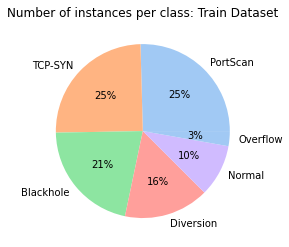

In [ ]:
#define Seaborn color palette to use
colors = sns.color_palette('pastel')[0:5]

#create pie chart
plt.pie(train['Label'].value_counts().values, labels = train['Label'].value_counts().index, colors = colors, autopct='%.0f%%')
plt.title('Number of instances per class: Train Dataset')
plt.show()

### Test dataset 

In [ ]:
test['Label'].value_counts()

TCP-SYN      156
PortScan     127
Blackhole    122
Diversion     90
Normal        49
Overflow      17
Name: Label, dtype: int64

#### Pie plot

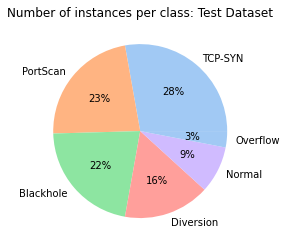

In [ ]:
#create pie chart
plt.pie(test['Label'].value_counts().values, labels = test['Label'].value_counts().index, colors = colors, autopct='%.0f%%')
plt.title('Number of instances per class: Test Dataset')
plt.show()

### Validation dataset 

In [ ]:
val['Label'].value_counts()

Blackhole    143
PortScan     141
TCP-SYN      123
Diversion     92
Normal        47
Overflow      15
Name: Label, dtype: int64

#### pie chart

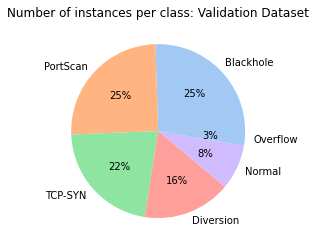

In [ ]:
#create pie chart
plt.pie(val['Label'].value_counts().values, labels = val['Label'].value_counts().index, colors = colors, autopct='%.0f%%')
plt.title('Number of instances per class: Validation Dataset')
plt.show()

## Number of null values per feature

### Train Dataset

In [ ]:
train.isna().sum()

Switch ID                        0
Port Number                      0
Received Packets                 0
Received Bytes                   0
Sent Bytes                       0
Sent Packets                     0
Port alive Duration (S)          0
Delta Received Packets           0
Delta Received Bytes             0
Delta Sent Bytes                 0
Delta Sent Packets               0
Delta Port alive Duration (S)    0
Connection Point                 0
Total Load/Rate                  0
Total Load/Latest                0
Unknown Load/Rate                0
Unknown Load/Latest              0
Latest bytes counter             0
Active Flow Entries              0
Packets Looked Up                0
Packets Matched                  0
Label                            0
dtype: int64

### Test Dataset

In [ ]:
test.isna().sum()

Switch ID                        0
Port Number                      0
Received Packets                 0
Received Bytes                   0
Sent Bytes                       0
Sent Packets                     0
Port alive Duration (S)          0
Delta Received Packets           0
Delta Received Bytes             0
Delta Sent Bytes                 0
Delta Sent Packets               0
Delta Port alive Duration (S)    0
Connection Point                 0
Total Load/Rate                  0
Total Load/Latest                0
Unknown Load/Rate                0
Unknown Load/Latest              0
Latest bytes counter             0
Active Flow Entries              0
Packets Looked Up                0
Packets Matched                  0
Label                            0
dtype: int64

### Validation Dataset

In [ ]:
val.isna().sum()

Switch ID                        0
Port Number                      0
Received Packets                 0
Received Bytes                   0
Sent Bytes                       0
Sent Packets                     0
Port alive Duration (S)          0
Delta Received Packets           0
Delta Received Bytes             0
Delta Sent Bytes                 0
Delta Sent Packets               0
Delta Port alive Duration (S)    0
Connection Point                 0
Total Load/Rate                  0
Total Load/Latest                0
Unknown Load/Rate                0
Unknown Load/Latest              0
Latest bytes counter             0
Active Flow Entries              0
Packets Looked Up                0
Packets Matched                  0
Label                            0
dtype: int64

## Number of dublicated values per feature

### Train Dataset

In [ ]:
train.duplicated().sum()

0

### Test Dataset

In [ ]:
test.duplicated().sum()

0

### Validation Dataset

In [ ]:
val.duplicated().sum()

0

## Number of possible outliers 

In [ ]:
#create a function to find outliers using IQR

def find_outliers_IQR(data):
    qtr1=data.quantile(0.25)

    qtr3=data.quantile(0.75)

    IQR=qtr3-qtr1
 
    outliers = data[((data<(qtr1-1.5*IQR)) | (data>(qtr3+1.5*IQR)))].count()

    return outliers

### Train Dataset

In [ ]:
find_outliers_IQR(train)

C:\Users\admin\AppData\Local\Temp/ipykernel_6740/3290919699.py:10: FutureWarning: Automatic reindexing on DataFrame vs Series comparisons is deprecated and will raise ValueError in a future version.  Do `left, right = left.align(right, axis=1, copy=False)` before e.g. `left == right`
  outliers = data[((data<(qtr1-1.5*IQR)) | (data>(qtr3+1.5*IQR)))].count()


Switch ID                          0
Port Number                        0
Received Packets                 312
Received Bytes                   186
Sent Bytes                       222
Sent Packets                     379
Port alive Duration (S)            0
Delta Received Packets           649
Delta Received Bytes             648
Delta Sent Bytes                 604
Delta Sent Packets               604
Delta Port alive Duration (S)    441
Connection Point                   0
Total Load/Rate                  396
Total Load/Latest                501
Unknown Load/Rate                396
Unknown Load/Latest              501
Latest bytes counter             396
Active Flow Entries              152
Packets Looked Up                536
Packets Matched                  536
Label                              0
dtype: int64

### Test Dataset

In [ ]:
find_outliers_IQR(test)

C:\Users\admin\AppData\Local\Temp/ipykernel_6740/3290919699.py:10: FutureWarning: Automatic reindexing on DataFrame vs Series comparisons is deprecated and will raise ValueError in a future version.  Do `left, right = left.align(right, axis=1, copy=False)` before e.g. `left == right`
  outliers = data[((data<(qtr1-1.5*IQR)) | (data>(qtr3+1.5*IQR)))].count()


Switch ID                          0
Port Number                        0
Received Packets                  69
Received Bytes                    38
Sent Bytes                        54
Sent Packets                      78
Port alive Duration (S)            0
Delta Received Packets           130
Delta Received Bytes             124
Delta Sent Bytes                 127
Delta Sent Packets               127
Delta Port alive Duration (S)     89
Connection Point                   0
Total Load/Rate                   76
Total Load/Latest                 99
Unknown Load/Rate                 76
Unknown Load/Latest               99
Latest bytes counter              76
Active Flow Entries               31
Packets Looked Up                108
Packets Matched                  108
Label                              0
dtype: int64

### Validation Dataset

In [ ]:
find_outliers_IQR(val)

C:\Users\admin\AppData\Local\Temp/ipykernel_6740/3290919699.py:10: FutureWarning: Automatic reindexing on DataFrame vs Series comparisons is deprecated and will raise ValueError in a future version.  Do `left, right = left.align(right, axis=1, copy=False)` before e.g. `left == right`
  outliers = data[((data<(qtr1-1.5*IQR)) | (data>(qtr3+1.5*IQR)))].count()


Switch ID                          0
Port Number                        0
Received Packets                  73
Received Bytes                    34
Sent Bytes                        54
Sent Packets                      75
Port alive Duration (S)            0
Delta Received Packets           122
Delta Received Bytes             121
Delta Sent Bytes                 119
Delta Sent Packets               120
Delta Port alive Duration (S)     86
Connection Point                   0
Total Load/Rate                   60
Total Load/Latest                 90
Unknown Load/Rate                 60
Unknown Load/Latest               90
Latest bytes counter              60
Active Flow Entries               30
Packets Looked Up                116
Packets Matched                  116
Label                              0
dtype: int64

## Basic statistical analysis for every feature 
(count, mean, std, min, qrt1, qrt2, qrt3, max)

### Train Dataset

In [ ]:
train.describe()

,Received Packets,Received Bytes,Sent Bytes,Sent Packets,Port alive Duration (S),Delta Received Packets,Delta Received Bytes,Delta Sent Bytes,Delta Sent Packets,Delta Port alive Duration (S),Connection Point,Total Load/Rate,Total Load/Latest,Unknown Load/Rate,Unknown Load/Latest,Latest bytes counter,Active Flow Entries,Packets Looked Up,Packets Matched
count,2619.000000,2.619000e+03,2.619000e+03,2619.000000,2619.000000,2619.000000,2.619000e+03,2.619000e+03,2619.000000,2619.000000,2619.000000,2.619000e+03,2.619000e+03,2.619000e+03,2.619000e+03,2.619000e+03,2619.000000,2.619000e+03,2.619000e+03
mean,19929.095074,2.606639e+07,2.372645e+07,33676.567774,890.539137,174.948835,3.254661e+05,2.957171e+05,160.607866,4.831615,2.450935,2.044276e+04,5.033087e+05,2.044276e+04,5.033087e+05,2.044276e+04,94.972890,9.920463e+04,9.908445e+04
std,61817.860816,3.670801e+07,3.309908e+07,90565.150583,970.916789,1028.907797,1.166624e+06,1.107859e+06,972.484039,0.374279,1.159286,1.141013e+05,1.796231e+06,1.141013e+05,1.796231e+06,1.141013e+05,828.181086,2.363175e+05,2.363162e+05
min,10.000000,8.560000e+02,6.025000e+03,44.000000,26.000000,0.000000,0.000000e+00,2.780000e+02,2.000000,4.000000,1.000000,-6.446240e+05,0.000000e+00,-6.446240e+05,0.000000e+00,-6.446240e+05,4.000000,1.050000e+02,5.000000e+01
25%,321.500000,8.464900e+04,5.360900e+04,333.500000,136.000000,2.000000,2.780000e+02,2.800000e+02,2.000000,5.000000,1.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,5.000000,2.263000e+03,2.147000e+03
50%,1108.000000,1.262083e+07,1.262176e+07,1243.000000,254.000000,4.000000,5.560000e+02,5.560000e+02,4.000000,5.000000,2.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,6.000000,6.968000e+03,6.843000e+03
75%,3268.500000,3.736785e+07,3.170219e+07,3727.000000,1721.000000,6.000000,8.310000e+02,7.590000e+02,5.000000,5.000000,3.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,8.000000,2.163300e+04,2.140800e+04
max,352584.000000,2.589422e+08,2.130728e+08,420806.000000,3317.000000,15588.000000,6.171714e+06,6.302910e+06,15593.000000,5.000000,5.000000,1.260657e+06,1.275386e+07,1.260657e+06,1.275386e+07,1.260657e+06,9985.000000,1.012220e+06,1.012085e+06


### Test Dataset

In [ ]:
test.describe()

,Received Packets,Received Bytes,Sent Bytes,Sent Packets,Port alive Duration (S),Delta Received Packets,Delta Received Bytes,Delta Sent Bytes,Delta Sent Packets,Delta Port alive Duration (S),Connection Point,Total Load/Rate,Total Load/Latest,Unknown Load/Rate,Unknown Load/Latest,Latest bytes counter,Active Flow Entries,Packets Looked Up,Packets Matched
count,561.000000,5.610000e+02,5.610000e+02,561.000000,561.000000,561.000000,5.610000e+02,5.610000e+02,561.000000,561.000000,561.00000,5.610000e+02,5.610000e+02,5.610000e+02,5.610000e+02,5.610000e+02,561.000000,5.610000e+02,5.610000e+02
mean,23141.636364,2.726677e+07,2.438093e+07,30155.998217,910.654189,149.048128,4.546660e+05,3.171120e+05,169.782531,4.841355,2.44385,1.992058e+04,6.084924e+05,1.992058e+04,6.084924e+05,1.992058e+04,61.912656,9.053312e+04,9.041352e+04
std,69278.589077,3.627827e+07,3.439084e+07,82370.302150,981.303212,861.268543,1.381151e+06,1.207563e+06,1030.484551,0.365671,1.20006,1.105112e+05,1.985467e+06,1.105112e+05,1.985467e+06,1.105112e+05,601.548185,2.235338e+05,2.235324e+05
min,10.000000,8.560000e+02,6.854000e+03,49.000000,26.000000,0.000000,0.000000e+00,2.780000e+02,2.000000,4.000000,1.00000,-4.042080e+05,0.000000e+00,-4.042080e+05,0.000000e+00,-4.042080e+05,4.000000,1.790000e+02,9.800000e+01
25%,353.000000,1.042010e+05,4.480100e+04,322.000000,136.000000,2.000000,2.780000e+02,2.800000e+02,2.000000,5.000000,1.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,5.000000,2.346000e+03,2.238000e+03
50%,1376.000000,1.267023e+07,1.262299e+07,1215.000000,256.000000,4.000000,5.560000e+02,5.560000e+02,4.000000,5.000000,2.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,6.000000,7.066000e+03,6.929000e+03
75%,3562.000000,3.809469e+07,3.176783e+07,4054.000000,1742.000000,19.000000,1.823000e+03,7.590000e+02,5.000000,5.000000,3.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,8.000000,1.963300e+04,1.940900e+04
max,352572.000000,2.589394e+08,2.138743e+08,420932.000000,3307.000000,11130.000000,6.323770e+06,6.647966e+06,13840.000000,5.000000,5.00000,1.194922e+06,1.264637e+07,1.194922e+06,1.264637e+07,1.194922e+06,9980.000000,1.009529e+06,1.009394e+06


### Validation Dataset

In [ ]:
val.describe()

,Received Packets,Received Bytes,Sent Bytes,Sent Packets,Port alive Duration (S),Delta Received Packets,Delta Received Bytes,Delta Sent Bytes,Delta Sent Packets,Delta Port alive Duration (S),Connection Point,Total Load/Rate,Total Load/Latest,Unknown Load/Rate,Unknown Load/Latest,Latest bytes counter,Active Flow Entries,Packets Looked Up,Packets Matched
count,561.000000,5.610000e+02,5.610000e+02,561.000000,561.000000,561.000000,5.610000e+02,5.610000e+02,561.000000,561.000000,561.000000,5.610000e+02,5.610000e+02,5.610000e+02,5.610000e+02,5.610000e+02,561.000000,5.610000e+02,5.610000e+02
mean,20265.901961,2.651052e+07,2.462073e+07,26309.124777,949.360071,238.839572,3.268137e+05,2.927781e+05,162.711230,4.846702,2.422460,1.349392e+04,4.418708e+05,1.349392e+04,4.418708e+05,1.349392e+04,62.071301,8.382923e+04,8.370799e+04
std,59032.911054,3.505715e+07,3.420225e+07,75202.041514,977.609275,1149.069110,1.181636e+06,1.106077e+06,909.905479,0.360596,1.150215,9.124726e+04,1.725488e+06,9.124726e+04,1.725488e+06,9.124726e+04,601.962008,2.056357e+05,2.056371e+05
min,10.000000,8.560000e+02,7.202000e+03,50.000000,36.000000,0.000000,0.000000e+00,2.780000e+02,2.000000,4.000000,1.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,4.000000,1.400000e+02,8.400000e+01
25%,379.000000,1.962210e+06,4.856800e+04,377.000000,141.000000,2.000000,2.780000e+02,2.800000e+02,2.000000,5.000000,1.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,5.000000,2.462000e+03,2.350000e+03
50%,1385.000000,1.266395e+07,1.263028e+07,1239.000000,317.000000,4.000000,5.560000e+02,5.560000e+02,4.000000,5.000000,2.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,6.000000,8.105000e+03,7.979000e+03
75%,3642.000000,3.785762e+07,3.176313e+07,3889.000000,1750.000000,5.000000,6.260000e+02,7.590000e+02,5.000000,5.000000,3.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,8.000000,2.073500e+04,2.060700e+04
max,350280.000000,2.652568e+08,1.837435e+08,419567.000000,3287.000000,11273.000000,6.249706e+06,6.302708e+06,11273.000000,5.000000,5.000000,1.260664e+06,1.273210e+07,1.260664e+06,1.273210e+07,1.260664e+06,9979.000000,1.009010e+06,1.008875e+06


In [ ]:
pip install sklearn

  Created wheel for sklearn: filename=sklearn-0.0-py2.py3-none-any.whl size=1309 sha256=82f5592fb488b5d5b73419e32a020d304d2322785b2c4eaa46576450e8130cd6
  Stored in directory: c:\users\admin\appdata\local\pip\cache\wheels\e4\7b\98\b6466d71b8d738a0c547008b9eb39bf8676d1ff6ca4b22af1c
Successfully built sklearn
Note: you may need to restart the kernel to use updated packages.


## Convert strings to numbers

In [ ]:
# Import label encoder
from sklearn import preprocessing
  
# label_encoder object knows how to understand word labels.
label_encoder = preprocessing.LabelEncoder()

#Train Dataset
train['Port Number'] = label_encoder.fit_transform(train['Port Number'])
train['Switch ID'] = label_encoder.fit_transform(train['Switch ID'])
# Test Dataset
test['Port Number'] = label_encoder.fit_transform(test['Port Number'])
test['Switch ID'] = label_encoder.fit_transform(test['Switch ID'])
# Validation Dataset
val['Port Number'] = label_encoder.fit_transform(val['Port Number'])
val['Switch ID'] = label_encoder.fit_transform(val['Switch ID'])

In [ ]:
# from sklearn.preprocessing import OneHotEncoder
# port = OneHotEncoder()
# switch = OneHotEncoder()

# train['Port_encoded'] = port.fit_transform(train['Port Number'])
# test['Switch_encoded'] = switch.fit_transform(train['Switch ID'])

# t1 = pd.get_dummies(train['Port Number'])
# t2 = pd.get_dummies(train['Switch ID'])

# tr1 = pd.get_dummies(test['Port Number'])
# tr2 = pd.get_dummies(test['Switch ID'])

# vl1 = pd.get_dummies(val['Port Number'])
# vl2 = pd.get_dummies(val['Switch ID'])

In [ ]:
test.Label.value_counts()

TCP-SYN      156
PortScan     127
Blackhole    122
Diversion     90
Normal        49
Overflow      17
Name: Label, dtype: int64

# Q1) Obtain a baseline performance

Split features and labels from:

○ Train Dataset

○ Test Dataset

○ Validation Dataset

In [ ]:
train_x, train_y = train[train.columns[~train.columns.isin([ 'Label'])]], train['Label']
test_x, test_y = test[test.columns[~test.columns.isin(['Label'])]], test['Label'] 
val_x, val_y = val[val.columns[~val.columns.isin(['Label'])]], val['Label']

## Label encoding for y label in: Train, Test, Validation

In [ ]:
train_y = label_encoder.fit_transform(train_y)

test_y = label_encoder.fit_transform(test_y)

val_y = label_encoder.fit_transform(val_y)

# MLP 

In [ ]:
from sklearn.neural_network import MLPClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import plot_confusion_matrix
from sklearn.metrics import classification_report

from sklearn.model_selection import GridSearchCV

MLP: 

○ 1 hidden layers with 5 neurons,

○ Relu activation function,

○ Use AdamW optimizer and set the learning rate as 0.001,

○ # of epochs=500,

○ Batch size =1

In [ ]:
# !pip install keras==2.3.1

In [ ]:
# !pip install keras-adamw
# !pip install keras.legacy

### Scaling

In [ ]:
from sklearn.preprocessing import StandardScaler

sc=StandardScaler()
#Train
scaler_train = sc.fit(train_x)
trainX_scaled = scaler_train.transform(train_x)
#Test
scaler_test = sc.fit(test_x)
testX_scaled = scaler_test.transform(test_x)
#Val
scaler_val = sc.fit(val_x)
valX_scaled = scaler_val.transform(val_x)

In [ ]:
# !pip install tensorflow ==1.14 
# !pip install keras ==2.2.5 
# # !pip install keras_adamw

In [ ]:
# !pip install tensorflow==2.8
# !pip install keras==2.9
# !pip install keras_adamw
# !pip install tensorflow_addons

In [ ]:
def plot_confusion_matrix(data, labels):
    sns.set(color_codes=True)
    plt.figure(1, figsize=(9, 6))
 
    plt.title("Confusion Matrix")
 
    sns.set(font_scale=1.4)
    ax = sns.heatmap(data, annot=True, cmap="YlGnBu", cbar_kws={'label': 'Scale'})
 
    ax.set_xticklabels(labels)
    ax.set_yticklabels(labels)
 
    ax.set(ylabel="True Label", xlabel="Predicted Label")
 
    plt.show()

## MLP training and prediction over 5 iterations

## Q 1

In [ ]:
from tensorflow import keras
#!pip install tensorflow_addons 
import tensorflow_addons as tfa
from keras.layers import Input, Dense, Flatten
from keras.models import Model
# from keras_adamw import AdamW
from sklearn.metrics import confusion_matrix
import numpy as np

Epoch 1/500
2619/2619 [==============================] - 8s 3ms/step - loss: 1.3088 - accuracy: 0.5235 - val_loss: 1.0962 - val_accuracy: 0.5936
Epoch 2/500
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0730 - accuracy: 0.5976 - val_loss: 1.0454 - val_accuracy: 0.6257
Epoch 3/500
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0423 - accuracy: 0.5995 - val_loss: 1.0293 - val_accuracy: 0.5971
Epoch 4/500
2619/2619 [==============================] - 8s 3ms/step - loss: 1.0351 - accuracy: 0.5979 - val_loss: 1.0345 - val_accuracy: 0.6328
Epoch 5/500
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0388 - accuracy: 0.5884 - val_loss: 1.0308 - val_accuracy: 0.6471
Epoch 6/500
2619/2619 [==============================] - 8s 3ms/step - loss: 1.0379 - accuracy: 0.5830 - val_loss: 1.0262 - val_accuracy: 0.6221
Epoch 7/500
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0345 - accuracy: 0.5911 - val_loss: 1.0314 - val_ac

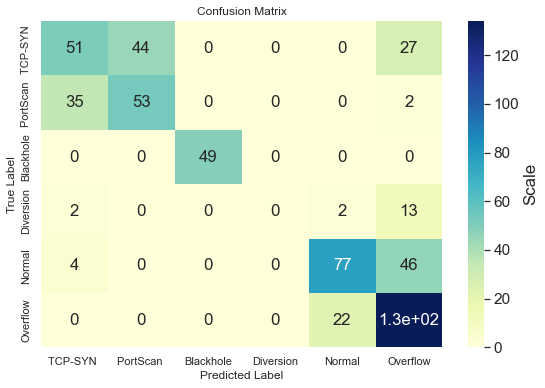

Epoch 1/500
2619/2619 [==============================] - 7s 3ms/step - loss: 1.2816 - accuracy: 0.5086 - val_loss: 1.1263 - val_accuracy: 0.5526
Epoch 2/500
2619/2619 [==============================] - 6s 2ms/step - loss: 1.0848 - accuracy: 0.5670 - val_loss: 1.0289 - val_accuracy: 0.6150
Epoch 3/500
2619/2619 [==============================] - 6s 2ms/step - loss: 1.0354 - accuracy: 0.6079 - val_loss: 1.0129 - val_accuracy: 0.6328
Epoch 4/500
2619/2619 [==============================] - 6s 2ms/step - loss: 1.0230 - accuracy: 0.5960 - val_loss: 1.0189 - val_accuracy: 0.5989
Epoch 5/500
2619/2619 [==============================] - 6s 2ms/step - loss: 1.0309 - accuracy: 0.5937 - val_loss: 1.0172 - val_accuracy: 0.6310
Epoch 6/500
2619/2619 [==============================] - 7s 2ms/step - loss: 1.0285 - accuracy: 0.5998 - val_loss: 1.0107 - val_accuracy: 0.6007
Epoch 7/500
2619/2619 [==============================] - 6s 2ms/step - loss: 1.0300 - accuracy: 0.5945 - val_loss: 1.0204 - val_ac

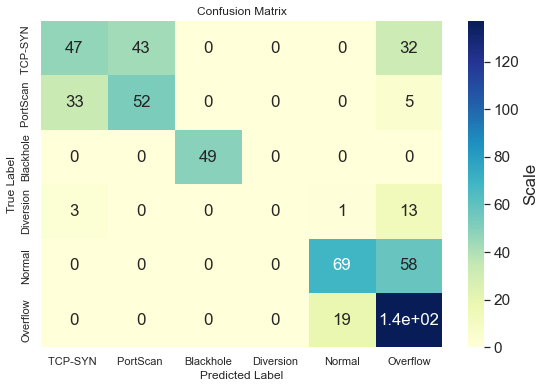

Epoch 1/500
2619/2619 [==============================] - 8s 3ms/step - loss: 1.3396 - accuracy: 0.5181 - val_loss: 1.1284 - val_accuracy: 0.6417
Epoch 2/500
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0906 - accuracy: 0.5830 - val_loss: 1.0456 - val_accuracy: 0.6381
Epoch 3/500
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0471 - accuracy: 0.5960 - val_loss: 1.0324 - val_accuracy: 0.6257
Epoch 4/500
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0389 - accuracy: 0.5796 - val_loss: 1.0298 - val_accuracy: 0.6114
Epoch 5/500
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0425 - accuracy: 0.5918 - val_loss: 1.0343 - val_accuracy: 0.6114
Epoch 6/500
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0391 - accuracy: 0.5922 - val_loss: 1.0222 - val_accuracy: 0.6025
Epoch 7/500
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0387 - accuracy: 0.5869 - val_loss: 1.0360 - val_ac

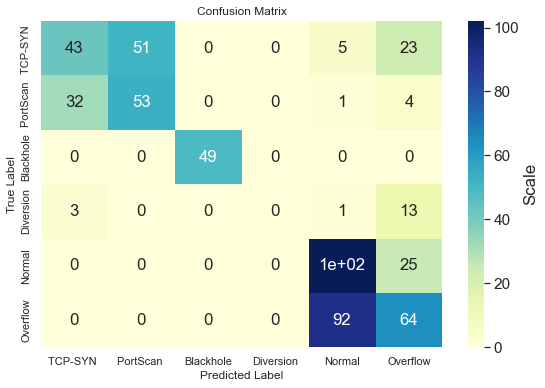

Epoch 1/500
2619/2619 [==============================] - 7s 3ms/step - loss: 1.3742 - accuracy: 0.4922 - val_loss: 1.1217 - val_accuracy: 0.6007
Epoch 2/500
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0741 - accuracy: 0.5865 - val_loss: 1.0364 - val_accuracy: 0.6257
Epoch 3/500
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0369 - accuracy: 0.5956 - val_loss: 1.0234 - val_accuracy: 0.5989
Epoch 4/500
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0269 - accuracy: 0.6090 - val_loss: 1.0315 - val_accuracy: 0.5223
Epoch 5/500
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0300 - accuracy: 0.5934 - val_loss: 1.0222 - val_accuracy: 0.5312
Epoch 6/500
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0311 - accuracy: 0.5934 - val_loss: 1.0272 - val_accuracy: 0.6542
Epoch 7/500
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0346 - accuracy: 0.6002 - val_loss: 1.0162 - val_ac

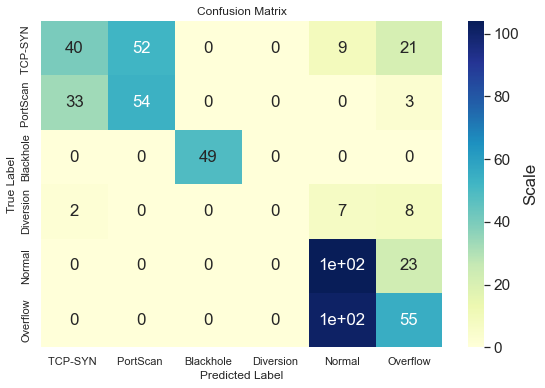

Epoch 1/500
2619/2619 [==============================] - 7s 3ms/step - loss: 1.3722 - accuracy: 0.4964 - val_loss: 1.1444 - val_accuracy: 0.5971
Epoch 2/500
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0986 - accuracy: 0.5762 - val_loss: 1.0657 - val_accuracy: 0.5241
Epoch 3/500
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0628 - accuracy: 0.5796 - val_loss: 1.0398 - val_accuracy: 0.6346
Epoch 4/500
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0501 - accuracy: 0.5819 - val_loss: 1.0304 - val_accuracy: 0.6132
Epoch 5/500
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0463 - accuracy: 0.6033 - val_loss: 1.0457 - val_accuracy: 0.5169
Epoch 6/500
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0418 - accuracy: 0.6048 - val_loss: 1.0292 - val_accuracy: 0.6221
Epoch 7/500
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0420 - accuracy: 0.5918 - val_loss: 1.0262 - val_ac

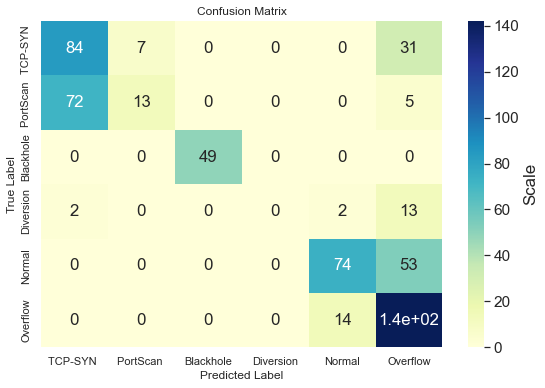

In [ ]:
from tensorflow import keras
!pip install tensorflow_addons 
import tensorflow_addons as tfa
from keras.layers import Input, Dense, Flatten
from keras.models import Model
#rom keras_adamw import AdamW
from sklearn.metrics import confusion_matrix
import numpy as np

h_total_train= []
h_total_val= []
loss_train=[]
loss_test=[]
total_acc=[]
confusion=[]
number_of_runs=5
model = keras.models.Sequential()
for i in range(number_of_runs):
    #ptimizer=tfaAdamw.optimizers.AdamW(learning_rate= 0.001, weight_decay= 0.001)
    optimizer=tfa.optimizers.AdamW(learning_rate= 0.001, weight_decay= 0.001)
    model = keras.models.Sequential()
    model.add(Dense(10, input_shape = (21,), activation = 'relu'))
    model.add(Dense(6, activation = "softmax"))
    model.compile(optimizer=optimizer, loss="sparse_categorical_crossentropy", metrics = ["accuracy"])
    model.fit(trainX_scaled, train_y, epochs=500, batch_size=1, validation_data=(testX_scaled, test_y))
    model.history.history
    h_total_train.append(model.history.history['accuracy'])
    h_total_val.append(model.history.history['val_accuracy'])
    loss_train.append(model.history.history['loss'])
    loss_test.append(model.history.history['val_loss'])
    total_acc.append(model.evaluate(testX_scaled,test_y, verbose=0)[1])

    y_pred = np.argmax(model.predict(testX_scaled), axis=-1)
    data= confusion_matrix(test_y, y_pred)
    confusion.append(data)
    labels =['TCP-SYN ','PortScan ','Blackhole','Diversion','Normal','Overflow']
    plot_confusion_matrix(data,labels)


## Confusion matrix 

In [ ]:
confusion

[array([[ 51,  44,   0,   0,   0,  27],
        [ 35,  53,   0,   0,   0,   2],
        [  0,   0,  49,   0,   0,   0],
        [  2,   0,   0,   0,   2,  13],
        [  4,   0,   0,   0,  77,  46],
        [  0,   0,   0,   0,  22, 134]], dtype=int64),
 array([[ 47,  43,   0,   0,   0,  32],
        [ 33,  52,   0,   0,   0,   5],
        [  0,   0,  49,   0,   0,   0],
        [  3,   0,   0,   0,   1,  13],
        [  0,   0,   0,   0,  69,  58],
        [  0,   0,   0,   0,  19, 137]], dtype=int64),
 array([[ 43,  51,   0,   0,   5,  23],
        [ 32,  53,   0,   0,   1,   4],
        [  0,   0,  49,   0,   0,   0],
        [  3,   0,   0,   0,   1,  13],
        [  0,   0,   0,   0, 102,  25],
        [  0,   0,   0,   0,  92,  64]], dtype=int64),
 array([[ 40,  52,   0,   0,   9,  21],
        [ 33,  54,   0,   0,   0,   3],
        [  0,   0,  49,   0,   0,   0],
        [  2,   0,   0,   0,   7,   8],
        [  0,   0,   0,   0, 104,  23],
        [  0,   0,   0,   0, 101,  

In [ ]:
cm1=confusion[0]
cm2=confusion[1]
cm3=confusion[2]
cm4=confusion[3]
cm5=confusion[4]

In [ ]:
cm_cocat=pd.concat((
    pd.DataFrame(cm1),pd.DataFrame(cm2),pd.DataFrame(cm3),pd.DataFrame(cm4),pd.DataFrame(cm5)))

In [ ]:
cm_Average=cm_cocat.groupby(cm_cocat.index)

In [ ]:
cm_Average.mean()

,0,1,2,3,4,5
0,53.0,39.4,0.0,0.0,2.8,26.8
1,41.0,45.0,0.0,0.0,0.2,3.8
2,0.0,0.0,49.0,0.0,0.0,0.0
3,2.4,0.0,0.0,0.0,2.6,12.0
4,0.8,0.0,0.0,0.0,85.2,41.0
5,0.0,0.0,0.0,0.0,49.6,106.4


In [ ]:
cm_Average=round(cm_Average.mean())
cm_Average

,0,1,2,3,4,5
0,53.0,39.0,0.0,0.0,3.0,27.0
1,41.0,45.0,0.0,0.0,0.0,4.0
2,0.0,0.0,49.0,0.0,0.0,0.0
3,2.0,0.0,0.0,0.0,3.0,12.0
4,1.0,0.0,0.0,0.0,85.0,41.0
5,0.0,0.0,0.0,0.0,50.0,106.0


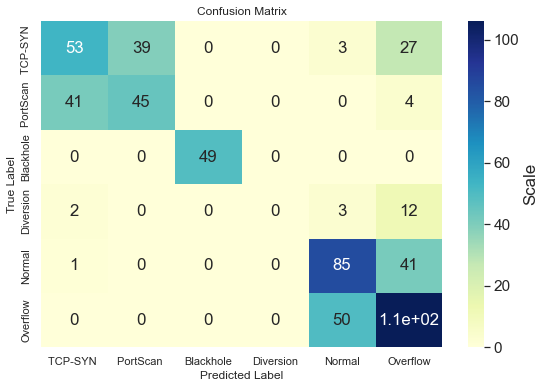

In [ ]:
plot_confusion_matrix(np.array(cm_Average),labels)

## Number of runs vs. train and validation accuray

In [ ]:
for i in range(number_of_runs):
    f=plt.subplot(2,5,i+1)
    f.figure.set_size_inches(32,15)
    plt.plot(h_total_train[i])
    plt.plot(h_total_val[i],'r')
    plt.legend(['Train accuracy', 'Test accuracy']) 
    plt.title("Run number %d"%(i+1))
    plt.xlabel("Number of epochs")
    plt.ylabel("Accuracy")
    plt.grid()

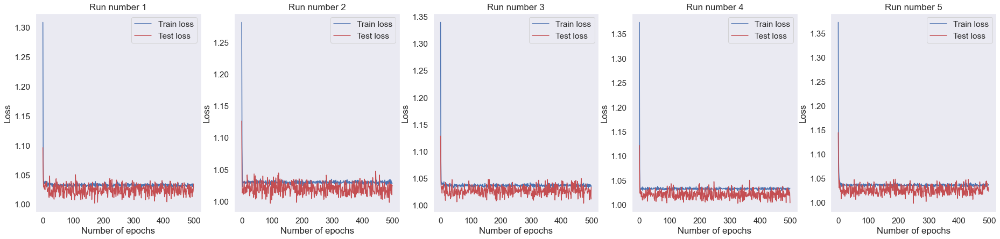

In [ ]:
for i in range(number_of_runs):
    f=plt.subplot(2,5,i+1)
    f.figure.set_size_inches(32,15)
    plt.plot(loss_train[i])
    plt.plot(loss_test[i],'r')
    plt.legend(['Train loss', 'Test loss']) 
    plt.title("Run number %d"%(i+1))
    plt.xlabel("Number of epochs")
    plt.ylabel("Loss")
    plt.grid()

## Training and Testing losses vs. the number of epochs

In [ ]:
[test_loss,test_acc] = model.evaluate(testX_scaled,test_y)
print('test accuracy: ',test_acc*100,'%')
print('test loss: ',test_loss)

18/18 [==============================] - 0s 3ms/step - loss: 1.0225 - accuracy: 0.6453
test accuracy:  64.52763080596924 %
test loss:  1.0225452184677124


## Min, Max, Avg Accuracies

In [ ]:
# Training acc 
# Max
max_training_accuracy = np.amax(h_total_train)
# Min 
min_training_accuracy = np.amin(h_total_train)
#Avg
avg_training_accuracy = np.average(h_total_train)

# Testing acc 
# Max
max_testing_accuracy =  np.amax(total_acc)
# Min 
min_testing_accuracy =  np.amin(total_acc)
# Avg
avg_testing_accuracy =  np.average(total_acc)


# Valadation acc 
# Max
max_Valadation_accuracy =  np.amax(h_total_val)
# Min 
min_Valadation_accuracy =  np.amin(h_total_val)
# Avg
avg_Valadation_accuracy =  np.average(h_total_val)


print('Min, Max, Avg Accuracies', '\n')
print('Max_training_accuracy:', max_training_accuracy )
print('Min_training_accuracy: ', min_training_accuracy)
print('Avg_training_accuracy: ', avg_training_accuracy)
print('----------------------------------------------')
print('Max_testing_accuracy: ', max_testing_accuracy)
print('Min_testing_accuracy: ', min_testing_accuracy)
print('Avg_testing_accuracy: ', avg_testing_accuracy)
print('----------------------------------------------')
print('Max_Valadation_accuracy: ', max_Valadation_accuracy)
print('Min_Valadation_accuracy: ', min_Valadation_accuracy)
print('Avg_Valadation_accuracy: ', avg_Valadation_accuracy)


Min, Max, Avg Accuracies 

Max_training_accuracy: 0.6158839464187622
Min_training_accuracy:  0.49217259883880615
Avg_training_accuracy:  0.5976296294569969
----------------------------------------------
Max_testing_accuracy:  0.648841381072998
Min_testing_accuracy:  0.5383244156837463
Avg_testing_accuracy:  0.6035650610923767
----------------------------------------------
Max_Valadation_accuracy:  0.6702316999435425
Min_Valadation_accuracy:  0.47593581676483154
Avg_Valadation_accuracy:  0.6030980390787125


## TSNE plots

In [ ]:
from sklearn.manifold import TSNE

def plot_tsne(X, y,title):
    tsne = TSNE(n_components=2, random_state=0)
    X_2d = tsne.fit_transform(X)
    plt.figure(figsize=(17,6))
    plt.subplot(1,2,1)
    for i in range(0,6):
        plt.scatter(X_2d[y == i, 0], X_2d[y == i, 1], label=str(i+1))
    plt.title(title)
    plt.xlabel("TSNE Component 1")
    plt.ylabel("TSNE Component 2")
    plt.legend(['TCP-SYN ','PortScan ','Blackhole','Diversion','Normal','Overflow']) 
    
    
    
  

 ### Training set

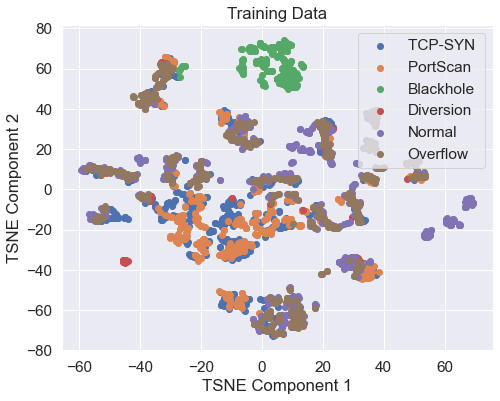

In [ ]:
plot_tsne(trainX_scaled, train_y,"Training Data")

### Test set

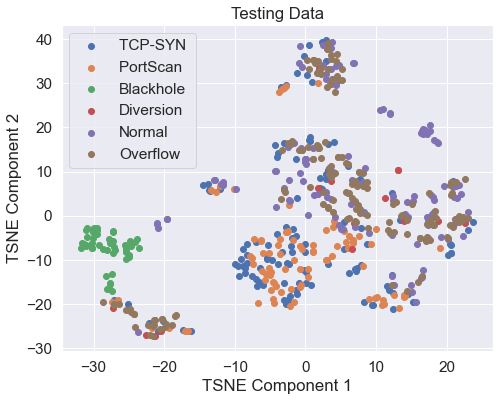

In [ ]:
plot_tsne(testX_scaled, test_y,"Testing Data")

### Validation

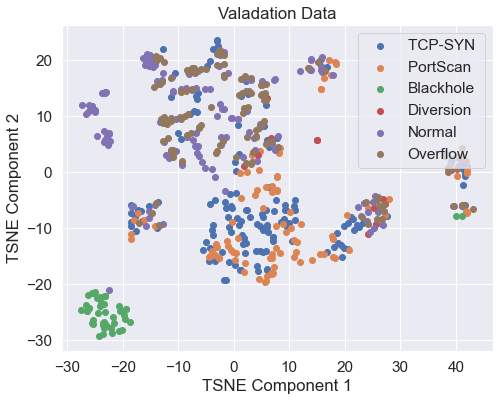

In [ ]:
plot_tsne(valX_scaled, val_y,"Valadation Data")

# Q2: 

## 1) Dimensionality reduction

In [ ]:
print(len(train_x.columns))
print(len(train_x.columns))
print(len(train_x.columns))

21
21
21


In [ ]:
!pip install tensorflow-addons
import tensorflow_addons as tfaAdamw
opt=tfaAdamw.optimizers.AdamW(learning_rate= 0.001, weight_decay= 0.001)

_________________________
|At PCA n_components= 2 |
_________________________

Epoch 1/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.4792 - accuracy: 0.3727 - val_loss: 1.4323 - val_accuracy: 0.3904
Epoch 2/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.3748 - accuracy: 0.4284 - val_loss: 1.3897 - val_accuracy: 0.4046
Epoch 3/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.3565 - accuracy: 0.4280 - val_loss: 1.3620 - val_accuracy: 0.4153
Epoch 4/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.3423 - accuracy: 0.4353 - val_loss: 1.3588 - val_accuracy: 0.3993
Epoch 5/50
2619/2619 [==============================] - 7s 2ms/step - loss: 1.3400 - accuracy: 0.4506 - val_loss: 1.3567 - val_accuracy: 0.4492
Epoch 6/50
2619/2619 [==============================] - 6s 2ms/step - loss: 1.3433 - accuracy: 0.4475 - val_loss: 1.3473 - val_accuracy: 0.3993
Epoch 7/50
2619/2619 [==============================] - 7

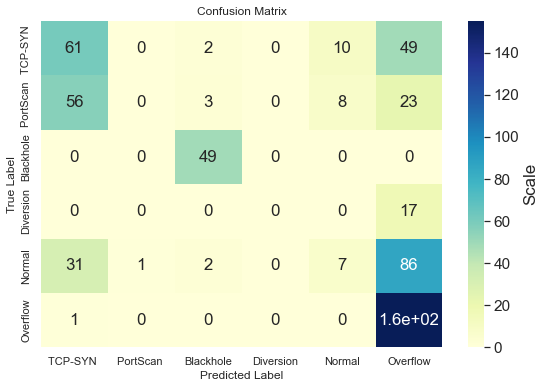

Confusion Matrix __ of Valadation


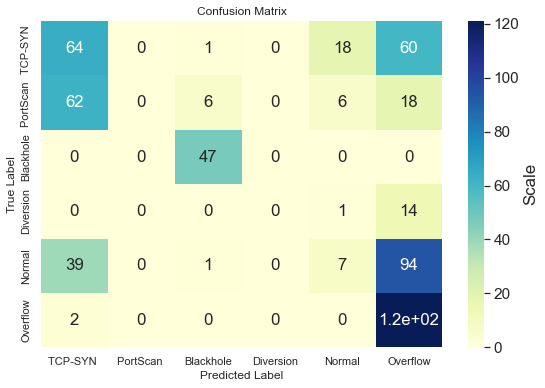

_________________________
|At PCA n_components= 3 |
_________________________

Epoch 1/50
2619/2619 [==============================] - 7s 2ms/step - loss: 1.5548 - accuracy: 0.3700 - val_loss: 1.3076 - val_accuracy: 0.5045
Epoch 2/50
2619/2619 [==============================] - 6s 2ms/step - loss: 1.2093 - accuracy: 0.5445 - val_loss: 1.1565 - val_accuracy: 0.5918
Epoch 3/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1534 - accuracy: 0.5678 - val_loss: 1.1385 - val_accuracy: 0.5811
Epoch 4/50
2619/2619 [==============================] - 6s 2ms/step - loss: 1.1447 - accuracy: 0.5838 - val_loss: 1.1388 - val_accuracy: 0.5258
Epoch 5/50
2619/2619 [==============================] - 6s 2ms/step - loss: 1.1463 - accuracy: 0.5662 - val_loss: 1.1388 - val_accuracy: 0.5900
Epoch 6/50
2619/2619 [==============================] - 6s 2ms/step - loss: 1.1396 - accuracy: 0.5796 - val_loss: 1.1276 - val_accuracy: 0.5882
Epoch 7/50
2619/2619 [==============================] - 7

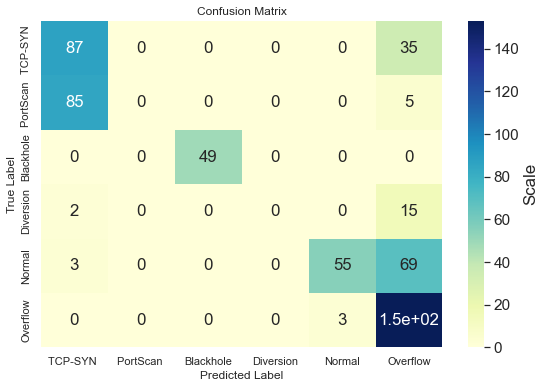

Confusion Matrix __ of Valadation


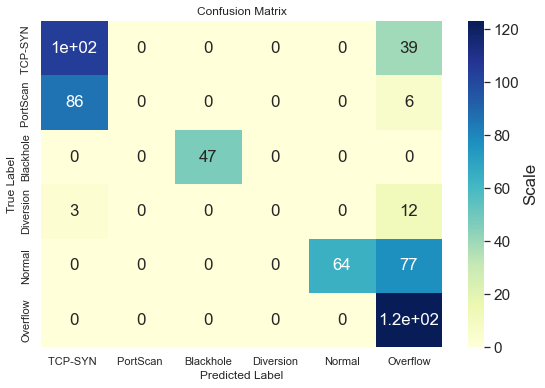

_________________________
|At PCA n_components= 4 |
_________________________

Epoch 1/50
2619/2619 [==============================] - 7s 2ms/step - loss: 1.4436 - accuracy: 0.4551 - val_loss: 1.2152 - val_accuracy: 0.5686
Epoch 2/50
2619/2619 [==============================] - 6s 2ms/step - loss: 1.1770 - accuracy: 0.5651 - val_loss: 1.1417 - val_accuracy: 0.5882
Epoch 3/50
2619/2619 [==============================] - 6s 2ms/step - loss: 1.1340 - accuracy: 0.5670 - val_loss: 1.1097 - val_accuracy: 0.6061
Epoch 4/50
2619/2619 [==============================] - 6s 2ms/step - loss: 1.1259 - accuracy: 0.5819 - val_loss: 1.1107 - val_accuracy: 0.5579
Epoch 5/50
2619/2619 [==============================] - 6s 2ms/step - loss: 1.1236 - accuracy: 0.5842 - val_loss: 1.1148 - val_accuracy: 0.5312
Epoch 6/50
2619/2619 [==============================] - 6s 2ms/step - loss: 1.1233 - accuracy: 0.5609 - val_loss: 1.1082 - val_accuracy: 0.5579
Epoch 7/50
2619/2619 [==============================] - 7

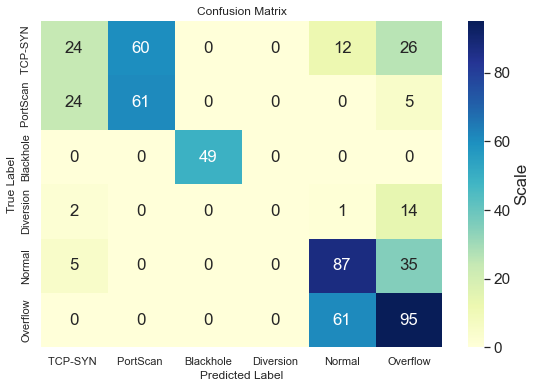

Confusion Matrix __ of Valadation


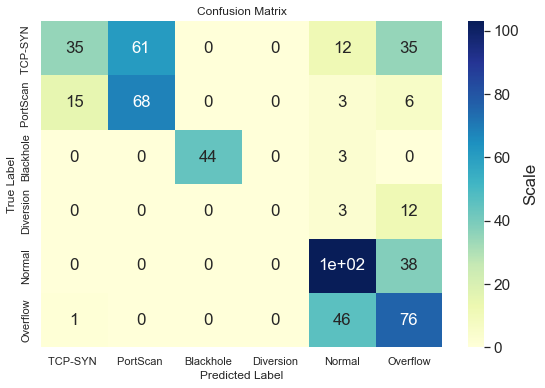

_________________________
|At PCA n_components= 5 |
_________________________

Epoch 1/50
2619/2619 [==============================] - 10s 3ms/step - loss: 1.3362 - accuracy: 0.5342 - val_loss: 1.1816 - val_accuracy: 0.5455
Epoch 2/50
2619/2619 [==============================] - 6s 2ms/step - loss: 1.1554 - accuracy: 0.5712 - val_loss: 1.1213 - val_accuracy: 0.6239
Epoch 3/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1233 - accuracy: 0.5834 - val_loss: 1.1164 - val_accuracy: 0.5865
Epoch 4/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1198 - accuracy: 0.5823 - val_loss: 1.0998 - val_accuracy: 0.5882
Epoch 5/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1148 - accuracy: 0.5838 - val_loss: 1.1184 - val_accuracy: 0.5811
Epoch 6/50
2619/2619 [==============================] - 19s 7ms/step - loss: 1.1182 - accuracy: 0.5708 - val_loss: 1.1099 - val_accuracy: 0.5579
Epoch 7/50
2619/2619 [==============================] -

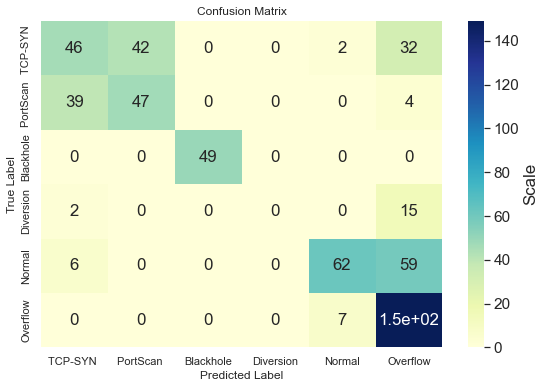

Confusion Matrix __ of Valadation


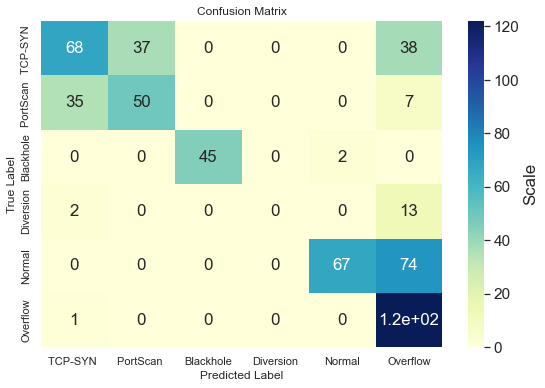

_________________________
|At PCA n_components= 6 |
_________________________

Epoch 1/50
2619/2619 [==============================] - 21s 8ms/step - loss: 1.4070 - accuracy: 0.4906 - val_loss: 1.2194 - val_accuracy: 0.5223
Epoch 2/50
2619/2619 [==============================] - 21s 8ms/step - loss: 1.1817 - accuracy: 0.5674 - val_loss: 1.1333 - val_accuracy: 0.6310
Epoch 3/50
2619/2619 [==============================] - 18s 7ms/step - loss: 1.1351 - accuracy: 0.5899 - val_loss: 1.1162 - val_accuracy: 0.6346
Epoch 4/50
2619/2619 [==============================] - 21s 8ms/step - loss: 1.1244 - accuracy: 0.5968 - val_loss: 1.1101 - val_accuracy: 0.6132
Epoch 5/50
2619/2619 [==============================] - 21s 8ms/step - loss: 1.1248 - accuracy: 0.5777 - val_loss: 1.1047 - val_accuracy: 0.5472
Epoch 6/50
2619/2619 [==============================] - 21s 8ms/step - loss: 1.1279 - accuracy: 0.5800 - val_loss: 1.1053 - val_accuracy: 0.6239
Epoch 7/50
2619/2619 [=============================

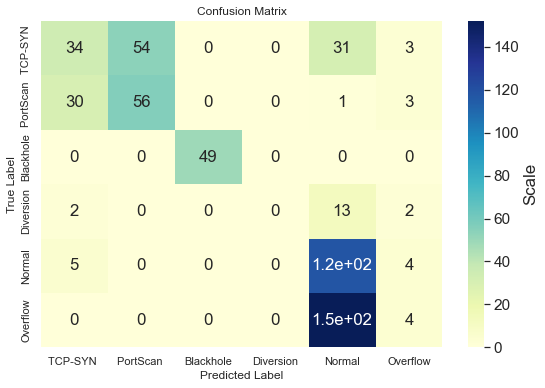

Confusion Matrix __ of Valadation


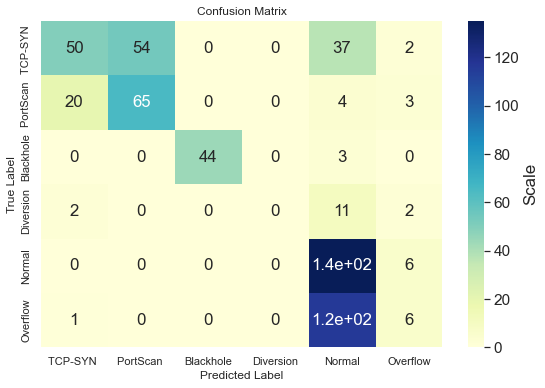

_________________________
|At PCA n_components= 7 |
_________________________

Epoch 1/50
2619/2619 [==============================] - 8s 3ms/step - loss: 1.4542 - accuracy: 0.4738 - val_loss: 1.2265 - val_accuracy: 0.5615
Epoch 2/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1701 - accuracy: 0.5766 - val_loss: 1.1292 - val_accuracy: 0.5847
Epoch 3/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1302 - accuracy: 0.5811 - val_loss: 1.1165 - val_accuracy: 0.6132
Epoch 4/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1210 - accuracy: 0.5880 - val_loss: 1.1108 - val_accuracy: 0.5383
Epoch 5/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1200 - accuracy: 0.5617 - val_loss: 1.1190 - val_accuracy: 0.5561
Epoch 6/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1204 - accuracy: 0.5746 - val_loss: 1.1128 - val_accuracy: 0.6025
Epoch 7/50
2619/2619 [==============================] - 7

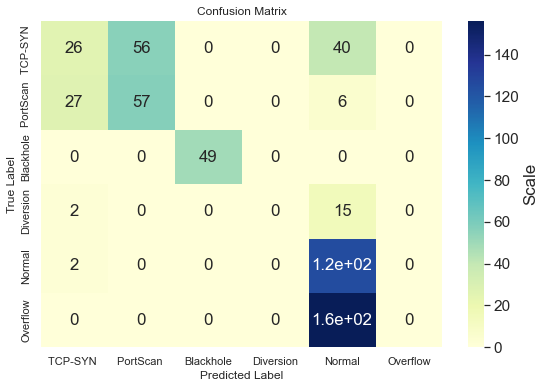

Confusion Matrix __ of Valadation


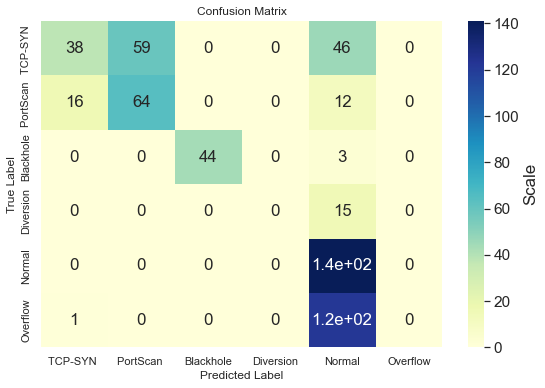

_________________________
|At PCA n_components= 8 |
_________________________

Epoch 1/50
2619/2619 [==============================] - 8s 3ms/step - loss: 1.4231 - accuracy: 0.4884 - val_loss: 1.1997 - val_accuracy: 0.5472
Epoch 2/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1733 - accuracy: 0.5498 - val_loss: 1.1215 - val_accuracy: 0.6132
Epoch 3/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1259 - accuracy: 0.5808 - val_loss: 1.1026 - val_accuracy: 0.5829
Epoch 4/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1127 - accuracy: 0.5758 - val_loss: 1.1037 - val_accuracy: 0.5205
Epoch 5/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1137 - accuracy: 0.5716 - val_loss: 1.0956 - val_accuracy: 0.6096
Epoch 6/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1148 - accuracy: 0.5716 - val_loss: 1.1131 - val_accuracy: 0.5651
Epoch 7/50
2619/2619 [==============================] - 7

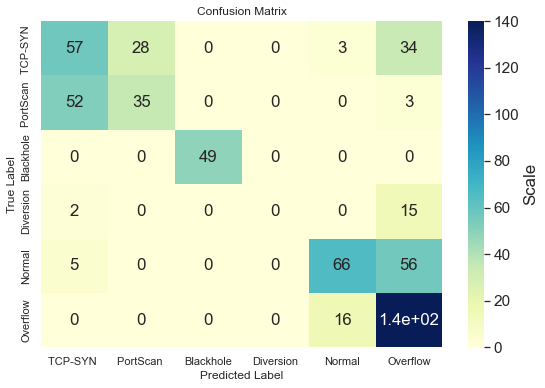

Confusion Matrix __ of Valadation


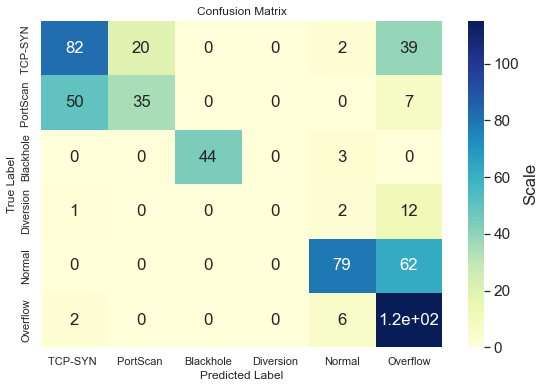

_________________________
|At PCA n_components= 9 |
_________________________

Epoch 1/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.4382 - accuracy: 0.4769 - val_loss: 1.1994 - val_accuracy: 0.5401
Epoch 2/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1682 - accuracy: 0.5647 - val_loss: 1.1264 - val_accuracy: 0.5865
Epoch 3/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1298 - accuracy: 0.5815 - val_loss: 1.1031 - val_accuracy: 0.5918
Epoch 4/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1170 - accuracy: 0.5724 - val_loss: 1.1162 - val_accuracy: 0.5401
Epoch 5/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1117 - accuracy: 0.5701 - val_loss: 1.1146 - val_accuracy: 0.5900
Epoch 6/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1169 - accuracy: 0.5735 - val_loss: 1.0936 - val_accuracy: 0.6221
Epoch 7/50
2619/2619 [==============================] - 7

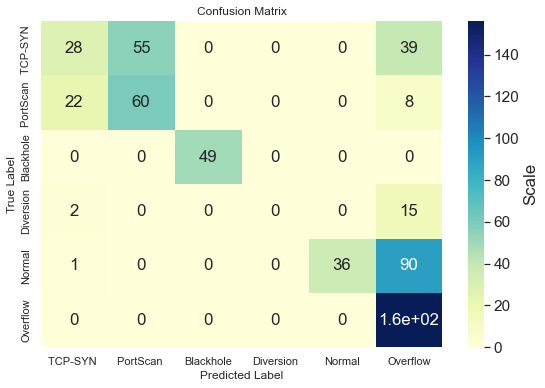

Confusion Matrix __ of Valadation


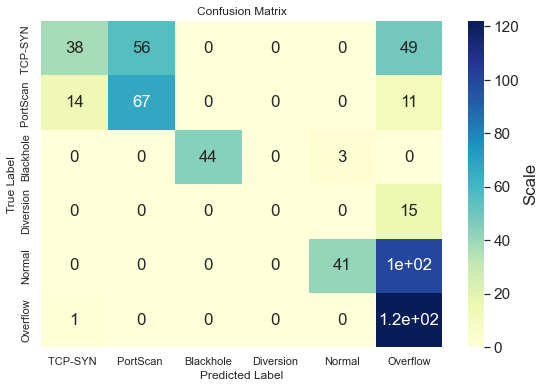

_________________________
|At PCA n_components= 10 |
_________________________

Epoch 1/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.4063 - accuracy: 0.4922 - val_loss: 1.2286 - val_accuracy: 0.5615
Epoch 2/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1773 - accuracy: 0.5575 - val_loss: 1.1200 - val_accuracy: 0.5526
Epoch 3/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1216 - accuracy: 0.5785 - val_loss: 1.1068 - val_accuracy: 0.6061
Epoch 4/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1145 - accuracy: 0.5827 - val_loss: 1.0897 - val_accuracy: 0.6185
Epoch 5/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1094 - accuracy: 0.5819 - val_loss: 1.1097 - val_accuracy: 0.5811
Epoch 6/50
2619/2619 [==============================] - 7s 2ms/step - loss: 1.1106 - accuracy: 0.5739 - val_loss: 1.0926 - val_accuracy: 0.5009
Epoch 7/50
2619/2619 [==============================] - 

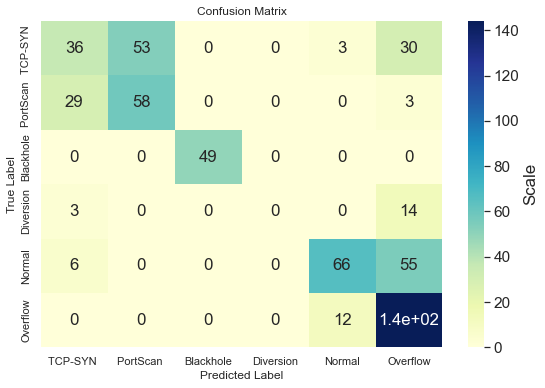

Confusion Matrix __ of Valadation


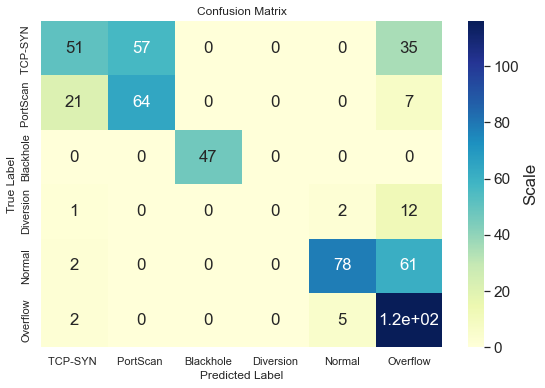

_________________________
|At PCA n_components= 11 |
_________________________

Epoch 1/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.4820 - accuracy: 0.4555 - val_loss: 1.2360 - val_accuracy: 0.6043
Epoch 2/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1693 - accuracy: 0.5762 - val_loss: 1.1195 - val_accuracy: 0.5971
Epoch 3/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1232 - accuracy: 0.5746 - val_loss: 1.1039 - val_accuracy: 0.5579
Epoch 4/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1097 - accuracy: 0.5754 - val_loss: 1.1077 - val_accuracy: 0.5900
Epoch 5/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1107 - accuracy: 0.5788 - val_loss: 1.1000 - val_accuracy: 0.5971
Epoch 6/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1073 - accuracy: 0.5823 - val_loss: 1.0855 - val_accuracy: 0.6257
Epoch 7/50
2619/2619 [==============================] - 

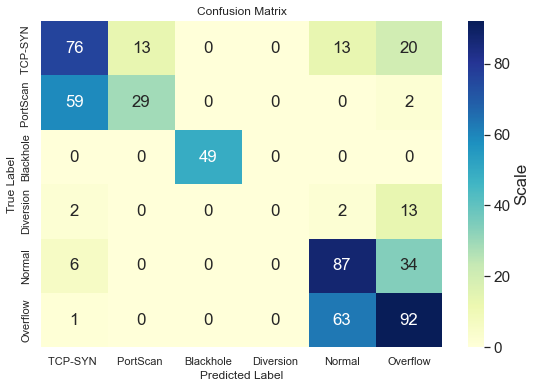

Confusion Matrix __ of Valadation


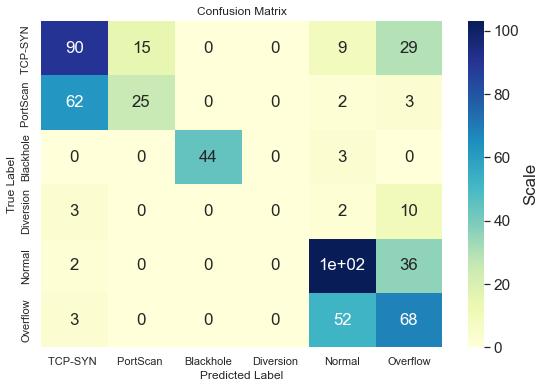

_________________________
|At PCA n_components= 12 |
_________________________

Epoch 1/50
2619/2619 [==============================] - 8s 3ms/step - loss: 1.4522 - accuracy: 0.4502 - val_loss: 1.2150 - val_accuracy: 0.5258
Epoch 2/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1469 - accuracy: 0.5666 - val_loss: 1.0982 - val_accuracy: 0.5490
Epoch 3/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1048 - accuracy: 0.5758 - val_loss: 1.0878 - val_accuracy: 0.5989
Epoch 4/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0991 - accuracy: 0.5819 - val_loss: 1.1001 - val_accuracy: 0.5686
Epoch 5/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1010 - accuracy: 0.5724 - val_loss: 1.0985 - val_accuracy: 0.5989
Epoch 6/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1024 - accuracy: 0.5872 - val_loss: 1.0862 - val_accuracy: 0.5793
Epoch 7/50
2619/2619 [==============================] - 

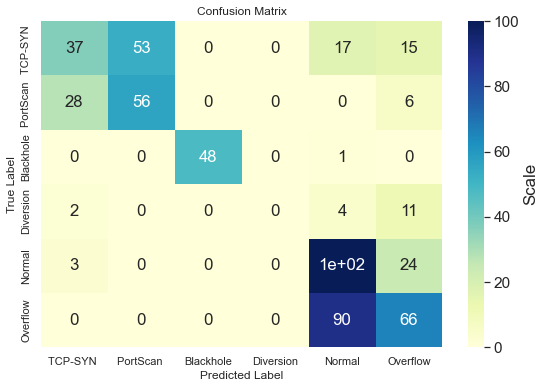

Confusion Matrix __ of Valadation


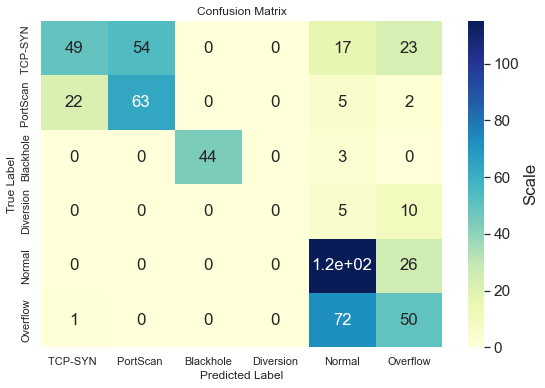

_________________________
|At PCA n_components= 13 |
_________________________

Epoch 1/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.4730 - accuracy: 0.4605 - val_loss: 1.2010 - val_accuracy: 0.6007
Epoch 2/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1597 - accuracy: 0.5750 - val_loss: 1.1210 - val_accuracy: 0.5579
Epoch 3/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1132 - accuracy: 0.5834 - val_loss: 1.1005 - val_accuracy: 0.5187
Epoch 4/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1041 - accuracy: 0.5777 - val_loss: 1.1015 - val_accuracy: 0.5187
Epoch 5/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1063 - accuracy: 0.5724 - val_loss: 1.0919 - val_accuracy: 0.6364
Epoch 6/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1008 - accuracy: 0.5766 - val_loss: 1.0936 - val_accuracy: 0.5865
Epoch 7/50
2619/2619 [==============================] - 

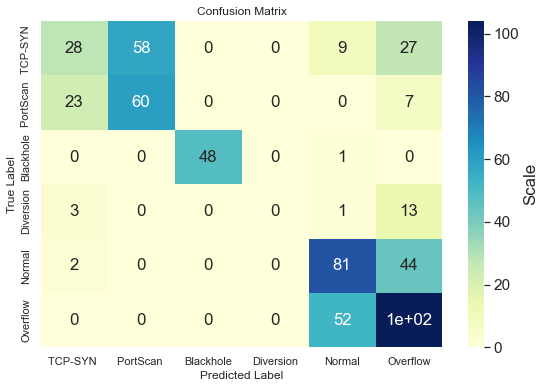

Confusion Matrix __ of Valadation


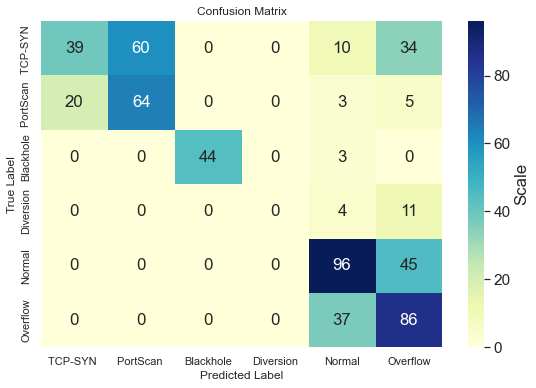

_________________________
|At PCA n_components= 14 |
_________________________

Epoch 1/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.4760 - accuracy: 0.4700 - val_loss: 1.2358 - val_accuracy: 0.5187
Epoch 2/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1694 - accuracy: 0.5494 - val_loss: 1.1228 - val_accuracy: 0.6203
Epoch 3/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1181 - accuracy: 0.5628 - val_loss: 1.1026 - val_accuracy: 0.5882
Epoch 4/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1041 - accuracy: 0.5888 - val_loss: 1.0824 - val_accuracy: 0.5383
Epoch 5/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0961 - accuracy: 0.5830 - val_loss: 1.0981 - val_accuracy: 0.6221
Epoch 6/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1017 - accuracy: 0.5796 - val_loss: 1.0791 - val_accuracy: 0.6364
Epoch 7/50
2619/2619 [==============================] - 

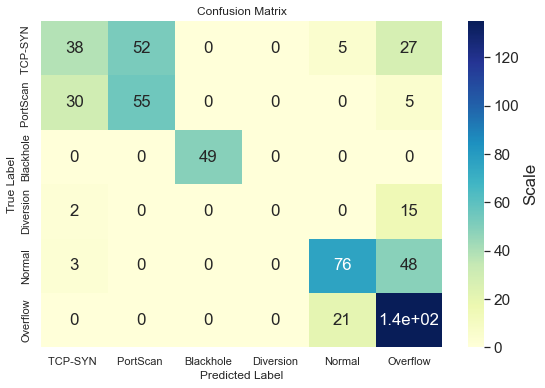

Confusion Matrix __ of Valadation


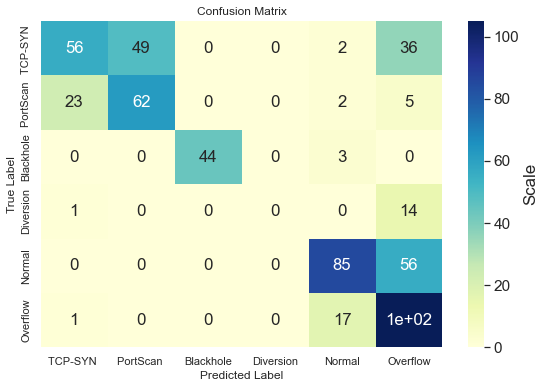

_________________________
|At PCA n_components= 15 |
_________________________

Epoch 1/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.4987 - accuracy: 0.4666 - val_loss: 1.2214 - val_accuracy: 0.5526
Epoch 2/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1537 - accuracy: 0.5659 - val_loss: 1.1187 - val_accuracy: 0.6096
Epoch 3/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1069 - accuracy: 0.5781 - val_loss: 1.1034 - val_accuracy: 0.5401
Epoch 4/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0984 - accuracy: 0.5808 - val_loss: 1.1056 - val_accuracy: 0.6061
Epoch 5/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1009 - accuracy: 0.5766 - val_loss: 1.0812 - val_accuracy: 0.6310
Epoch 6/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0942 - accuracy: 0.5808 - val_loss: 1.0928 - val_accuracy: 0.5758
Epoch 7/50
2619/2619 [==============================] - 

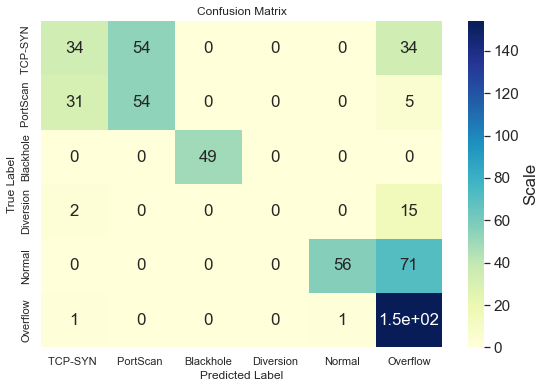

Confusion Matrix __ of Valadation


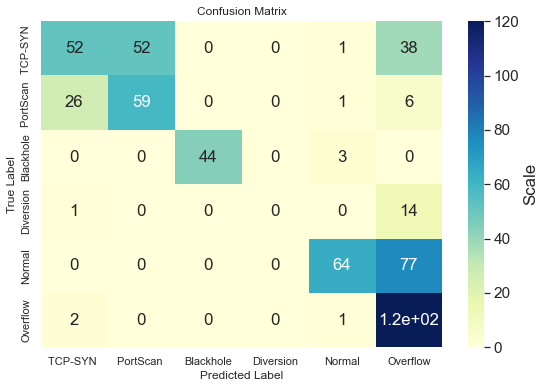

_________________________
|At PCA n_components= 16 |
_________________________

Epoch 1/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.4099 - accuracy: 0.5170 - val_loss: 1.1720 - val_accuracy: 0.6132
Epoch 2/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1103 - accuracy: 0.5930 - val_loss: 1.0694 - val_accuracy: 0.5793
Epoch 3/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0633 - accuracy: 0.6021 - val_loss: 1.0454 - val_accuracy: 0.6239
Epoch 4/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0582 - accuracy: 0.5934 - val_loss: 1.0354 - val_accuracy: 0.6292
Epoch 5/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0495 - accuracy: 0.5964 - val_loss: 1.0401 - val_accuracy: 0.5401
Epoch 6/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0522 - accuracy: 0.5853 - val_loss: 1.0433 - val_accuracy: 0.6257
Epoch 7/50
2619/2619 [==============================] - 

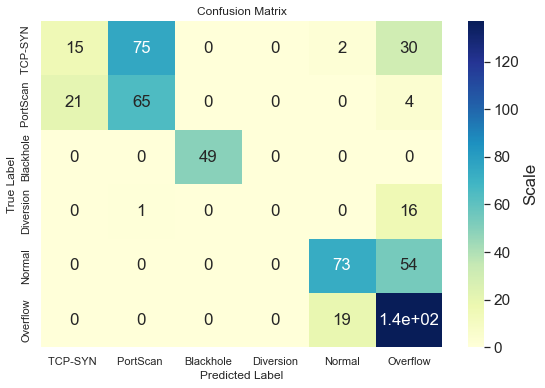

Confusion Matrix __ of Valadation


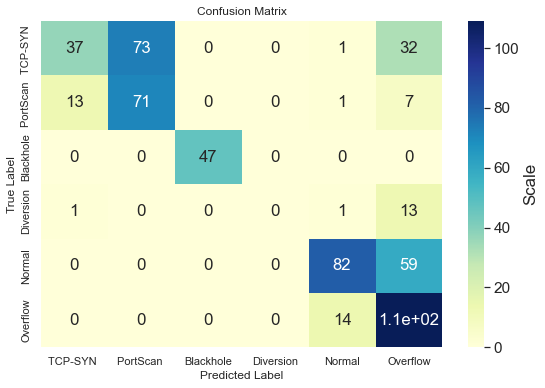

_________________________
|At PCA n_components= 17 |
_________________________

Epoch 1/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.4661 - accuracy: 0.4693 - val_loss: 1.1991 - val_accuracy: 0.5865
Epoch 2/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1306 - accuracy: 0.5804 - val_loss: 1.0743 - val_accuracy: 0.6078
Epoch 3/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0657 - accuracy: 0.5758 - val_loss: 1.0411 - val_accuracy: 0.5365
Epoch 4/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0491 - accuracy: 0.5773 - val_loss: 1.0450 - val_accuracy: 0.6061
Epoch 5/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0509 - accuracy: 0.5666 - val_loss: 1.0319 - val_accuracy: 0.6328
Epoch 6/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0468 - accuracy: 0.5750 - val_loss: 1.0441 - val_accuracy: 0.5651
Epoch 7/50
2619/2619 [==============================] - 

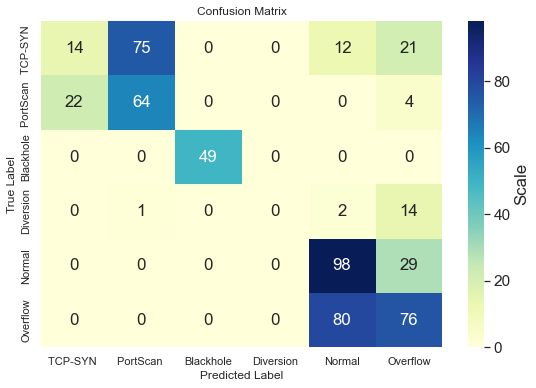

Confusion Matrix __ of Valadation


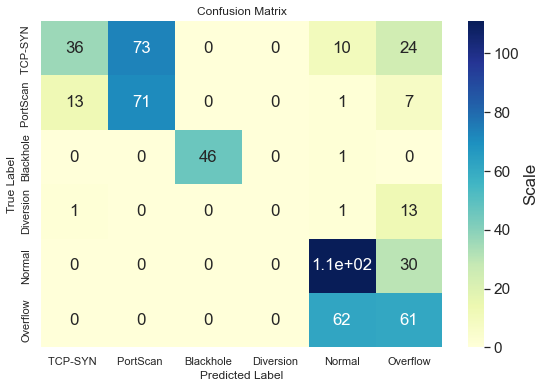

_________________________
|At PCA n_components= 18 |
_________________________

Epoch 1/50
2619/2619 [==============================] - 8s 3ms/step - loss: 1.4119 - accuracy: 0.5204 - val_loss: 1.1548 - val_accuracy: 0.6399
Epoch 2/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1044 - accuracy: 0.5800 - val_loss: 1.0717 - val_accuracy: 0.5383
Epoch 3/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0646 - accuracy: 0.5823 - val_loss: 1.0356 - val_accuracy: 0.5437
Epoch 4/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0552 - accuracy: 0.5781 - val_loss: 1.0371 - val_accuracy: 0.5348
Epoch 5/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0518 - accuracy: 0.5510 - val_loss: 1.0364 - val_accuracy: 0.5865
Epoch 6/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0530 - accuracy: 0.5796 - val_loss: 1.0374 - val_accuracy: 0.6168
Epoch 7/50
2619/2619 [==============================] - 

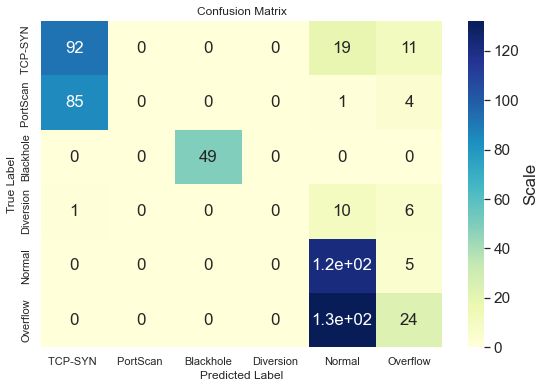

Confusion Matrix __ of Valadation


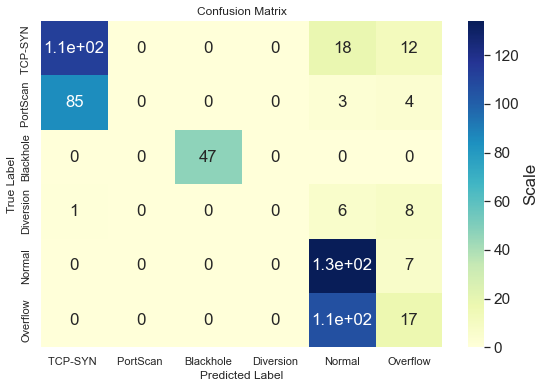

_________________________
|At PCA n_components= 19 |
_________________________

Epoch 1/50
2619/2619 [==============================] - 8s 3ms/step - loss: 1.4367 - accuracy: 0.4887 - val_loss: 1.1888 - val_accuracy: 0.6168
Epoch 2/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1170 - accuracy: 0.5598 - val_loss: 1.0539 - val_accuracy: 0.6328
Epoch 3/50
2619/2619 [==============================] - 10s 4ms/step - loss: 1.0591 - accuracy: 0.5777 - val_loss: 1.0391 - val_accuracy: 0.5936
Epoch 4/50
2619/2619 [==============================] - 21s 8ms/step - loss: 1.0524 - accuracy: 0.5796 - val_loss: 1.0422 - val_accuracy: 0.6185
Epoch 5/50
2619/2619 [==============================] - 24s 9ms/step - loss: 1.0474 - accuracy: 0.5724 - val_loss: 1.0500 - val_accuracy: 0.5882
Epoch 6/50
2619/2619 [==============================] - 11s 4ms/step - loss: 1.0530 - accuracy: 0.5746 - val_loss: 1.0376 - val_accuracy: 0.5597
Epoch 7/50
2619/2619 [==============================

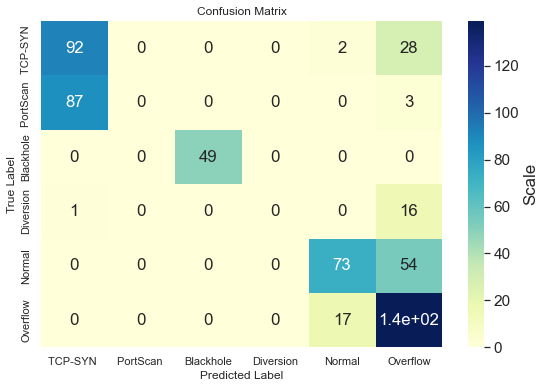

Confusion Matrix __ of Valadation


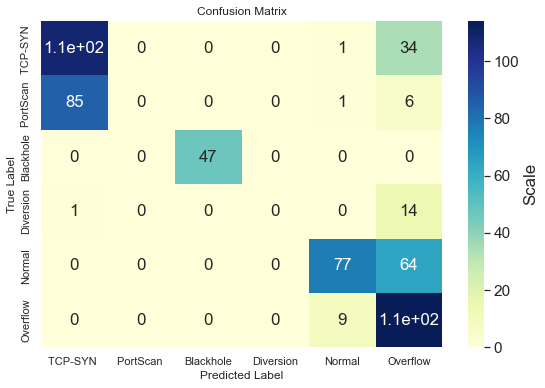

_________________________
|At PCA n_components= 20 |
_________________________

Epoch 1/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.4058 - accuracy: 0.4521 - val_loss: 1.1707 - val_accuracy: 0.5312
Epoch 2/50
2619/2619 [==============================] - 6s 2ms/step - loss: 1.1107 - accuracy: 0.5708 - val_loss: 1.0879 - val_accuracy: 0.6364
Epoch 3/50
2619/2619 [==============================] - 6s 2ms/step - loss: 1.0655 - accuracy: 0.5853 - val_loss: 1.0404 - val_accuracy: 0.5579
Epoch 4/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0547 - accuracy: 0.5724 - val_loss: 1.0449 - val_accuracy: 0.5954
Epoch 5/50
2619/2619 [==============================] - 6s 2ms/step - loss: 1.0524 - accuracy: 0.5846 - val_loss: 1.0374 - val_accuracy: 0.5544
Epoch 6/50
2619/2619 [==============================] - 7s 2ms/step - loss: 1.0542 - accuracy: 0.5590 - val_loss: 1.0394 - val_accuracy: 0.6061
Epoch 7/50
2619/2619 [==============================] - 

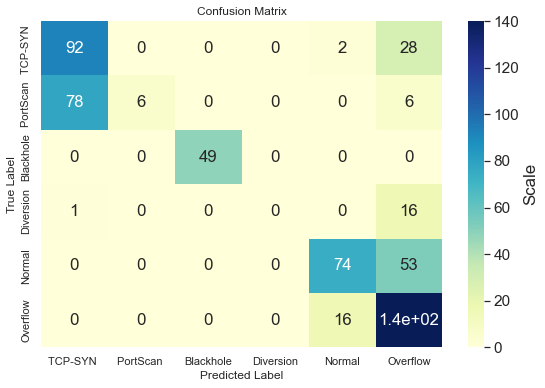

Confusion Matrix __ of Valadation


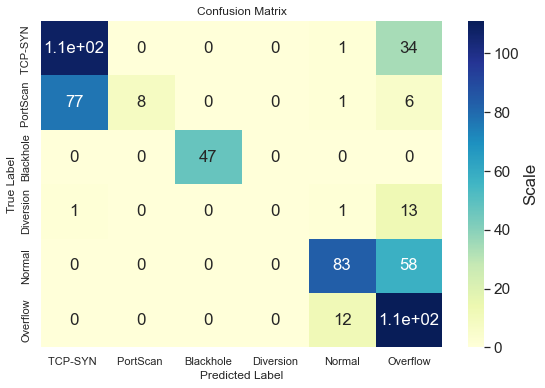

_________________________
|At PCA n_components= 21 |
_________________________

Epoch 1/50
2619/2619 [==============================] - 8s 3ms/step - loss: 1.4482 - accuracy: 0.4483 - val_loss: 1.1851 - val_accuracy: 0.5508
Epoch 2/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.1246 - accuracy: 0.5498 - val_loss: 1.0682 - val_accuracy: 0.5294
Epoch 3/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0688 - accuracy: 0.5655 - val_loss: 1.0314 - val_accuracy: 0.6185
Epoch 4/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0488 - accuracy: 0.5804 - val_loss: 1.0414 - val_accuracy: 0.6150
Epoch 5/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0507 - accuracy: 0.5785 - val_loss: 1.0316 - val_accuracy: 0.6310
Epoch 6/50
2619/2619 [==============================] - 7s 3ms/step - loss: 1.0506 - accuracy: 0.5853 - val_loss: 1.0227 - val_accuracy: 0.6221
Epoch 7/50
2619/2619 [==============================] - 

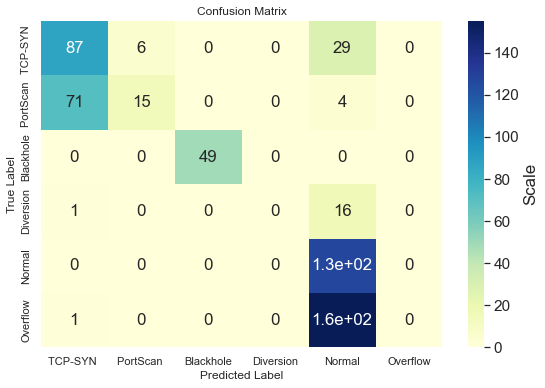

Confusion Matrix __ of Valadation


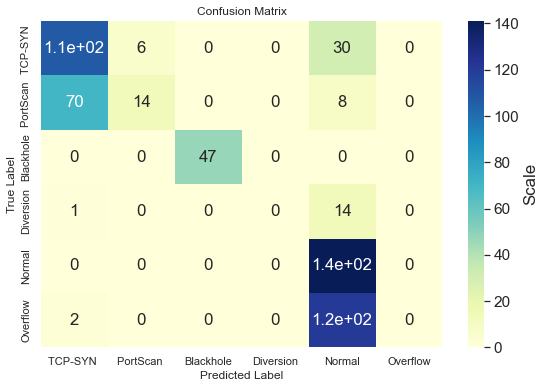

In [ ]:
from sklearn.decomposition import PCA
import keras
from keras.layers import Input, Dense, Flatten
from keras.models import Model
from sklearn.metrics import confusion_matrix
#from keras_adamw import AdamW
MLP_train_acc = []
MLP_val_acc = []
MLP_test_acc = []
confusion_test=[]
confusion_valdation=[]

for i in range(2,22):
    pca = PCA(n_components=i)
    train_x_pca = pca.fit_transform(trainX_scaled)
    val_x_pca = pca.transform(valX_scaled)
    test_x_pca = pca.transform(testX_scaled)

  # MLP Model
    optimizer=tfaAdamw.optimizers.AdamW(learning_rate= 0.001, weight_decay= 0.001)

    model_pca = keras.models.Sequential()
    model_pca.add(Dense(10, input_shape = (i,), activation = 'relu'))
    model_pca.add(Dense(6, activation = "softmax"))
    model_pca.compile(optimizer=optimizer, loss="sparse_categorical_crossentropy", metrics = ["accuracy"])
    print("_________________________")
    print("|At PCA n_components=",i,"|")
    print("_________________________\n")
    model_pca.fit(train_x_pca, train_y, validation_data=(val_x_pca, val_y), epochs=50, batch_size=1)
 
    y_pred = np.argmax(model_pca.predict(test_x_pca), axis=-1)

    MLP_training_score = model_pca.evaluate(train_x_pca,train_y, verbose=0)[1]
    MLP_val_score = model_pca.evaluate(val_x_pca,val_y, verbose=0)[1]
    MLP_test_score = model_pca.evaluate(test_x_pca,test_y, verbose=0)[1]

    print("Training_score ",MLP_training_score)
    print("Validation_score :",MLP_val_score)
    print("Testing_score :",MLP_test_score)
    print('\n',"*************")
    MLP_train_acc.append(MLP_training_score)
    MLP_val_acc.append(MLP_val_score)
    MLP_test_acc.append(MLP_test_score)
    y_pred = np.argmax(model_pca.predict(test_x_pca), axis=-1)
    data= confusion_matrix(test_y, y_pred)
    confusion_test.append(data)
    labels =['TCP-SYN ','PortScan ','Blackhole','Diversion','Normal','Overflow']
    print("Confusion Matrix __ of Testing")
    plot_confusion_matrix(data,labels)
    y_pred = np.argmax(model_pca.predict(val_x_pca), axis=-1)
    data2= confusion_matrix(val_y, y_pred)
    confusion_valdation.append(data2)
    print("Confusion Matrix __ of Valadation")
    plot_confusion_matrix(data2,labels)


Text(0, 0.5, 'accuracy')

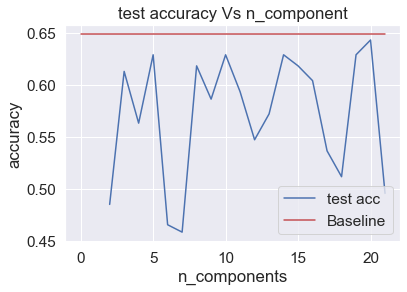

In [ ]:
plt.plot(range(2,22),MLP_test_accPCA)
plt.plot(range(0,22),[baseline_acc]*22,'r')
plt.legend(['test acc', 'Baseline']) 
plt.title('test accuracy Vs n_component')
plt.xlabel('n_components')
plt.ylabel('accuracy')

In [ ]:
Best_number_ofComponent=np.argmax(MLP_test_acc)+1
Best_number_ofComponent

19

In [ ]:
print("Best number of Compnent gives maximum accuaracy is :",MLP_test_acc[Best_number_ofComponent-1])

Best number of Compnent gives maximum accuaracy is : 0.6434937715530396


In [ ]:
from numpy import asarray
from numpy import savetxt

In [ ]:
savetxt('PCA_test2.csv', MLP_test_acc, delimiter=',')
savetxt('PCA_valadation2.csv', MLP_test_acc, delimiter=',')

In [ ]:
savetxt('PCA_valadation22.csv', MLP_val_acc, delimiter=',')

## TSNE

### Training dataset 

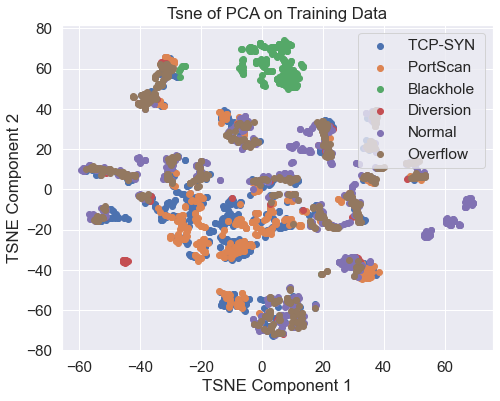

In [ ]:
plot_tsne(train_x_pca, train_y, "Tsne of PCA on Training Data")

### Test dataset

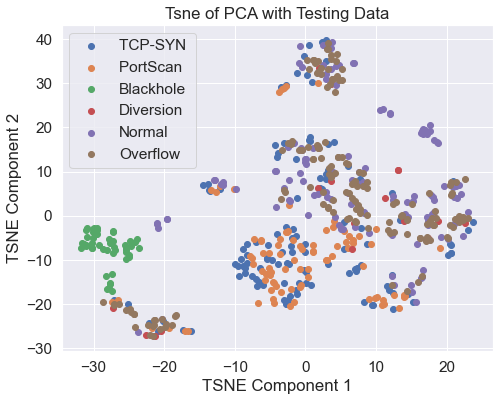

In [ ]:
plot_tsne(test_x_pca, test_y, "Tsne of PCA with Testing Data")

## 2)  Feature selection

### ANOVA

In [ ]:
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_classif
import keras
from keras.layers import Input, Dense, Flatten
from keras.models import Model
from sklearn.metrics import confusion_matrix

Epoch 1/100
2619/2619 [==============================] - 2s 585us/step - loss: 1.4224 - accuracy: 0.3998 - val_loss: 1.2843 - val_accuracy: 0.4349
Epoch 2/100
2619/2619 [==============================] - 1s 545us/step - loss: 1.2387 - accuracy: 0.4681 - val_loss: 1.2228 - val_accuracy: 0.4385
Epoch 3/100
2619/2619 [==============================] - 1s 534us/step - loss: 1.2092 - accuracy: 0.4826 - val_loss: 1.2117 - val_accuracy: 0.4385
Epoch 4/100
2619/2619 [==============================] - 1s 547us/step - loss: 1.1997 - accuracy: 0.4826 - val_loss: 1.2011 - val_accuracy: 0.5062
Epoch 5/100
2619/2619 [==============================] - 1s 536us/step - loss: 1.1952 - accuracy: 0.4891 - val_loss: 1.1927 - val_accuracy: 0.5276
Epoch 6/100
2619/2619 [==============================] - 1s 546us/step - loss: 1.1909 - accuracy: 0.4979 - val_loss: 1.1993 - val_accuracy: 0.4421
Epoch 7/100
2619/2619 [==============================] - 1s 538us/step - loss: 1.1913 - accuracy: 0.4956 - val_loss: 1

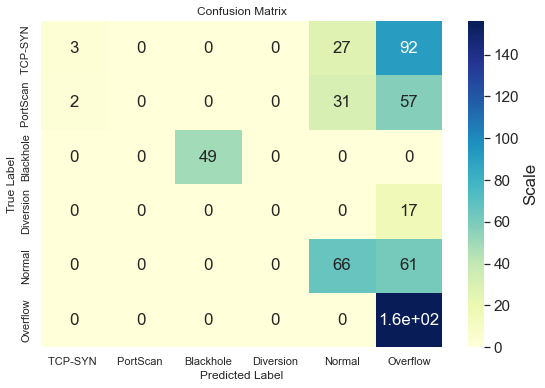

Confusion Matrix __ of Valadation


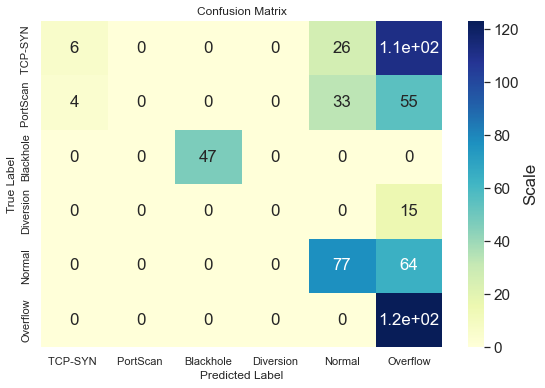

Epoch 1/100
2619/2619 [==============================] - 2s 571us/step - loss: 1.4216 - accuracy: 0.3975 - val_loss: 1.2926 - val_accuracy: 0.4314
Epoch 2/100
2619/2619 [==============================] - 1s 537us/step - loss: 1.2526 - accuracy: 0.4601 - val_loss: 1.2473 - val_accuracy: 0.5009
Epoch 3/100
2619/2619 [==============================] - 1s 540us/step - loss: 1.2257 - accuracy: 0.4719 - val_loss: 1.2181 - val_accuracy: 0.4599
Epoch 4/100
2619/2619 [==============================] - 1s 537us/step - loss: 1.2050 - accuracy: 0.4792 - val_loss: 1.2050 - val_accuracy: 0.4385
Epoch 5/100
2619/2619 [==============================] - 1s 544us/step - loss: 1.1929 - accuracy: 0.4830 - val_loss: 1.1942 - val_accuracy: 0.4403
Epoch 6/100
2619/2619 [==============================] - 1s 540us/step - loss: 1.1884 - accuracy: 0.4822 - val_loss: 1.1886 - val_accuracy: 0.4403
Epoch 7/100
2619/2619 [==============================] - 1s 531us/step - loss: 1.1875 - accuracy: 0.4891 - val_loss: 1

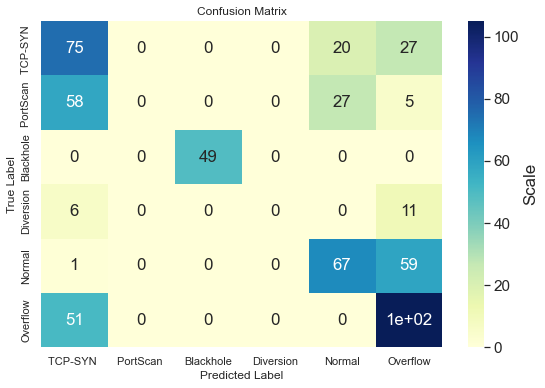

Confusion Matrix __ of Valadation


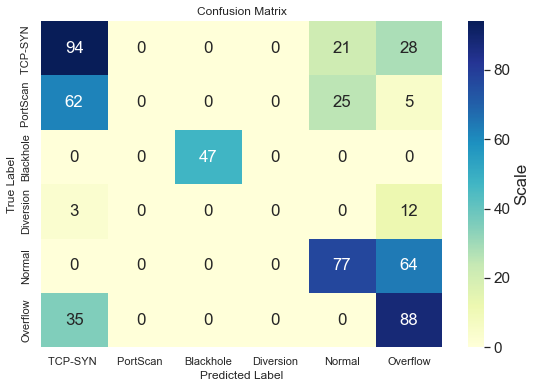

Epoch 1/100
2619/2619 [==============================] - 2s 581us/step - loss: 1.0449 - accuracy: 0.5735 - val_loss: 0.8257 - val_accuracy: 0.6453
Epoch 2/100
2619/2619 [==============================] - 1s 542us/step - loss: 0.8170 - accuracy: 0.6438 - val_loss: 0.7799 - val_accuracy: 0.6667
Epoch 3/100
2619/2619 [==============================] - 1s 534us/step - loss: 0.7960 - accuracy: 0.6552 - val_loss: 0.7683 - val_accuracy: 0.6774
Epoch 4/100
2619/2619 [==============================] - 1s 535us/step - loss: 0.7881 - accuracy: 0.6575 - val_loss: 0.7572 - val_accuracy: 0.6809
Epoch 5/100
2619/2619 [==============================] - 1s 546us/step - loss: 0.7843 - accuracy: 0.6560 - val_loss: 0.7548 - val_accuracy: 0.6649
Epoch 6/100
2619/2619 [==============================] - 1s 553us/step - loss: 0.7801 - accuracy: 0.6663 - val_loss: 0.7460 - val_accuracy: 0.6881
Epoch 7/100
2619/2619 [==============================] - 1s 556us/step - loss: 0.7760 - accuracy: 0.6686 - val_loss: 0

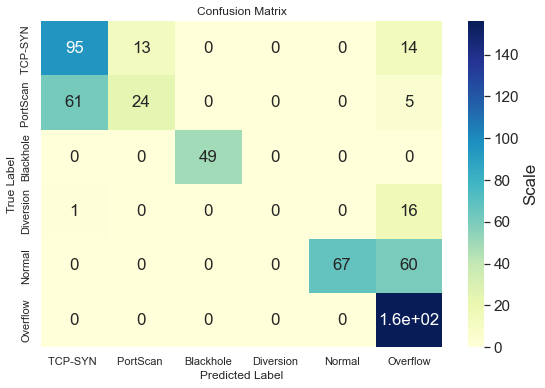

Confusion Matrix __ of Valadation


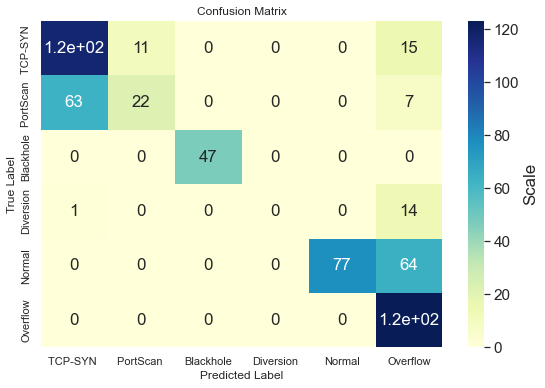

Epoch 1/100
2619/2619 [==============================] - 2s 623us/step - loss: 1.0767 - accuracy: 0.5727 - val_loss: 0.8367 - val_accuracy: 0.6453
Epoch 2/100
2619/2619 [==============================] - 1s 530us/step - loss: 0.8297 - accuracy: 0.6514 - val_loss: 0.7818 - val_accuracy: 0.6845
Epoch 3/100
2619/2619 [==============================] - 1s 537us/step - loss: 0.8019 - accuracy: 0.6648 - val_loss: 0.7742 - val_accuracy: 0.6506
Epoch 4/100
2619/2619 [==============================] - 1s 547us/step - loss: 0.7950 - accuracy: 0.6594 - val_loss: 0.7716 - val_accuracy: 0.6684
Epoch 5/100
2619/2619 [==============================] - 1s 545us/step - loss: 0.7932 - accuracy: 0.6579 - val_loss: 0.7637 - val_accuracy: 0.6809
Epoch 6/100
2619/2619 [==============================] - 1s 531us/step - loss: 0.7942 - accuracy: 0.6655 - val_loss: 0.7608 - val_accuracy: 0.6845
Epoch 7/100
2619/2619 [==============================] - 1s 534us/step - loss: 0.7928 - accuracy: 0.6602 - val_loss: 0

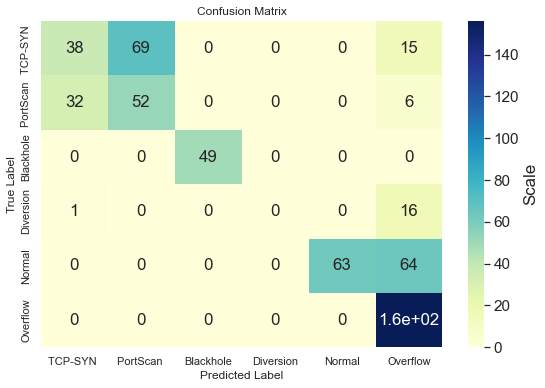

Confusion Matrix __ of Valadation


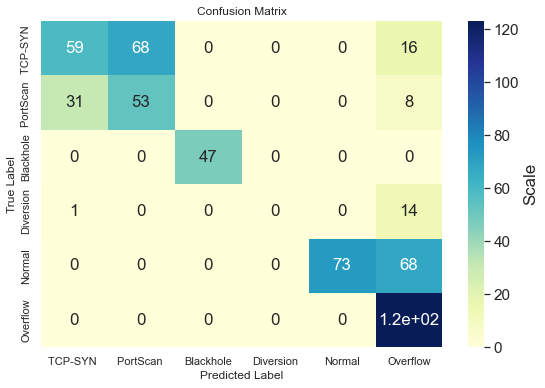

Epoch 1/100
2619/2619 [==============================] - 2s 583us/step - loss: 1.0514 - accuracy: 0.5628 - val_loss: 0.8602 - val_accuracy: 0.6488
Epoch 2/100
2619/2619 [==============================] - 1s 549us/step - loss: 0.8357 - accuracy: 0.6422 - val_loss: 0.7893 - val_accuracy: 0.6631
Epoch 3/100
2619/2619 [==============================] - 1s 533us/step - loss: 0.8007 - accuracy: 0.6564 - val_loss: 0.7657 - val_accuracy: 0.6649
Epoch 4/100
2619/2619 [==============================] - 1s 555us/step - loss: 0.7869 - accuracy: 0.6613 - val_loss: 0.7550 - val_accuracy: 0.6702
Epoch 5/100
2619/2619 [==============================] - 1s 544us/step - loss: 0.7795 - accuracy: 0.6598 - val_loss: 0.7444 - val_accuracy: 0.6756
Epoch 6/100
2619/2619 [==============================] - 1s 528us/step - loss: 0.7809 - accuracy: 0.6625 - val_loss: 0.7493 - val_accuracy: 0.6684
Epoch 7/100
2619/2619 [==============================] - 1s 542us/step - loss: 0.7788 - accuracy: 0.6571 - val_loss: 0

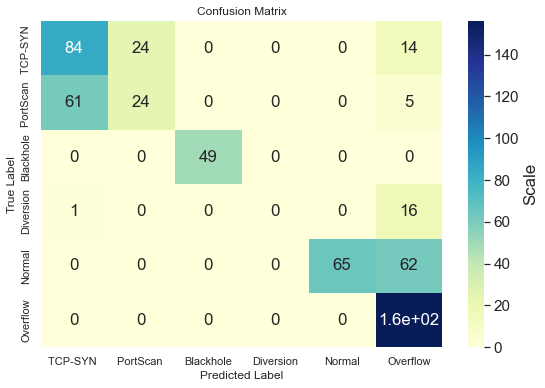

Confusion Matrix __ of Valadation


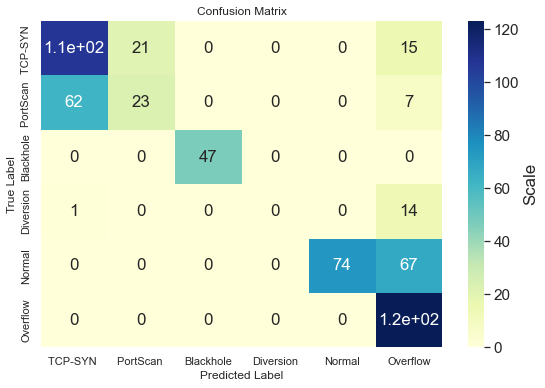

Epoch 1/100
2619/2619 [==============================] - 2s 562us/step - loss: 1.0865 - accuracy: 0.5491 - val_loss: 0.8228 - val_accuracy: 0.6524
Epoch 2/100
2619/2619 [==============================] - 1s 542us/step - loss: 0.8202 - accuracy: 0.6648 - val_loss: 0.7814 - val_accuracy: 0.6684
Epoch 3/100
2619/2619 [==============================] - 1s 558us/step - loss: 0.7976 - accuracy: 0.6655 - val_loss: 0.7644 - val_accuracy: 0.6684
Epoch 4/100
2619/2619 [==============================] - 1s 542us/step - loss: 0.7870 - accuracy: 0.6686 - val_loss: 0.7561 - val_accuracy: 0.6774
Epoch 5/100
2619/2619 [==============================] - 1s 548us/step - loss: 0.7821 - accuracy: 0.6693 - val_loss: 0.7472 - val_accuracy: 0.6738
Epoch 6/100
2619/2619 [==============================] - 1s 533us/step - loss: 0.7755 - accuracy: 0.6739 - val_loss: 0.7359 - val_accuracy: 0.6809
Epoch 7/100
2619/2619 [==============================] - 1s 538us/step - loss: 0.7708 - accuracy: 0.6789 - val_loss: 0

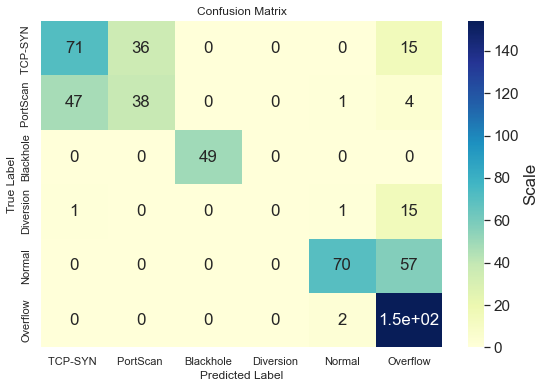

Confusion Matrix __ of Valadation


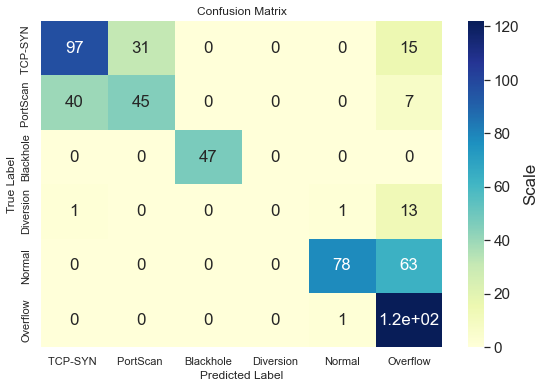

Epoch 1/100
2619/2619 [==============================] - 2s 564us/step - loss: 1.1596 - accuracy: 0.5632 - val_loss: 0.8528 - val_accuracy: 0.6488
Epoch 2/100
2619/2619 [==============================] - 1s 536us/step - loss: 0.8194 - accuracy: 0.6628 - val_loss: 0.7777 - val_accuracy: 0.6827
Epoch 3/100
2619/2619 [==============================] - 1s 551us/step - loss: 0.7830 - accuracy: 0.6777 - val_loss: 0.7533 - val_accuracy: 0.6881
Epoch 4/100
2619/2619 [==============================] - 1s 542us/step - loss: 0.7683 - accuracy: 0.6762 - val_loss: 0.7537 - val_accuracy: 0.6881
Epoch 5/100
2619/2619 [==============================] - 2s 606us/step - loss: 0.7632 - accuracy: 0.6812 - val_loss: 0.7348 - val_accuracy: 0.6774
Epoch 6/100
2619/2619 [==============================] - 1s 539us/step - loss: 0.7584 - accuracy: 0.6838 - val_loss: 0.7368 - val_accuracy: 0.6684
Epoch 7/100
2619/2619 [==============================] - 1s 537us/step - loss: 0.7548 - accuracy: 0.6831 - val_loss: 0

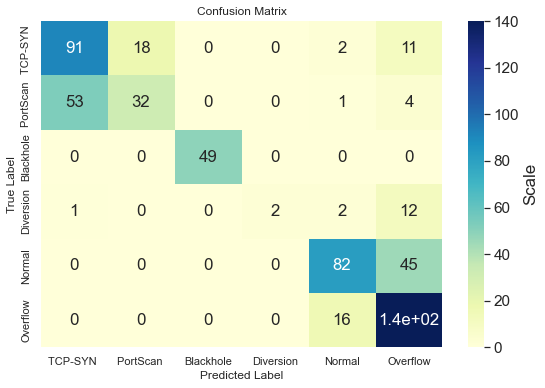

Confusion Matrix __ of Valadation


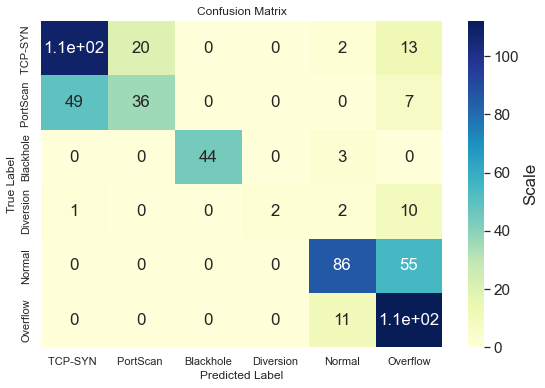

Epoch 1/100
2619/2619 [==============================] - 2s 578us/step - loss: 1.3228 - accuracy: 0.4822 - val_loss: 0.9001 - val_accuracy: 0.6791
Epoch 2/100
2619/2619 [==============================] - 1s 544us/step - loss: 0.8299 - accuracy: 0.6659 - val_loss: 0.7632 - val_accuracy: 0.7094
Epoch 3/100
2619/2619 [==============================] - 1s 540us/step - loss: 0.7580 - accuracy: 0.6888 - val_loss: 0.7234 - val_accuracy: 0.7077
Epoch 4/100
2619/2619 [==============================] - 1s 553us/step - loss: 0.7354 - accuracy: 0.6968 - val_loss: 0.7078 - val_accuracy: 0.7094
Epoch 5/100
2619/2619 [==============================] - 1s 541us/step - loss: 0.7277 - accuracy: 0.7056 - val_loss: 0.7003 - val_accuracy: 0.7201
Epoch 6/100
2619/2619 [==============================] - 1s 548us/step - loss: 0.7257 - accuracy: 0.7102 - val_loss: 0.6962 - val_accuracy: 0.7219
Epoch 7/100
2619/2619 [==============================] - 1s 536us/step - loss: 0.7209 - accuracy: 0.7182 - val_loss: 0

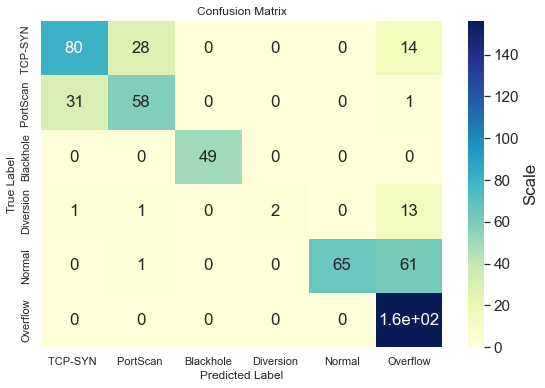

Confusion Matrix __ of Valadation


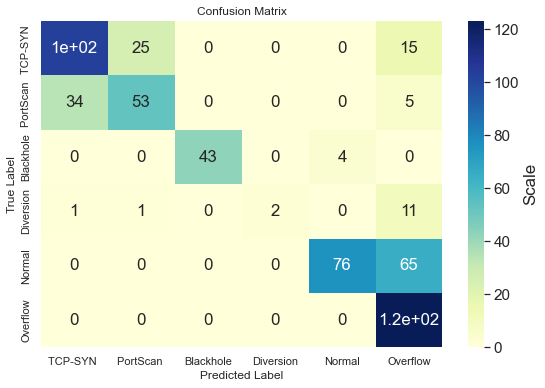

Epoch 1/100
2619/2619 [==============================] - 2s 566us/step - loss: 1.1345 - accuracy: 0.4849 - val_loss: 0.8412 - val_accuracy: 0.6631
Epoch 2/100
2619/2619 [==============================] - 1s 530us/step - loss: 0.8122 - accuracy: 0.6529 - val_loss: 0.7503 - val_accuracy: 0.6845
Epoch 3/100
2619/2619 [==============================] - 1s 535us/step - loss: 0.7546 - accuracy: 0.6907 - val_loss: 0.7167 - val_accuracy: 0.7077
Epoch 4/100
2619/2619 [==============================] - 1s 546us/step - loss: 0.7314 - accuracy: 0.7010 - val_loss: 0.7054 - val_accuracy: 0.7112
Epoch 5/100
2619/2619 [==============================] - 1s 536us/step - loss: 0.7214 - accuracy: 0.7090 - val_loss: 0.7050 - val_accuracy: 0.7166
Epoch 6/100
2619/2619 [==============================] - 1s 533us/step - loss: 0.7171 - accuracy: 0.7140 - val_loss: 0.6908 - val_accuracy: 0.7077
Epoch 7/100
2619/2619 [==============================] - 1s 541us/step - loss: 0.7162 - accuracy: 0.7117 - val_loss: 0

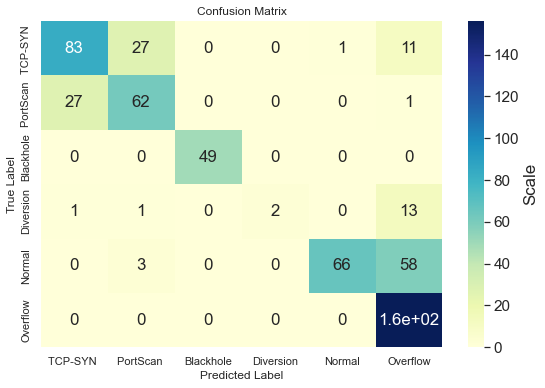

Confusion Matrix __ of Valadation


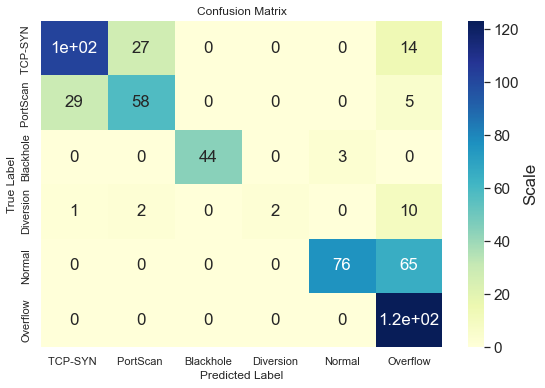

Epoch 1/100
2619/2619 [==============================] - 2s 577us/step - loss: 1.0573 - accuracy: 0.5876 - val_loss: 0.7996 - val_accuracy: 0.6988
Epoch 2/100
2619/2619 [==============================] - 1s 554us/step - loss: 0.7764 - accuracy: 0.6922 - val_loss: 0.7157 - val_accuracy: 0.7166
Epoch 3/100
2619/2619 [==============================] - 1s 561us/step - loss: 0.7370 - accuracy: 0.6999 - val_loss: 0.6947 - val_accuracy: 0.7237
Epoch 4/100
2619/2619 [==============================] - 1s 554us/step - loss: 0.7199 - accuracy: 0.7129 - val_loss: 0.6850 - val_accuracy: 0.7308
Epoch 5/100
2619/2619 [==============================] - 1s 554us/step - loss: 0.7114 - accuracy: 0.7171 - val_loss: 0.6764 - val_accuracy: 0.7362
Epoch 6/100
2619/2619 [==============================] - 1s 554us/step - loss: 0.7089 - accuracy: 0.7174 - val_loss: 0.6863 - val_accuracy: 0.7362
Epoch 7/100
2619/2619 [==============================] - 1s 555us/step - loss: 0.7096 - accuracy: 0.7232 - val_loss: 0

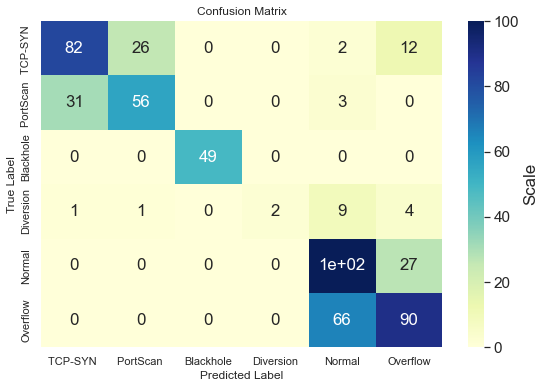

Confusion Matrix __ of Valadation


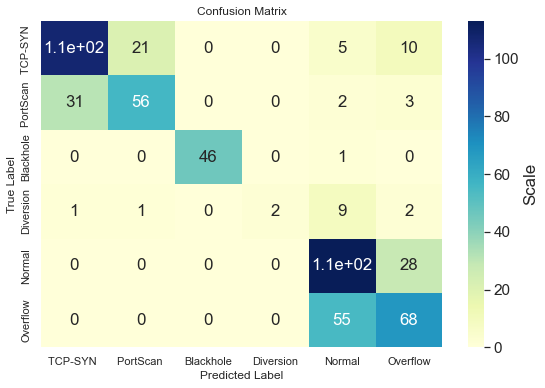

Epoch 1/100
2619/2619 [==============================] - 2s 604us/step - loss: 1.0512 - accuracy: 0.5712 - val_loss: 0.7959 - val_accuracy: 0.6863
Epoch 2/100
2619/2619 [==============================] - 1s 523us/step - loss: 0.7727 - accuracy: 0.6919 - val_loss: 0.7352 - val_accuracy: 0.6613
Epoch 3/100
2619/2619 [==============================] - 1s 525us/step - loss: 0.7328 - accuracy: 0.7022 - val_loss: 0.7116 - val_accuracy: 0.7094
Epoch 4/100
2619/2619 [==============================] - 1s 537us/step - loss: 0.7182 - accuracy: 0.7075 - val_loss: 0.7045 - val_accuracy: 0.7077
Epoch 5/100
2619/2619 [==============================] - 1s 523us/step - loss: 0.7117 - accuracy: 0.7026 - val_loss: 0.7075 - val_accuracy: 0.6524
Epoch 6/100
2619/2619 [==============================] - 1s 532us/step - loss: 0.7130 - accuracy: 0.7052 - val_loss: 0.6950 - val_accuracy: 0.7219
Epoch 7/100
2619/2619 [==============================] - 1s 527us/step - loss: 0.7085 - accuracy: 0.7052 - val_loss: 0

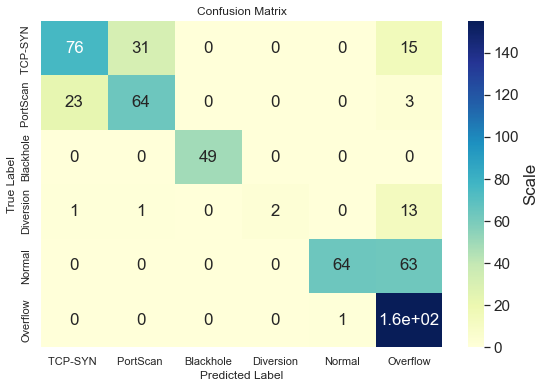

Confusion Matrix __ of Valadation


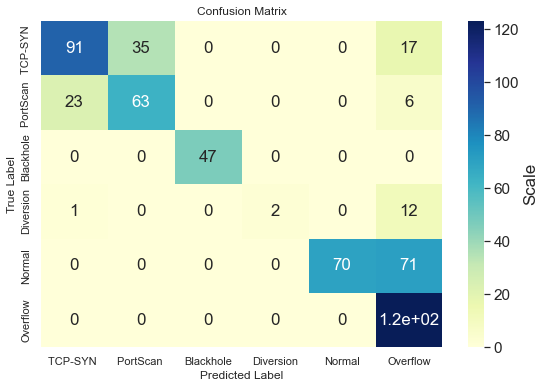

Epoch 1/100
2619/2619 [==============================] - 2s 575us/step - loss: 1.0703 - accuracy: 0.5571 - val_loss: 0.8398 - val_accuracy: 0.6364
Epoch 2/100
2619/2619 [==============================] - 1s 563us/step - loss: 0.7940 - accuracy: 0.6747 - val_loss: 0.7476 - val_accuracy: 0.6774
Epoch 3/100
2619/2619 [==============================] - 1s 548us/step - loss: 0.7457 - accuracy: 0.6816 - val_loss: 0.7212 - val_accuracy: 0.6970
Epoch 4/100
2619/2619 [==============================] - 1s 555us/step - loss: 0.7246 - accuracy: 0.6976 - val_loss: 0.7114 - val_accuracy: 0.6952
Epoch 5/100
2619/2619 [==============================] - 1s 548us/step - loss: 0.7124 - accuracy: 0.6953 - val_loss: 0.7014 - val_accuracy: 0.7041
Epoch 6/100
2619/2619 [==============================] - 1s 555us/step - loss: 0.7121 - accuracy: 0.7003 - val_loss: 0.6953 - val_accuracy: 0.7166
Epoch 7/100
2619/2619 [==============================] - 1s 547us/step - loss: 0.7087 - accuracy: 0.6984 - val_loss: 0

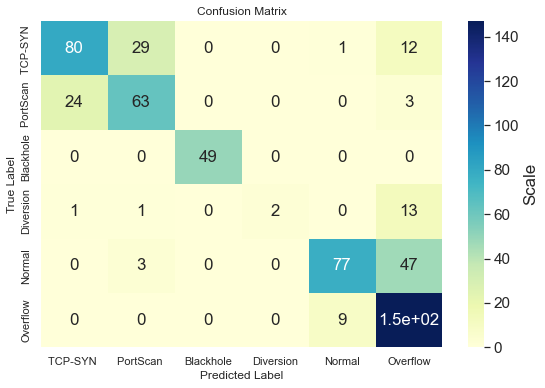

Confusion Matrix __ of Valadation


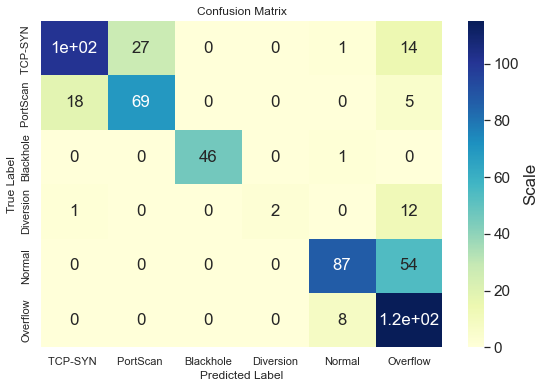

Epoch 1/100
2619/2619 [==============================] - 2s 564us/step - loss: 1.1588 - accuracy: 0.5147 - val_loss: 0.8531 - val_accuracy: 0.6542
Epoch 2/100
2619/2619 [==============================] - 1s 550us/step - loss: 0.8095 - accuracy: 0.6579 - val_loss: 0.7374 - val_accuracy: 0.6845
Epoch 3/100
2619/2619 [==============================] - 1s 525us/step - loss: 0.7344 - accuracy: 0.6827 - val_loss: 0.7069 - val_accuracy: 0.7112
Epoch 4/100
2619/2619 [==============================] - 1s 541us/step - loss: 0.7164 - accuracy: 0.6972 - val_loss: 0.6978 - val_accuracy: 0.7255
Epoch 5/100
2619/2619 [==============================] - 1s 541us/step - loss: 0.7098 - accuracy: 0.7014 - val_loss: 0.6982 - val_accuracy: 0.7148
Epoch 6/100
2619/2619 [==============================] - 1s 542us/step - loss: 0.7069 - accuracy: 0.7006 - val_loss: 0.6871 - val_accuracy: 0.7166
Epoch 7/100
2619/2619 [==============================] - 1s 529us/step - loss: 0.7034 - accuracy: 0.7121 - val_loss: 0

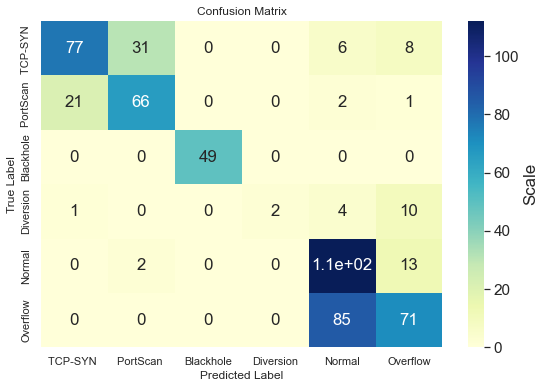

Confusion Matrix __ of Valadation


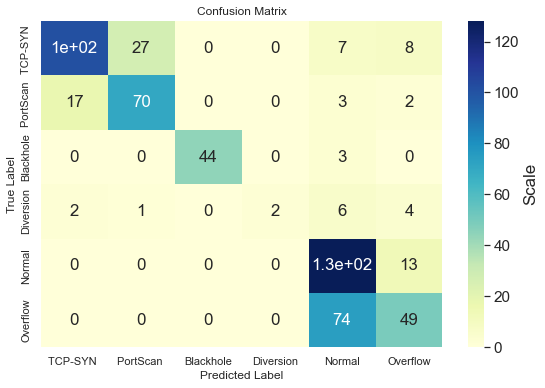

Epoch 1/100
2619/2619 [==============================] - 2s 586us/step - loss: 1.1170 - accuracy: 0.5510 - val_loss: 0.8217 - val_accuracy: 0.6613
Epoch 2/100
2619/2619 [==============================] - 1s 556us/step - loss: 0.7756 - accuracy: 0.6724 - val_loss: 0.7337 - val_accuracy: 0.6952
Epoch 3/100
2619/2619 [==============================] - 1s 560us/step - loss: 0.7338 - accuracy: 0.6911 - val_loss: 0.7148 - val_accuracy: 0.7005
Epoch 4/100
2619/2619 [==============================] - 1s 554us/step - loss: 0.7196 - accuracy: 0.6934 - val_loss: 0.6955 - val_accuracy: 0.7308
Epoch 5/100
2619/2619 [==============================] - 1s 566us/step - loss: 0.7115 - accuracy: 0.7037 - val_loss: 0.7001 - val_accuracy: 0.7112
Epoch 6/100
2619/2619 [==============================] - 1s 564us/step - loss: 0.7083 - accuracy: 0.7087 - val_loss: 0.6890 - val_accuracy: 0.7219
Epoch 7/100
2619/2619 [==============================] - 2s 578us/step - loss: 0.7068 - accuracy: 0.7060 - val_loss: 0

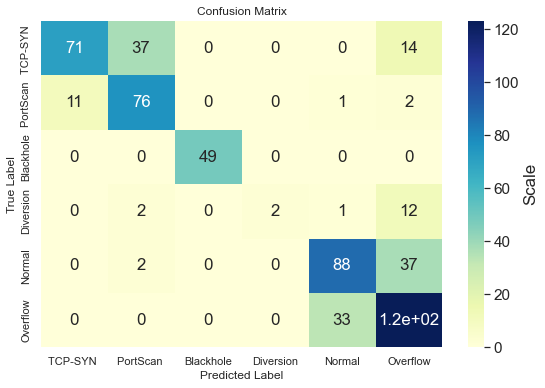

Confusion Matrix __ of Valadation


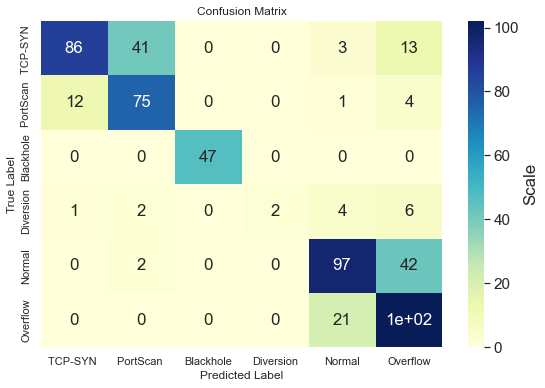

Epoch 1/100
2619/2619 [==============================] - 2s 569us/step - loss: 1.1246 - accuracy: 0.5212 - val_loss: 0.8617 - val_accuracy: 0.6185
Epoch 2/100
2619/2619 [==============================] - 1s 537us/step - loss: 0.8185 - accuracy: 0.6449 - val_loss: 0.7540 - val_accuracy: 0.6934
Epoch 3/100
2619/2619 [==============================] - 1s 541us/step - loss: 0.7511 - accuracy: 0.6831 - val_loss: 0.7058 - val_accuracy: 0.7219
Epoch 4/100
2619/2619 [==============================] - 1s 535us/step - loss: 0.7231 - accuracy: 0.6953 - val_loss: 0.6954 - val_accuracy: 0.7184
Epoch 5/100
2619/2619 [==============================] - 1s 552us/step - loss: 0.7122 - accuracy: 0.7003 - val_loss: 0.6829 - val_accuracy: 0.7237
Epoch 6/100
2619/2619 [==============================] - 1s 534us/step - loss: 0.7056 - accuracy: 0.7033 - val_loss: 0.6804 - val_accuracy: 0.7255
Epoch 7/100
2619/2619 [==============================] - 1s 543us/step - loss: 0.7032 - accuracy: 0.7102 - val_loss: 0

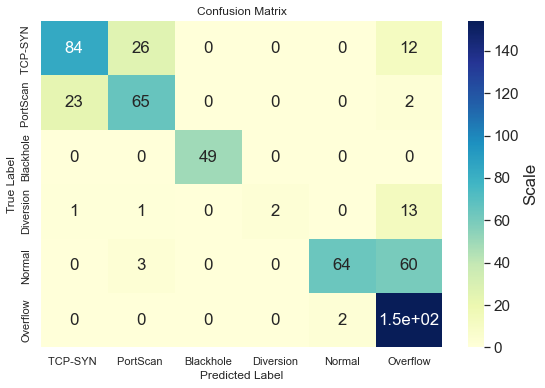

Confusion Matrix __ of Valadation


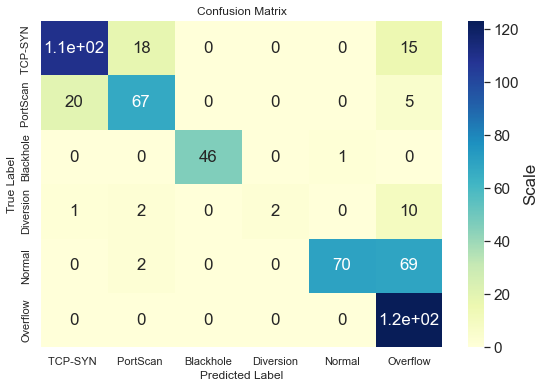

Epoch 1/100
2619/2619 [==============================] - 2s 590us/step - loss: 1.0970 - accuracy: 0.5731 - val_loss: 0.7934 - val_accuracy: 0.6542
Epoch 2/100
2619/2619 [==============================] - 1s 557us/step - loss: 0.7650 - accuracy: 0.6858 - val_loss: 0.7269 - val_accuracy: 0.7148
Epoch 3/100
2619/2619 [==============================] - 1s 557us/step - loss: 0.7284 - accuracy: 0.6991 - val_loss: 0.7074 - val_accuracy: 0.6916
Epoch 4/100
2619/2619 [==============================] - 1s 571us/step - loss: 0.7149 - accuracy: 0.7006 - val_loss: 0.6878 - val_accuracy: 0.7255
Epoch 5/100
2619/2619 [==============================] - 1s 552us/step - loss: 0.7091 - accuracy: 0.7033 - val_loss: 0.6847 - val_accuracy: 0.7237
Epoch 6/100
2619/2619 [==============================] - 1s 563us/step - loss: 0.7039 - accuracy: 0.7033 - val_loss: 0.6751 - val_accuracy: 0.7291
Epoch 7/100
2619/2619 [==============================] - 1s 556us/step - loss: 0.7028 - accuracy: 0.7071 - val_loss: 0

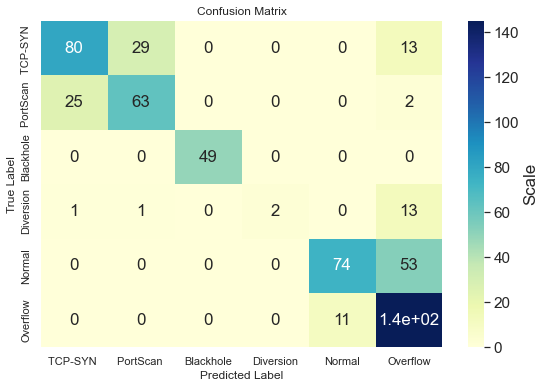

Confusion Matrix __ of Valadation


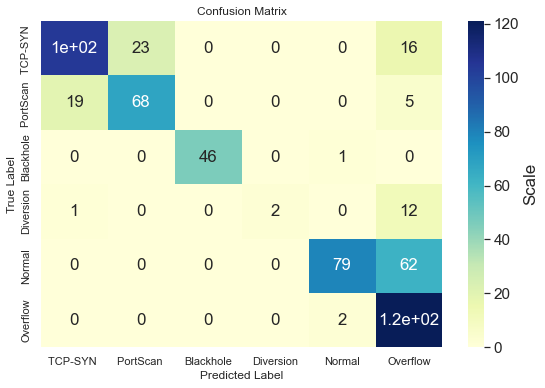

Epoch 1/100
2619/2619 [==============================] - 2s 564us/step - loss: 1.0401 - accuracy: 0.5762 - val_loss: 0.7874 - val_accuracy: 0.6845
Epoch 2/100
2619/2619 [==============================] - 1s 545us/step - loss: 0.7844 - accuracy: 0.6716 - val_loss: 0.7354 - val_accuracy: 0.7023
Epoch 3/100
2619/2619 [==============================] - 1s 533us/step - loss: 0.7421 - accuracy: 0.6984 - val_loss: 0.7096 - val_accuracy: 0.7237
Epoch 4/100
2619/2619 [==============================] - 1s 543us/step - loss: 0.7235 - accuracy: 0.7018 - val_loss: 0.6926 - val_accuracy: 0.7166
Epoch 5/100
2619/2619 [==============================] - 1s 535us/step - loss: 0.7118 - accuracy: 0.7117 - val_loss: 0.6881 - val_accuracy: 0.7237
Epoch 6/100
2619/2619 [==============================] - 1s 545us/step - loss: 0.7042 - accuracy: 0.7106 - val_loss: 0.6843 - val_accuracy: 0.7184
Epoch 7/100
2619/2619 [==============================] - 1s 541us/step - loss: 0.7045 - accuracy: 0.7106 - val_loss: 0

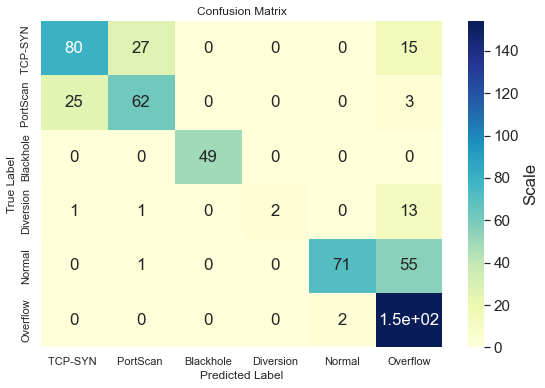

Confusion Matrix __ of Valadation


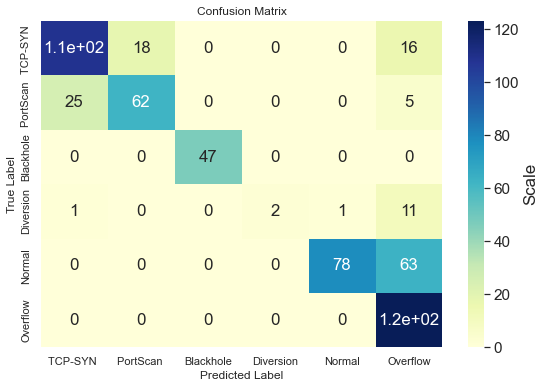

Epoch 1/100
2619/2619 [==============================] - 2s 581us/step - loss: 1.1355 - accuracy: 0.5338 - val_loss: 0.8520 - val_accuracy: 0.6667
Epoch 2/100
2619/2619 [==============================] - 1s 562us/step - loss: 0.8052 - accuracy: 0.6655 - val_loss: 0.7378 - val_accuracy: 0.6934
Epoch 3/100
2619/2619 [==============================] - 1s 568us/step - loss: 0.7500 - accuracy: 0.6735 - val_loss: 0.7268 - val_accuracy: 0.7184
Epoch 4/100
2619/2619 [==============================] - 1s 560us/step - loss: 0.7283 - accuracy: 0.6808 - val_loss: 0.7132 - val_accuracy: 0.7166
Epoch 5/100
2619/2619 [==============================] - 1s 563us/step - loss: 0.7223 - accuracy: 0.6972 - val_loss: 0.7069 - val_accuracy: 0.7237
Epoch 6/100
2619/2619 [==============================] - 1s 564us/step - loss: 0.7149 - accuracy: 0.6995 - val_loss: 0.7011 - val_accuracy: 0.7023
Epoch 7/100
2619/2619 [==============================] - 1s 556us/step - loss: 0.7125 - accuracy: 0.7033 - val_loss: 0

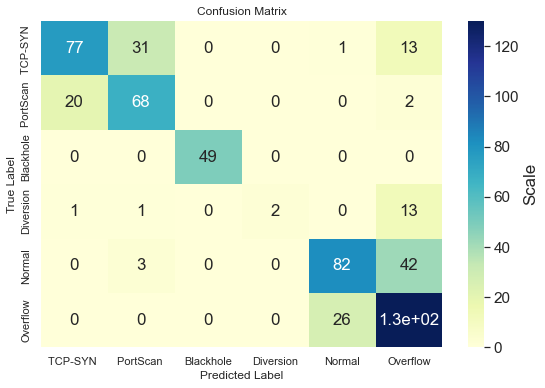

Confusion Matrix __ of Valadation


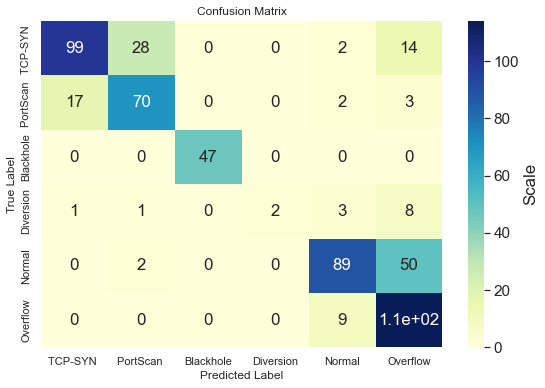

Epoch 1/100
2619/2619 [==============================] - 2s 558us/step - loss: 1.0487 - accuracy: 0.5876 - val_loss: 0.8221 - val_accuracy: 0.6506
Epoch 2/100
2619/2619 [==============================] - 1s 535us/step - loss: 0.7939 - accuracy: 0.6644 - val_loss: 0.7533 - val_accuracy: 0.7112
Epoch 3/100
2619/2619 [==============================] - 1s 536us/step - loss: 0.7503 - accuracy: 0.6808 - val_loss: 0.7292 - val_accuracy: 0.7005
Epoch 4/100
2619/2619 [==============================] - 1s 526us/step - loss: 0.7356 - accuracy: 0.6880 - val_loss: 0.7190 - val_accuracy: 0.7112
Epoch 5/100
2619/2619 [==============================] - 1s 530us/step - loss: 0.7257 - accuracy: 0.6938 - val_loss: 0.7126 - val_accuracy: 0.7059
Epoch 6/100
2619/2619 [==============================] - 1s 534us/step - loss: 0.7191 - accuracy: 0.6922 - val_loss: 0.6998 - val_accuracy: 0.7130
Epoch 7/100
2619/2619 [==============================] - 1s 536us/step - loss: 0.7127 - accuracy: 0.7018 - val_loss: 0

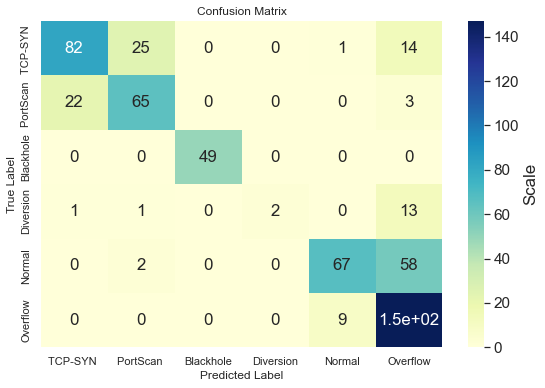

Confusion Matrix __ of Valadation


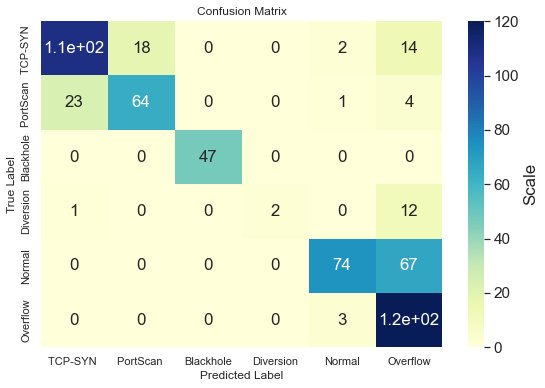

Epoch 1/100
2619/2619 [==============================] - 2s 590us/step - loss: 1.1666 - accuracy: 0.5326 - val_loss: 0.8931 - val_accuracy: 0.6346
Epoch 2/100
2619/2619 [==============================] - 1s 569us/step - loss: 0.8182 - accuracy: 0.6598 - val_loss: 0.7692 - val_accuracy: 0.7077
Epoch 3/100
2619/2619 [==============================] - 1s 561us/step - loss: 0.7564 - accuracy: 0.6922 - val_loss: 0.7211 - val_accuracy: 0.7005
Epoch 4/100
2619/2619 [==============================] - 1s 572us/step - loss: 0.7253 - accuracy: 0.7033 - val_loss: 0.7068 - val_accuracy: 0.7237
Epoch 5/100
2619/2619 [==============================] - 1s 570us/step - loss: 0.7103 - accuracy: 0.7018 - val_loss: 0.6945 - val_accuracy: 0.7344
Epoch 6/100
2619/2619 [==============================] - 1s 567us/step - loss: 0.7037 - accuracy: 0.7106 - val_loss: 0.6989 - val_accuracy: 0.7094
Epoch 7/100
2619/2619 [==============================] - 2s 586us/step - loss: 0.7023 - accuracy: 0.7129 - val_loss: 0

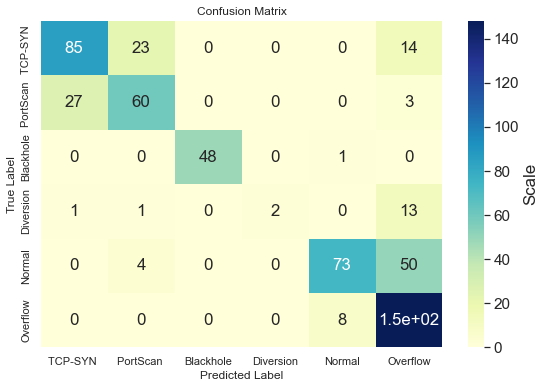

Confusion Matrix __ of Valadation


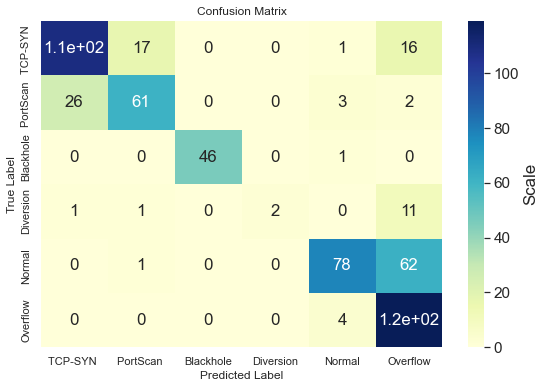

In [ ]:

anova_train_acc = []
anova_val_acc = []
anova_test_acc = []
confusion_test=[]
confusion_valdation=[]

for i in range(2,22):
    fvalue_Best = SelectKBest(f_classif, k=i)
    x_train_anova=fvalue_Best.fit_transform(train_x,train['Label'])
    x_val_anova=fvalue_Best.transform(val_x)
    x_test_anova=fvalue_Best.transform(test_x)
    
    optimizer=tfaAdamw.optimizers.AdamW(learning_rate= 0.001, weight_decay= 0.0001)
  #Scalling
    scaler = StandardScaler()
    x_train_scaled_anova = scaler.fit_transform(x_train_anova)
    x_val_scaled_anova = scaler.transform(x_val_anova)
    x_test_scaled_anova = scaler.transform(x_test_anova)

  #Modeling
    model_anova = keras.models.Sequential()
    model_anova.add(Dense(10, input_shape = (i,), activation = 'relu'))
    model_anova.add(Dense(6, activation = "softmax"))
    model_anova.compile(optimizer=optimizer, loss="sparse_categorical_crossentropy", metrics = ["accuracy"])

    h_anova = model_anova.fit(x_train_scaled_anova, train_y, epochs=100, batch_size=1, validation_data=(x_val_scaled_anova,val_y))
 
    MLP_training_score = model_anova.evaluate(x_train_scaled_anova,train_y, verbose=0)[1]
    MLP_val_score = model_anova.evaluate(x_val_scaled_anova,val_y, verbose=0)[1]
    MLP_test_score = model_anova.evaluate(x_test_scaled_anova,test_y, verbose=0)[1]
    print('At Number of Features: ', i)
    print("Training_score ",MLP_training_score)
    print("Validation_score :",MLP_val_score)
    print("Testing_score :",MLP_test_score)
    print('\n',"*************")
    anova_train_acc.append(MLP_training_score)
    anova_val_acc.append(MLP_val_score)
    anova_test_acc.append(MLP_test_score)
    y_pred = np.argmax(model_anova.predict(x_test_scaled_anova), axis=-1)
    data= confusion_matrix(test_y, y_pred)
    confusion_test.append(data)
    labels =['TCP-SYN ','PortScan ','Blackhole','Diversion','Normal','Overflow']
    print("Confusion Matrix __ of Testing")
    plot_confusion_matrix(data,labels)
    y_pred = np.argmax(model_anova.predict(x_val_scaled_anova), axis=-1)
    data2= confusion_matrix(val_y, y_pred)
    confusion_valdation.append(data2)
    print("Confusion Matrix __ of Valadation")
    plot_confusion_matrix(data2,labels)



In [ ]:
Best_number_of_Features=np.argmax(anova_test_acc)+2
Best_number_of_Features

10

In [ ]:
Best_number_of_Features_basedValad=np.argmax(anova_val_acc)+2

In [ ]:
anova_val_acc

[0.45098039507865906,
 0.5454545617103577,
 0.6880570650100708,
 0.6327985525131226,
 0.6666666865348816,
 0.6934046149253845,
 0.6916220784187317,
 0.7130124568939209,
 0.7219251394271851,
 0.698752224445343,
 0.7058823704719543,
 0.7486631274223328,
 0.7023172974586487,
 0.7290552854537964,
 0.7450980544090271,
 0.7486631274223328,
 0.7504456043243408,
 0.7504456043243408,
 0.7415329813957214,
 0.7397504448890686]

In [ ]:
anova_test_acc

[0.488413542509079,
 0.5276292562484741,
 0.6969696879386902,
 0.638146162033081,
 0.6737967729568481,
 0.6809269189834595,
 0.7058823704719543,
 0.7308377623558044,
 0.7450980544090271,
 0.675579309463501,
 0.7308377623558044,
 0.7450980544090271,
 0.6720142364501953,
 0.7290552854537964,
 0.7450980544090271,
 0.7361853718757629,
 0.7450980544090271,
 0.7272727489471436,
 0.7344028353691101,
 0.7415329813957214]

Text(0, 0.5, 'accuracy')

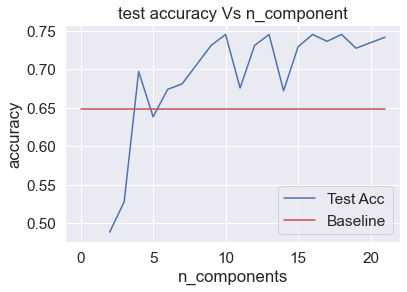

In [ ]:
plt.plot(range(2,22),anova_test_acc)
plt.plot(range(0,22),[baseline_acc]*22,'r')
plt.legend(['Test Acc', 'Baseline']) 
plt.title('test accuracy Vs n_component')
plt.xlabel('n_components')
plt.ylabel('accuracy')

In [ ]:
print("Best Accuaracy Based on Test set is :",anova_test_acc[Best_number_of_Features-2])

Best Accuaracy Based on Test set is : 0.7450980544090271


In [ ]:
print("Best Accuaracy Based on Valadation set is :",anova_val_acc[Best_number_of_Features_basedValad-2])

Best Accuaracy Based on Valadation set is : 0.7504456043243408


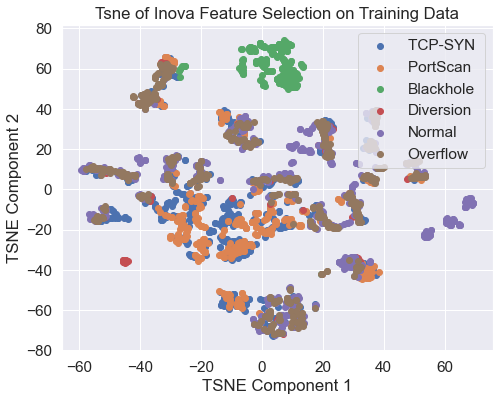

In [ ]:
plot_tsne(x_train_scaled_anova, train_y, "Tsne of Inova Feature Selection on Training Data")

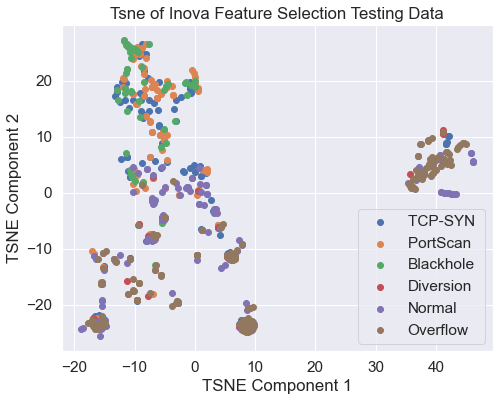

In [ ]:
plot_tsne(x_test_anova, test_y, "Tsne of Inova Feature Selection Testing Data")

In [ ]:
from numpy import asarray
from numpy import savetxt

In [ ]:
savetxt('Inova_test.csv', anova_test_acc, delimiter=',')
savetxt('Inova_valadation.csv', anova_val_acc, delimiter=',')

## Q2 .2) 
### Trying Mutual information

Epoch 1/100
2619/2619 [==============================] - 2s 561us/step - loss: 1.3114 - accuracy: 0.5212 - val_loss: 1.2053 - val_accuracy: 0.5508
Epoch 2/100
2619/2619 [==============================] - 1s 529us/step - loss: 1.1898 - accuracy: 0.5670 - val_loss: 1.1969 - val_accuracy: 0.5169
Epoch 3/100
2619/2619 [==============================] - 1s 541us/step - loss: 1.1816 - accuracy: 0.5655 - val_loss: 1.1941 - val_accuracy: 0.5312
Epoch 4/100
2619/2619 [==============================] - 1s 547us/step - loss: 1.1835 - accuracy: 0.5704 - val_loss: 1.1969 - val_accuracy: 0.4938
Epoch 5/100
2619/2619 [==============================] - 1s 547us/step - loss: 1.1834 - accuracy: 0.5632 - val_loss: 1.1862 - val_accuracy: 0.5223
Epoch 6/100
2619/2619 [==============================] - 1s 550us/step - loss: 1.1811 - accuracy: 0.5521 - val_loss: 1.1815 - val_accuracy: 0.5508
Epoch 7/100
2619/2619 [==============================] - 1s 538us/step - loss: 1.1788 - accuracy: 0.5575 - val_loss: 1

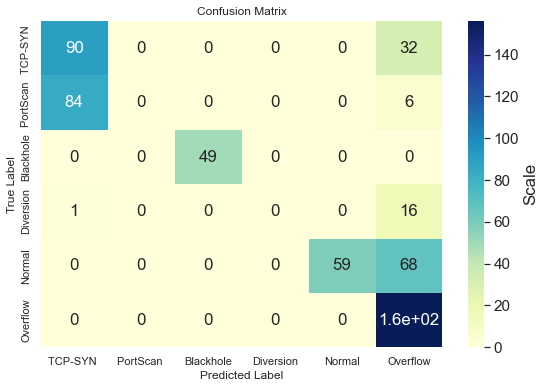

Confusion Matrix __ of Valadation


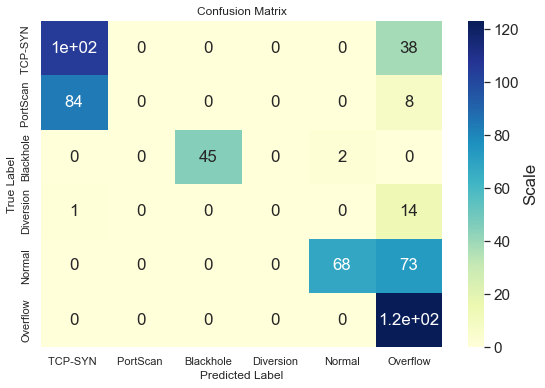

Epoch 1/100
2619/2619 [==============================] - 2s 545us/step - loss: 1.2370 - accuracy: 0.5368 - val_loss: 1.1180 - val_accuracy: 0.6399
Epoch 2/100
2619/2619 [==============================] - 1s 532us/step - loss: 1.1039 - accuracy: 0.6094 - val_loss: 1.0859 - val_accuracy: 0.6364
Epoch 3/100
2619/2619 [==============================] - 1s 529us/step - loss: 1.0814 - accuracy: 0.5979 - val_loss: 1.0763 - val_accuracy: 0.5455
Epoch 4/100
2619/2619 [==============================] - 1s 519us/step - loss: 1.0862 - accuracy: 0.5758 - val_loss: 1.0841 - val_accuracy: 0.5152
Epoch 5/100
2619/2619 [==============================] - 1s 534us/step - loss: 1.0894 - accuracy: 0.5640 - val_loss: 1.0983 - val_accuracy: 0.6114
Epoch 6/100
2619/2619 [==============================] - 1s 545us/step - loss: 1.0927 - accuracy: 0.5743 - val_loss: 1.1024 - val_accuracy: 0.6292
Epoch 7/100
2619/2619 [==============================] - 1s 527us/step - loss: 1.0987 - accuracy: 0.5838 - val_loss: 1

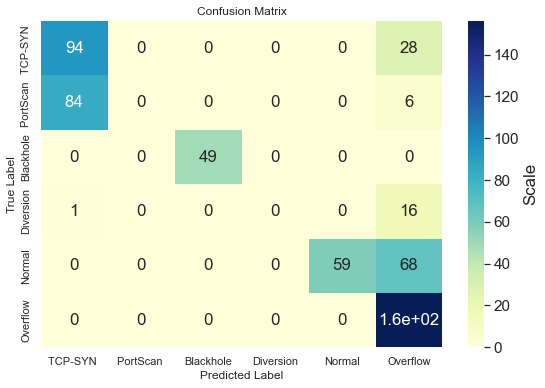

Confusion Matrix __ of Valadation


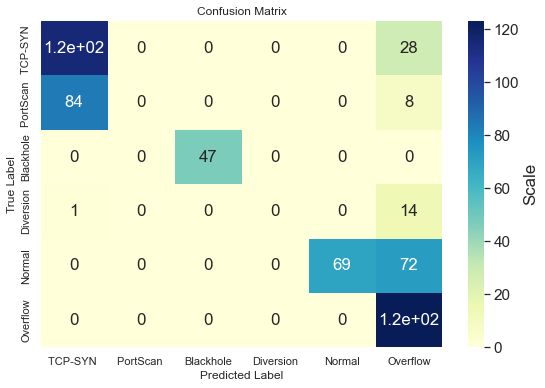

Epoch 1/100
2619/2619 [==============================] - 2s 559us/step - loss: 1.2661 - accuracy: 0.5578 - val_loss: 1.1405 - val_accuracy: 0.5276
Epoch 2/100
2619/2619 [==============================] - 1s 544us/step - loss: 1.1083 - accuracy: 0.6040 - val_loss: 1.1005 - val_accuracy: 0.6257
Epoch 3/100
2619/2619 [==============================] - 1s 539us/step - loss: 1.0916 - accuracy: 0.5953 - val_loss: 1.0860 - val_accuracy: 0.6328
Epoch 4/100
2619/2619 [==============================] - 1s 541us/step - loss: 1.0881 - accuracy: 0.5888 - val_loss: 1.0822 - val_accuracy: 0.6221
Epoch 5/100
2619/2619 [==============================] - 1s 539us/step - loss: 1.0825 - accuracy: 0.5907 - val_loss: 1.0726 - val_accuracy: 0.6328
Epoch 6/100
2619/2619 [==============================] - 1s 528us/step - loss: 1.0820 - accuracy: 0.5796 - val_loss: 1.0895 - val_accuracy: 0.5722
Epoch 7/100
2619/2619 [==============================] - 1s 527us/step - loss: 1.0799 - accuracy: 0.5716 - val_loss: 1

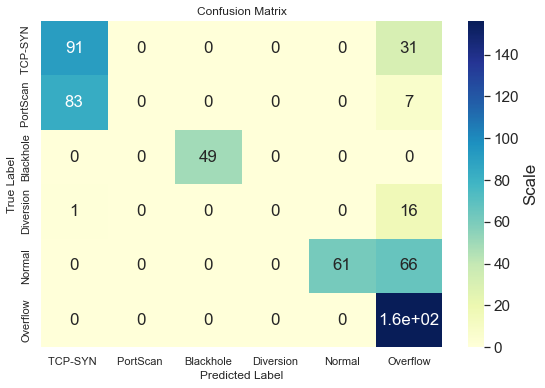

Confusion Matrix __ of Valadation


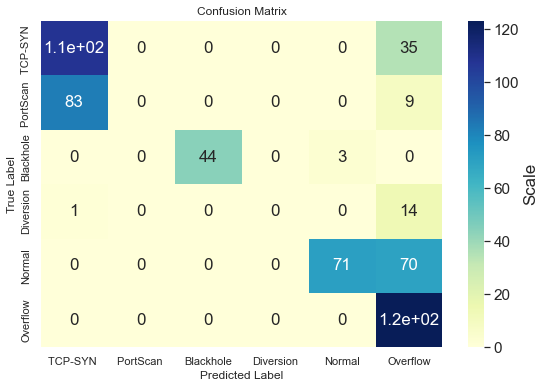

Epoch 1/100
2619/2619 [==============================] - 2s 570us/step - loss: 1.2647 - accuracy: 0.5315 - val_loss: 1.1365 - val_accuracy: 0.5561
Epoch 2/100
2619/2619 [==============================] - 1s 546us/step - loss: 1.0922 - accuracy: 0.5804 - val_loss: 1.0788 - val_accuracy: 0.5330
Epoch 3/100
2619/2619 [==============================] - 2s 584us/step - loss: 1.0750 - accuracy: 0.5830 - val_loss: 1.0725 - val_accuracy: 0.6364
Epoch 4/100
2619/2619 [==============================] - 1s 535us/step - loss: 1.0736 - accuracy: 0.5872 - val_loss: 1.0780 - val_accuracy: 0.6310
Epoch 5/100
2619/2619 [==============================] - 1s 543us/step - loss: 1.0716 - accuracy: 0.5823 - val_loss: 1.0793 - val_accuracy: 0.6007
Epoch 6/100
2619/2619 [==============================] - 1s 547us/step - loss: 1.0678 - accuracy: 0.5632 - val_loss: 1.0844 - val_accuracy: 0.5526
Epoch 7/100
2619/2619 [==============================] - 1s 543us/step - loss: 1.0663 - accuracy: 0.5724 - val_loss: 1

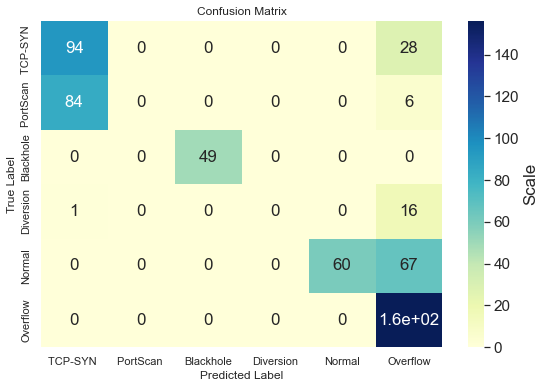

Confusion Matrix __ of Valadation


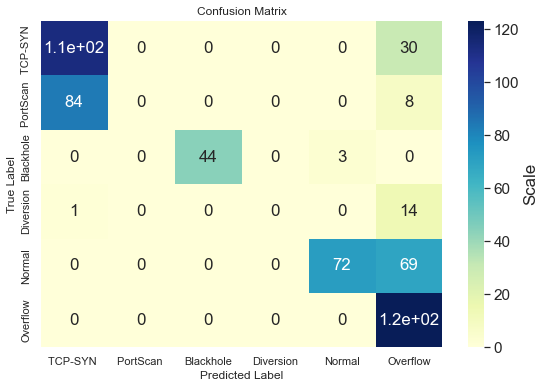

Epoch 1/100
2619/2619 [==============================] - 2s 548us/step - loss: 1.4370 - accuracy: 0.4639 - val_loss: 1.2072 - val_accuracy: 0.6310
Epoch 2/100
2619/2619 [==============================] - 1s 524us/step - loss: 1.1324 - accuracy: 0.5785 - val_loss: 1.1030 - val_accuracy: 0.5971
Epoch 3/100
2619/2619 [==============================] - 1s 527us/step - loss: 1.0799 - accuracy: 0.5895 - val_loss: 1.0683 - val_accuracy: 0.6221
Epoch 4/100
2619/2619 [==============================] - 1s 531us/step - loss: 1.0655 - accuracy: 0.5914 - val_loss: 1.0709 - val_accuracy: 0.6399
Epoch 5/100
2619/2619 [==============================] - 1s 529us/step - loss: 1.0639 - accuracy: 0.5693 - val_loss: 1.0644 - val_accuracy: 0.5312
Epoch 6/100
2619/2619 [==============================] - 1s 524us/step - loss: 1.0588 - accuracy: 0.5655 - val_loss: 1.0645 - val_accuracy: 0.6203
Epoch 7/100
2619/2619 [==============================] - 1s 527us/step - loss: 1.0582 - accuracy: 0.5743 - val_loss: 1

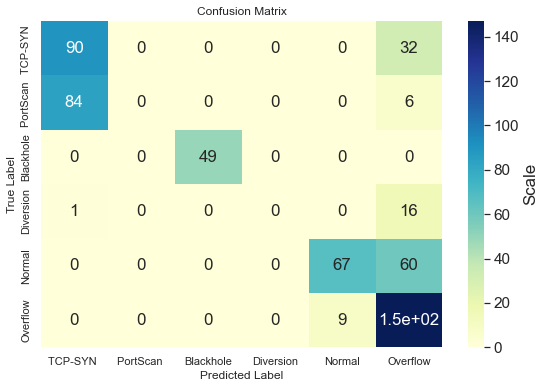

Confusion Matrix __ of Valadation


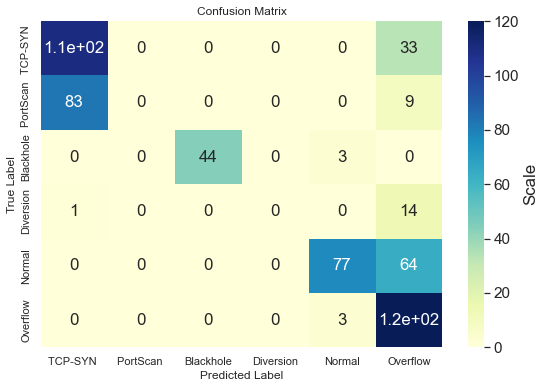

Epoch 1/100
2619/2619 [==============================] - 2s 554us/step - loss: 1.2994 - accuracy: 0.5349 - val_loss: 1.1122 - val_accuracy: 0.5651
Epoch 2/100
2619/2619 [==============================] - 1s 525us/step - loss: 1.0833 - accuracy: 0.5914 - val_loss: 1.0545 - val_accuracy: 0.6168
Epoch 3/100
2619/2619 [==============================] - 1s 531us/step - loss: 1.0574 - accuracy: 0.5918 - val_loss: 1.0527 - val_accuracy: 0.5704
Epoch 4/100
2619/2619 [==============================] - 1s 527us/step - loss: 1.0512 - accuracy: 0.6052 - val_loss: 1.0525 - val_accuracy: 0.6310
Epoch 5/100
2619/2619 [==============================] - 1s 528us/step - loss: 1.0517 - accuracy: 0.6033 - val_loss: 1.0449 - val_accuracy: 0.6168
Epoch 6/100
2619/2619 [==============================] - 1s 538us/step - loss: 1.0460 - accuracy: 0.5838 - val_loss: 1.0548 - val_accuracy: 0.5472
Epoch 7/100
2619/2619 [==============================] - 1s 531us/step - loss: 1.0511 - accuracy: 0.5930 - val_loss: 1

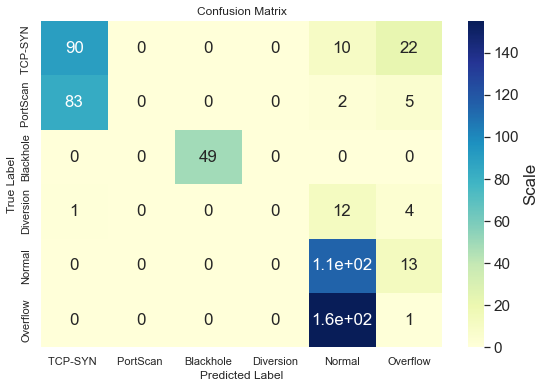

Confusion Matrix __ of Valadation


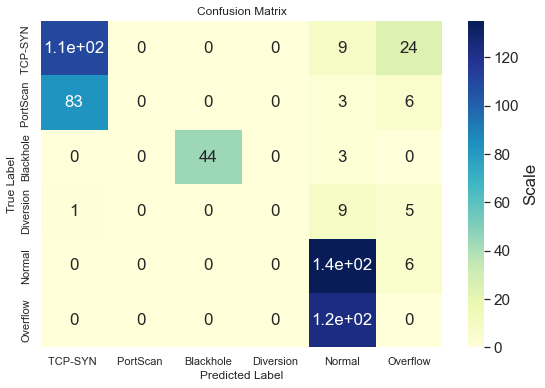

Epoch 1/100
2619/2619 [==============================] - 2s 547us/step - loss: 1.4108 - accuracy: 0.4780 - val_loss: 1.2118 - val_accuracy: 0.4955
Epoch 2/100
2619/2619 [==============================] - 1s 519us/step - loss: 1.1264 - accuracy: 0.5643 - val_loss: 1.1021 - val_accuracy: 0.5294
Epoch 3/100
2619/2619 [==============================] - 1s 524us/step - loss: 1.0886 - accuracy: 0.5880 - val_loss: 1.0957 - val_accuracy: 0.5615
Epoch 4/100
2619/2619 [==============================] - 1s 550us/step - loss: 1.0782 - accuracy: 0.5724 - val_loss: 1.0862 - val_accuracy: 0.5722
Epoch 5/100
2619/2619 [==============================] - 1s 526us/step - loss: 1.0723 - accuracy: 0.5930 - val_loss: 1.0882 - val_accuracy: 0.5793
Epoch 6/100
2619/2619 [==============================] - 1s 522us/step - loss: 1.0712 - accuracy: 0.5838 - val_loss: 1.0705 - val_accuracy: 0.5847
Epoch 7/100
2619/2619 [==============================] - 1s 533us/step - loss: 1.0642 - accuracy: 0.5792 - val_loss: 1

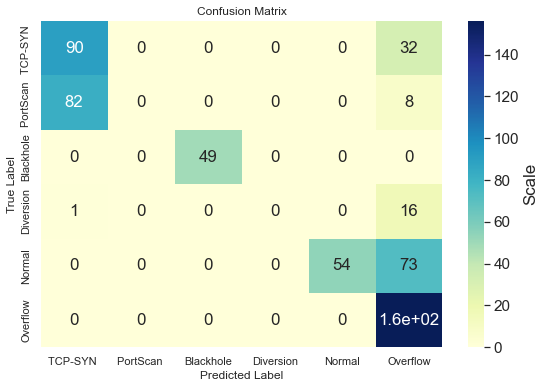

Confusion Matrix __ of Valadation


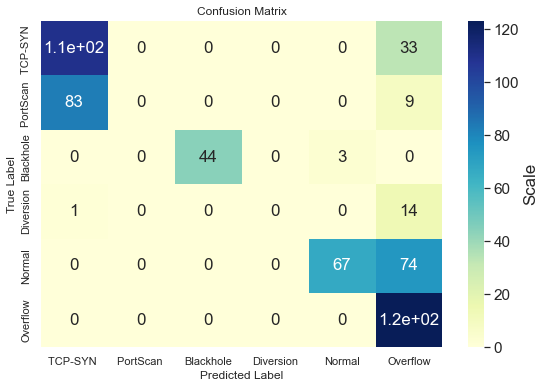

Epoch 1/100
2619/2619 [==============================] - 2s 587us/step - loss: 1.3174 - accuracy: 0.4758 - val_loss: 1.1303 - val_accuracy: 0.5383
Epoch 2/100
2619/2619 [==============================] - 1s 546us/step - loss: 1.0983 - accuracy: 0.5624 - val_loss: 1.0990 - val_accuracy: 0.5793
Epoch 3/100
2619/2619 [==============================] - 1s 541us/step - loss: 1.0683 - accuracy: 0.5750 - val_loss: 1.0599 - val_accuracy: 0.6364
Epoch 4/100
2619/2619 [==============================] - 1s 548us/step - loss: 1.0599 - accuracy: 0.5869 - val_loss: 1.0579 - val_accuracy: 0.5579
Epoch 5/100
2619/2619 [==============================] - 1s 550us/step - loss: 1.0589 - accuracy: 0.5895 - val_loss: 1.0456 - val_accuracy: 0.6043
Epoch 6/100
2619/2619 [==============================] - 1s 544us/step - loss: 1.0523 - accuracy: 0.5788 - val_loss: 1.0682 - val_accuracy: 0.5936
Epoch 7/100
2619/2619 [==============================] - 1s 541us/step - loss: 1.0566 - accuracy: 0.5899 - val_loss: 1

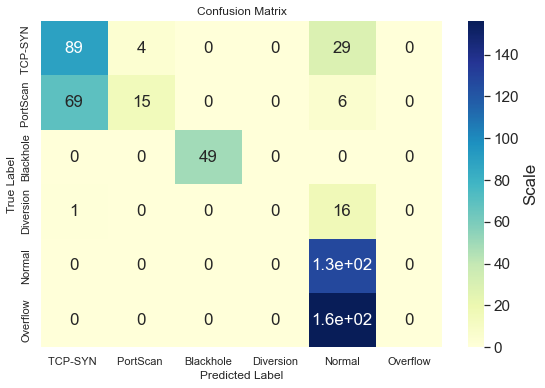

Confusion Matrix __ of Valadation


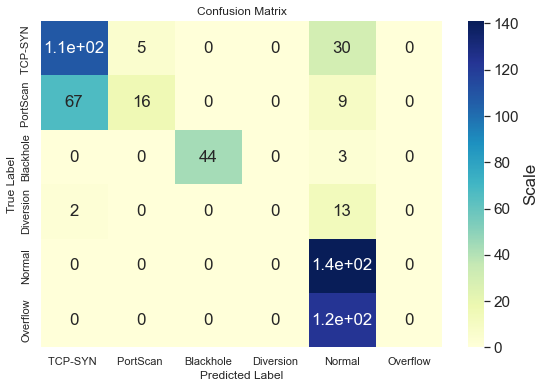

Epoch 1/100
2619/2619 [==============================] - 2s 563us/step - loss: 1.3371 - accuracy: 0.5048 - val_loss: 1.1530 - val_accuracy: 0.5098
Epoch 2/100
2619/2619 [==============================] - 1s 530us/step - loss: 1.0962 - accuracy: 0.5712 - val_loss: 1.0832 - val_accuracy: 0.6257
Epoch 3/100
2619/2619 [==============================] - 1s 535us/step - loss: 1.0650 - accuracy: 0.6014 - val_loss: 1.0514 - val_accuracy: 0.6132
Epoch 4/100
2619/2619 [==============================] - 1s 534us/step - loss: 1.0549 - accuracy: 0.5907 - val_loss: 1.0683 - val_accuracy: 0.6043
Epoch 5/100
2619/2619 [==============================] - 1s 529us/step - loss: 1.0609 - accuracy: 0.5998 - val_loss: 1.0480 - val_accuracy: 0.5597
Epoch 6/100
2619/2619 [==============================] - 1s 529us/step - loss: 1.0563 - accuracy: 0.5949 - val_loss: 1.0521 - val_accuracy: 0.5793
Epoch 7/100
2619/2619 [==============================] - 1s 535us/step - loss: 1.0579 - accuracy: 0.5773 - val_loss: 1

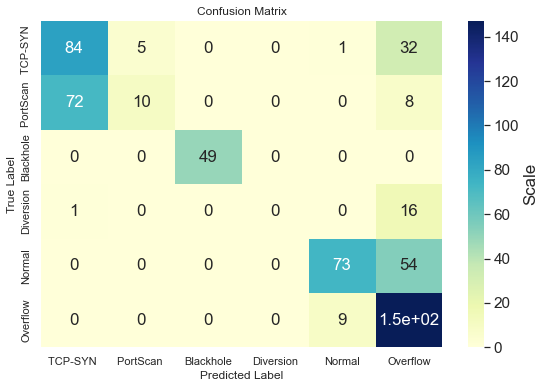

Confusion Matrix __ of Valadation


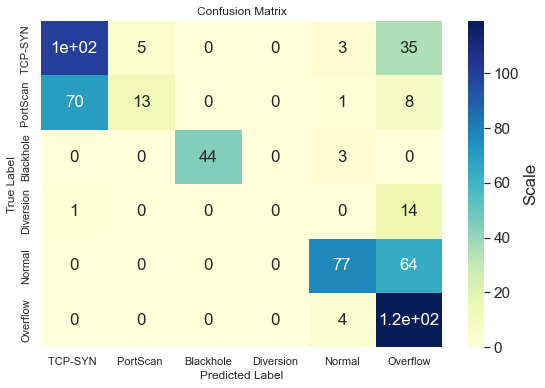

Epoch 1/100
2619/2619 [==============================] - 2s 582us/step - loss: 1.3767 - accuracy: 0.4971 - val_loss: 1.1728 - val_accuracy: 0.6114
Epoch 2/100
2619/2619 [==============================] - 1s 551us/step - loss: 1.0991 - accuracy: 0.5617 - val_loss: 1.0834 - val_accuracy: 0.5116
Epoch 3/100
2619/2619 [==============================] - 1s 560us/step - loss: 1.0694 - accuracy: 0.5830 - val_loss: 1.0689 - val_accuracy: 0.6275
Epoch 4/100
2619/2619 [==============================] - 1s 548us/step - loss: 1.0582 - accuracy: 0.5956 - val_loss: 1.0560 - val_accuracy: 0.6417
Epoch 5/100
2619/2619 [==============================] - 1s 553us/step - loss: 1.0505 - accuracy: 0.6018 - val_loss: 1.0700 - val_accuracy: 0.6435
Epoch 6/100
2619/2619 [==============================] - 1s 555us/step - loss: 1.0555 - accuracy: 0.5995 - val_loss: 1.0503 - val_accuracy: 0.5989
Epoch 7/100
2619/2619 [==============================] - 1s 555us/step - loss: 1.0515 - accuracy: 0.5979 - val_loss: 1

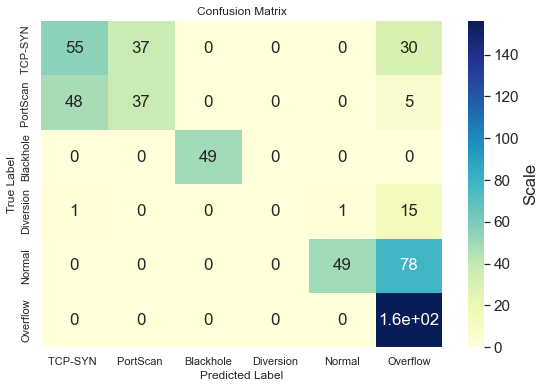

Confusion Matrix __ of Valadation


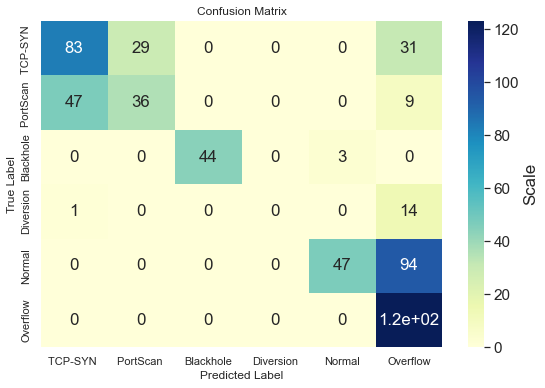

Epoch 1/100
2619/2619 [==============================] - 2s 569us/step - loss: 1.4160 - accuracy: 0.4567 - val_loss: 1.2221 - val_accuracy: 0.5900
Epoch 2/100
2619/2619 [==============================] - 1s 530us/step - loss: 1.1269 - accuracy: 0.5899 - val_loss: 1.1027 - val_accuracy: 0.6346
Epoch 3/100
2619/2619 [==============================] - 1s 535us/step - loss: 1.0831 - accuracy: 0.5926 - val_loss: 1.0671 - val_accuracy: 0.5544
Epoch 4/100
2619/2619 [==============================] - 1s 534us/step - loss: 1.0668 - accuracy: 0.5850 - val_loss: 1.0657 - val_accuracy: 0.6043
Epoch 5/100
2619/2619 [==============================] - 1s 535us/step - loss: 1.0602 - accuracy: 0.5953 - val_loss: 1.0510 - val_accuracy: 0.6292
Epoch 6/100
2619/2619 [==============================] - 1s 529us/step - loss: 1.0479 - accuracy: 0.5872 - val_loss: 1.0590 - val_accuracy: 0.5722
Epoch 7/100
2619/2619 [==============================] - 1s 535us/step - loss: 1.0509 - accuracy: 0.5838 - val_loss: 1

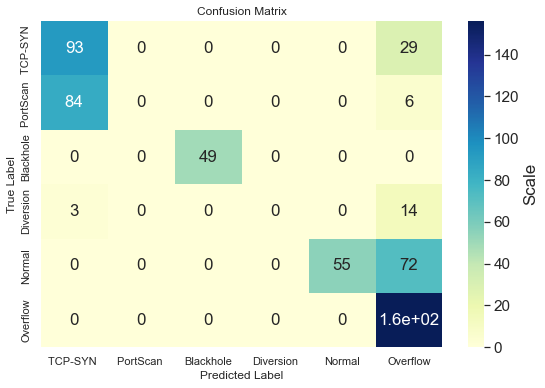

Confusion Matrix __ of Valadation


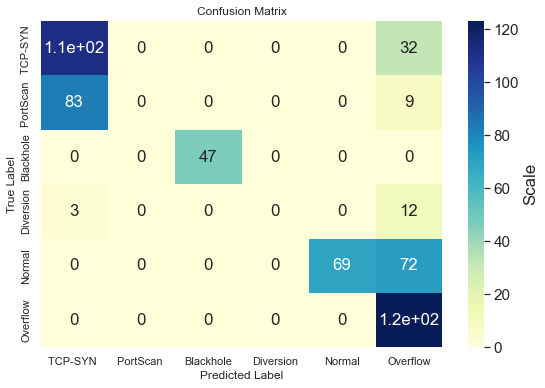

Epoch 1/100
2619/2619 [==============================] - 2s 586us/step - loss: 1.3449 - accuracy: 0.4979 - val_loss: 1.1170 - val_accuracy: 0.6185
Epoch 2/100
2619/2619 [==============================] - 1s 555us/step - loss: 1.0737 - accuracy: 0.5960 - val_loss: 1.0673 - val_accuracy: 0.5882
Epoch 3/100
2619/2619 [==============================] - 1s 556us/step - loss: 1.0490 - accuracy: 0.5968 - val_loss: 1.0432 - val_accuracy: 0.5633
Epoch 4/100
2619/2619 [==============================] - 1s 553us/step - loss: 1.0421 - accuracy: 0.5850 - val_loss: 1.0521 - val_accuracy: 0.6150
Epoch 5/100
2619/2619 [==============================] - 1s 570us/step - loss: 1.0457 - accuracy: 0.5956 - val_loss: 1.0392 - val_accuracy: 0.5526
Epoch 6/100
2619/2619 [==============================] - 1s 567us/step - loss: 1.0393 - accuracy: 0.5911 - val_loss: 1.0343 - val_accuracy: 0.5758
Epoch 7/100
2619/2619 [==============================] - 2s 581us/step - loss: 1.0366 - accuracy: 0.5991 - val_loss: 1

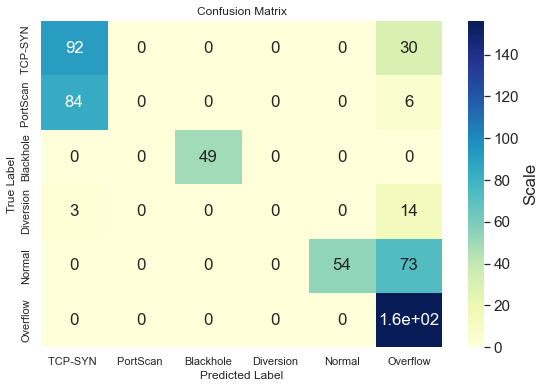

Confusion Matrix __ of Valadation


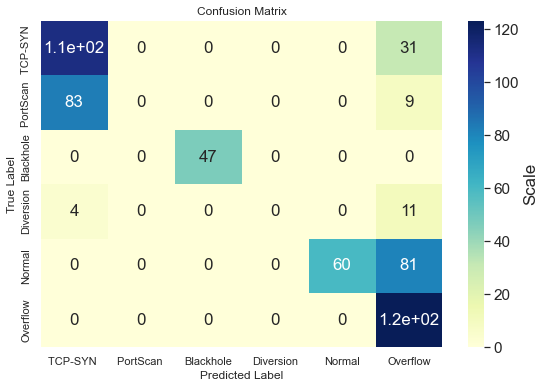

Epoch 1/100
2619/2619 [==============================] - 2s 573us/step - loss: 1.3126 - accuracy: 0.5338 - val_loss: 1.1701 - val_accuracy: 0.5472
Epoch 2/100
2619/2619 [==============================] - 1s 539us/step - loss: 1.1082 - accuracy: 0.5872 - val_loss: 1.0724 - val_accuracy: 0.6025
Epoch 3/100
2619/2619 [==============================] - 1s 547us/step - loss: 1.0545 - accuracy: 0.5914 - val_loss: 1.0365 - val_accuracy: 0.5383
Epoch 4/100
2619/2619 [==============================] - 1s 535us/step - loss: 1.0403 - accuracy: 0.5960 - val_loss: 1.0387 - val_accuracy: 0.6185
Epoch 5/100
2619/2619 [==============================] - 1s 535us/step - loss: 1.0385 - accuracy: 0.5949 - val_loss: 1.0387 - val_accuracy: 0.6185
Epoch 6/100
2619/2619 [==============================] - 1s 533us/step - loss: 1.0365 - accuracy: 0.5956 - val_loss: 1.0353 - val_accuracy: 0.6007
Epoch 7/100
2619/2619 [==============================] - 1s 534us/step - loss: 1.0351 - accuracy: 0.5960 - val_loss: 1

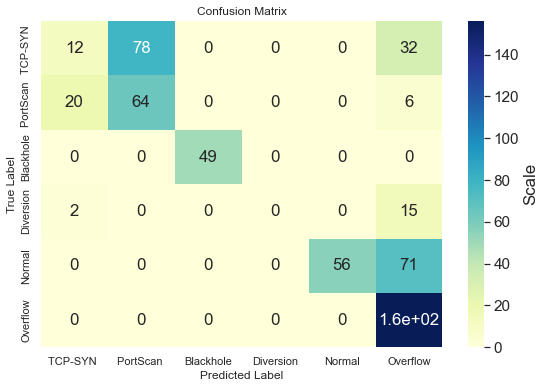

Confusion Matrix __ of Valadation


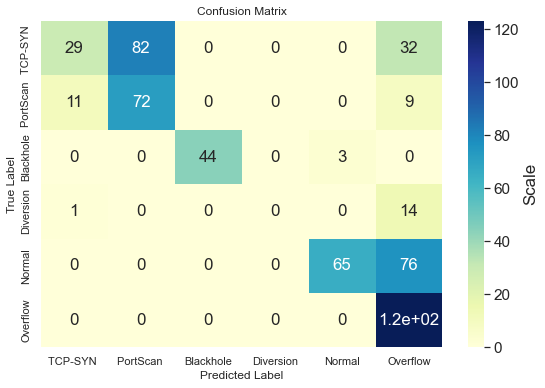

Epoch 1/100
2619/2619 [==============================] - 2s 584us/step - loss: 1.2787 - accuracy: 0.5223 - val_loss: 1.0970 - val_accuracy: 0.5686
Epoch 2/100
2619/2619 [==============================] - 1s 558us/step - loss: 1.0699 - accuracy: 0.5808 - val_loss: 1.0430 - val_accuracy: 0.5740
Epoch 3/100
2619/2619 [==============================] - 1s 550us/step - loss: 1.0416 - accuracy: 0.5941 - val_loss: 1.0402 - val_accuracy: 0.5258
Epoch 4/100
2619/2619 [==============================] - 1s 554us/step - loss: 1.0375 - accuracy: 0.5987 - val_loss: 1.0319 - val_accuracy: 0.5882
Epoch 5/100
2619/2619 [==============================] - 1s 561us/step - loss: 1.0310 - accuracy: 0.5991 - val_loss: 1.0236 - val_accuracy: 0.5811
Epoch 6/100
2619/2619 [==============================] - 1s 557us/step - loss: 1.0300 - accuracy: 0.5884 - val_loss: 1.0268 - val_accuracy: 0.6257
Epoch 7/100
2619/2619 [==============================] - 1s 561us/step - loss: 1.0333 - accuracy: 0.5872 - val_loss: 1

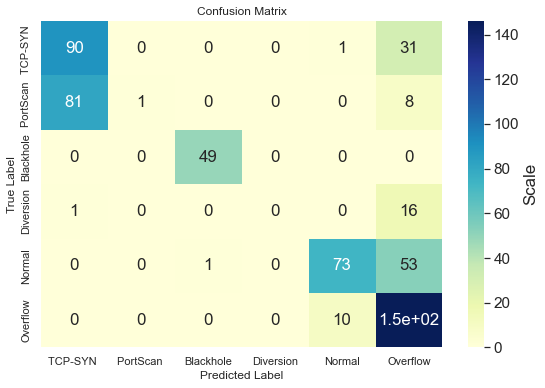

Confusion Matrix __ of Valadation


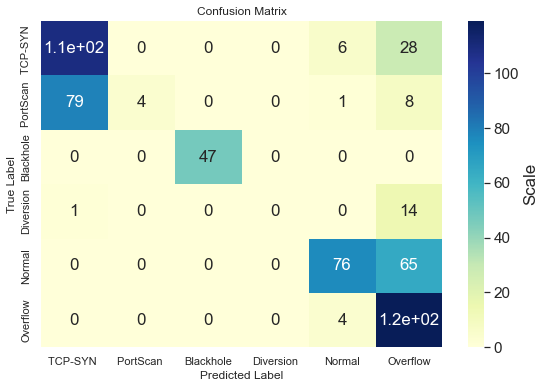

Epoch 1/100
2619/2619 [==============================] - 2s 562us/step - loss: 1.4127 - accuracy: 0.4674 - val_loss: 1.1443 - val_accuracy: 0.5793
Epoch 2/100
2619/2619 [==============================] - 1s 534us/step - loss: 1.0915 - accuracy: 0.5918 - val_loss: 1.0497 - val_accuracy: 0.6096
Epoch 3/100
2619/2619 [==============================] - 1s 534us/step - loss: 1.0352 - accuracy: 0.5972 - val_loss: 1.0165 - val_accuracy: 0.6203
Epoch 4/100
2619/2619 [==============================] - 1s 539us/step - loss: 1.0315 - accuracy: 0.6048 - val_loss: 1.0270 - val_accuracy: 0.5633
Epoch 5/100
2619/2619 [==============================] - 1s 535us/step - loss: 1.0268 - accuracy: 0.5914 - val_loss: 1.0388 - val_accuracy: 0.5882
Epoch 6/100
2619/2619 [==============================] - 1s 537us/step - loss: 1.0299 - accuracy: 0.5892 - val_loss: 1.0227 - val_accuracy: 0.5544
Epoch 7/100
2619/2619 [==============================] - 1s 534us/step - loss: 1.0246 - accuracy: 0.6018 - val_loss: 1

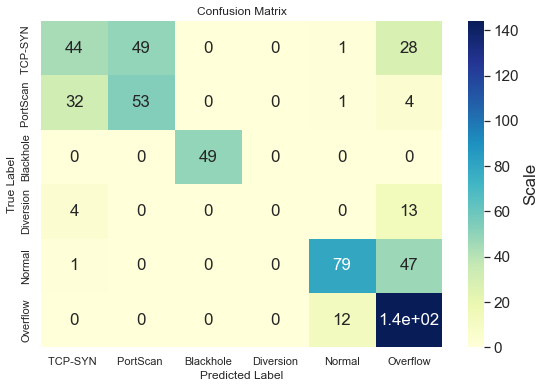

Confusion Matrix __ of Valadation


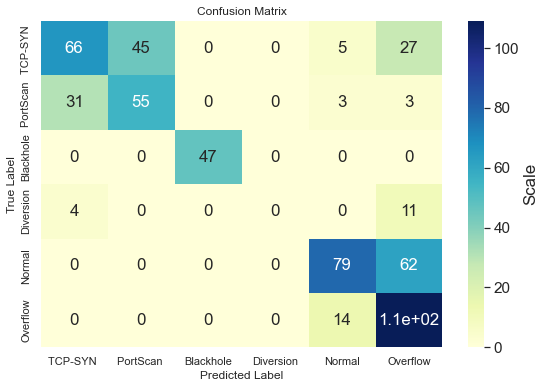

Epoch 1/100
2619/2619 [==============================] - 2s 584us/step - loss: 1.4139 - accuracy: 0.4704 - val_loss: 1.2421 - val_accuracy: 0.5348
Epoch 2/100
2619/2619 [==============================] - 1s 550us/step - loss: 1.1417 - accuracy: 0.5571 - val_loss: 1.0810 - val_accuracy: 0.5330
Epoch 3/100
2619/2619 [==============================] - 1s 560us/step - loss: 1.0710 - accuracy: 0.5743 - val_loss: 1.0651 - val_accuracy: 0.5829
Epoch 4/100
2619/2619 [==============================] - 1s 556us/step - loss: 1.0550 - accuracy: 0.5865 - val_loss: 1.0554 - val_accuracy: 0.5740
Epoch 5/100
2619/2619 [==============================] - 1s 559us/step - loss: 1.0506 - accuracy: 0.5808 - val_loss: 1.0426 - val_accuracy: 0.5686
Epoch 6/100
2619/2619 [==============================] - 1s 552us/step - loss: 1.0440 - accuracy: 0.5819 - val_loss: 1.0397 - val_accuracy: 0.5865
Epoch 7/100
2619/2619 [==============================] - 1s 559us/step - loss: 1.0439 - accuracy: 0.5911 - val_loss: 1

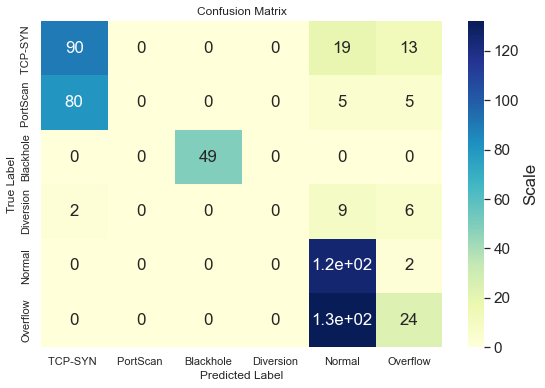

Confusion Matrix __ of Valadation


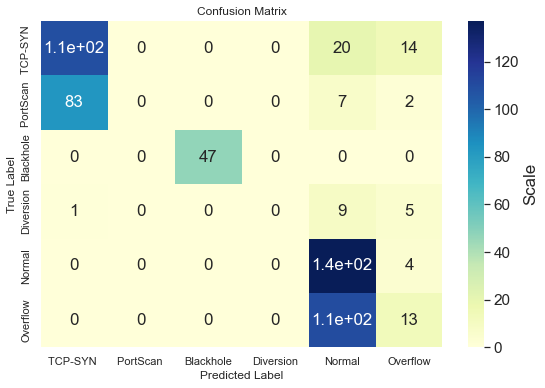

Epoch 1/100
2619/2619 [==============================] - 2s 546us/step - loss: 1.3320 - accuracy: 0.4941 - val_loss: 1.1111 - val_accuracy: 0.5455
Epoch 2/100
2619/2619 [==============================] - 1s 533us/step - loss: 1.0748 - accuracy: 0.5872 - val_loss: 1.0577 - val_accuracy: 0.5651
Epoch 3/100
2619/2619 [==============================] - 1s 532us/step - loss: 1.0413 - accuracy: 0.5861 - val_loss: 1.0196 - val_accuracy: 0.6185
Epoch 4/100
2619/2619 [==============================] - 1s 531us/step - loss: 1.0325 - accuracy: 0.6010 - val_loss: 1.0244 - val_accuracy: 0.5971
Epoch 5/100
2619/2619 [==============================] - 1s 529us/step - loss: 1.0321 - accuracy: 0.5926 - val_loss: 1.0352 - val_accuracy: 0.5954
Epoch 6/100
2619/2619 [==============================] - 1s 541us/step - loss: 1.0331 - accuracy: 0.5892 - val_loss: 1.0109 - val_accuracy: 0.6346
Epoch 7/100
2619/2619 [==============================] - 1s 529us/step - loss: 1.0298 - accuracy: 0.5846 - val_loss: 1

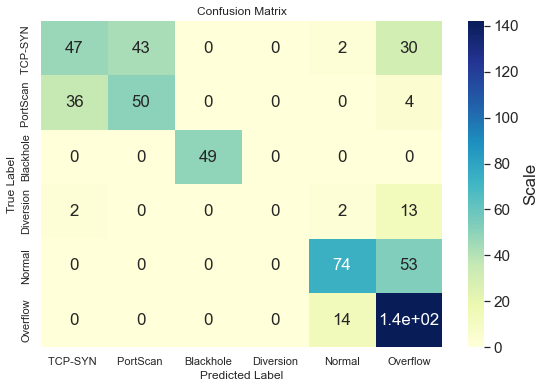

Confusion Matrix __ of Valadation


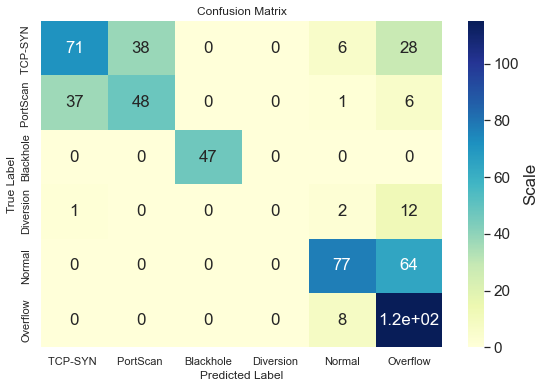

Epoch 1/100
2619/2619 [==============================] - 2s 599us/step - loss: 1.3108 - accuracy: 0.4987 - val_loss: 1.1245 - val_accuracy: 0.5526
Epoch 2/100
2619/2619 [==============================] - 1s 566us/step - loss: 1.0836 - accuracy: 0.5731 - val_loss: 1.0569 - val_accuracy: 0.6239
Epoch 3/100
2619/2619 [==============================] - 1s 564us/step - loss: 1.0504 - accuracy: 0.5811 - val_loss: 1.0468 - val_accuracy: 0.6043
Epoch 4/100
2619/2619 [==============================] - 1s 566us/step - loss: 1.0441 - accuracy: 0.5819 - val_loss: 1.0325 - val_accuracy: 0.5918
Epoch 5/100
2619/2619 [==============================] - 1s 563us/step - loss: 1.0370 - accuracy: 0.5918 - val_loss: 1.0283 - val_accuracy: 0.5722
Epoch 6/100
2619/2619 [==============================] - 1s 566us/step - loss: 1.0318 - accuracy: 0.5987 - val_loss: 1.0292 - val_accuracy: 0.5775
Epoch 7/100
2619/2619 [==============================] - 1s 563us/step - loss: 1.0308 - accuracy: 0.5949 - val_loss: 1

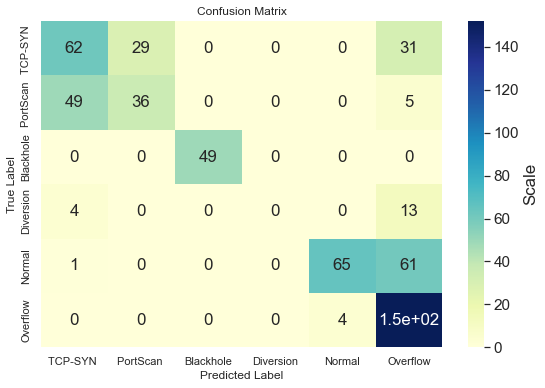

Confusion Matrix __ of Valadation


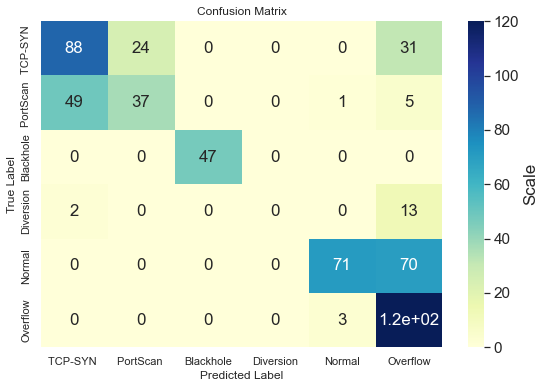

Epoch 1/100
2619/2619 [==============================] - 2s 560us/step - loss: 1.3390 - accuracy: 0.5380 - val_loss: 1.1358 - val_accuracy: 0.5954
Epoch 2/100
2619/2619 [==============================] - 1s 534us/step - loss: 1.0908 - accuracy: 0.6048 - val_loss: 1.0534 - val_accuracy: 0.6203
Epoch 3/100
2619/2619 [==============================] - 1s 541us/step - loss: 1.0527 - accuracy: 0.6048 - val_loss: 1.0310 - val_accuracy: 0.6114
Epoch 4/100
2619/2619 [==============================] - 1s 537us/step - loss: 1.0446 - accuracy: 0.5872 - val_loss: 1.0399 - val_accuracy: 0.5668
Epoch 5/100
2619/2619 [==============================] - 1s 532us/step - loss: 1.0459 - accuracy: 0.5998 - val_loss: 1.0493 - val_accuracy: 0.6239
Epoch 6/100
2619/2619 [==============================] - 1s 536us/step - loss: 1.0451 - accuracy: 0.5876 - val_loss: 1.0319 - val_accuracy: 0.6453
Epoch 7/100
2619/2619 [==============================] - 1s 549us/step - loss: 1.0429 - accuracy: 0.5754 - val_loss: 1

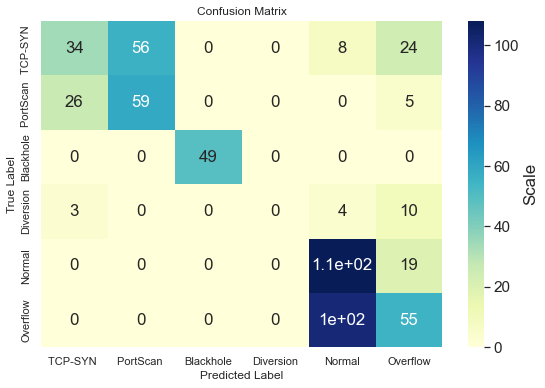

Confusion Matrix __ of Valadation


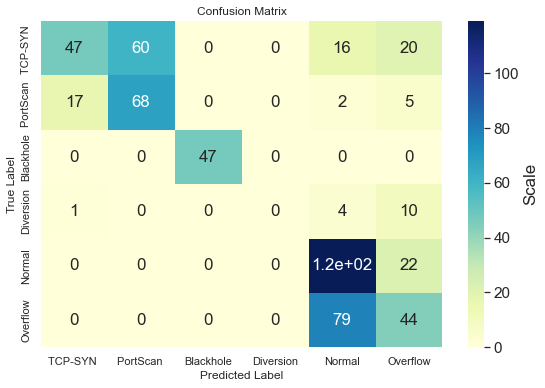

Epoch 1/100
2619/2619 [==============================] - 2s 582us/step - loss: 1.3186 - accuracy: 0.5094 - val_loss: 1.1206 - val_accuracy: 0.5758
Epoch 2/100
2619/2619 [==============================] - 1s 550us/step - loss: 1.0771 - accuracy: 0.5743 - val_loss: 1.0438 - val_accuracy: 0.5722
Epoch 3/100
2619/2619 [==============================] - 1s 551us/step - loss: 1.0446 - accuracy: 0.5865 - val_loss: 1.0453 - val_accuracy: 0.5704
Epoch 4/100
2619/2619 [==============================] - 1s 557us/step - loss: 1.0417 - accuracy: 0.5766 - val_loss: 1.0336 - val_accuracy: 0.6292
Epoch 5/100
2619/2619 [==============================] - 1s 560us/step - loss: 1.0423 - accuracy: 0.5895 - val_loss: 1.0427 - val_accuracy: 0.6292
Epoch 6/100
2619/2619 [==============================] - 1s 560us/step - loss: 1.0392 - accuracy: 0.5956 - val_loss: 1.0230 - val_accuracy: 0.6221
Epoch 7/100
2619/2619 [==============================] - 1s 551us/step - loss: 1.0348 - accuracy: 0.5956 - val_loss: 1

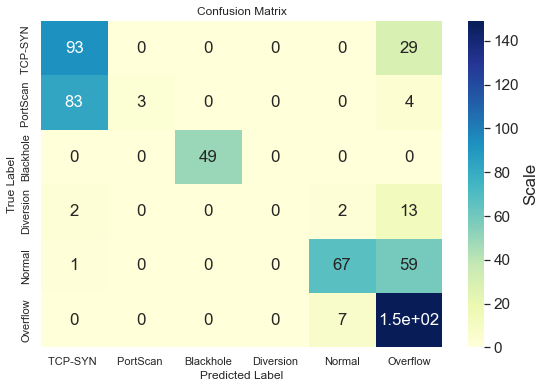

Confusion Matrix __ of Valadation


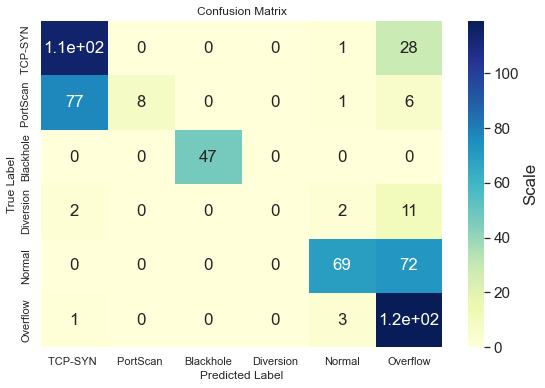

In [ ]:
from sklearn.feature_selection import mutual_info_classif

Mutinfo_train_acc = []
Mutinfo_val_acc = []
Mutinfo_test_acc = []
confusion_test=[]
confusion_valdation=[]
for i in range(2,22):
    fvalue_Best = SelectKBest(mutual_info_classif, k=i)
    x_train_Minfo = fvalue_Best.fit_transform(train_x,train['Label'])
    x_val_Minfo=fvalue_Best.transform(val_x)
    x_test_Minfo=fvalue_Best.transform(test_x)
    
    optimizer=tfaAdamw.optimizers.AdamW(learning_rate= 0.001, weight_decay= 0.001)
  #Scalling
    scaler = StandardScaler()
    x_train_scaled_Minfo = scaler.fit_transform(x_train_Minfo)
    x_val_scaled_Minfo = scaler.transform(x_val_Minfo)
    x_test_scaled_Minfo = scaler.transform(x_test_Minfo)

  #Modeling
    model_Minfo = keras.models.Sequential()
    model_Minfo.add(Dense(10, input_shape = (i,), activation = 'relu'))
    model_Minfo.add(Dense(6, activation = "softmax"))
    model_Minfo.compile(optimizer=optimizer, loss="sparse_categorical_crossentropy", metrics = ["accuracy"])

    h_Minfo = model_Minfo.fit(x_train_scaled_Minfo, train_y, epochs=100, batch_size=1, validation_data=(x_val_scaled_Minfo,val_y))
 
  

    MLP_training_score = model_Minfo.evaluate(x_train_scaled_Minfo,train_y, verbose=0)[1]
    MLP_val_score = model_Minfo.evaluate(x_val_scaled_Minfo,val_y, verbose=0)[1]
    MLP_test_score = model_Minfo.evaluate(x_test_scaled_Minfo,test_y, verbose=0)[1]
    print('At Number of Features: ', i)
    print("Training_score ",MLP_training_score)
    print("Validation_score :",MLP_val_score)
    print("Testing_score :",MLP_test_score)
    print('\n',"*************")
    Mutinfo_train_acc.append(MLP_training_score)
    Mutinfo_val_acc.append(MLP_val_score)
    Mutinfo_test_acc.append(MLP_test_score)
    y_pred = np.argmax(model_Minfo.predict(x_test_scaled_Minfo), axis=-1)
    data= confusion_matrix(test_y, y_pred)
    confusion_test.append(data)
    labels =['TCP-SYN ','PortScan ','Blackhole','Diversion','Normal','Overflow']
    print("Confusion Matrix __ of Testing")
    plot_confusion_matrix(data,labels)
    y_pred = np.argmax(model_Minfo.predict(x_val_scaled_Minfo), axis=-1)
    data2= confusion_matrix(val_y, y_pred)
    confusion_valdation.append(data2)
    print("Confusion Matrix __ of Valadation")
    plot_confusion_matrix(data2,labels)



In [ ]:
Best_number_of_Features=np.argmax(Mutinfo_test_acc)+2
Best_number_of_Features

16

In [ ]:
best_number_of_Features_val=np.argmax(Mutinfo_val_acc)+2
best_number_of_Features_val

19

In [ ]:
Mutinfo_test_acc[Best_number_of_Features-2]

0.6577540040016174

In [ ]:
best_number_of_Features_val=np.argmax(Mutinfo_val_acc)+2
best_number_of_Features_val

19

In [ ]:
Mutinfo_val_acc[best_number_of_Features_val-2]

0.6470588445663452

In [ ]:
Mutinfo_val_acc

[0.5347593426704407,
 0.6417112350463867,
 0.614973247051239,
 0.5365418791770935,
 0.6078431606292725,
 0.5775400996208191,
 0.6007130146026611,
 0.638146162033081,
 0.5632798671722412,
 0.6399286985397339,
 0.5828877091407776,
 0.5793226361274719,
 0.5971479415893555,
 0.6238859295845032,
 0.5739750266075134,
 0.6274510025978088,
 0.6292335391044617,
 0.625668466091156,
 0.6541889309883118,
 0.6363636255264282]

In [ ]:
Mutinfo_test_acc[Best_number_of_Features-2]

0.6506238579750061

Text(0, 0.5, 'accuracy')

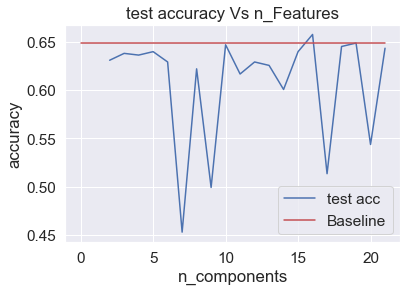

In [ ]:
plt.plot(range(2,22),Mutinfo_test_acc)
plt.plot(range(0,22),[baseline_acc]*22,'r')
plt.legend(['test acc', 'Baseline']) 
plt.title('test accuracy Vs n_Features')
plt.xlabel('n_components')
plt.ylabel('accuracy')

In [ ]:
print("Best number of Features gives maximum accuaracy is :",Mutinfo_test_acc[Best_number_of_Features-2])

Best number of Features gives maximum accuaracy is : 0.6506238579750061


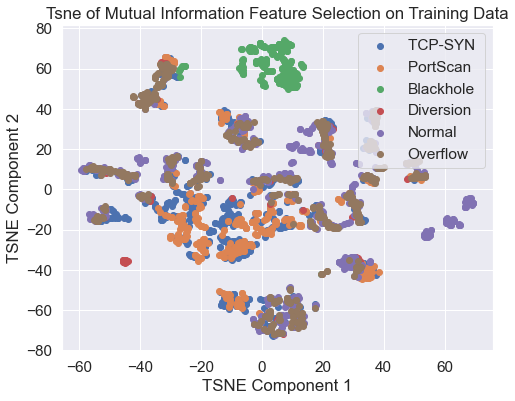

In [ ]:
plot_tsne(x_train_scaled_Minfo, train_y, "Tsne of Mutual Information Feature Selection on Training Data")

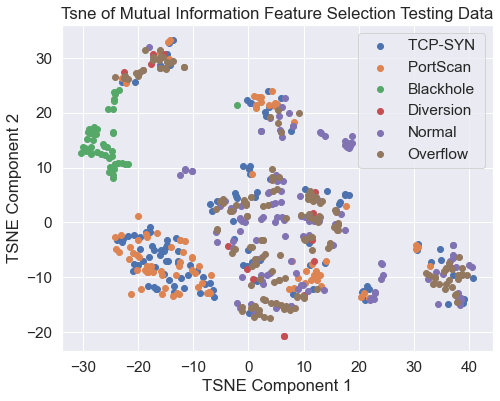

In [ ]:
plot_tsne(x_test_scaled_Minfo, test_y, "Tsne of Mutual Information Feature Selection Testing Data")

### Updated Dataset

In [ ]:
#ANOVA Selection
fvalue_Bestt = SelectKBest(f_classif, k=10)
x_train_anovaa=fvalue_Bestt.fit_transform(train_x,train['Label'])
x_val_anovaa= fvalue_Bestt.transform(val_x)
x_test_anovaa= fvalue_Bestt.transform(test_x)

#Scalling
scaler2 = StandardScaler()
x_train_scaled_anovaa = scaler2.fit_transform(x_train_anovaa)
x_val_scaled_anovaa = scaler2.transform(x_val_anovaa)
x_test_scaled_anovaa = scaler2.transform(x_test_anovaa)

#Q3:

##1) Batch size varies

In [ ]:
def model_batch(batch_n):
    total_train_batch= []
    total_val_batch= []
    total_acc_batch=[]
    confusion=[]
    number_of_runs=5
    for i in range(number_of_runs):
        optimizer=tfaAdamw.optimizers.AdamW(learning_rate= 0.001, weight_decay= 0.001)
        model = keras.models.Sequential()
        model.add(Dense(10, input_shape = (10,), activation = 'relu'))
        model.add(Dense(6, activation = "softmax"))
        model.compile(optimizer=optimizer, loss="sparse_categorical_crossentropy", metrics = ["accuracy"])
        model.fit(x_train_scaled_anovaa, train_y, epochs=500, batch_size=batch_n, validation_data=(x_test_scaled_anovaa, test_y))
        model.history.history
        total_train_batch.append(model.history.history['accuracy'])
        total_acc_batch.append(model.evaluate(x_test_scaled_anovaa,test_y, verbose=0)[1])
        total_val_batch.append(model.evaluate(x_val_scaled_anovaa,val_y, verbose=0)[1])
        

        y_pred = np.argmax(model.predict(x_test_scaled_anovaa), axis=-1)
        data= confusion_matrix(test_y, y_pred)
        confusion.append(data)
        labels =['TCP-SYN ','PortScan ','Blackhole','Diversion','Normal','Overflow']
        plot_confusion_matrix(data,labels)

    
    return total_train_batch,total_val_batch,total_acc_batch


### Batch size= 32 

Epoch 1/500
82/82 [==============================] - 0s 2ms/step - loss: 1.8434 - accuracy: 0.3150 - val_loss: 1.6052 - val_accuracy: 0.3583
Epoch 2/500
82/82 [==============================] - 0s 739us/step - loss: 1.5107 - accuracy: 0.4024 - val_loss: 1.4114 - val_accuracy: 0.5152
Epoch 3/500
82/82 [==============================] - 0s 739us/step - loss: 1.3494 - accuracy: 0.5258 - val_loss: 1.2892 - val_accuracy: 0.5704
Epoch 4/500
82/82 [==============================] - 0s 751us/step - loss: 1.2329 - accuracy: 0.5636 - val_loss: 1.1854 - val_accuracy: 0.5989
Epoch 5/500
82/82 [==============================] - 0s 733us/step - loss: 1.1408 - accuracy: 0.5926 - val_loss: 1.0990 - val_accuracy: 0.6043
Epoch 6/500
82/82 [==============================] - 0s 744us/step - loss: 1.0663 - accuracy: 0.5976 - val_loss: 1.0267 - val_accuracy: 0.6150
Epoch 7/500
82/82 [==============================] - 0s 724us/step - loss: 1.0066 - accuracy: 0.6079 - val_loss: 0.9723 - val_accuracy: 0.6364
E

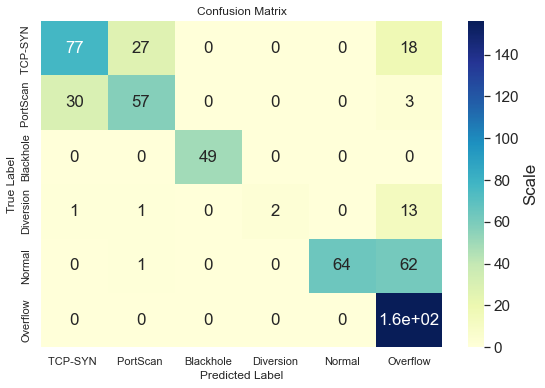

Epoch 1/500
82/82 [==============================] - 0s 1ms/step - loss: 1.4983 - accuracy: 0.3650 - val_loss: 1.3378 - val_accuracy: 0.4902
Epoch 2/500
82/82 [==============================] - 0s 740us/step - loss: 1.2746 - accuracy: 0.5036 - val_loss: 1.1726 - val_accuracy: 0.5704
Epoch 3/500
82/82 [==============================] - 0s 762us/step - loss: 1.1364 - accuracy: 0.5571 - val_loss: 1.0550 - val_accuracy: 0.6096
Epoch 4/500
82/82 [==============================] - 0s 745us/step - loss: 1.0378 - accuracy: 0.5960 - val_loss: 0.9834 - val_accuracy: 0.6381
Epoch 5/500
82/82 [==============================] - 0s 739us/step - loss: 0.9799 - accuracy: 0.6105 - val_loss: 0.9415 - val_accuracy: 0.6364
Epoch 6/500
82/82 [==============================] - 0s 681us/step - loss: 0.9443 - accuracy: 0.6285 - val_loss: 0.9144 - val_accuracy: 0.6435
Epoch 7/500
82/82 [==============================] - 0s 819us/step - loss: 0.9193 - accuracy: 0.6396 - val_loss: 0.8930 - val_accuracy: 0.6667
E

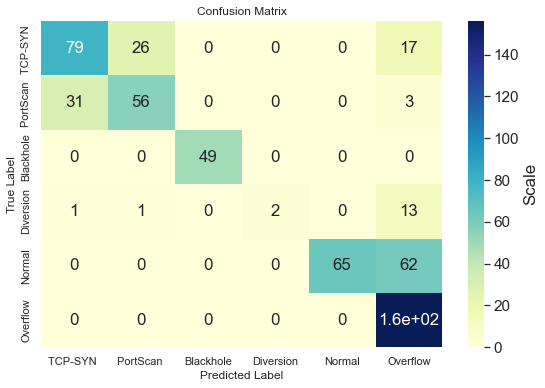

Epoch 1/500
82/82 [==============================] - 0s 2ms/step - loss: 1.6413 - accuracy: 0.4021 - val_loss: 1.4763 - val_accuracy: 0.5045
Epoch 2/500
82/82 [==============================] - 0s 744us/step - loss: 1.4060 - accuracy: 0.5025 - val_loss: 1.2882 - val_accuracy: 0.5544
Epoch 3/500
82/82 [==============================] - 0s 759us/step - loss: 1.2382 - accuracy: 0.5372 - val_loss: 1.1547 - val_accuracy: 0.5847
Epoch 4/500
82/82 [==============================] - 0s 668us/step - loss: 1.1255 - accuracy: 0.5685 - val_loss: 1.0672 - val_accuracy: 0.6025
Epoch 5/500
82/82 [==============================] - 0s 752us/step - loss: 1.0508 - accuracy: 0.5865 - val_loss: 1.0101 - val_accuracy: 0.6364
Epoch 6/500
82/82 [==============================] - 0s 739us/step - loss: 0.9998 - accuracy: 0.6151 - val_loss: 0.9680 - val_accuracy: 0.6488
Epoch 7/500
82/82 [==============================] - 0s 714us/step - loss: 0.9649 - accuracy: 0.6254 - val_loss: 0.9384 - val_accuracy: 0.6631
E

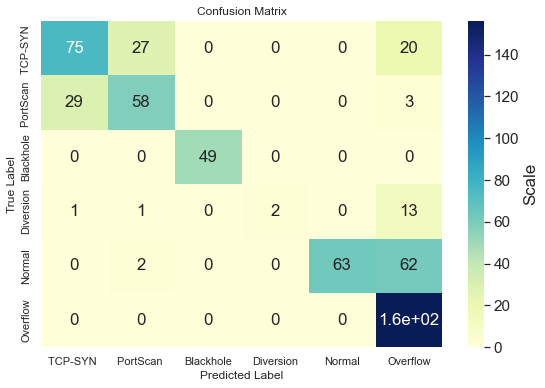

Epoch 1/500
82/82 [==============================] - 0s 2ms/step - loss: 1.7193 - accuracy: 0.3601 - val_loss: 1.5498 - val_accuracy: 0.4421
Epoch 2/500
82/82 [==============================] - 0s 744us/step - loss: 1.4454 - accuracy: 0.4395 - val_loss: 1.3570 - val_accuracy: 0.4652
Epoch 3/500
82/82 [==============================] - 0s 763us/step - loss: 1.2885 - accuracy: 0.4632 - val_loss: 1.2343 - val_accuracy: 0.4955
Epoch 4/500
82/82 [==============================] - 0s 754us/step - loss: 1.1827 - accuracy: 0.5067 - val_loss: 1.1456 - val_accuracy: 0.5455
Epoch 5/500
82/82 [==============================] - 0s 737us/step - loss: 1.1085 - accuracy: 0.5598 - val_loss: 1.0791 - val_accuracy: 0.6132
Epoch 6/500
82/82 [==============================] - 0s 726us/step - loss: 1.0520 - accuracy: 0.6029 - val_loss: 1.0296 - val_accuracy: 0.6328
Epoch 7/500
82/82 [==============================] - 0s 765us/step - loss: 1.0067 - accuracy: 0.6262 - val_loss: 0.9884 - val_accuracy: 0.6613
E

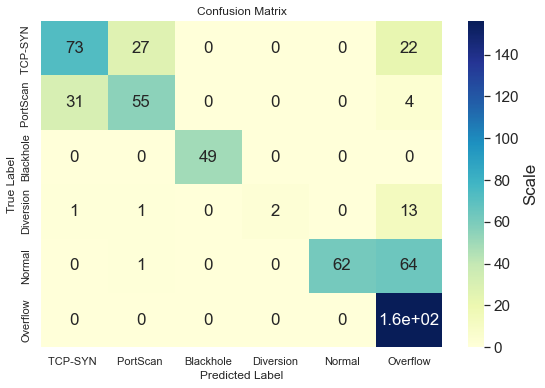

Epoch 1/500
82/82 [==============================] - 0s 1ms/step - loss: 1.6697 - accuracy: 0.2753 - val_loss: 1.5116 - val_accuracy: 0.3351
Epoch 2/500
82/82 [==============================] - 0s 756us/step - loss: 1.4034 - accuracy: 0.4238 - val_loss: 1.3304 - val_accuracy: 0.4456
Epoch 3/500
82/82 [==============================] - 0s 733us/step - loss: 1.2614 - accuracy: 0.4987 - val_loss: 1.2066 - val_accuracy: 0.5651
Epoch 4/500
82/82 [==============================] - 0s 745us/step - loss: 1.1561 - accuracy: 0.5823 - val_loss: 1.1074 - val_accuracy: 0.6417
Epoch 5/500
82/82 [==============================] - 0s 739us/step - loss: 1.0727 - accuracy: 0.6048 - val_loss: 1.0313 - val_accuracy: 0.6684
Epoch 6/500
82/82 [==============================] - 0s 788us/step - loss: 1.0102 - accuracy: 0.6369 - val_loss: 0.9776 - val_accuracy: 0.6720
Epoch 7/500
82/82 [==============================] - 0s 788us/step - loss: 0.9654 - accuracy: 0.6434 - val_loss: 0.9382 - val_accuracy: 0.6738
E

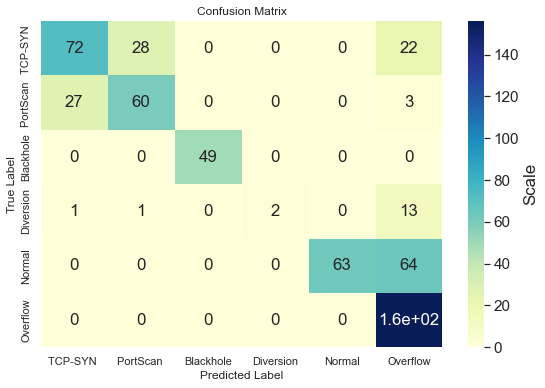

In [ ]:
total_32_train, total_32_val, total_32_test = model_batch(32)

In [ ]:
# Training acc 
# Max
max_training_accuracy_32 = np.amax(total_32_train)
# Min 
min_training_accuracy_32 = np.amin(total_32_train)
#Avg
avg_training_accuracy_32 = np.average(total_32_train)

# Testing acc 
# Max
max_testing_accuracy_32 =  np.amax(total_32_test)
# Min 
min_testing_accuracy_32 =  np.amin(total_32_test)
# Avg
avg_testing_accuracy_32 =  np.average(total_32_test)


# Val acc 
# Max
max_val_accuracy_32 =  np.amax(total_32_val)
# Min 
min_val_accuracy_32 =  np.amin(total_32_val)
# Avg
avg_val_accuracy_32 =  np.average(total_32_val)

print('Min, Max, Avg Accuracies', '\n')
print('Max_training_accuracy:', max_training_accuracy_32 )
print('Min_training_accuracy: ', min_training_accuracy_32)
print('Avg_training_accuracy: ', avg_training_accuracy_32)
print('----------------------------------------------')
print('Max_testing_accuracy: ', max_testing_accuracy_32)
print('Min_testing_accuracy: ', min_testing_accuracy_32)
print('Avg_testing_accuracy: ', avg_testing_accuracy_32)
print('----------------------------------------------')
print('Max_Valadation_accuracy: ', max_val_accuracy_32)
print('Min_Valadation_accuracy: ', min_val_accuracy_32)
print('Avg_Valadation_accuracy: ', avg_val_accuracy_32)



Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7090492844581604
Min_training_accuracy:  0.2752959132194519
Avg_training_accuracy:  0.6970663571953774
----------------------------------------------
Max_testing_accuracy:  0.7254902124404907
Min_testing_accuracy:  0.7076649069786072
Avg_testing_accuracy:  0.7180035710334778
----------------------------------------------
Max_Valadation_accuracy:  0.7130124568939209
Min_Valadation_accuracy:  0.70944744348526
Avg_Valadation_accuracy:  0.7105169415473938


### Batch size= 64

Epoch 1/500
41/41 [==============================] - 0s 3ms/step - loss: 1.9768 - accuracy: 0.1653 - val_loss: 1.8490 - val_accuracy: 0.1889
Epoch 2/500
41/41 [==============================] - 0s 1ms/step - loss: 1.7439 - accuracy: 0.2066 - val_loss: 1.6715 - val_accuracy: 0.2906
Epoch 3/500
41/41 [==============================] - 0s 1ms/step - loss: 1.5874 - accuracy: 0.4028 - val_loss: 1.5395 - val_accuracy: 0.4421
Epoch 4/500
41/41 [==============================] - 0s 1ms/step - loss: 1.4662 - accuracy: 0.4582 - val_loss: 1.4315 - val_accuracy: 0.4617
Epoch 5/500
41/41 [==============================] - 0s 1ms/step - loss: 1.3685 - accuracy: 0.4830 - val_loss: 1.3388 - val_accuracy: 0.4777
Epoch 6/500
41/41 [==============================] - 0s 1ms/step - loss: 1.2853 - accuracy: 0.5170 - val_loss: 1.2575 - val_accuracy: 0.5312
Epoch 7/500
41/41 [==============================] - 0s 1ms/step - loss: 1.2126 - accuracy: 0.5407 - val_loss: 1.1861 - val_accuracy: 0.5597
Epoch 8/500
4

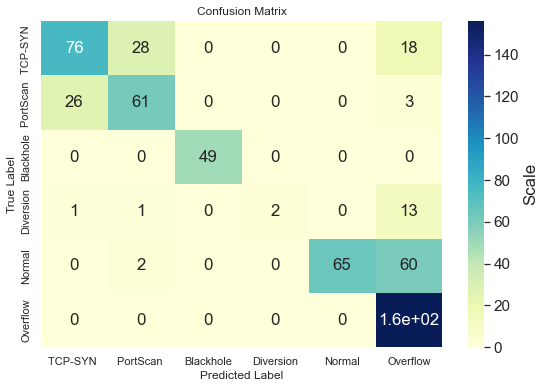

Epoch 1/500
41/41 [==============================] - 0s 3ms/step - loss: 1.8641 - accuracy: 0.1756 - val_loss: 1.7180 - val_accuracy: 0.1765
Epoch 2/500
41/41 [==============================] - 0s 952us/step - loss: 1.5978 - accuracy: 0.3005 - val_loss: 1.5013 - val_accuracy: 0.4902
Epoch 3/500
41/41 [==============================] - 0s 960us/step - loss: 1.4261 - accuracy: 0.5212 - val_loss: 1.3546 - val_accuracy: 0.5597
Epoch 4/500
41/41 [==============================] - 0s 969us/step - loss: 1.3030 - accuracy: 0.5594 - val_loss: 1.2475 - val_accuracy: 0.5758
Epoch 5/500
41/41 [==============================] - 0s 926us/step - loss: 1.2105 - accuracy: 0.5659 - val_loss: 1.1665 - val_accuracy: 0.5775
Epoch 6/500
41/41 [==============================] - 0s 960us/step - loss: 1.1401 - accuracy: 0.5712 - val_loss: 1.1056 - val_accuracy: 0.6078
Epoch 7/500
41/41 [==============================] - 0s 972us/step - loss: 1.0867 - accuracy: 0.5903 - val_loss: 1.0594 - val_accuracy: 0.6203
E

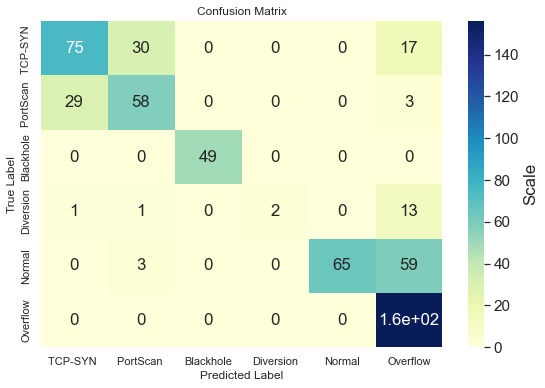

Epoch 1/500
41/41 [==============================] - 0s 3ms/step - loss: 1.9191 - accuracy: 0.2085 - val_loss: 1.7563 - val_accuracy: 0.3262
Epoch 2/500
41/41 [==============================] - 0s 1ms/step - loss: 1.6960 - accuracy: 0.3559 - val_loss: 1.6048 - val_accuracy: 0.3743
Epoch 3/500
41/41 [==============================] - 0s 972us/step - loss: 1.5671 - accuracy: 0.3784 - val_loss: 1.4914 - val_accuracy: 0.4082
Epoch 4/500
41/41 [==============================] - 0s 913us/step - loss: 1.4589 - accuracy: 0.4097 - val_loss: 1.3883 - val_accuracy: 0.4742
Epoch 5/500
41/41 [==============================] - 0s 984us/step - loss: 1.3630 - accuracy: 0.4593 - val_loss: 1.3018 - val_accuracy: 0.5223
Epoch 6/500
41/41 [==============================] - 0s 971us/step - loss: 1.2836 - accuracy: 0.5029 - val_loss: 1.2324 - val_accuracy: 0.5437
Epoch 7/500
41/41 [==============================] - 0s 972us/step - loss: 1.2207 - accuracy: 0.5269 - val_loss: 1.1769 - val_accuracy: 0.5686
Epo

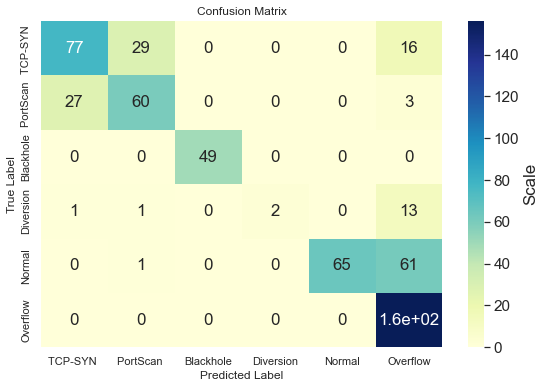

Epoch 1/500
41/41 [==============================] - 0s 3ms/step - loss: 1.8328 - accuracy: 0.2241 - val_loss: 1.6754 - val_accuracy: 0.3387
Epoch 2/500
41/41 [==============================] - 0s 947us/step - loss: 1.5940 - accuracy: 0.4032 - val_loss: 1.5009 - val_accuracy: 0.4724
Epoch 3/500
41/41 [==============================] - 0s 953us/step - loss: 1.4552 - accuracy: 0.4906 - val_loss: 1.3934 - val_accuracy: 0.5241
Epoch 4/500
41/41 [==============================] - 0s 928us/step - loss: 1.3673 - accuracy: 0.5334 - val_loss: 1.3207 - val_accuracy: 0.5561
Epoch 5/500
41/41 [==============================] - 0s 943us/step - loss: 1.3025 - accuracy: 0.5483 - val_loss: 1.2625 - val_accuracy: 0.5775
Epoch 6/500
41/41 [==============================] - 0s 932us/step - loss: 1.2496 - accuracy: 0.5563 - val_loss: 1.2135 - val_accuracy: 0.5918
Epoch 7/500
41/41 [==============================] - 0s 933us/step - loss: 1.2043 - accuracy: 0.5662 - val_loss: 1.1705 - val_accuracy: 0.6025
E

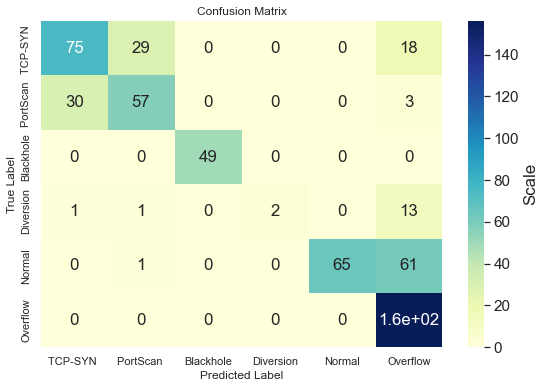

Epoch 1/500
41/41 [==============================] - 0s 3ms/step - loss: 1.5543 - accuracy: 0.3540 - val_loss: 1.4768 - val_accuracy: 0.4064
Epoch 2/500
41/41 [==============================] - 0s 974us/step - loss: 1.4131 - accuracy: 0.4456 - val_loss: 1.3625 - val_accuracy: 0.4385
Epoch 3/500
41/41 [==============================] - 0s 923us/step - loss: 1.3088 - accuracy: 0.4838 - val_loss: 1.2717 - val_accuracy: 0.4456
Epoch 4/500
41/41 [==============================] - 0s 944us/step - loss: 1.2233 - accuracy: 0.5013 - val_loss: 1.1933 - val_accuracy: 0.4439
Epoch 5/500
41/41 [==============================] - 0s 947us/step - loss: 1.1504 - accuracy: 0.5101 - val_loss: 1.1282 - val_accuracy: 0.4510
Epoch 6/500
41/41 [==============================] - 0s 938us/step - loss: 1.0906 - accuracy: 0.5296 - val_loss: 1.0735 - val_accuracy: 0.4938
Epoch 7/500
41/41 [==============================] - 0s 947us/step - loss: 1.0419 - accuracy: 0.5766 - val_loss: 1.0290 - val_accuracy: 0.5526
E

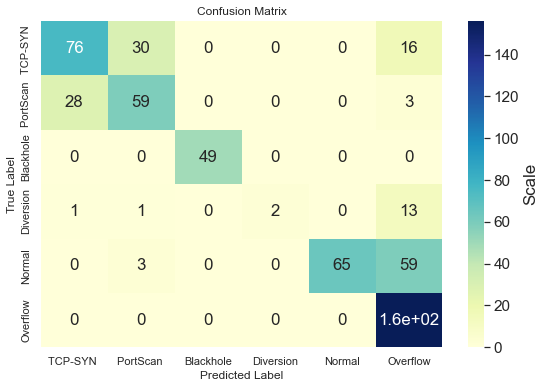

In [ ]:
total_64_train, total_64_val, total_64_test = model_batch(64)

In [ ]:
# Training acc 
# Max
max_training_accuracy_64 = np.amax(total_64_train)
# Min 
min_training_accuracy_64 = np.amin(total_64_train)
#Avg
avg_training_accuracy_64 = np.average(total_64_train)

# Testing acc 
# Max
max_testing_accuracy_64 =  np.amax(total_64_test)
# Min 
min_testing_accuracy_64 =  np.amin(total_64_test)
# Avg
avg_testing_accuracy_64 =  np.average(total_64_test)

# Val acc 
# Max
max_val_accuracy_64 =  np.amax(total_64_val)
# Min 
min_val_accuracy_64 =  np.amin(total_64_val)
# Avg
avg_val_accuracy_64 =  np.average(total_64_val)

print('Min, Max, Avg Accuracies', '\n')
print('Max_training_accuracy:', max_training_accuracy_64)
print('Min_training_accuracy: ', min_training_accuracy_64)
print('Avg_training_accuracy: ', avg_training_accuracy_64)
print('----------------------------------------------')
print('Max_testing_accuracy: ', max_testing_accuracy_64)
print('Min_testing_accuracy: ', min_testing_accuracy_64)
print('Avg_testing_accuracy: ', avg_testing_accuracy_64)
print('----------------------------------------------')
print('Max_Valadation_accuracy: ', max_val_accuracy_64)
print('Min_Valadation_accuracy: ', min_val_accuracy_64)
print('Avg_Valadation_accuracy: ', avg_val_accuracy_64)



Min, Max, Avg Accuracies 

Max_training_accuracy: 0.717449426651001
Min_training_accuracy:  0.16533027589321136
Avg_training_accuracy:  0.7014322999298572
----------------------------------------------
Max_testing_accuracy:  0.7290552854537964
Min_testing_accuracy:  0.7201426029205322
Avg_testing_accuracy:  0.7251337051391602
----------------------------------------------
Max_Valadation_accuracy:  0.7272727489471436
Min_Valadation_accuracy:  0.7165775299072266
Avg_Valadation_accuracy:  0.7215686321258545


### Batch size= 128

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 2.2997 - accuracy: 0.1405 - val_loss: 2.1482 - val_accuracy: 0.1586
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 2.0996 - accuracy: 0.1585 - val_loss: 1.9718 - val_accuracy: 0.1872
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.9332 - accuracy: 0.1875 - val_loss: 1.8218 - val_accuracy: 0.2157
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.7866 - accuracy: 0.2207 - val_loss: 1.6930 - val_accuracy: 0.2674
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.6596 - accuracy: 0.2677 - val_loss: 1.5822 - val_accuracy: 0.3137
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5502 - accuracy: 0.3276 - val_loss: 1.4920 - val_accuracy: 0.3743
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4649 - accuracy: 0.4173 - val_loss: 1.4222 - val_accuracy: 0.5116
Epoch 8/500
2

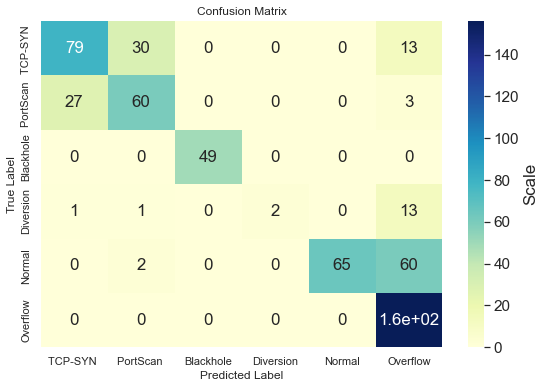

Epoch 1/500
21/21 [==============================] - 0s 4ms/step - loss: 2.0091 - accuracy: 0.1898 - val_loss: 1.9229 - val_accuracy: 0.2567
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.8518 - accuracy: 0.2719 - val_loss: 1.7835 - val_accuracy: 0.3102
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.7271 - accuracy: 0.3051 - val_loss: 1.6692 - val_accuracy: 0.3494
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.6212 - accuracy: 0.3406 - val_loss: 1.5691 - val_accuracy: 0.3761
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5283 - accuracy: 0.3742 - val_loss: 1.4808 - val_accuracy: 0.4278
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4459 - accuracy: 0.4506 - val_loss: 1.4050 - val_accuracy: 0.4795
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3750 - accuracy: 0.4918 - val_loss: 1.3397 - val_accuracy: 0.5116
Epoch 8/500
2

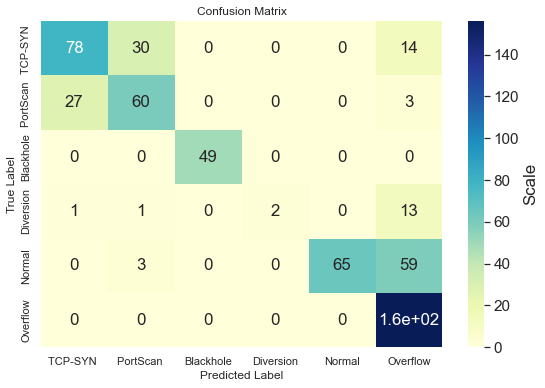

Epoch 1/500
21/21 [==============================] - 0s 12ms/step - loss: 1.7584 - accuracy: 0.3551 - val_loss: 1.6852 - val_accuracy: 0.3868
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.6604 - accuracy: 0.3738 - val_loss: 1.5993 - val_accuracy: 0.4011
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5811 - accuracy: 0.3937 - val_loss: 1.5303 - val_accuracy: 0.4135
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5149 - accuracy: 0.4181 - val_loss: 1.4711 - val_accuracy: 0.4385
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4568 - accuracy: 0.4498 - val_loss: 1.4181 - val_accuracy: 0.4688
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4050 - accuracy: 0.4800 - val_loss: 1.3713 - val_accuracy: 0.5009
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3593 - accuracy: 0.5090 - val_loss: 1.3307 - val_accuracy: 0.5258
Epoch 8/500


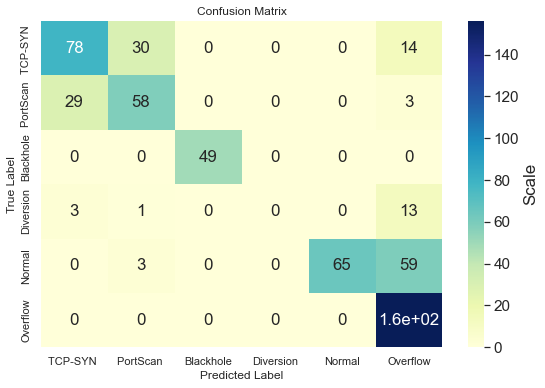

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.9675 - accuracy: 0.0821 - val_loss: 1.8929 - val_accuracy: 0.0998
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.8378 - accuracy: 0.1229 - val_loss: 1.7649 - val_accuracy: 0.2709
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.7311 - accuracy: 0.2631 - val_loss: 1.6646 - val_accuracy: 0.3494
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.6469 - accuracy: 0.3482 - val_loss: 1.5831 - val_accuracy: 0.4189
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5786 - accuracy: 0.4013 - val_loss: 1.5135 - val_accuracy: 0.4670
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5177 - accuracy: 0.4219 - val_loss: 1.4513 - val_accuracy: 0.4777
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4593 - accuracy: 0.4464 - val_loss: 1.3895 - val_accuracy: 0.4973
Epoch 8/500
2

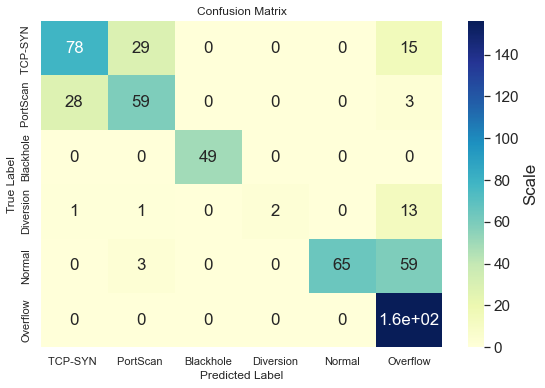

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.9264 - accuracy: 0.1157 - val_loss: 1.8754 - val_accuracy: 0.1105
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.8111 - accuracy: 0.1336 - val_loss: 1.7734 - val_accuracy: 0.1408
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.7222 - accuracy: 0.1718 - val_loss: 1.6915 - val_accuracy: 0.1907
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.6495 - accuracy: 0.2619 - val_loss: 1.6218 - val_accuracy: 0.3351
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5853 - accuracy: 0.3654 - val_loss: 1.5544 - val_accuracy: 0.4421
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5221 - accuracy: 0.4460 - val_loss: 1.4873 - val_accuracy: 0.4938
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4575 - accuracy: 0.4922 - val_loss: 1.4159 - val_accuracy: 0.5312
Epoch 8/500
2

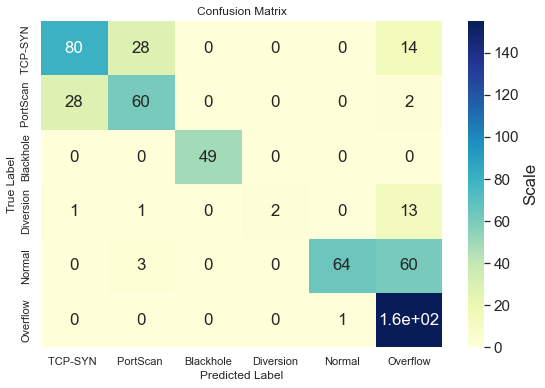

In [ ]:
total_128_train, total_128_val, total_128_test = model_batch(128)

In [ ]:
# Training acc 
# Max
max_training_accuracy_128 = np.amax(total_128_train)
# Min 
min_training_accuracy_128 = np.amin(total_128_train)
#Avg
avg_training_accuracy_128 = np.average(total_128_train)

# Testing acc 
# Max
max_testing_accuracy_128 =  np.amax(total_128_test)
# Min 
min_testing_accuracy_128 =  np.amin(total_128_test)
# Avg
avg_testing_accuracy_128 =  np.average(total_128_test)

# Val acc 
# Max
max_val_accuracy_128 =  np.amax(total_128_val)
# Min 
min_val_accuracy_128 =  np.amin(total_128_val)
# Avg
avg_val_accuracy_128 =  np.average(total_128_val)



print('Min, Max, Avg Accuracies', '\n')
print('Max_training_accuracy:', max_training_accuracy_128 )
print('Min_training_accuracy: ', min_training_accuracy_128)
print('Avg_training_accuracy: ', avg_training_accuracy_128)
print('----------------------------------------------')
print('Max_testing_accuracy: ', max_testing_accuracy_128)
print('Min_testing_accuracy: ', min_testing_accuracy_128)
print('Avg_testing_accuracy: ', avg_testing_accuracy_128)
print('----------------------------------------------')
print('Max_val_accuracy: ', max_val_accuracy_128)
print('Min_val_accuracy: ', min_val_accuracy_128)
print('Avg_val_accuracy: ', avg_val_accuracy_128)


Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7212676405906677
Min_training_accuracy:  0.08209240436553955
Avg_training_accuracy:  0.6991505135685205
----------------------------------------------
Max_testing_accuracy:  0.7326202988624573
Min_testing_accuracy:  0.7237076759338379
Avg_testing_accuracy:  0.7294117569923401
----------------------------------------------
Max_val_accuracy:  0.7379679083824158
Min_val_accuracy:  0.7219251394271851
Avg_val_accuracy:  0.7276292324066163


# Q3).2  Hidden layers vs. neurons/layer									 


Here, we will use the best batch size from Q3/1, which is <b>....</b>

### At one Hidden Layer 

In [ ]:
from keras.layers import Input, Dense, Flatten
from keras.models import Model
from sklearn.metrics import confusion_matrix
import tensorflow as tf

In [ ]:
def model_one_hidden(neuro):
    total_train_acc= []
    total_test_acc= []
    total_val_acc=[]
    confusion=[]
    number_of_runs=5
    for i in range(number_of_runs):
        optimizer=tfaAdamw.optimizers.AdamW(learning_rate= 0.001, weight_decay= 0.001)

        model = keras.models.Sequential()
        model.add(Dense(neuro, input_shape = (10,), activation = 'relu'))
        model.add(Dense(6, activation = "softmax"))
        callback = tf.keras.callbacks.EarlyStopping(monitor='loss', patience=5)
        model.compile(optimizer=optimizer, loss="sparse_categorical_crossentropy", metrics = ["accuracy"])
        model.fit(x_train_scaled_anovaa, train_y, epochs=500, batch_size=128, validation_data=(x_val_scaled_anovaa,val_y),callbacks=[callback])
        total_train_acc.append(model.evaluate(x_train_scaled_anovaa, train_y, verbose=0)[1])
        total_test_acc.append(model.evaluate(x_test_scaled_anovaa, test_y, verbose=0)[1])
        total_val_acc.append(model.evaluate(x_val_scaled_anovaa,val_y, verbose=0)[1])
        

        y_pred = np.argmax(model.predict(x_test_scaled_anovaa), axis=-1)
        data= confusion_matrix(test_y, y_pred)
        confusion.append(data)
        labels =['TCP-SYN ','PortScan ','Blackhole','Diversion','Normal','Overflow']
        plot_confusion_matrix(data,labels)

    # Training acc 
    # Max
    max_training_accuracy = np.amax(total_train_acc)
    # Min 
    min_training_accuracy = np.amin(total_train_acc)
    #Avg
    avg_training_accuracy = np.average(total_train_acc)

    # Testing acc 
    # Max
    max_testing_accuracy =  np.amax(total_test_acc)
    # Min 
    min_testing_accuracy =  np.amin(total_test_acc)
    # Avg
    avg_testing_accuracy =  np.average(total_test_acc)

    # Valadation acc 
    # Max
    max_Valadation_accuracy =  np.amax(total_val_acc)
    # Min 
    min_Valadation_accuracy =  np.amin(total_val_acc)
    # Avg
    avg_Valadation_accuracy =  np.average(total_val_acc)

    print('Min, Max, Avg Accuracies', '\n')
    print('Max_training_accuracy:', max_training_accuracy )
    print('Min_training_accuracy: ', min_training_accuracy)
    print('Avg_training_accuracy: ', avg_training_accuracy)
    print('----------------------------------------------')
    print('Max_testing_accuracy: ', max_testing_accuracy)
    print('Min_testing_accuracy: ', min_testing_accuracy)
    print('Avg_testing_accuracy: ', avg_testing_accuracy)
    print('----------------------------------------------')
    print('Max_Valadation_accuracy: ', max_Valadation_accuracy)
    print('Min_Valadation_accuracy: ', min_Valadation_accuracy)
    print('Avg_Valadation_accuracy: ', avg_Valadation_accuracy)
    
    return total_train_acc,total_test_acc,total_val_acc

In [ ]:
  def clac_min_max_average(total_acc_train,total_test_acc,total_acc_val):
    # Training acc 
    # Max
    max_training_accuracy = np.amax(total_acc_train)
    # Min 
    min_training_accuracy = np.amin(total_acc_train)
    #Avg
    avg_training_accuracy = np.average(total_acc_train)

    # Testing acc 
    # Max
    max_testing_accuracy =  np.amax(total_test_acc)
    # Min 
    min_testing_accuracy =  np.amin(total_test_acc)
    # Avg
    avg_testing_accuracy =  np.average(total_test_acc)

    # Valadation acc 
    # Max
    max_Valadation_accuracy =  np.amax(total_acc_val)
    # Min 
    min_Valadation_accuracy =  np.amin(total_acc_val)
    # Avg
    avg_Valadation_accuracy =  np.average(total_acc_val)

    print('Min, Max, Avg Accuracies', '\n')
    print('Max_training_accuracy:', max_training_accuracy )
    print('Min_training_accuracy: ', min_training_accuracy)
    print('Avg_training_accuracy: ', avg_training_accuracy)
    print('----------------------------------------------')
    print('Max_testing_accuracy: ', max_testing_accuracy)
    print('Min_testing_accuracy: ', min_testing_accuracy)
    print('Avg_testing_accuracy: ', avg_testing_accuracy)
    print('----------------------------------------------')
    print('Max_Valadation_accuracy: ', max_Valadation_accuracy)
    print('Min_Valadation_accuracy: ', min_Valadation_accuracy)
    print('Avg_Valadation_accuracy: ', avg_Valadation_accuracy)

#### 1 Hidden Layer with 10 neurones

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.9328 - accuracy: 0.0825 - val_loss: 1.8819 - val_accuracy: 0.1836
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.8132 - accuracy: 0.2222 - val_loss: 1.7814 - val_accuracy: 0.3102
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.7247 - accuracy: 0.3013 - val_loss: 1.7049 - val_accuracy: 0.3815
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.6564 - accuracy: 0.3784 - val_loss: 1.6436 - val_accuracy: 0.4189
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.6014 - accuracy: 0.4364 - val_loss: 1.5889 - val_accuracy: 0.4421
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5522 - accuracy: 0.4716 - val_loss: 1.5387 - val_accuracy: 0.4813
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5053 - accuracy: 0.5013 - val_loss: 1.4901 - val_accuracy: 0.5348
Epoch 8/500
2

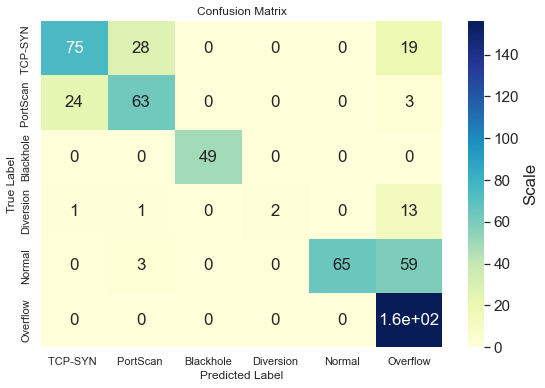

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.7156 - accuracy: 0.2627 - val_loss: 1.6491 - val_accuracy: 0.3066
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.6027 - accuracy: 0.2890 - val_loss: 1.5515 - val_accuracy: 0.3173
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5151 - accuracy: 0.2986 - val_loss: 1.4726 - val_accuracy: 0.3316
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4423 - accuracy: 0.3421 - val_loss: 1.4083 - val_accuracy: 0.3975
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3824 - accuracy: 0.3982 - val_loss: 1.3528 - val_accuracy: 0.4367
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3304 - accuracy: 0.4368 - val_loss: 1.3031 - val_accuracy: 0.4706
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 1.2834 - accuracy: 0.4738 - val_loss: 1.2580 - val_accuracy: 0.5152
Epoch 8/500
2

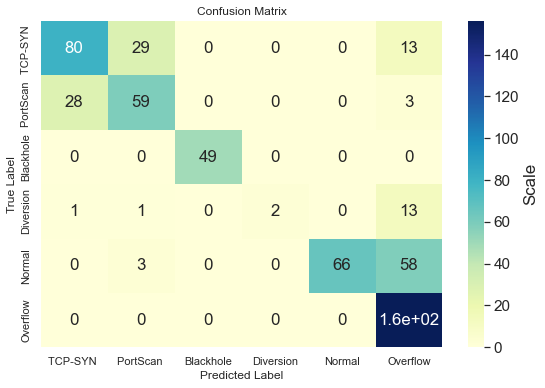

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.8413 - accuracy: 0.2856 - val_loss: 1.7347 - val_accuracy: 0.2799
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.7059 - accuracy: 0.2959 - val_loss: 1.6230 - val_accuracy: 0.2959
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5989 - accuracy: 0.3299 - val_loss: 1.5341 - val_accuracy: 0.3547
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5133 - accuracy: 0.3883 - val_loss: 1.4595 - val_accuracy: 0.4225
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4405 - accuracy: 0.4357 - val_loss: 1.3948 - val_accuracy: 0.4563
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3765 - accuracy: 0.4555 - val_loss: 1.3367 - val_accuracy: 0.4831
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3181 - accuracy: 0.4803 - val_loss: 1.2826 - val_accuracy: 0.4973
Epoch 8/500
2

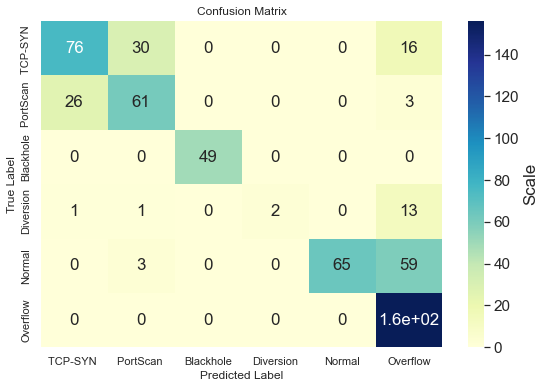

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 2.0707 - accuracy: 0.2295 - val_loss: 1.9980 - val_accuracy: 0.2406
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.8894 - accuracy: 0.2936 - val_loss: 1.8537 - val_accuracy: 0.3173
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.7544 - accuracy: 0.3597 - val_loss: 1.7415 - val_accuracy: 0.3886
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.6539 - accuracy: 0.4093 - val_loss: 1.6540 - val_accuracy: 0.4367
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5748 - accuracy: 0.4383 - val_loss: 1.5846 - val_accuracy: 0.4474
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5112 - accuracy: 0.4521 - val_loss: 1.5235 - val_accuracy: 0.4563
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4560 - accuracy: 0.4647 - val_loss: 1.4670 - val_accuracy: 0.4599
Epoch 8/500
2

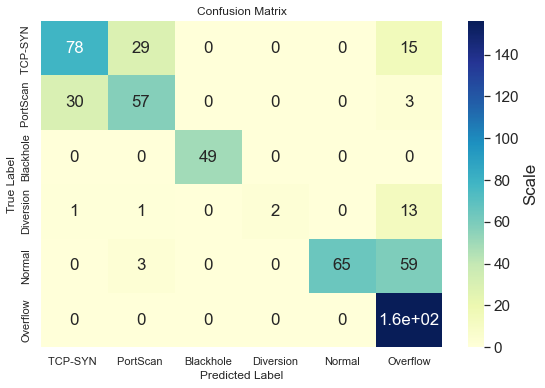

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.8214 - accuracy: 0.2982 - val_loss: 1.7121 - val_accuracy: 0.3440
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.6832 - accuracy: 0.3417 - val_loss: 1.5997 - val_accuracy: 0.3886
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5757 - accuracy: 0.3814 - val_loss: 1.5122 - val_accuracy: 0.4225
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4930 - accuracy: 0.4357 - val_loss: 1.4406 - val_accuracy: 0.4777
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4242 - accuracy: 0.4780 - val_loss: 1.3811 - val_accuracy: 0.5009
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3653 - accuracy: 0.5006 - val_loss: 1.3281 - val_accuracy: 0.5312
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3134 - accuracy: 0.5239 - val_loss: 1.2799 - val_accuracy: 0.5455
Epoch 8/500
2

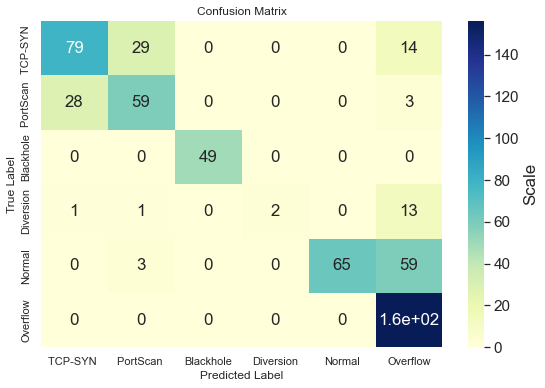

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.717449426651001
Min_training_accuracy:  0.7082856297492981
Avg_training_accuracy:  0.7134020686149597
----------------------------------------------
Max_testing_accuracy:  0.7344028353691101
Min_testing_accuracy:  0.7254902124404907
Avg_testing_accuracy:  0.7301247715950012
----------------------------------------------
Max_Valadation_accuracy:  0.7272727489471436
Min_Valadation_accuracy:  0.7076649069786072
Avg_Valadation_accuracy:  0.7187165856361389


In [ ]:
oneH_10n_train, oneH_10n_test,oneH_10n_val=model_one_hidden(10)

In [ ]:
clac_min_max_average(oneH_10n_train,oneH_10n_test,oneH_10n_val)

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.717449426651001
Min_training_accuracy:  0.7082856297492981
Avg_training_accuracy:  0.7134020686149597
----------------------------------------------
Max_testing_accuracy:  0.7344028353691101
Min_testing_accuracy:  0.7254902124404907
Avg_testing_accuracy:  0.7301247715950012
----------------------------------------------
Max_Valadation_accuracy:  0.7272727489471436
Min_Valadation_accuracy:  0.7076649069786072
Avg_Valadation_accuracy:  0.7187165856361389


In [ ]:
oneH_10n_avg =  np.average(oneH_10n_test)

#### 1 Hidden Layer with 20 neurones 

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.6788 - accuracy: 0.3734 - val_loss: 1.5875 - val_accuracy: 0.3975
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4769 - accuracy: 0.4223 - val_loss: 1.4291 - val_accuracy: 0.4278
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3410 - accuracy: 0.4628 - val_loss: 1.3126 - val_accuracy: 0.4688
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.2422 - accuracy: 0.4880 - val_loss: 1.2252 - val_accuracy: 0.5027
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.1682 - accuracy: 0.5113 - val_loss: 1.1571 - val_accuracy: 0.5455
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.1106 - accuracy: 0.5491 - val_loss: 1.1004 - val_accuracy: 0.5722
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 1.0633 - accuracy: 0.6029 - val_loss: 1.0539 - val_accuracy: 0.6239
Epoch 8/500
2

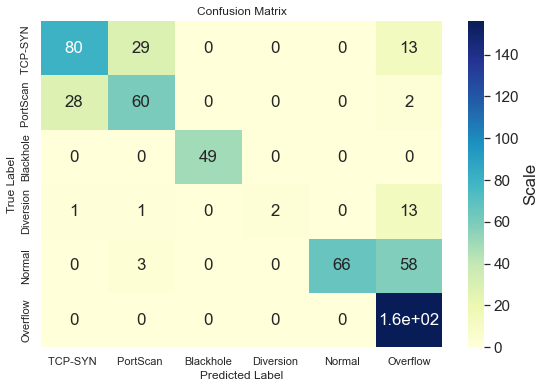

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.8935 - accuracy: 0.1523 - val_loss: 1.7455 - val_accuracy: 0.2050
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.6873 - accuracy: 0.2711 - val_loss: 1.5839 - val_accuracy: 0.3583
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5348 - accuracy: 0.3593 - val_loss: 1.4590 - val_accuracy: 0.4153
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4143 - accuracy: 0.4414 - val_loss: 1.3583 - val_accuracy: 0.4759
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3163 - accuracy: 0.4845 - val_loss: 1.2731 - val_accuracy: 0.4920
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.2376 - accuracy: 0.5239 - val_loss: 1.2011 - val_accuracy: 0.5579
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 1.1734 - accuracy: 0.5712 - val_loss: 1.1423 - val_accuracy: 0.5882
Epoch 8/500
2

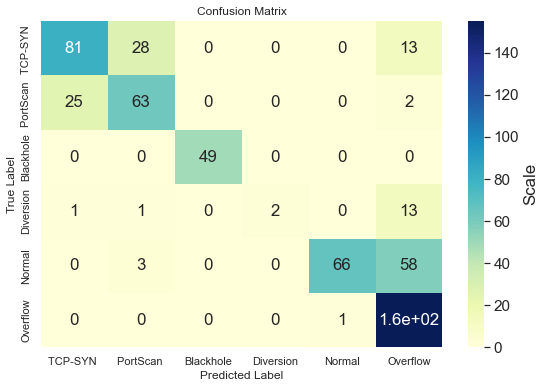

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.9806 - accuracy: 0.2638 - val_loss: 1.8173 - val_accuracy: 0.2406
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.7599 - accuracy: 0.2955 - val_loss: 1.6431 - val_accuracy: 0.3422
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5906 - accuracy: 0.3811 - val_loss: 1.5053 - val_accuracy: 0.4385
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4565 - accuracy: 0.4456 - val_loss: 1.3958 - val_accuracy: 0.4724
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3496 - accuracy: 0.4880 - val_loss: 1.3054 - val_accuracy: 0.5098
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.2650 - accuracy: 0.5174 - val_loss: 1.2306 - val_accuracy: 0.5223
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 1.1971 - accuracy: 0.5380 - val_loss: 1.1687 - val_accuracy: 0.5472
Epoch 8/500
2

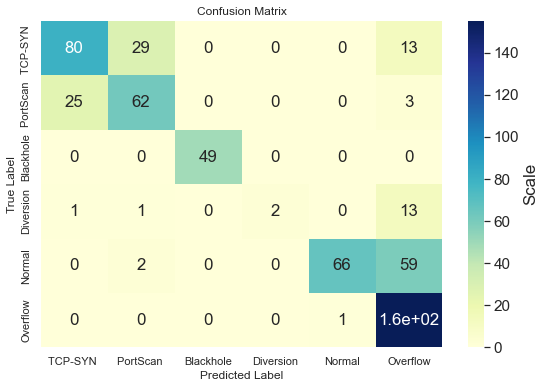

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.8581 - accuracy: 0.1245 - val_loss: 1.7674 - val_accuracy: 0.1551
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.6760 - accuracy: 0.2016 - val_loss: 1.6193 - val_accuracy: 0.3066
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5441 - accuracy: 0.3433 - val_loss: 1.5096 - val_accuracy: 0.3708
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4432 - accuracy: 0.3937 - val_loss: 1.4188 - val_accuracy: 0.4046
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3596 - accuracy: 0.4196 - val_loss: 1.3410 - val_accuracy: 0.4189
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.2874 - accuracy: 0.4639 - val_loss: 1.2731 - val_accuracy: 0.4617
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 1.2240 - accuracy: 0.4906 - val_loss: 1.2121 - val_accuracy: 0.4848
Epoch 8/500
2

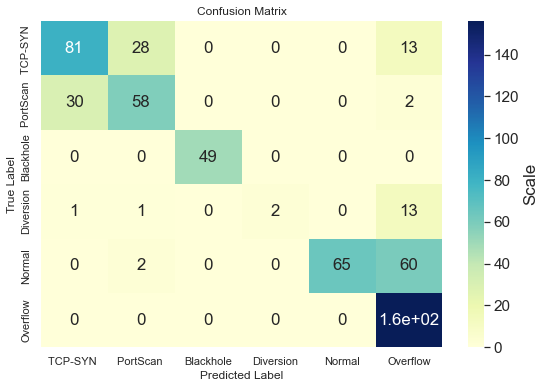

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.8045 - accuracy: 0.1875 - val_loss: 1.7165 - val_accuracy: 0.2246
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.6426 - accuracy: 0.2203 - val_loss: 1.5828 - val_accuracy: 0.2496
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5248 - accuracy: 0.3444 - val_loss: 1.4792 - val_accuracy: 0.4884
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4313 - accuracy: 0.4948 - val_loss: 1.3892 - val_accuracy: 0.5419
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3475 - accuracy: 0.5334 - val_loss: 1.3084 - val_accuracy: 0.5722
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.2719 - accuracy: 0.5754 - val_loss: 1.2342 - val_accuracy: 0.6132
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 1.2027 - accuracy: 0.6040 - val_loss: 1.1673 - val_accuracy: 0.6346
Epoch 8/500
2

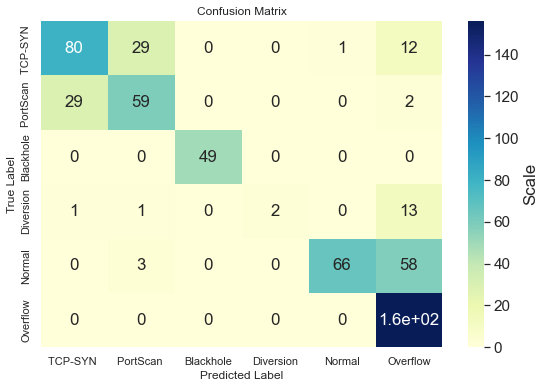

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7289041876792908
Min_training_accuracy:  0.7231767773628235
Avg_training_accuracy:  0.72668958902359
----------------------------------------------
Max_testing_accuracy:  0.7415329813957214
Min_testing_accuracy:  0.7326202988624573
Avg_testing_accuracy:  0.7365418791770935
----------------------------------------------
Max_Valadation_accuracy:  0.7361853718757629
Min_Valadation_accuracy:  0.7237076759338379
Avg_Valadation_accuracy:  0.7294117689132691


In [ ]:
oneH_20n_train, oneH_20n_test,oneH_20n_val=model_one_hidden(20)

In [ ]:
clac_min_max_average(oneH_20n_train,oneH_20n_test,oneH_20n_val)

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7289041876792908
Min_training_accuracy:  0.7231767773628235
Avg_training_accuracy:  0.72668958902359
----------------------------------------------
Max_testing_accuracy:  0.7415329813957214
Min_testing_accuracy:  0.7326202988624573
Avg_testing_accuracy:  0.7365418791770935
----------------------------------------------
Max_Valadation_accuracy:  0.7361853718757629
Min_Valadation_accuracy:  0.7237076759338379
Avg_Valadation_accuracy:  0.7294117689132691


In [ ]:
oneH_20n_avg =  np.average(oneH_20n_test)

#### 1 Hidden Layer with 30 neurones 

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.6447 - accuracy: 0.2463 - val_loss: 1.5149 - val_accuracy: 0.3173
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4403 - accuracy: 0.4414 - val_loss: 1.3550 - val_accuracy: 0.5633
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.2964 - accuracy: 0.5483 - val_loss: 1.2357 - val_accuracy: 0.5847
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.1896 - accuracy: 0.5685 - val_loss: 1.1462 - val_accuracy: 0.5989
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.1111 - accuracy: 0.5830 - val_loss: 1.0787 - val_accuracy: 0.6078
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.0507 - accuracy: 0.5903 - val_loss: 1.0241 - val_accuracy: 0.6168
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 1.0040 - accuracy: 0.5968 - val_loss: 0.9794 - val_accuracy: 0.6275
Epoch 8/500
2

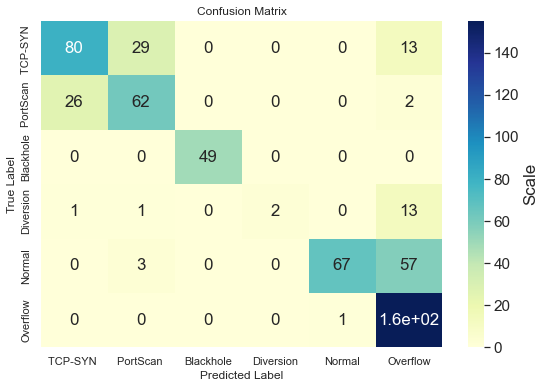

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.7598 - accuracy: 0.2146 - val_loss: 1.6704 - val_accuracy: 0.2389
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5668 - accuracy: 0.3330 - val_loss: 1.4980 - val_accuracy: 0.4795
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4213 - accuracy: 0.5227 - val_loss: 1.3662 - val_accuracy: 0.5740
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3078 - accuracy: 0.5724 - val_loss: 1.2608 - val_accuracy: 0.5936
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.2158 - accuracy: 0.5911 - val_loss: 1.1751 - val_accuracy: 0.6096
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.1411 - accuracy: 0.6197 - val_loss: 1.1075 - val_accuracy: 0.6292
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 1.0811 - accuracy: 0.6247 - val_loss: 1.0516 - val_accuracy: 0.6506
Epoch 8/500
2

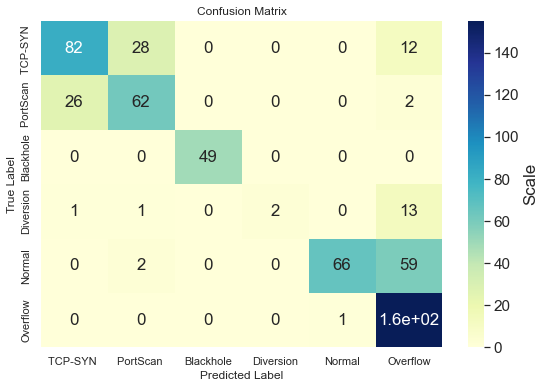

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.8264 - accuracy: 0.2593 - val_loss: 1.6595 - val_accuracy: 0.3280
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.6089 - accuracy: 0.3436 - val_loss: 1.4920 - val_accuracy: 0.3797
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4430 - accuracy: 0.4315 - val_loss: 1.3573 - val_accuracy: 0.4777
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3095 - accuracy: 0.5319 - val_loss: 1.2472 - val_accuracy: 0.5490
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.2040 - accuracy: 0.5762 - val_loss: 1.1588 - val_accuracy: 0.5811
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.1230 - accuracy: 0.5972 - val_loss: 1.0892 - val_accuracy: 0.6043
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 1.0620 - accuracy: 0.6155 - val_loss: 1.0340 - val_accuracy: 0.6328
Epoch 8/500
2

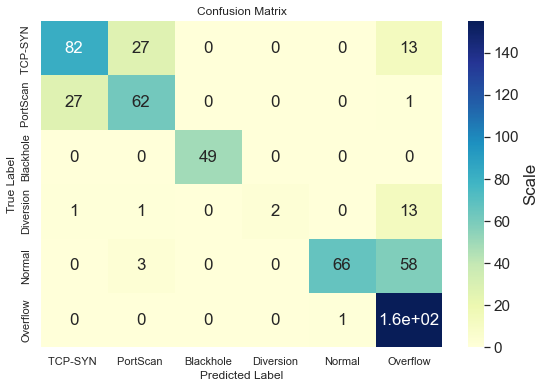

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.7185 - accuracy: 0.3089 - val_loss: 1.6240 - val_accuracy: 0.3815
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5203 - accuracy: 0.4383 - val_loss: 1.4565 - val_accuracy: 0.4724
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3760 - accuracy: 0.5139 - val_loss: 1.3259 - val_accuracy: 0.5205
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.2640 - accuracy: 0.5460 - val_loss: 1.2210 - val_accuracy: 0.5490
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.1746 - accuracy: 0.5720 - val_loss: 1.1380 - val_accuracy: 0.5668
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.1039 - accuracy: 0.5842 - val_loss: 1.0727 - val_accuracy: 0.5971
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 1.0477 - accuracy: 0.6021 - val_loss: 1.0195 - val_accuracy: 0.6203
Epoch 8/500
2

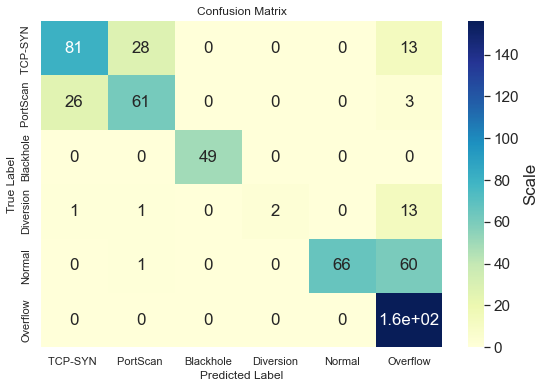

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.8009 - accuracy: 0.2619 - val_loss: 1.6509 - val_accuracy: 0.3583
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5811 - accuracy: 0.4437 - val_loss: 1.4830 - val_accuracy: 0.4813
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4232 - accuracy: 0.5418 - val_loss: 1.3569 - val_accuracy: 0.5401
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3046 - accuracy: 0.5701 - val_loss: 1.2546 - val_accuracy: 0.5793
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.2108 - accuracy: 0.5872 - val_loss: 1.1717 - val_accuracy: 0.5882
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.1352 - accuracy: 0.6025 - val_loss: 1.1037 - val_accuracy: 0.5971
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 1.0747 - accuracy: 0.6132 - val_loss: 1.0497 - val_accuracy: 0.6043
Epoch 8/500
2

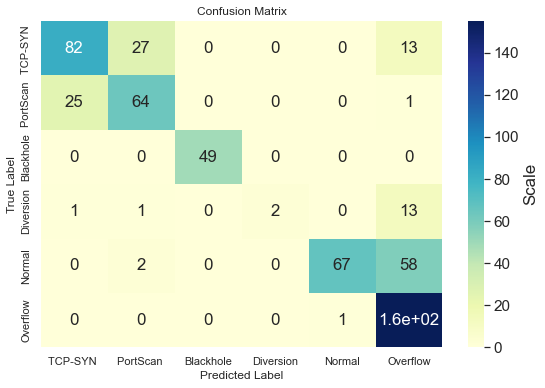

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7415043711662292
Min_training_accuracy:  0.7327224016189575
Avg_training_accuracy:  0.7365406632423401
----------------------------------------------
Max_testing_accuracy:  0.7468805909156799
Min_testing_accuracy:  0.7397504448890686
Avg_testing_accuracy:  0.741889488697052
----------------------------------------------
Max_Valadation_accuracy:  0.7450980544090271
Min_Valadation_accuracy:  0.7344028353691101
Avg_Valadation_accuracy:  0.7408199667930603


In [ ]:
oneH_30n_train, oneH_30n_test,oneH_30n_val=model_one_hidden(30)

In [ ]:
clac_min_max_average(oneH_30n_train,oneH_30n_test,oneH_30n_val)

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7415043711662292
Min_training_accuracy:  0.7327224016189575
Avg_training_accuracy:  0.7365406632423401
----------------------------------------------
Max_testing_accuracy:  0.7468805909156799
Min_testing_accuracy:  0.7397504448890686
Avg_testing_accuracy:  0.741889488697052
----------------------------------------------
Max_Valadation_accuracy:  0.7450980544090271
Min_Valadation_accuracy:  0.7344028353691101
Avg_Valadation_accuracy:  0.7408199667930603


In [ ]:
oneH_30n_avg =  np.average(oneH_30n_test)

#### 1 Hidden Layer with 40 neurones 

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.8357 - accuracy: 0.0985 - val_loss: 1.6589 - val_accuracy: 0.2014
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5632 - accuracy: 0.3631 - val_loss: 1.4755 - val_accuracy: 0.4920
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4116 - accuracy: 0.5151 - val_loss: 1.3485 - val_accuracy: 0.5490
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3025 - accuracy: 0.5475 - val_loss: 1.2461 - val_accuracy: 0.5811
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.2120 - accuracy: 0.5899 - val_loss: 1.1584 - val_accuracy: 0.6114
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.1329 - accuracy: 0.6144 - val_loss: 1.0849 - val_accuracy: 0.6275
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 1.0671 - accuracy: 0.6350 - val_loss: 1.0254 - val_accuracy: 0.6471
Epoch 8/500
2

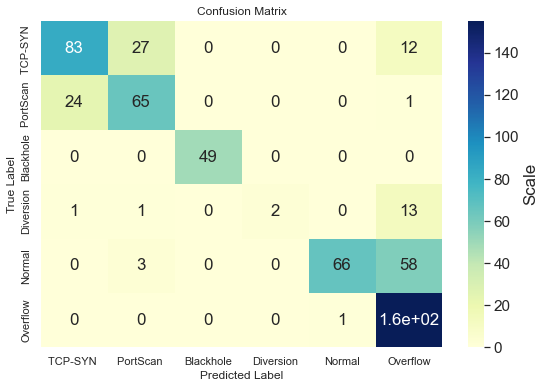

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.6957 - accuracy: 0.2421 - val_loss: 1.5412 - val_accuracy: 0.3815
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4713 - accuracy: 0.4173 - val_loss: 1.3762 - val_accuracy: 0.4777
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3251 - accuracy: 0.5250 - val_loss: 1.2555 - val_accuracy: 0.5793
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.2147 - accuracy: 0.5697 - val_loss: 1.1586 - val_accuracy: 0.5829
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.1265 - accuracy: 0.5777 - val_loss: 1.0812 - val_accuracy: 0.5865
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.0573 - accuracy: 0.5808 - val_loss: 1.0201 - val_accuracy: 0.5900
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 1.0050 - accuracy: 0.5926 - val_loss: 0.9723 - val_accuracy: 0.6150
Epoch 8/500
2

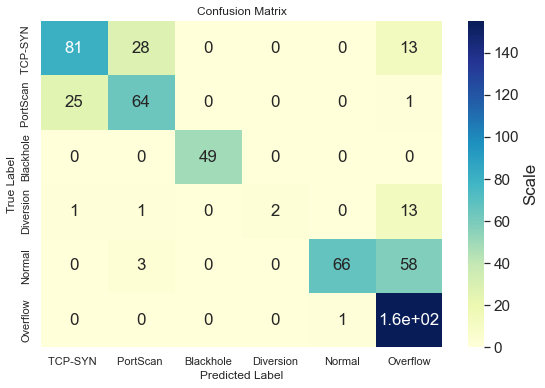

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.9162 - accuracy: 0.2795 - val_loss: 1.7052 - val_accuracy: 0.3030
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5997 - accuracy: 0.3299 - val_loss: 1.4626 - val_accuracy: 0.3957
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3795 - accuracy: 0.4861 - val_loss: 1.2950 - val_accuracy: 0.5152
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.2337 - accuracy: 0.5536 - val_loss: 1.1752 - val_accuracy: 0.5686
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.1322 - accuracy: 0.5907 - val_loss: 1.0857 - val_accuracy: 0.6043
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.0584 - accuracy: 0.6155 - val_loss: 1.0196 - val_accuracy: 0.6310
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 1.0039 - accuracy: 0.6331 - val_loss: 0.9703 - val_accuracy: 0.6399
Epoch 8/500
2

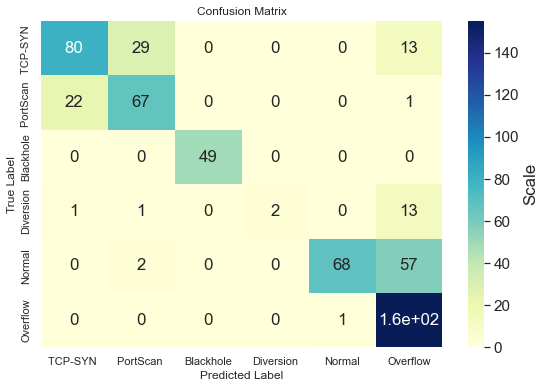

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.7343 - accuracy: 0.2680 - val_loss: 1.5692 - val_accuracy: 0.3904
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4787 - accuracy: 0.4536 - val_loss: 1.3701 - val_accuracy: 0.4866
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.2996 - accuracy: 0.5262 - val_loss: 1.2245 - val_accuracy: 0.5740
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.1722 - accuracy: 0.5624 - val_loss: 1.1193 - val_accuracy: 0.5918
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.0833 - accuracy: 0.5720 - val_loss: 1.0430 - val_accuracy: 0.6078
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.0203 - accuracy: 0.6052 - val_loss: 0.9857 - val_accuracy: 0.6506
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 0.9741 - accuracy: 0.6396 - val_loss: 0.9415 - val_accuracy: 0.6702
Epoch 8/500
2

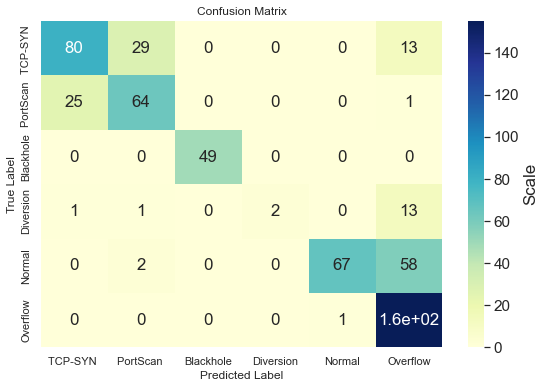

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.8951 - accuracy: 0.1504 - val_loss: 1.6835 - val_accuracy: 0.2692
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5960 - accuracy: 0.3120 - val_loss: 1.4623 - val_accuracy: 0.4296
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3954 - accuracy: 0.4353 - val_loss: 1.3108 - val_accuracy: 0.4688
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.2618 - accuracy: 0.4750 - val_loss: 1.2000 - val_accuracy: 0.5009
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.1637 - accuracy: 0.4975 - val_loss: 1.1148 - val_accuracy: 0.5348
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.0888 - accuracy: 0.5231 - val_loss: 1.0481 - val_accuracy: 0.5437
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 1.0308 - accuracy: 0.5449 - val_loss: 0.9967 - val_accuracy: 0.6061
Epoch 8/500
2

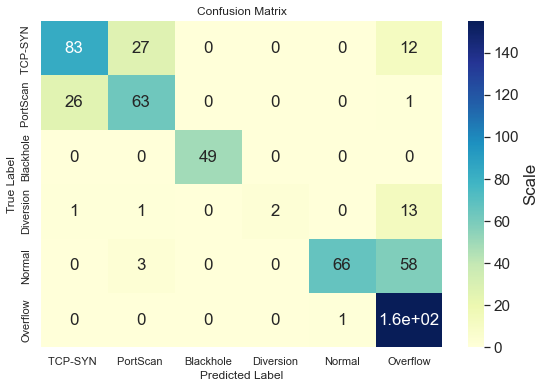

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7426498532295227
Min_training_accuracy:  0.7384498119354248
Avg_training_accuracy:  0.7408171057701111
----------------------------------------------
Max_testing_accuracy:  0.7504456043243408
Min_testing_accuracy:  0.7433155179023743
Avg_testing_accuracy:  0.7461675643920899
----------------------------------------------
Max_Valadation_accuracy:  0.7504456043243408
Min_Valadation_accuracy:  0.7379679083824158
Avg_Valadation_accuracy:  0.744385027885437


In [ ]:
oneH_40n_train, oneH_40n_test,oneH_40n_val=model_one_hidden(40)

In [ ]:
clac_min_max_average(oneH_40n_train,oneH_40n_test,oneH_40n_val)

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7426498532295227
Min_training_accuracy:  0.7384498119354248
Avg_training_accuracy:  0.7408171057701111
----------------------------------------------
Max_testing_accuracy:  0.7504456043243408
Min_testing_accuracy:  0.7433155179023743
Avg_testing_accuracy:  0.7461675643920899
----------------------------------------------
Max_Valadation_accuracy:  0.7504456043243408
Min_Valadation_accuracy:  0.7379679083824158
Avg_Valadation_accuracy:  0.744385027885437


In [ ]:
oneH_40n_avg =  np.average(oneH_40n_test)

In [ ]:
one_hiden_testavg=[oneH_10n_avg,oneH_20n_avg,oneH_30n_avg,oneH_40n_avg]

## At two Hidden Layer 

In [ ]:
def model_two_hidden(neuro):
    total_train_acc= []
    total_test_acc= []
    total_val_acc=[]
    confusion=[]
    number_of_runs=5
    for i in range(number_of_runs):
        optimizer=tfaAdamw.optimizers.AdamW(learning_rate= 0.001, weight_decay= 0.001)

        model = keras.models.Sequential()
        model.add(Dense(neuro, input_shape = (10,), activation = 'relu'))
        model.add(Dense(neuro, activation = 'relu'))
        model.add(Dense(6, activation = "softmax"))
        callback = tf.keras.callbacks.EarlyStopping(monitor='loss', patience=5)
        model.compile(optimizer=optimizer, loss="sparse_categorical_crossentropy", metrics = ["accuracy"])
        model.fit(x_train_scaled_anovaa, train_y, epochs=500, batch_size=128, validation_data=(x_val_scaled_anovaa,val_y),callbacks=[callback])
        total_train_acc.append(model.evaluate(x_train_scaled_anovaa, train_y, verbose=0)[1])
        total_test_acc.append(model.evaluate(x_test_scaled_anovaa, test_y, verbose=0)[1])
        total_val_acc.append(model.evaluate(x_val_scaled_anovaa,val_y, verbose=0)[1])

        y_pred = np.argmax(model.predict(x_test_scaled_anovaa), axis=-1)
        data= confusion_matrix(test_y, y_pred)
        confusion.append(data)
        labels =['TCP-SYN ','PortScan ','Blackhole','Diversion','Normal','Overflow']
        plot_confusion_matrix(data,labels)

    # Training acc 
    # Max
    max_training_accuracy = np.amax(total_train_acc)
    # Min 
    min_training_accuracy = np.amin(total_train_acc)
    #Avg
    avg_training_accuracy = np.average(total_train_acc)

    # Testing acc 
    # Max
    max_testing_accuracy =  np.amax(total_test_acc)
    # Min 
    min_testing_accuracy =  np.amin(total_test_acc)
    # Avg
    avg_testing_accuracy =  np.average(total_test_acc)

    # Valadation acc 
    # Max
    max_Valadation_accuracy =  np.amax(total_val_acc)
    # Min 
    min_Valadation_accuracy =  np.amin(total_val_acc)
    # Avg
    avg_Valadation_accuracy =  np.average(total_val_acc)

    print('Min, Max, Avg Accuracies', '\n')
    print('Max_training_accuracy:', max_training_accuracy )
    print('Min_training_accuracy: ', min_training_accuracy)
    print('Avg_training_accuracy: ', avg_training_accuracy)
    print('----------------------------------------------')
    print('Max_testing_accuracy: ', max_testing_accuracy)
    print('Min_testing_accuracy: ', min_testing_accuracy)
    print('Avg_testing_accuracy: ', avg_testing_accuracy)
    print('----------------------------------------------')
    print('Max_Valadation_accuracy: ', max_Valadation_accuracy)
    print('Min_Valadation_accuracy: ', min_Valadation_accuracy)
    print('Avg_Valadation_accuracy: ', avg_Valadation_accuracy)
    
    return total_train_acc,total_test_acc,total_val_acc

#### 2 Hidden Layer with 10 neurones

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.7265 - accuracy: 0.2108 - val_loss: 1.6767 - val_accuracy: 0.3030
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.6346 - accuracy: 0.3356 - val_loss: 1.5977 - val_accuracy: 0.3850
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5585 - accuracy: 0.3982 - val_loss: 1.5173 - val_accuracy: 0.4153
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4798 - accuracy: 0.4422 - val_loss: 1.4310 - val_accuracy: 0.4706
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4012 - accuracy: 0.4712 - val_loss: 1.3480 - val_accuracy: 0.4973
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3293 - accuracy: 0.4933 - val_loss: 1.2787 - val_accuracy: 0.5258
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 1.2665 - accuracy: 0.5113 - val_loss: 1.2174 - val_accuracy: 0.5365
Epoch 8/500
2

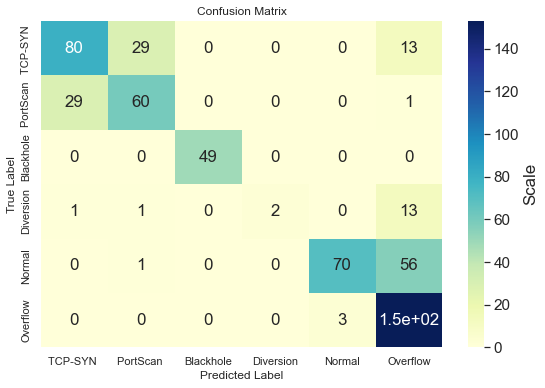

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.8292 - accuracy: 0.1516 - val_loss: 1.7773 - val_accuracy: 0.2531
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.7455 - accuracy: 0.2868 - val_loss: 1.7025 - val_accuracy: 0.2638
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.6793 - accuracy: 0.2967 - val_loss: 1.6381 - val_accuracy: 0.2906
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.6179 - accuracy: 0.2944 - val_loss: 1.5792 - val_accuracy: 0.2923
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5593 - accuracy: 0.3020 - val_loss: 1.5254 - val_accuracy: 0.3048
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5027 - accuracy: 0.3204 - val_loss: 1.4745 - val_accuracy: 0.3494
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4450 - accuracy: 0.3834 - val_loss: 1.4236 - val_accuracy: 0.4011
Epoch 8/500
2

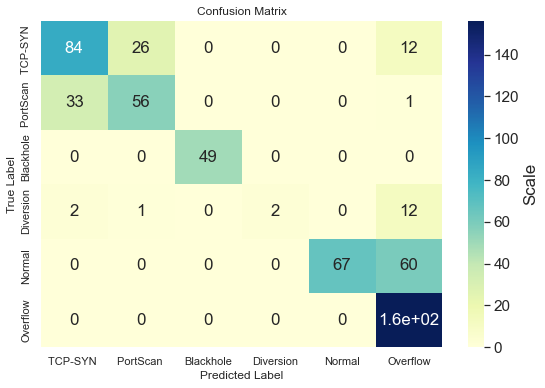

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.8362 - accuracy: 0.1898 - val_loss: 1.7667 - val_accuracy: 0.2086
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.7419 - accuracy: 0.2367 - val_loss: 1.6973 - val_accuracy: 0.2371
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.6719 - accuracy: 0.3020 - val_loss: 1.6342 - val_accuracy: 0.3262
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.6081 - accuracy: 0.3872 - val_loss: 1.5728 - val_accuracy: 0.3868
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5432 - accuracy: 0.4234 - val_loss: 1.5091 - val_accuracy: 0.4029
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4720 - accuracy: 0.4372 - val_loss: 1.4343 - val_accuracy: 0.4439
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3894 - accuracy: 0.4769 - val_loss: 1.3512 - val_accuracy: 0.4670
Epoch 8/500
2

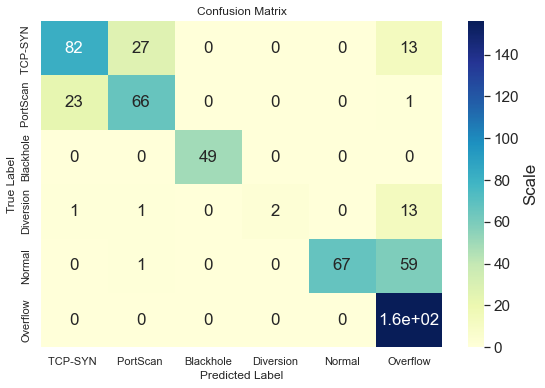

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.9441 - accuracy: 0.2131 - val_loss: 1.7859 - val_accuracy: 0.2496
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.7638 - accuracy: 0.2176 - val_loss: 1.6642 - val_accuracy: 0.2513
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.6438 - accuracy: 0.2253 - val_loss: 1.5781 - val_accuracy: 0.2834
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5607 - accuracy: 0.2776 - val_loss: 1.5068 - val_accuracy: 0.3173
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4897 - accuracy: 0.3417 - val_loss: 1.4374 - val_accuracy: 0.3975
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4197 - accuracy: 0.4299 - val_loss: 1.3668 - val_accuracy: 0.5205
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3495 - accuracy: 0.5055 - val_loss: 1.2982 - val_accuracy: 0.5633
Epoch 8/500
2

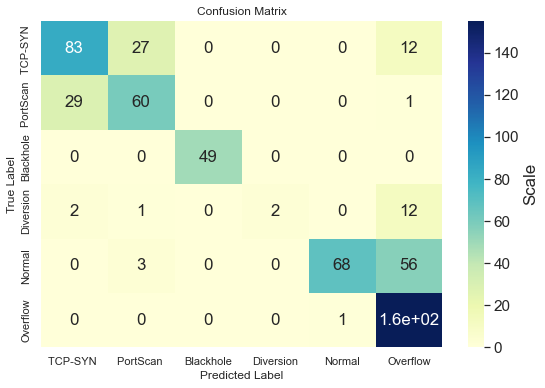

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.7495 - accuracy: 0.2516 - val_loss: 1.7166 - val_accuracy: 0.2620
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.6515 - accuracy: 0.2997 - val_loss: 1.6379 - val_accuracy: 0.2656
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5736 - accuracy: 0.3414 - val_loss: 1.5685 - val_accuracy: 0.3405
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5040 - accuracy: 0.3849 - val_loss: 1.5032 - val_accuracy: 0.3458
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4367 - accuracy: 0.4009 - val_loss: 1.4396 - val_accuracy: 0.3886
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3740 - accuracy: 0.4441 - val_loss: 1.3810 - val_accuracy: 0.4403
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3180 - accuracy: 0.4884 - val_loss: 1.3254 - val_accuracy: 0.4706
Epoch 8/500
2

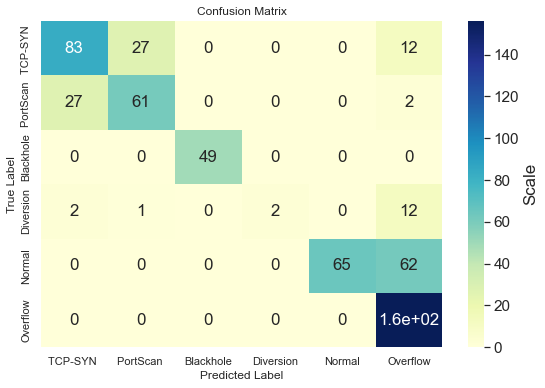

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7266132235527039
Min_training_accuracy:  0.7231767773628235
Avg_training_accuracy:  0.7249331831932068
----------------------------------------------
Max_testing_accuracy:  0.7522281408309937
Min_testing_accuracy:  0.7379679083824158
Avg_testing_accuracy:  0.7426024913787842
----------------------------------------------
Max_Valadation_accuracy:  0.7415329813957214
Min_Valadation_accuracy:  0.7254902124404907
Avg_Valadation_accuracy:  0.7311943054199219


In [ ]:
twoH_10n_train,twoH_10n_test,twoH_10n_val =model_two_hidden(10)

In [ ]:
clac_min_max_average(twoH_10n_train,twoH_10n_test,twoH_10n_val)

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7266132235527039
Min_training_accuracy:  0.7231767773628235
Avg_training_accuracy:  0.7249331831932068
----------------------------------------------
Max_testing_accuracy:  0.7522281408309937
Min_testing_accuracy:  0.7379679083824158
Avg_testing_accuracy:  0.7426024913787842
----------------------------------------------
Max_Valadation_accuracy:  0.7415329813957214
Min_Valadation_accuracy:  0.7254902124404907
Avg_Valadation_accuracy:  0.7311943054199219


In [ ]:
twoH_10n_avg =  np.average(twoH_10n_test)

#### 2 Hidden Layer with 20 neurones

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.7450 - accuracy: 0.1333 - val_loss: 1.6830 - val_accuracy: 0.2317
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5910 - accuracy: 0.3517 - val_loss: 1.5475 - val_accuracy: 0.4403
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4665 - accuracy: 0.5002 - val_loss: 1.4212 - val_accuracy: 0.5365
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3481 - accuracy: 0.5410 - val_loss: 1.3000 - val_accuracy: 0.5401
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.2358 - accuracy: 0.5487 - val_loss: 1.1891 - val_accuracy: 0.5455
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.1356 - accuracy: 0.5559 - val_loss: 1.0912 - val_accuracy: 0.5615
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 1.0499 - accuracy: 0.5781 - val_loss: 1.0120 - val_accuracy: 0.5775
Epoch 8/500
2

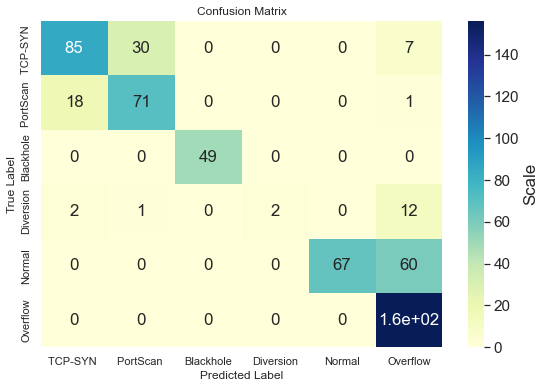

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.7575 - accuracy: 0.2906 - val_loss: 1.6773 - val_accuracy: 0.2834
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5738 - accuracy: 0.3608 - val_loss: 1.5380 - val_accuracy: 0.3761
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4477 - accuracy: 0.4338 - val_loss: 1.4293 - val_accuracy: 0.4421
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3482 - accuracy: 0.4788 - val_loss: 1.3354 - val_accuracy: 0.5045
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.2640 - accuracy: 0.5239 - val_loss: 1.2473 - val_accuracy: 0.5455
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.1880 - accuracy: 0.5460 - val_loss: 1.1655 - val_accuracy: 0.5615
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 1.1182 - accuracy: 0.5682 - val_loss: 1.0885 - val_accuracy: 0.5811
Epoch 8/500
2

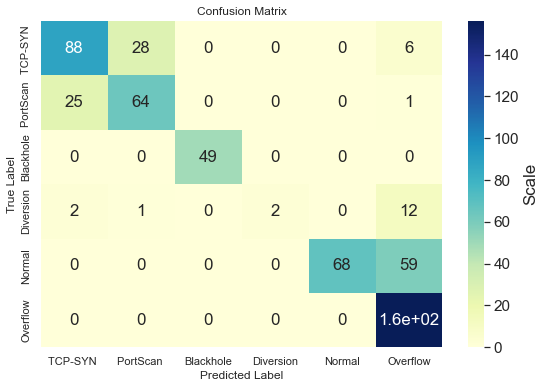

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.8627 - accuracy: 0.2405 - val_loss: 1.7176 - val_accuracy: 0.3084
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.6365 - accuracy: 0.3444 - val_loss: 1.5317 - val_accuracy: 0.3832
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4643 - accuracy: 0.4147 - val_loss: 1.3682 - val_accuracy: 0.4866
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3095 - accuracy: 0.5284 - val_loss: 1.2289 - val_accuracy: 0.5651
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.1791 - accuracy: 0.5689 - val_loss: 1.1148 - val_accuracy: 0.6043
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.0771 - accuracy: 0.6082 - val_loss: 1.0264 - val_accuracy: 0.6328
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 1.0014 - accuracy: 0.6285 - val_loss: 0.9619 - val_accuracy: 0.6381
Epoch 8/500
2

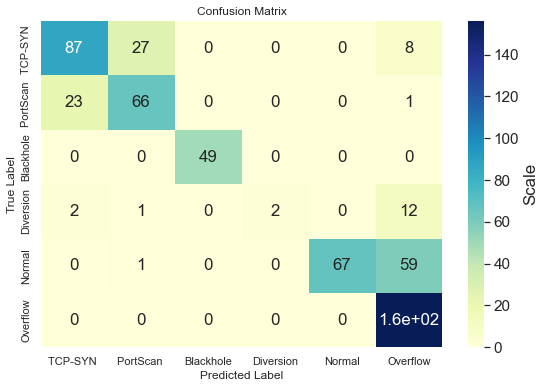

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.7901 - accuracy: 0.2157 - val_loss: 1.6866 - val_accuracy: 0.2567
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.6283 - accuracy: 0.3070 - val_loss: 1.5503 - val_accuracy: 0.3743
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4996 - accuracy: 0.4437 - val_loss: 1.4331 - val_accuracy: 0.4635
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3792 - accuracy: 0.5082 - val_loss: 1.3139 - val_accuracy: 0.5258
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.2590 - accuracy: 0.5605 - val_loss: 1.1933 - val_accuracy: 0.5704
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.1424 - accuracy: 0.5899 - val_loss: 1.0830 - val_accuracy: 0.6061
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 1.0429 - accuracy: 0.6159 - val_loss: 0.9936 - val_accuracy: 0.6328
Epoch 8/500
2

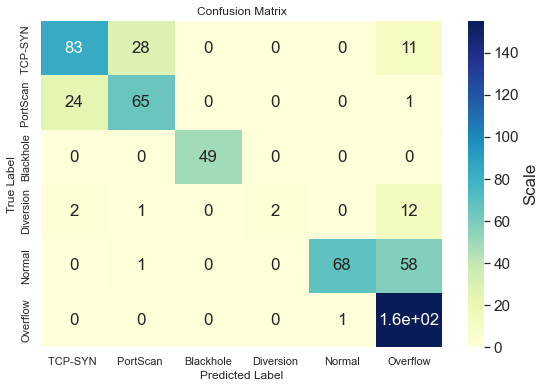

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.7492 - accuracy: 0.2711 - val_loss: 1.6717 - val_accuracy: 0.3298
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.6142 - accuracy: 0.3734 - val_loss: 1.5577 - val_accuracy: 0.3939
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4931 - accuracy: 0.4395 - val_loss: 1.4452 - val_accuracy: 0.4652
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3705 - accuracy: 0.5265 - val_loss: 1.3161 - val_accuracy: 0.5651
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.2416 - accuracy: 0.5689 - val_loss: 1.1800 - val_accuracy: 0.5865
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.1205 - accuracy: 0.5865 - val_loss: 1.0601 - val_accuracy: 0.6061
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 1.0214 - accuracy: 0.6018 - val_loss: 0.9655 - val_accuracy: 0.6560
Epoch 8/500
2

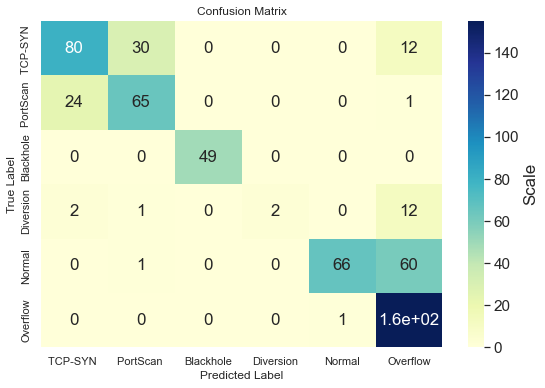

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7525773048400879
Min_training_accuracy:  0.7350133657455444
Avg_training_accuracy:  0.744406270980835
----------------------------------------------
Max_testing_accuracy:  0.7664884328842163
Min_testing_accuracy:  0.7433155179023743
Avg_testing_accuracy:  0.75686274766922
----------------------------------------------
Max_Valadation_accuracy:  0.7575757503509521
Min_Valadation_accuracy:  0.7468805909156799
Avg_Valadation_accuracy:  0.751871645450592


In [ ]:
twoH_20n_train,twoH_20n_test,twoH_20n_val=model_two_hidden(20)

In [ ]:
clac_min_max_average(twoH_20n_train,twoH_20n_test,twoH_20n_val)

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7525773048400879
Min_training_accuracy:  0.7350133657455444
Avg_training_accuracy:  0.744406270980835
----------------------------------------------
Max_testing_accuracy:  0.7664884328842163
Min_testing_accuracy:  0.7433155179023743
Avg_testing_accuracy:  0.75686274766922
----------------------------------------------
Max_Valadation_accuracy:  0.7575757503509521
Min_Valadation_accuracy:  0.7468805909156799
Avg_Valadation_accuracy:  0.751871645450592


In [ ]:
twoH_20n_avg =  np.average(twoH_20n_test)

#### 2 Hidden Layer with 30 neurones

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.8947 - accuracy: 0.2715 - val_loss: 1.6949 - val_accuracy: 0.2995
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5897 - accuracy: 0.3295 - val_loss: 1.4730 - val_accuracy: 0.4189
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3754 - accuracy: 0.4498 - val_loss: 1.3002 - val_accuracy: 0.5116
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.2163 - accuracy: 0.5502 - val_loss: 1.1584 - val_accuracy: 0.5829
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.0937 - accuracy: 0.6124 - val_loss: 1.0433 - val_accuracy: 0.6292
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 0.9995 - accuracy: 0.6224 - val_loss: 0.9480 - val_accuracy: 0.6595
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 0.9286 - accuracy: 0.6438 - val_loss: 0.8789 - val_accuracy: 0.6738
Epoch 8/500
2

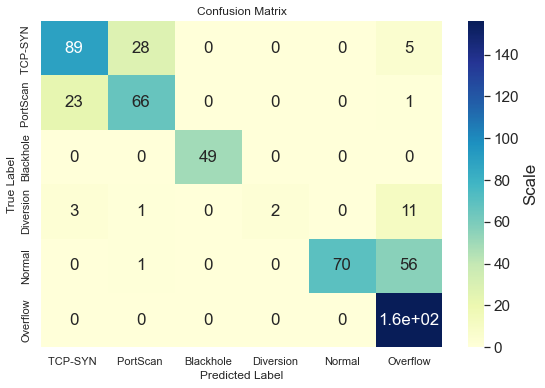

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.6653 - accuracy: 0.3986 - val_loss: 1.5719 - val_accuracy: 0.4314
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4578 - accuracy: 0.4891 - val_loss: 1.3807 - val_accuracy: 0.4973
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.2860 - accuracy: 0.5246 - val_loss: 1.2119 - val_accuracy: 0.5294
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.1389 - accuracy: 0.5525 - val_loss: 1.0721 - val_accuracy: 0.5704
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.0297 - accuracy: 0.5834 - val_loss: 0.9738 - val_accuracy: 0.6025
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 0.9584 - accuracy: 0.6060 - val_loss: 0.9093 - val_accuracy: 0.6310
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 0.9082 - accuracy: 0.6250 - val_loss: 0.8645 - val_accuracy: 0.6364
Epoch 8/500
2

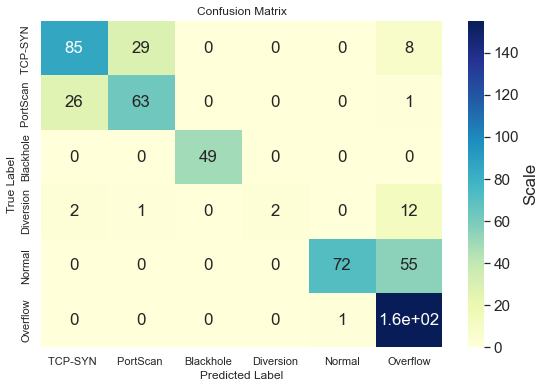

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.5774 - accuracy: 0.2600 - val_loss: 1.4712 - val_accuracy: 0.4082
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3763 - accuracy: 0.4777 - val_loss: 1.3137 - val_accuracy: 0.5258
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.2336 - accuracy: 0.5430 - val_loss: 1.1748 - val_accuracy: 0.5633
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.1070 - accuracy: 0.6044 - val_loss: 1.0456 - val_accuracy: 0.6542
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.0000 - accuracy: 0.6327 - val_loss: 0.9393 - val_accuracy: 0.6595
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 0.9183 - accuracy: 0.6575 - val_loss: 0.8626 - val_accuracy: 0.6809
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 0.8589 - accuracy: 0.6705 - val_loss: 0.8070 - val_accuracy: 0.6791
Epoch 8/500
2

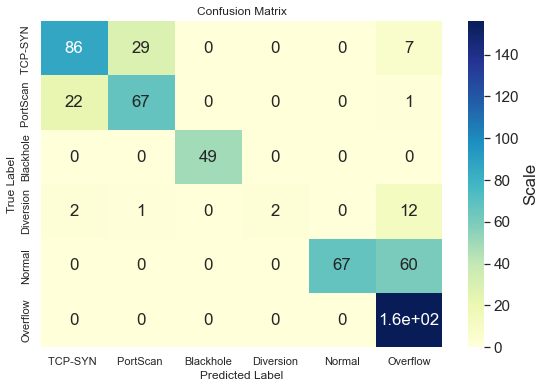

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.6232 - accuracy: 0.3925 - val_loss: 1.4830 - val_accuracy: 0.4759
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3713 - accuracy: 0.4922 - val_loss: 1.2810 - val_accuracy: 0.5027
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.1934 - accuracy: 0.5468 - val_loss: 1.1285 - val_accuracy: 0.5615
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.0695 - accuracy: 0.6067 - val_loss: 1.0182 - val_accuracy: 0.6257
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 0.9799 - accuracy: 0.6315 - val_loss: 0.9319 - val_accuracy: 0.6631
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 0.9104 - accuracy: 0.6674 - val_loss: 0.8647 - val_accuracy: 0.6809
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 0.8572 - accuracy: 0.6728 - val_loss: 0.8188 - val_accuracy: 0.6988
Epoch 8/500
2

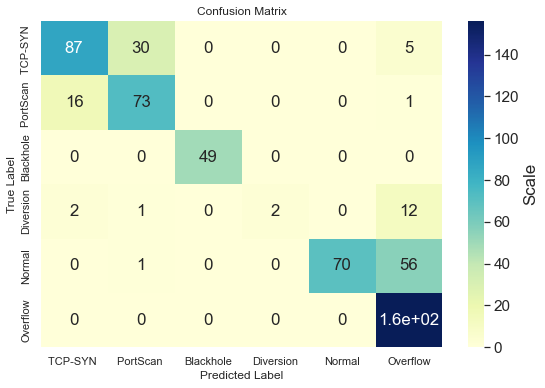

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.6404 - accuracy: 0.3471 - val_loss: 1.5165 - val_accuracy: 0.5312
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4253 - accuracy: 0.5391 - val_loss: 1.3183 - val_accuracy: 0.5900
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.2444 - accuracy: 0.5880 - val_loss: 1.1451 - val_accuracy: 0.6078
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.0965 - accuracy: 0.6144 - val_loss: 1.0076 - val_accuracy: 0.6471
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 0.9832 - accuracy: 0.6529 - val_loss: 0.9095 - val_accuracy: 0.6667
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 0.9027 - accuracy: 0.6667 - val_loss: 0.8399 - val_accuracy: 0.6863
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 0.8459 - accuracy: 0.6770 - val_loss: 0.7911 - val_accuracy: 0.6988
Epoch 8/500
2

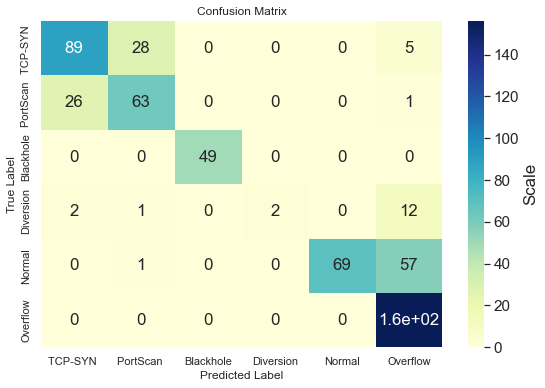

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7674685120582581
Min_training_accuracy:  0.7495227456092834
Avg_training_accuracy:  0.7579228758811951
----------------------------------------------
Max_testing_accuracy:  0.7789661288261414
Min_testing_accuracy:  0.759358286857605
Avg_testing_accuracy:  0.7664884090423584
----------------------------------------------
Max_Valadation_accuracy:  0.7736185193061829
Min_Valadation_accuracy:  0.7575757503509521
Avg_Valadation_accuracy:  0.7632798552513123


In [ ]:
twoH_30n_train,twoH_30n_test,twoH_30n_val=model_two_hidden(30)

In [ ]:
clac_min_max_average(twoH_30n_train,twoH_30n_test,twoH_30n_val)

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7674685120582581
Min_training_accuracy:  0.7495227456092834
Avg_training_accuracy:  0.7579228758811951
----------------------------------------------
Max_testing_accuracy:  0.7789661288261414
Min_testing_accuracy:  0.759358286857605
Avg_testing_accuracy:  0.7664884090423584
----------------------------------------------
Max_Valadation_accuracy:  0.7736185193061829
Min_Valadation_accuracy:  0.7575757503509521
Avg_Valadation_accuracy:  0.7632798552513123


In [ ]:
twoH_30n_avg =  np.average(twoH_30n_test)

#### 2 Hidden Layer with 40 neurones

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.6386 - accuracy: 0.3574 - val_loss: 1.4368 - val_accuracy: 0.5472
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3325 - accuracy: 0.5174 - val_loss: 1.2004 - val_accuracy: 0.5579
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.1316 - accuracy: 0.5357 - val_loss: 1.0315 - val_accuracy: 0.5775
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9908 - accuracy: 0.5567 - val_loss: 0.9156 - val_accuracy: 0.6061
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 0.8955 - accuracy: 0.6399 - val_loss: 0.8395 - val_accuracy: 0.6952
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 0.8359 - accuracy: 0.6831 - val_loss: 0.7892 - val_accuracy: 0.7041
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 0.7973 - accuracy: 0.6911 - val_loss: 0.7570 - val_accuracy: 0.7112
Epoch 8/500
2

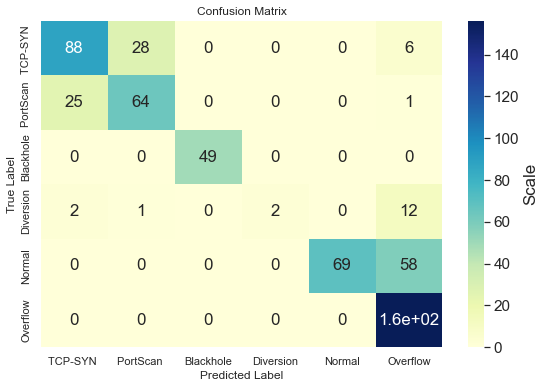

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.6027 - accuracy: 0.3719 - val_loss: 1.4642 - val_accuracy: 0.4082
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3391 - accuracy: 0.4647 - val_loss: 1.2654 - val_accuracy: 0.4831
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.1736 - accuracy: 0.5540 - val_loss: 1.1148 - val_accuracy: 0.5936
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.0492 - accuracy: 0.6098 - val_loss: 0.9884 - val_accuracy: 0.6417
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 0.9436 - accuracy: 0.6407 - val_loss: 0.8841 - val_accuracy: 0.6720
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 0.8649 - accuracy: 0.6747 - val_loss: 0.8144 - val_accuracy: 0.7005
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 0.8118 - accuracy: 0.6919 - val_loss: 0.7683 - val_accuracy: 0.7166
Epoch 8/500
2

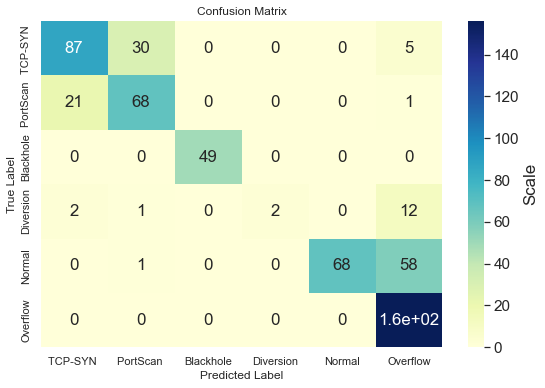

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.7092 - accuracy: 0.2386 - val_loss: 1.5506 - val_accuracy: 0.5027
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4194 - accuracy: 0.5701 - val_loss: 1.2842 - val_accuracy: 0.6774
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.1730 - accuracy: 0.6460 - val_loss: 1.0642 - val_accuracy: 0.6649
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.0012 - accuracy: 0.6487 - val_loss: 0.9261 - val_accuracy: 0.6649
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 0.8981 - accuracy: 0.6701 - val_loss: 0.8452 - val_accuracy: 0.6934
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 0.8396 - accuracy: 0.6816 - val_loss: 0.7944 - val_accuracy: 0.7041
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 0.8009 - accuracy: 0.6987 - val_loss: 0.7621 - val_accuracy: 0.7112
Epoch 8/500
2

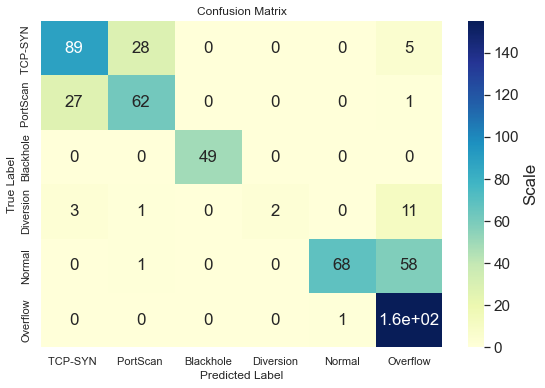

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.6794 - accuracy: 0.3746 - val_loss: 1.4898 - val_accuracy: 0.5437
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3598 - accuracy: 0.5968 - val_loss: 1.2207 - val_accuracy: 0.6364
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.1274 - accuracy: 0.6281 - val_loss: 1.0305 - val_accuracy: 0.6560
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 0.9787 - accuracy: 0.6350 - val_loss: 0.9111 - val_accuracy: 0.6756
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 0.8911 - accuracy: 0.6625 - val_loss: 0.8388 - val_accuracy: 0.7005
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 0.8373 - accuracy: 0.6957 - val_loss: 0.7928 - val_accuracy: 0.7059
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 0.7993 - accuracy: 0.6972 - val_loss: 0.7582 - val_accuracy: 0.7094
Epoch 8/500
2

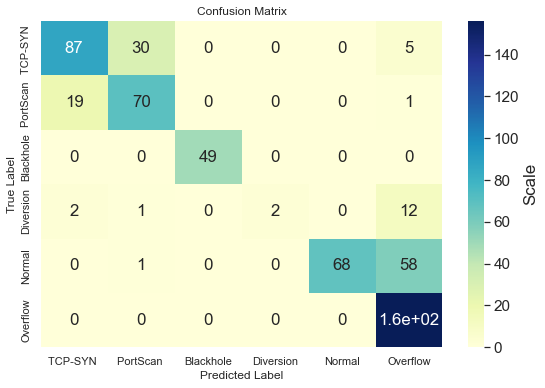

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.7193 - accuracy: 0.2982 - val_loss: 1.5651 - val_accuracy: 0.4189
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4382 - accuracy: 0.4948 - val_loss: 1.3248 - val_accuracy: 0.5455
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.2146 - accuracy: 0.5842 - val_loss: 1.1176 - val_accuracy: 0.6007
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.0432 - accuracy: 0.6147 - val_loss: 0.9750 - val_accuracy: 0.6399
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 0.9372 - accuracy: 0.6460 - val_loss: 0.8887 - val_accuracy: 0.6684
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 0.8753 - accuracy: 0.6758 - val_loss: 0.8375 - val_accuracy: 0.6827
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 0.8353 - accuracy: 0.6754 - val_loss: 0.8009 - val_accuracy: 0.6934
Epoch 8/500
2

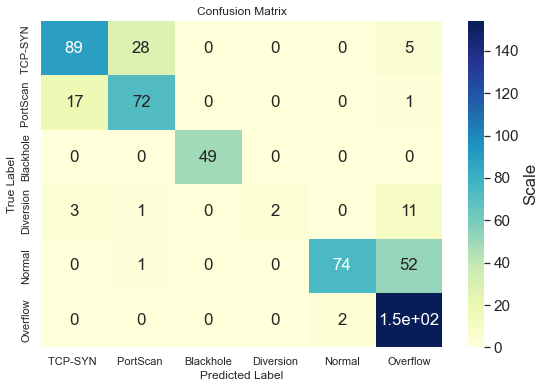

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7709048986434937
Min_training_accuracy:  0.755250096321106
Avg_training_accuracy:  0.7629629731178283
----------------------------------------------
Max_testing_accuracy:  0.7843137383460999
Min_testing_accuracy:  0.7575757503509521
Avg_testing_accuracy:  0.7682709455490112
----------------------------------------------
Max_Valadation_accuracy:  0.7736185193061829
Min_Valadation_accuracy:  0.7647058963775635
Avg_Valadation_accuracy:  0.7686274528503418


In [ ]:
twoH_40n_train,twoH_40n_test,twoH_40n_val=model_two_hidden(40)

In [ ]:
clac_min_max_average(twoH_40n_train,twoH_40n_test,twoH_40n_val)

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7709048986434937
Min_training_accuracy:  0.755250096321106
Avg_training_accuracy:  0.7629629731178283
----------------------------------------------
Max_testing_accuracy:  0.7843137383460999
Min_testing_accuracy:  0.7575757503509521
Avg_testing_accuracy:  0.7682709455490112
----------------------------------------------
Max_Valadation_accuracy:  0.7736185193061829
Min_Valadation_accuracy:  0.7647058963775635
Avg_Valadation_accuracy:  0.7686274528503418


In [ ]:
twoH_40n_avg =  np.average(twoH_40n_test)

In [ ]:
two_hiden_testavg=[twoH_10n_avg,twoH_20n_avg,twoH_30n_avg,twoH_40n_avg]

In [ ]:
two_hiden_testavg

[0.7426024913787842, 0.75686274766922, 0.7664884090423584, 0.7682709455490112]

### At four Hidden Layer 

In [ ]:
def model_four_hidden(neuro):
    total_train_acc= []
    total_test_acc= []
    total_val_acc=[]
    confusion=[]
    number_of_runs=5
    for i in range(number_of_runs):
        optimizer=tfaAdamw.optimizers.AdamW(learning_rate= 0.001, weight_decay= 0.001)

        model = keras.models.Sequential()
        model.add(Dense(neuro, input_shape = (10,), activation = 'relu'))
        model.add(Dense(neuro, activation = 'relu'))
        model.add(Dense(neuro, activation = 'relu'))
        model.add(Dense(neuro, activation = 'relu'))
        model.add(Dense(6, activation = "softmax"))
        callback = tf.keras.callbacks.EarlyStopping(monitor='loss', patience=5)
        model.compile(optimizer=optimizer, loss="sparse_categorical_crossentropy", metrics = ["accuracy"])
        model.fit(x_train_scaled_anovaa, train_y, epochs=500, batch_size=128, validation_data=(x_val_scaled_anovaa,val_y),callbacks=[callback])
        total_train_acc.append(model.evaluate(x_train_scaled_anovaa, train_y, verbose=0)[1])
        total_test_acc.append(model.evaluate(x_test_scaled_anovaa, test_y, verbose=0)[1])
        total_val_acc.append(model.evaluate(x_val_scaled_anovaa,val_y, verbose=0)[1])

        y_pred = np.argmax(model.predict(x_test_scaled_anovaa), axis=-1)
        data= confusion_matrix(test_y, y_pred)
        confusion.append(data)
        labels =['TCP-SYN ','PortScan ','Blackhole','Diversion','Normal','Overflow']
        plot_confusion_matrix(data,labels)

    # Training acc 
    # Max
    max_training_accuracy = np.amax(total_train_acc)
    # Min 
    min_training_accuracy = np.amin(total_train_acc)
    #Avg
    avg_training_accuracy = np.average(total_train_acc)

    # Testing acc 
    # Max
    max_testing_accuracy =  np.amax(total_test_acc)
    # Min 
    min_testing_accuracy =  np.amin(total_test_acc)
    # Avg
    avg_testing_accuracy =  np.average(total_test_acc)

    # Valadation acc 
    # Max
    max_Valadation_accuracy =  np.amax(total_val_acc)
    # Min 
    min_Valadation_accuracy =  np.amin(total_val_acc)
    # Avg
    avg_Valadation_accuracy =  np.average(total_val_acc)

    print('Min, Max, Avg Accuracies', '\n')
    print('Max_training_accuracy:', max_training_accuracy )
    print('Min_training_accuracy: ', min_training_accuracy)
    print('Avg_training_accuracy: ', avg_training_accuracy)
    print('----------------------------------------------')
    print('Max_testing_accuracy: ', max_testing_accuracy)
    print('Min_testing_accuracy: ', min_testing_accuracy)
    print('Avg_testing_accuracy: ', avg_testing_accuracy)
    print('----------------------------------------------')
    print('Max_Valadation_accuracy: ', max_Valadation_accuracy)
    print('Min_Valadation_accuracy: ', min_Valadation_accuracy)
    print('Avg_Valadation_accuracy: ', avg_Valadation_accuracy)
    
    return total_train_acc,total_test_acc,total_val_acc

##### 4 Hidden Layer with 10 neurones

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.7547 - accuracy: 0.2848 - val_loss: 1.7227 - val_accuracy: 0.3066
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.6900 - accuracy: 0.2856 - val_loss: 1.6603 - val_accuracy: 0.3102
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.6231 - accuracy: 0.3047 - val_loss: 1.5862 - val_accuracy: 0.4029
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5458 - accuracy: 0.4227 - val_loss: 1.4989 - val_accuracy: 0.5080
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4564 - accuracy: 0.4861 - val_loss: 1.4033 - val_accuracy: 0.5348
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3642 - accuracy: 0.5036 - val_loss: 1.3070 - val_accuracy: 0.5544
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 1.2734 - accuracy: 0.5124 - val_loss: 1.2129 - val_accuracy: 0.5508
Epoch 8/500
2

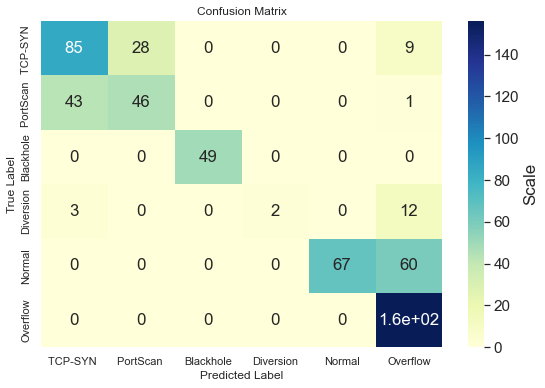

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.8259 - accuracy: 0.0630 - val_loss: 1.7849 - val_accuracy: 0.1979
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.7578 - accuracy: 0.1653 - val_loss: 1.7405 - val_accuracy: 0.2193
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.7184 - accuracy: 0.2115 - val_loss: 1.7021 - val_accuracy: 0.2727
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.6723 - accuracy: 0.2764 - val_loss: 1.6485 - val_accuracy: 0.3369
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.6027 - accuracy: 0.3780 - val_loss: 1.5685 - val_accuracy: 0.4920
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5097 - accuracy: 0.5151 - val_loss: 1.4685 - val_accuracy: 0.5401
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4039 - accuracy: 0.5162 - val_loss: 1.3584 - val_accuracy: 0.5401
Epoch 8/500
2

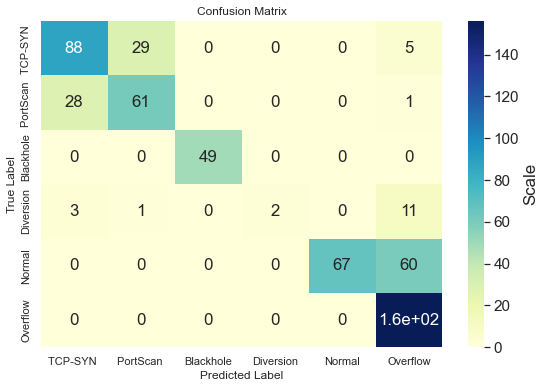

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.7569 - accuracy: 0.3116 - val_loss: 1.6899 - val_accuracy: 0.3529
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.6658 - accuracy: 0.3505 - val_loss: 1.6021 - val_accuracy: 0.3815
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5725 - accuracy: 0.3849 - val_loss: 1.5012 - val_accuracy: 0.4153
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4633 - accuracy: 0.4380 - val_loss: 1.3807 - val_accuracy: 0.4759
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3334 - accuracy: 0.4708 - val_loss: 1.2516 - val_accuracy: 0.5009
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.2063 - accuracy: 0.4777 - val_loss: 1.1390 - val_accuracy: 0.5098
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 1.1068 - accuracy: 0.4922 - val_loss: 1.0482 - val_accuracy: 0.5365
Epoch 8/500
2

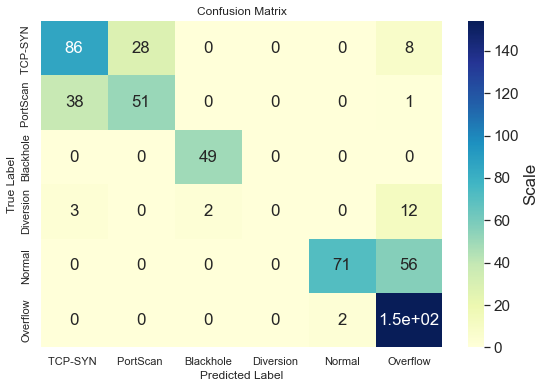

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.7917 - accuracy: 0.1940 - val_loss: 1.7630 - val_accuracy: 0.2086
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.7411 - accuracy: 0.2333 - val_loss: 1.7104 - val_accuracy: 0.2513
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.6786 - accuracy: 0.2799 - val_loss: 1.6410 - val_accuracy: 0.2977
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5950 - accuracy: 0.3589 - val_loss: 1.5458 - val_accuracy: 0.3975
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4913 - accuracy: 0.4750 - val_loss: 1.4361 - val_accuracy: 0.4724
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3779 - accuracy: 0.5120 - val_loss: 1.3222 - val_accuracy: 0.5258
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 1.2713 - accuracy: 0.5300 - val_loss: 1.2173 - val_accuracy: 0.5437
Epoch 8/500
2

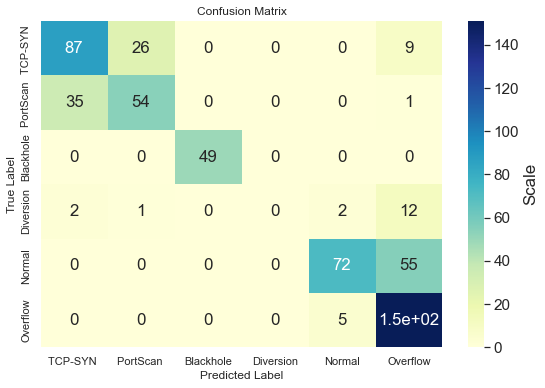

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.7456 - accuracy: 0.2734 - val_loss: 1.7003 - val_accuracy: 0.3922
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.6445 - accuracy: 0.4555 - val_loss: 1.6172 - val_accuracy: 0.4973
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5615 - accuracy: 0.5296 - val_loss: 1.5262 - val_accuracy: 0.5419
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4643 - accuracy: 0.5514 - val_loss: 1.4103 - val_accuracy: 0.5615
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3451 - accuracy: 0.5785 - val_loss: 1.2752 - val_accuracy: 0.6061
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.2170 - accuracy: 0.5792 - val_loss: 1.1445 - val_accuracy: 0.5811
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 1.1036 - accuracy: 0.5414 - val_loss: 1.0404 - val_accuracy: 0.5775
Epoch 8/500
2

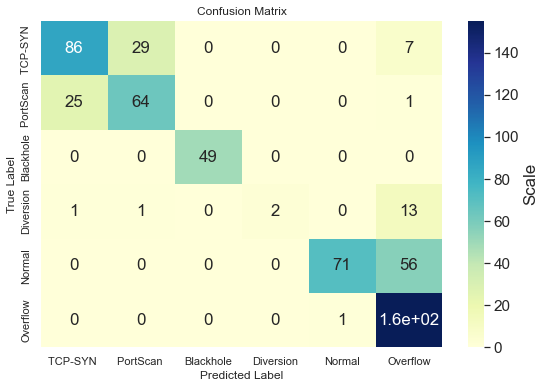

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7441771626472473
Min_training_accuracy:  0.7163039445877075
Avg_training_accuracy:  0.7275295972824096
----------------------------------------------
Max_testing_accuracy:  0.7611408233642578
Min_testing_accuracy:  0.7219251394271851
Avg_testing_accuracy:  0.7411764621734619
----------------------------------------------
Max_Valadation_accuracy:  0.7557932138442993
Min_Valadation_accuracy:  0.7183600664138794
Avg_Valadation_accuracy:  0.7308377981185913


In [ ]:
fourH_10n_train,fourH_10n_test,fourH_10n_val=model_four_hidden(10)

In [ ]:
clac_min_max_average(fourH_10n_train,fourH_10n_test,fourH_10n_val)

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7441771626472473
Min_training_accuracy:  0.7163039445877075
Avg_training_accuracy:  0.7275295972824096
----------------------------------------------
Max_testing_accuracy:  0.7611408233642578
Min_testing_accuracy:  0.7219251394271851
Avg_testing_accuracy:  0.7411764621734619
----------------------------------------------
Max_Valadation_accuracy:  0.7557932138442993
Min_Valadation_accuracy:  0.7183600664138794
Avg_Valadation_accuracy:  0.7308377981185913


In [ ]:
fourH_10n_avg =  np.average(fourH_10n_test)

#### 4 Hidden Layer with 20 neurones

Epoch 1/500
21/21 [==============================] - 1s 5ms/step - loss: 1.7382 - accuracy: 0.3784 - val_loss: 1.6681 - val_accuracy: 0.4581
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5834 - accuracy: 0.4903 - val_loss: 1.4822 - val_accuracy: 0.5062
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.3630 - accuracy: 0.5239 - val_loss: 1.2453 - val_accuracy: 0.5365
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.1382 - accuracy: 0.5586 - val_loss: 1.0253 - val_accuracy: 0.5954
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 0.9702 - accuracy: 0.6052 - val_loss: 0.8847 - val_accuracy: 0.6275
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 0.8679 - accuracy: 0.6239 - val_loss: 0.8088 - val_accuracy: 0.6578
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 0.8133 - accuracy: 0.6445 - val_loss: 0.7623 - val_accuracy: 0.6667
Epoch 8/500
2

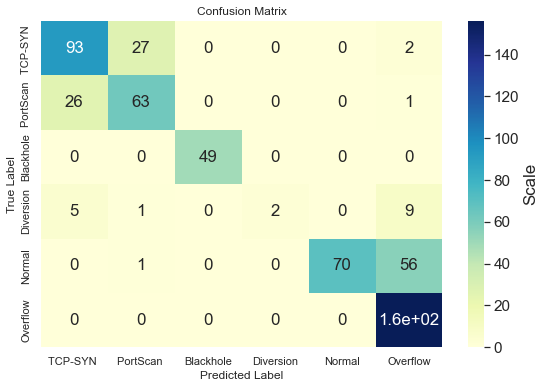

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.7607 - accuracy: 0.2929 - val_loss: 1.6975 - val_accuracy: 0.2799
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.6277 - accuracy: 0.3616 - val_loss: 1.5620 - val_accuracy: 0.4189
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4546 - accuracy: 0.4830 - val_loss: 1.3547 - val_accuracy: 0.5027
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.2225 - accuracy: 0.5418 - val_loss: 1.1044 - val_accuracy: 0.5472
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 0.9985 - accuracy: 0.6159 - val_loss: 0.8905 - val_accuracy: 0.6488
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 0.8496 - accuracy: 0.6754 - val_loss: 0.7876 - val_accuracy: 0.6649
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 0.7858 - accuracy: 0.6800 - val_loss: 0.7489 - val_accuracy: 0.6988
Epoch 8/500
2

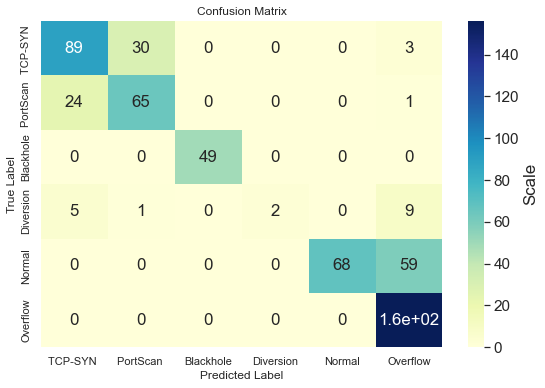

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.7147 - accuracy: 0.2948 - val_loss: 1.6476 - val_accuracy: 0.3351
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5567 - accuracy: 0.3734 - val_loss: 1.4861 - val_accuracy: 0.3547
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3807 - accuracy: 0.4177 - val_loss: 1.3241 - val_accuracy: 0.4421
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.2274 - accuracy: 0.5048 - val_loss: 1.1501 - val_accuracy: 0.5312
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.0540 - accuracy: 0.5800 - val_loss: 0.9360 - val_accuracy: 0.6275
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 0.8947 - accuracy: 0.6281 - val_loss: 0.8106 - val_accuracy: 0.6774
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 0.8215 - accuracy: 0.6793 - val_loss: 0.7635 - val_accuracy: 0.6756
Epoch 8/500
2

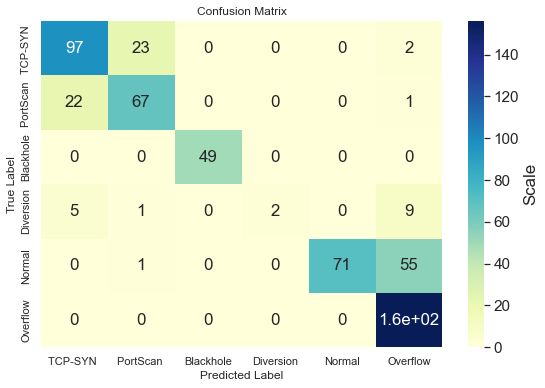

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.7706 - accuracy: 0.2333 - val_loss: 1.6956 - val_accuracy: 0.4545
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.6409 - accuracy: 0.4998 - val_loss: 1.5762 - val_accuracy: 0.5668
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5077 - accuracy: 0.5273 - val_loss: 1.4176 - val_accuracy: 0.5508
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3377 - accuracy: 0.5208 - val_loss: 1.2209 - val_accuracy: 0.5526
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.1484 - accuracy: 0.5231 - val_loss: 1.0329 - val_accuracy: 0.5472
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 0.9861 - accuracy: 0.5643 - val_loss: 0.9083 - val_accuracy: 0.6381
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 0.8891 - accuracy: 0.6357 - val_loss: 0.8416 - val_accuracy: 0.6560
Epoch 8/500
2

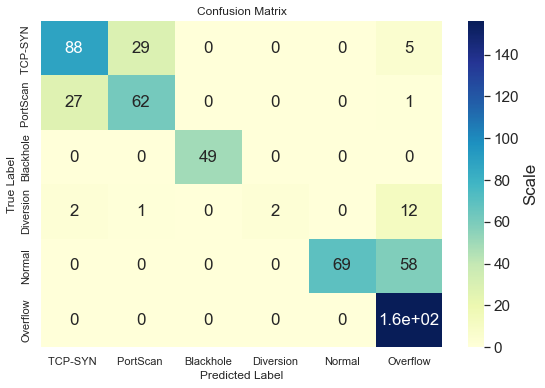

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.7520 - accuracy: 0.2768 - val_loss: 1.6989 - val_accuracy: 0.4278
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.6446 - accuracy: 0.4441 - val_loss: 1.6016 - val_accuracy: 0.5027
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5291 - accuracy: 0.5059 - val_loss: 1.4699 - val_accuracy: 0.5544
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3797 - accuracy: 0.5384 - val_loss: 1.2701 - val_accuracy: 0.5758
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.1677 - accuracy: 0.5418 - val_loss: 1.0272 - val_accuracy: 0.5775
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 0.9674 - accuracy: 0.6117 - val_loss: 0.8631 - val_accuracy: 0.6542
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 0.8583 - accuracy: 0.6502 - val_loss: 0.7838 - val_accuracy: 0.6881
Epoch 8/500
2

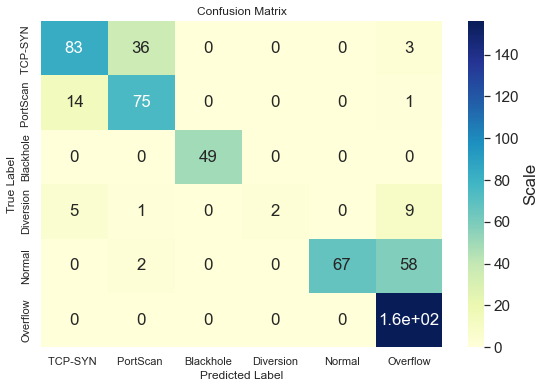

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7720503807067871
Min_training_accuracy:  0.7590683698654175
Avg_training_accuracy:  0.7654830098152161
----------------------------------------------
Max_testing_accuracy:  0.7878788113594055
Min_testing_accuracy:  0.759358286857605
Avg_testing_accuracy:  0.7707664847373963
----------------------------------------------
Max_Valadation_accuracy:  0.7771835923194885
Min_Valadation_accuracy:  0.7664884328842163
Avg_Valadation_accuracy:  0.7714794993400573


In [ ]:
fourH_20n_train,fourH_20n_test,fourH_20n_val=model_four_hidden(20)

In [ ]:
clac_min_max_average(fourH_20n_train,fourH_20n_test,fourH_20n_val)

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7720503807067871
Min_training_accuracy:  0.7590683698654175
Avg_training_accuracy:  0.7654830098152161
----------------------------------------------
Max_testing_accuracy:  0.7878788113594055
Min_testing_accuracy:  0.759358286857605
Avg_testing_accuracy:  0.7707664847373963
----------------------------------------------
Max_Valadation_accuracy:  0.7771835923194885
Min_Valadation_accuracy:  0.7664884328842163
Avg_Valadation_accuracy:  0.7714794993400573


In [ ]:
fourH_20n_avg =  np.average(fourH_20n_test)

#### 4 Hidden Layer with 30 neurones

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.7138 - accuracy: 0.2604 - val_loss: 1.6122 - val_accuracy: 0.3280
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.5084 - accuracy: 0.3570 - val_loss: 1.3931 - val_accuracy: 0.4349
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.2681 - accuracy: 0.4704 - val_loss: 1.1558 - val_accuracy: 0.5651
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.0555 - accuracy: 0.5609 - val_loss: 0.9404 - val_accuracy: 0.6043
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8951 - accuracy: 0.6380 - val_loss: 0.8144 - val_accuracy: 0.6684
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 0.8071 - accuracy: 0.6564 - val_loss: 0.7483 - val_accuracy: 0.7041
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7607 - accuracy: 0.6938 - val_loss: 0.7258 - val_accuracy: 0.6881
Epoch 8/500
2

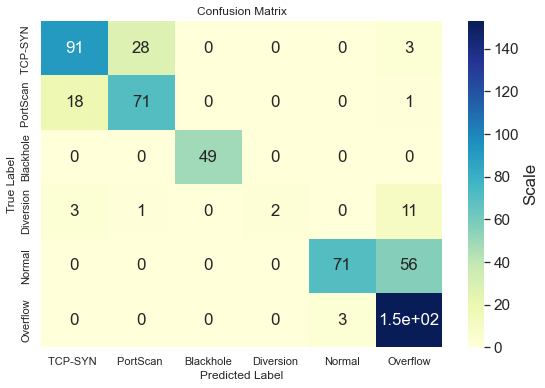

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.6780 - accuracy: 0.3066 - val_loss: 1.5483 - val_accuracy: 0.4135
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4143 - accuracy: 0.4486 - val_loss: 1.2736 - val_accuracy: 0.5045
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.1556 - accuracy: 0.5399 - val_loss: 1.0755 - val_accuracy: 0.5526
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.0173 - accuracy: 0.5804 - val_loss: 0.9395 - val_accuracy: 0.6257
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 0.9202 - accuracy: 0.6350 - val_loss: 0.8582 - val_accuracy: 0.6738
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 0.8443 - accuracy: 0.6762 - val_loss: 0.7996 - val_accuracy: 0.6988
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 0.7870 - accuracy: 0.6961 - val_loss: 0.7465 - val_accuracy: 0.7059
Epoch 8/500
2

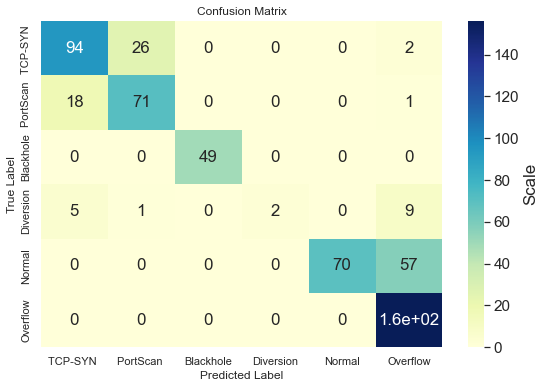

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.6794 - accuracy: 0.3788 - val_loss: 1.5478 - val_accuracy: 0.4813
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4156 - accuracy: 0.5013 - val_loss: 1.2269 - val_accuracy: 0.5062
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.0954 - accuracy: 0.5262 - val_loss: 0.9497 - val_accuracy: 0.6043
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 0.8955 - accuracy: 0.6369 - val_loss: 0.8237 - val_accuracy: 0.6631
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 0.8079 - accuracy: 0.6785 - val_loss: 0.7558 - val_accuracy: 0.6863
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7550 - accuracy: 0.7041 - val_loss: 0.7072 - val_accuracy: 0.7237
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 0.7150 - accuracy: 0.7152 - val_loss: 0.6680 - val_accuracy: 0.7433
Epoch 8/500
2

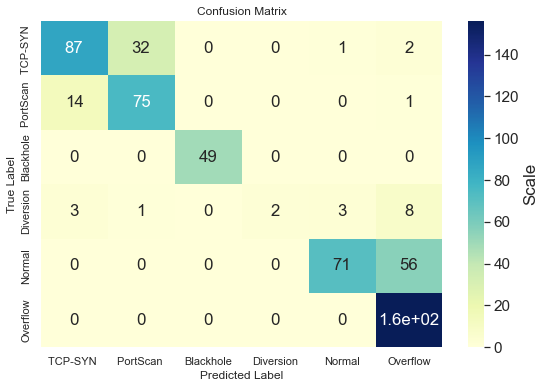

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.6392 - accuracy: 0.3719 - val_loss: 1.5116 - val_accuracy: 0.4973
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4261 - accuracy: 0.4864 - val_loss: 1.2798 - val_accuracy: 0.5169
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.1993 - accuracy: 0.5815 - val_loss: 1.0306 - val_accuracy: 0.6578
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9981 - accuracy: 0.6602 - val_loss: 0.8667 - val_accuracy: 0.6827
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 0.8590 - accuracy: 0.6781 - val_loss: 0.7667 - val_accuracy: 0.7041
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 0.7823 - accuracy: 0.7010 - val_loss: 0.7210 - val_accuracy: 0.7219
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 0.7430 - accuracy: 0.7174 - val_loss: 0.6839 - val_accuracy: 0.7308
Epoch 8/500
2

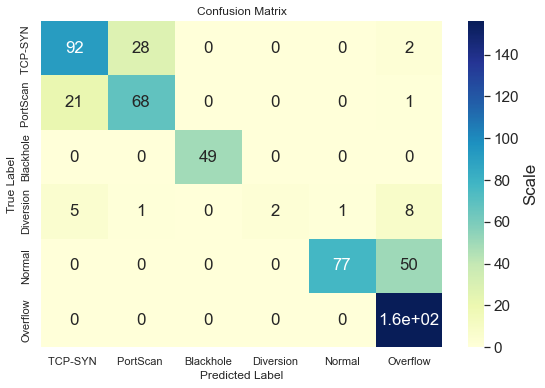

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.6786 - accuracy: 0.3486 - val_loss: 1.5167 - val_accuracy: 0.5045
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.3913 - accuracy: 0.4998 - val_loss: 1.2041 - val_accuracy: 0.5401
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.1018 - accuracy: 0.5174 - val_loss: 0.9455 - val_accuracy: 0.5900
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9151 - accuracy: 0.6449 - val_loss: 0.8156 - val_accuracy: 0.6988
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8203 - accuracy: 0.6754 - val_loss: 0.7471 - val_accuracy: 0.7094
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 0.7617 - accuracy: 0.6961 - val_loss: 0.7030 - val_accuracy: 0.7130
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 0.7221 - accuracy: 0.7087 - val_loss: 0.6689 - val_accuracy: 0.7291
Epoch 8/500
2

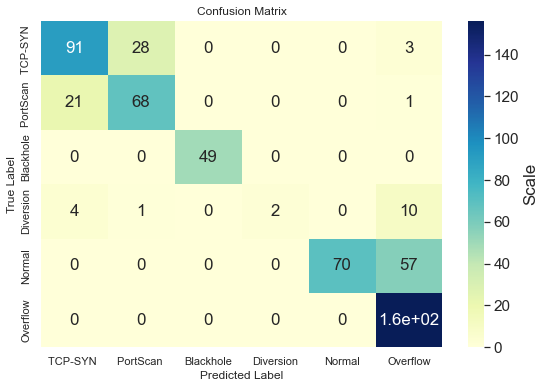

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7777777910232544
Min_training_accuracy:  0.7693776488304138
Avg_training_accuracy:  0.7732722520828247
----------------------------------------------
Max_testing_accuracy:  0.7914438247680664
Min_testing_accuracy:  0.7771835923194885
Avg_testing_accuracy:  0.7839572191238403
----------------------------------------------
Max_Valadation_accuracy:  0.7878788113594055
Min_Valadation_accuracy:  0.77183598279953
Avg_Valadation_accuracy:  0.7807486653327942


In [ ]:
fourH_30n_train,fourH_30n_test,fourH_30n_val=model_four_hidden(30)

In [ ]:
clac_min_max_average(fourH_30n_train,fourH_30n_test,fourH_30n_val)

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7777777910232544
Min_training_accuracy:  0.7693776488304138
Avg_training_accuracy:  0.7732722520828247
----------------------------------------------
Max_testing_accuracy:  0.7914438247680664
Min_testing_accuracy:  0.7771835923194885
Avg_testing_accuracy:  0.7839572191238403
----------------------------------------------
Max_Valadation_accuracy:  0.7878788113594055
Min_Valadation_accuracy:  0.77183598279953
Avg_Valadation_accuracy:  0.7807486653327942


In [ ]:
fourH_30n_avg =  np.average(fourH_30n_test)

#### 4 Hidden Layer with 40 neurones

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.7007 - accuracy: 0.3028 - val_loss: 1.5548 - val_accuracy: 0.4456
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.3794 - accuracy: 0.4918 - val_loss: 1.1916 - val_accuracy: 0.5472
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.0326 - accuracy: 0.5853 - val_loss: 0.8846 - val_accuracy: 0.6649
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8386 - accuracy: 0.6491 - val_loss: 0.7573 - val_accuracy: 0.6970
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7610 - accuracy: 0.6781 - val_loss: 0.7080 - val_accuracy: 0.7112
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7188 - accuracy: 0.7048 - val_loss: 0.6855 - val_accuracy: 0.6898
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7080 - accuracy: 0.6800 - val_loss: 0.6773 - val_accuracy: 0.7148
Epoch 8/500
2

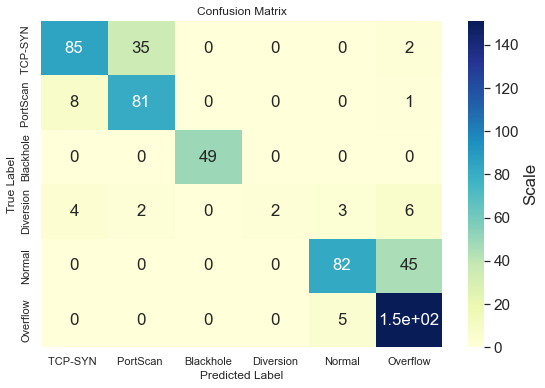

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.6641 - accuracy: 0.3856 - val_loss: 1.5003 - val_accuracy: 0.4510
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.3237 - accuracy: 0.4853 - val_loss: 1.1304 - val_accuracy: 0.5080
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.0096 - accuracy: 0.5872 - val_loss: 0.8784 - val_accuracy: 0.6845
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8468 - accuracy: 0.6636 - val_loss: 0.7676 - val_accuracy: 0.6970
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 0.7520 - accuracy: 0.6953 - val_loss: 0.6979 - val_accuracy: 0.7184
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 0.6993 - accuracy: 0.7140 - val_loss: 0.6563 - val_accuracy: 0.7362
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 0.6747 - accuracy: 0.7258 - val_loss: 0.6384 - val_accuracy: 0.6774
Epoch 8/500
2

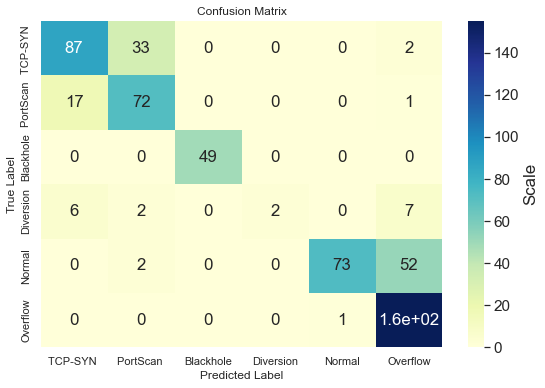

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.6980 - accuracy: 0.3681 - val_loss: 1.5632 - val_accuracy: 0.4920
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.3933 - accuracy: 0.5055 - val_loss: 1.1815 - val_accuracy: 0.5651
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.0414 - accuracy: 0.5739 - val_loss: 0.9044 - val_accuracy: 0.6292
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8607 - accuracy: 0.6346 - val_loss: 0.8009 - val_accuracy: 0.6275
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7903 - accuracy: 0.6613 - val_loss: 0.7354 - val_accuracy: 0.6791
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7351 - accuracy: 0.6900 - val_loss: 0.7089 - val_accuracy: 0.6364
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7059 - accuracy: 0.7026 - val_loss: 0.6594 - val_accuracy: 0.7112
Epoch 8/500
2

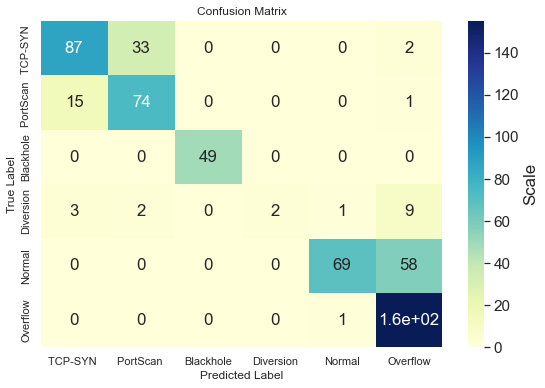

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.6630 - accuracy: 0.3444 - val_loss: 1.5185 - val_accuracy: 0.4260
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.3578 - accuracy: 0.4727 - val_loss: 1.2332 - val_accuracy: 0.4973
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.0968 - accuracy: 0.5605 - val_loss: 0.9673 - val_accuracy: 0.5865
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9006 - accuracy: 0.6464 - val_loss: 0.8145 - val_accuracy: 0.6898
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7993 - accuracy: 0.6873 - val_loss: 0.7358 - val_accuracy: 0.7023
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7463 - accuracy: 0.6991 - val_loss: 0.6981 - val_accuracy: 0.7130
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 0.7148 - accuracy: 0.7090 - val_loss: 0.6723 - val_accuracy: 0.7219
Epoch 8/500
2

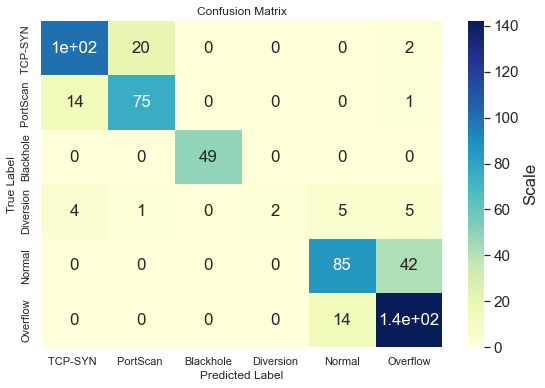

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.7148 - accuracy: 0.4177 - val_loss: 1.6101 - val_accuracy: 0.5544
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.4790 - accuracy: 0.5949 - val_loss: 1.3276 - val_accuracy: 0.6061
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.1806 - accuracy: 0.6331 - val_loss: 0.9924 - val_accuracy: 0.6524
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 0.8965 - accuracy: 0.6686 - val_loss: 0.7815 - val_accuracy: 0.6863
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7672 - accuracy: 0.6835 - val_loss: 0.7120 - val_accuracy: 0.7112
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 0.7196 - accuracy: 0.7102 - val_loss: 0.6819 - val_accuracy: 0.7273
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6969 - accuracy: 0.7144 - val_loss: 0.6735 - val_accuracy: 0.7308
Epoch 8/500
2

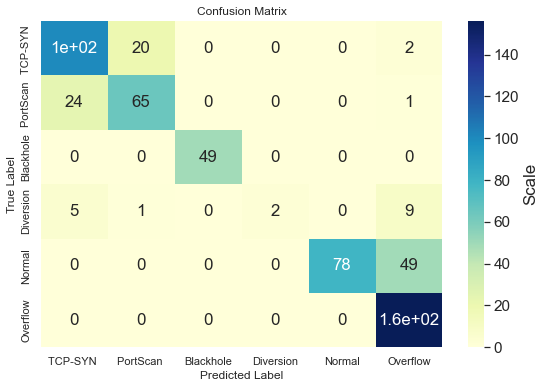

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7991600036621094
Min_training_accuracy:  0.7701413035392761
Avg_training_accuracy:  0.7873997807502746
----------------------------------------------
Max_testing_accuracy:  0.8074866533279419
Min_testing_accuracy:  0.7771835923194885
Avg_testing_accuracy:  0.7939393997192383
----------------------------------------------
Max_Valadation_accuracy:  0.8074866533279419
Min_Valadation_accuracy:  0.7807486653327942
Avg_Valadation_accuracy:  0.7918003678321839


In [ ]:
fourH_40n_train,fourH_40n_test,fourH_40n_val=model_four_hidden(40)

In [ ]:
clac_min_max_average(fourH_40n_train,fourH_40n_test,fourH_40n_val)

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7991600036621094
Min_training_accuracy:  0.7701413035392761
Avg_training_accuracy:  0.7873997807502746
----------------------------------------------
Max_testing_accuracy:  0.8074866533279419
Min_testing_accuracy:  0.7771835923194885
Avg_testing_accuracy:  0.7939393997192383
----------------------------------------------
Max_Valadation_accuracy:  0.8074866533279419
Min_Valadation_accuracy:  0.7807486653327942
Avg_Valadation_accuracy:  0.7918003678321839


In [ ]:
fourH_40n_avg =  np.average(fourH_40n_test)

In [ ]:
fourH_10n_avg

0.7411764621734619

In [ ]:
four_hiden_testavg=[fourH_10n_avg,fourH_20n_avg,fourH_30n_avg,fourH_40n_avg]
four_hiden_testavg

[0.7411764621734619,
 0.7707664847373963,
 0.7839572191238403,
 0.7939393997192383]

### Plot number of neurons vs the avg test accuracy

### At eight Hidden Layer 

In [ ]:
def model_eight_hidden(neuro):
    total_train_acc= []
    total_test_acc= []
    total_val_acc=[]
    confusion=[]
    number_of_runs=5
    for i in range(number_of_runs):
        optimizer=tfaAdamw.optimizers.AdamW(learning_rate= 0.001, weight_decay= 0.001)
        model = keras.models.Sequential()
        model.add(Dense(neuro, input_shape = (10,), activation = 'relu'))
        model.add(Dense(neuro, activation = 'relu'))
        model.add(Dense(neuro, activation = 'relu'))
        model.add(Dense(neuro, activation = 'relu'))
        model.add(Dense(neuro, activation = 'relu'))
        model.add(Dense(neuro, activation = 'relu'))
        model.add(Dense(neuro, activation = 'relu'))
        model.add(Dense(neuro, activation = 'relu'))
        model.add(Dense(6, activation = "softmax"))
        callback = tf.keras.callbacks.EarlyStopping(monitor='loss', patience=5)
        model.compile(optimizer=optimizer, loss="sparse_categorical_crossentropy", metrics = ["accuracy"])
        model.fit(x_train_scaled_anovaa, train_y, epochs=500, batch_size=128, validation_data=(x_val_scaled_anovaa,val_y),callbacks=[callback])
        total_train_acc.append(model.evaluate(x_train_scaled_anovaa, train_y, verbose=0)[1])
        total_test_acc.append(model.evaluate(x_test_scaled_anovaa, test_y, verbose=0)[1])
        total_val_acc.append(model.evaluate(x_val_scaled_anovaa,val_y, verbose=0)[1])

        y_pred = np.argmax(model.predict(x_test_scaled_anovaa), axis=-1)
        data= confusion_matrix(test_y, y_pred)
        confusion.append(data)
        labels =['TCP-SYN ','PortScan ','Blackhole','Diversion','Normal','Overflow']
        plot_confusion_matrix(data,labels)

    # Training acc 
    # Max
    max_training_accuracy = np.amax(total_train_acc)
    # Min 
    min_training_accuracy = np.amin(total_train_acc)
    #Avg
    avg_training_accuracy = np.average(total_train_acc)

    # Testing acc 
    # Max
    max_testing_accuracy =  np.amax(total_test_acc)
    # Min 
    min_testing_accuracy =  np.amin(total_test_acc)
    # Avg
    avg_testing_accuracy =  np.average(total_test_acc)

    # Valadation acc 
    # Max
    max_Valadation_accuracy =  np.amax(total_val_acc)
    # Min 
    min_Valadation_accuracy =  np.amin(total_val_acc)
    # Avg
    avg_Valadation_accuracy =  np.average(total_val_acc)

    print('Min, Max, Avg Accuracies', '\n')
    print('Max_training_accuracy:', max_training_accuracy )
    print('Min_training_accuracy: ', min_training_accuracy)
    print('Avg_training_accuracy: ', avg_training_accuracy)
    print('----------------------------------------------')
    print('Max_testing_accuracy: ', max_testing_accuracy)
    print('Min_testing_accuracy: ', min_testing_accuracy)
    print('Avg_testing_accuracy: ', avg_testing_accuracy)
    print('----------------------------------------------')
    print('Max_Valadation_accuracy: ', max_Valadation_accuracy)
    print('Min_Valadation_accuracy: ', min_Valadation_accuracy)
    print('Avg_Valadation_accuracy: ', avg_Valadation_accuracy)
    
    return total_train_acc,total_test_acc,total_val_acc

##### 8 Hidden Layer with 10 neurones

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.7791 - accuracy: 0.2455 - val_loss: 1.7652 - val_accuracy: 0.2228
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7445 - accuracy: 0.2558 - val_loss: 1.7257 - val_accuracy: 0.2228
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6927 - accuracy: 0.2566 - val_loss: 1.6697 - val_accuracy: 0.2228
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.6195 - accuracy: 0.2799 - val_loss: 1.5913 - val_accuracy: 0.2745
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.5263 - accuracy: 0.3528 - val_loss: 1.4985 - val_accuracy: 0.3119
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 1.4131 - accuracy: 0.3696 - val_loss: 1.3810 - val_accuracy: 0.3529
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 1.2966 - accuracy: 0.3944 - val_loss: 1.2856 - val_accuracy: 0.3547
Epoch 8/500
2

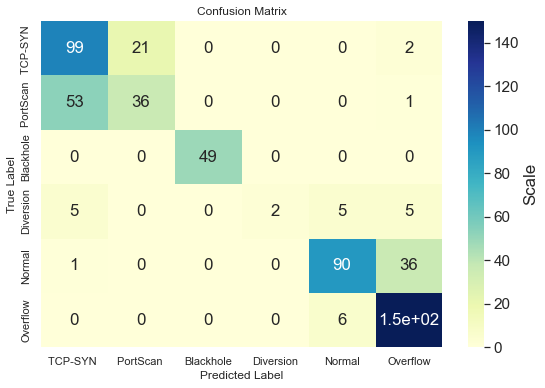

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.7787 - accuracy: 0.2417 - val_loss: 1.7627 - val_accuracy: 0.2513
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7518 - accuracy: 0.2543 - val_loss: 1.7309 - val_accuracy: 0.2513
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7199 - accuracy: 0.2543 - val_loss: 1.6982 - val_accuracy: 0.2513
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6866 - accuracy: 0.2543 - val_loss: 1.6713 - val_accuracy: 0.2513
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.6577 - accuracy: 0.2780 - val_loss: 1.6495 - val_accuracy: 0.3048
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.6236 - accuracy: 0.3257 - val_loss: 1.6169 - val_accuracy: 0.2906
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 1.5751 - accuracy: 0.3169 - val_loss: 1.5713 - val_accuracy: 0.2870
Epoch 8/500
2

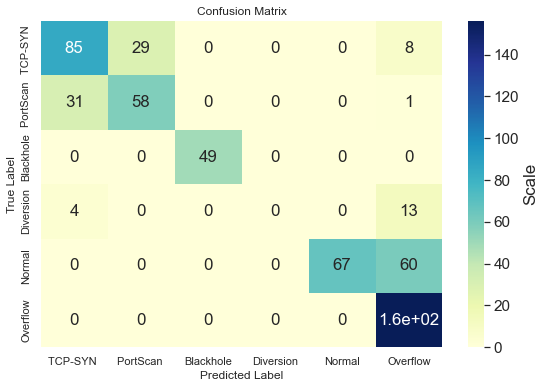

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.7860 - accuracy: 0.2524 - val_loss: 1.7764 - val_accuracy: 0.2852
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7662 - accuracy: 0.2581 - val_loss: 1.7534 - val_accuracy: 0.2763
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7376 - accuracy: 0.2910 - val_loss: 1.7159 - val_accuracy: 0.3102
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6864 - accuracy: 0.2753 - val_loss: 1.6451 - val_accuracy: 0.3209
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.5859 - accuracy: 0.2753 - val_loss: 1.5096 - val_accuracy: 0.2959
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 1.4116 - accuracy: 0.3604 - val_loss: 1.3213 - val_accuracy: 0.4064
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 1.2108 - accuracy: 0.4521 - val_loss: 1.1348 - val_accuracy: 0.4635
Epoch 8/500
2

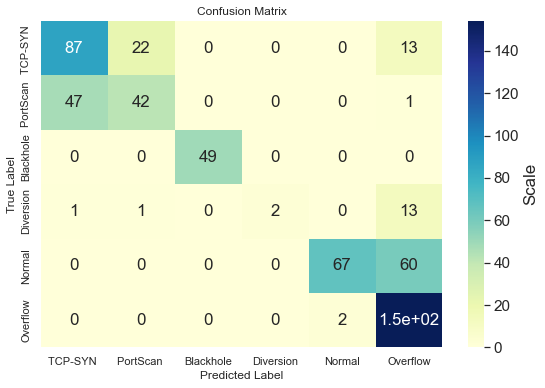

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.7803 - accuracy: 0.2631 - val_loss: 1.7617 - val_accuracy: 0.2620
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7354 - accuracy: 0.2826 - val_loss: 1.7054 - val_accuracy: 0.3012
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.6479 - accuracy: 0.3318 - val_loss: 1.5723 - val_accuracy: 0.3779
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.4693 - accuracy: 0.3956 - val_loss: 1.3360 - val_accuracy: 0.4332
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.2249 - accuracy: 0.4689 - val_loss: 1.1063 - val_accuracy: 0.4652
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 1.0351 - accuracy: 0.5548 - val_loss: 0.9658 - val_accuracy: 0.5918
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9465 - accuracy: 0.6186 - val_loss: 0.8964 - val_accuracy: 0.6257
Epoch 8/500
2

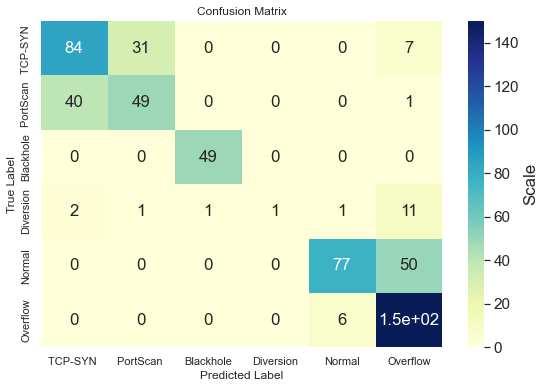

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.7853 - accuracy: 0.1974 - val_loss: 1.7662 - val_accuracy: 0.1961
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.7556 - accuracy: 0.1516 - val_loss: 1.7370 - val_accuracy: 0.1872
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.7215 - accuracy: 0.1974 - val_loss: 1.6939 - val_accuracy: 0.2442
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.6685 - accuracy: 0.2482 - val_loss: 1.6282 - val_accuracy: 0.2496
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5890 - accuracy: 0.2532 - val_loss: 1.5448 - val_accuracy: 0.2460
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5035 - accuracy: 0.2952 - val_loss: 1.4757 - val_accuracy: 0.3351
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4195 - accuracy: 0.3784 - val_loss: 1.3913 - val_accuracy: 0.3476
Epoch 8/500
2

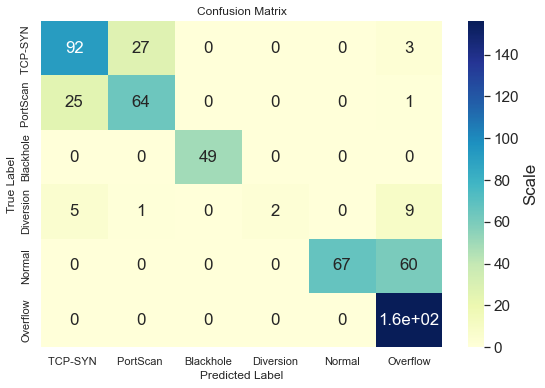

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7407407164573669
Min_training_accuracy:  0.7136311531066895
Avg_training_accuracy:  0.7284459710121155
----------------------------------------------
Max_testing_accuracy:  0.7664884328842163
Min_testing_accuracy:  0.7147949934005737
Avg_testing_accuracy:  0.7422459840774536
----------------------------------------------
Max_Valadation_accuracy:  0.7486631274223328
Min_Valadation_accuracy:  0.7023172974586487
Avg_Valadation_accuracy:  0.7297682762145996


In [ ]:
eightH_10n_train,eightH_10n_test,eightH_10n_val=model_eight_hidden(10)

In [ ]:
clac_min_max_average(eightH_10n_train,eightH_10n_test,eightH_10n_val)

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7304314374923706
Min_training_accuracy:  0.6834669709205627
Avg_training_accuracy:  0.7125620365142822
----------------------------------------------
Max_testing_accuracy:  0.7486631274223328
Min_testing_accuracy:  0.7130124568939209
Avg_testing_accuracy:  0.7336898446083069
----------------------------------------------
Max_Valadation_accuracy:  0.7361853718757629
Min_Valadation_accuracy:  0.7005347609519958
Avg_Valadation_accuracy:  0.7190730929374695


In [ ]:
avg_eightH_10n =  np.average(eightH_10n_test)

##### 8 Hidden Layer with 20 neurones

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.7477 - accuracy: 0.2967 - val_loss: 1.7000 - val_accuracy: 0.3030
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6014 - accuracy: 0.3471 - val_loss: 1.5208 - val_accuracy: 0.3583
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.3854 - accuracy: 0.4654 - val_loss: 1.2716 - val_accuracy: 0.4599
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.1125 - accuracy: 0.5223 - val_loss: 0.9940 - val_accuracy: 0.5561
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9362 - accuracy: 0.5693 - val_loss: 0.8885 - val_accuracy: 0.5847
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8644 - accuracy: 0.6243 - val_loss: 0.8247 - val_accuracy: 0.6560
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8074 - accuracy: 0.6678 - val_loss: 0.7697 - val_accuracy: 0.7023
Epoch 8/500
2

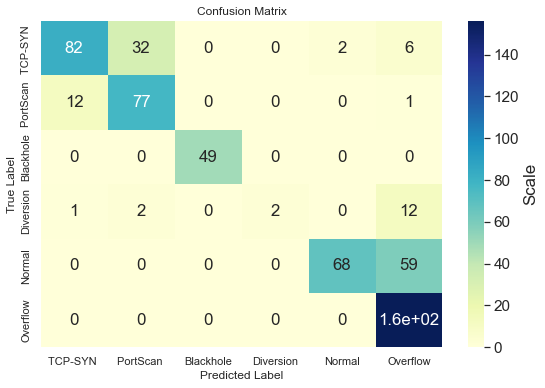

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.7469 - accuracy: 0.3597 - val_loss: 1.6848 - val_accuracy: 0.4385
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.5601 - accuracy: 0.4387 - val_loss: 1.4363 - val_accuracy: 0.4492
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.3047 - accuracy: 0.4318 - val_loss: 1.2349 - val_accuracy: 0.3993
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.1379 - accuracy: 0.5086 - val_loss: 1.0667 - val_accuracy: 0.5205
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.0110 - accuracy: 0.5575 - val_loss: 0.9582 - val_accuracy: 0.5686
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9155 - accuracy: 0.6010 - val_loss: 0.8331 - val_accuracy: 0.6613
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8061 - accuracy: 0.6617 - val_loss: 0.7433 - val_accuracy: 0.6756
Epoch 8/500
2

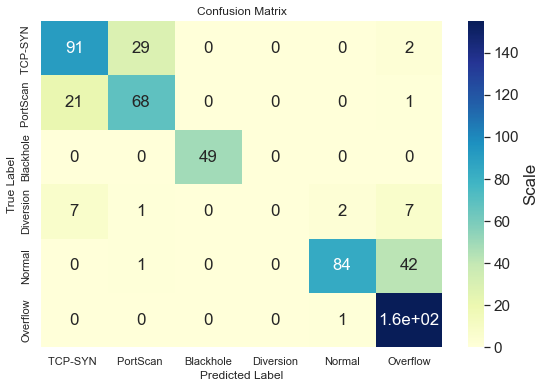

Epoch 1/500
21/21 [==============================] - 1s 6ms/step - loss: 1.7456 - accuracy: 0.2635 - val_loss: 1.6962 - val_accuracy: 0.3137
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6043 - accuracy: 0.3261 - val_loss: 1.5587 - val_accuracy: 0.3209
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.4317 - accuracy: 0.3394 - val_loss: 1.3270 - val_accuracy: 0.3743
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.1774 - accuracy: 0.4727 - val_loss: 1.0336 - val_accuracy: 0.5187
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9656 - accuracy: 0.5197 - val_loss: 0.8858 - val_accuracy: 0.5383
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8983 - accuracy: 0.5349 - val_loss: 0.8424 - val_accuracy: 0.5348
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8606 - accuracy: 0.5491 - val_loss: 0.8212 - val_accuracy: 0.5936
Epoch 8/500
2

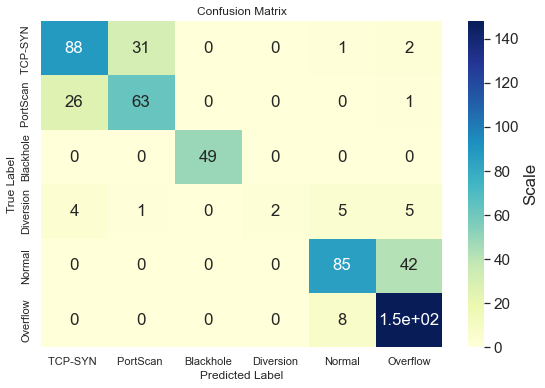

Epoch 1/500
21/21 [==============================] - 1s 6ms/step - loss: 1.7577 - accuracy: 0.2535 - val_loss: 1.6850 - val_accuracy: 0.3619
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6462 - accuracy: 0.3704 - val_loss: 1.5264 - val_accuracy: 0.4563
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.5039 - accuracy: 0.4276 - val_loss: 1.3632 - val_accuracy: 0.4688
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.3440 - accuracy: 0.4788 - val_loss: 1.1661 - val_accuracy: 0.5633
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.0907 - accuracy: 0.5578 - val_loss: 0.9057 - val_accuracy: 0.5865
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8427 - accuracy: 0.5983 - val_loss: 0.7644 - val_accuracy: 0.6453
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7291 - accuracy: 0.6747 - val_loss: 0.6938 - val_accuracy: 0.7094
Epoch 8/500
2

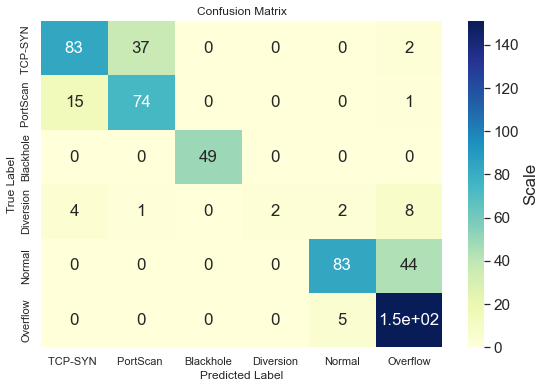

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.7700 - accuracy: 0.2574 - val_loss: 1.7397 - val_accuracy: 0.2513
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6792 - accuracy: 0.2543 - val_loss: 1.5969 - val_accuracy: 0.2602
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.4571 - accuracy: 0.3257 - val_loss: 1.3467 - val_accuracy: 0.3815
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.2263 - accuracy: 0.5147 - val_loss: 1.1655 - val_accuracy: 0.5668
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.0795 - accuracy: 0.6021 - val_loss: 0.9860 - val_accuracy: 0.6542
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 0.9031 - accuracy: 0.6590 - val_loss: 0.7778 - val_accuracy: 0.7077
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7675 - accuracy: 0.6865 - val_loss: 0.7243 - val_accuracy: 0.7112
Epoch 8/500
2

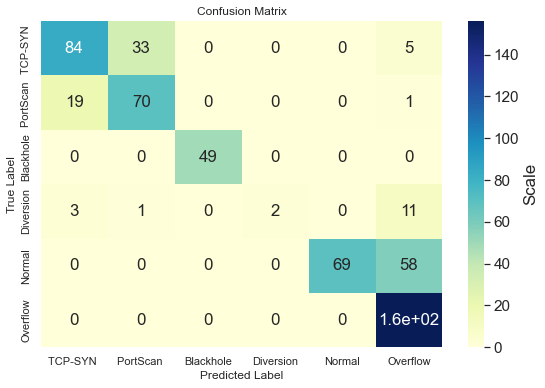

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7827414870262146
Min_training_accuracy:  0.7449408173561096
Avg_training_accuracy:  0.7662466526031494
----------------------------------------------
Max_testing_accuracy:  0.7967914342880249
Min_testing_accuracy:  0.7664884328842163
Avg_testing_accuracy:  0.780035650730133
----------------------------------------------
Max_Valadation_accuracy:  0.7932263612747192
Min_Valadation_accuracy:  0.7397504448890686
Avg_Valadation_accuracy:  0.7778966069221497


In [ ]:
eightH_20n_train,eightH_20n_test,eightH_20n_val=model_eight_hidden(20)

In [ ]:
clac_min_max_average(eightH_20n_train,eightH_20n_test,eightH_20n_val)

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7827414870262146
Min_training_accuracy:  0.7449408173561096
Avg_training_accuracy:  0.7662466526031494
----------------------------------------------
Max_testing_accuracy:  0.7967914342880249
Min_testing_accuracy:  0.7664884328842163
Avg_testing_accuracy:  0.780035650730133
----------------------------------------------
Max_Valadation_accuracy:  0.7932263612747192
Min_Valadation_accuracy:  0.7397504448890686
Avg_Valadation_accuracy:  0.7778966069221497


In [ ]:
avg_eightH_20n =  np.average(eightH_20n_test)

#### 8 Hidden Layer with 30 neurones

Epoch 1/500
21/21 [==============================] - 1s 6ms/step - loss: 1.7123 - accuracy: 0.4170 - val_loss: 1.6038 - val_accuracy: 0.4403
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.4095 - accuracy: 0.4765 - val_loss: 1.2436 - val_accuracy: 0.4831
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.1059 - accuracy: 0.5239 - val_loss: 0.9850 - val_accuracy: 0.5330
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9199 - accuracy: 0.6048 - val_loss: 0.8426 - val_accuracy: 0.5472
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8396 - accuracy: 0.6048 - val_loss: 0.7791 - val_accuracy: 0.5811
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7835 - accuracy: 0.6564 - val_loss: 0.7318 - val_accuracy: 0.7041
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7364 - accuracy: 0.6816 - val_loss: 0.6772 - val_accuracy: 0.7166
Epoch 8/500
2

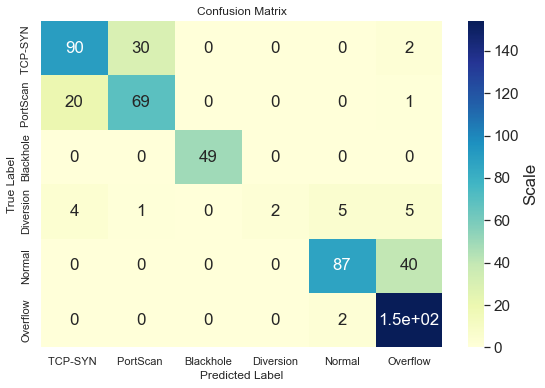

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.7592 - accuracy: 0.3169 - val_loss: 1.7013 - val_accuracy: 0.3298
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.5357 - accuracy: 0.4269 - val_loss: 1.2892 - val_accuracy: 0.4884
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.0621 - accuracy: 0.5113 - val_loss: 0.8965 - val_accuracy: 0.5526
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8824 - accuracy: 0.5441 - val_loss: 0.8142 - val_accuracy: 0.6364
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8186 - accuracy: 0.6346 - val_loss: 0.7587 - val_accuracy: 0.6774
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7648 - accuracy: 0.6762 - val_loss: 0.7291 - val_accuracy: 0.6631
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7298 - accuracy: 0.6838 - val_loss: 0.6847 - val_accuracy: 0.7023
Epoch 8/500
2

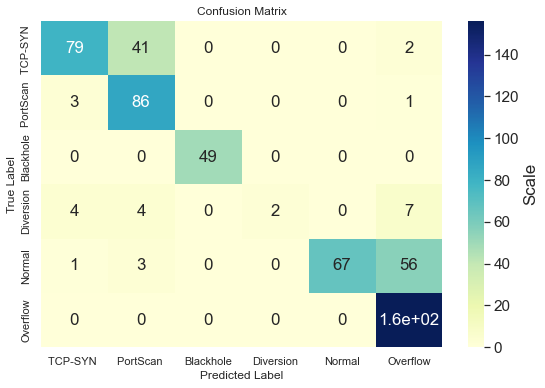

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.7346 - accuracy: 0.2680 - val_loss: 1.6278 - val_accuracy: 0.3619
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.4405 - accuracy: 0.4227 - val_loss: 1.1835 - val_accuracy: 0.4813
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.0112 - accuracy: 0.5200 - val_loss: 0.8391 - val_accuracy: 0.6185
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8140 - accuracy: 0.6205 - val_loss: 0.7469 - val_accuracy: 0.6613
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7590 - accuracy: 0.6640 - val_loss: 0.7297 - val_accuracy: 0.6702
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7248 - accuracy: 0.6724 - val_loss: 0.6796 - val_accuracy: 0.7023
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7071 - accuracy: 0.6865 - val_loss: 0.6684 - val_accuracy: 0.6970
Epoch 8/500
2

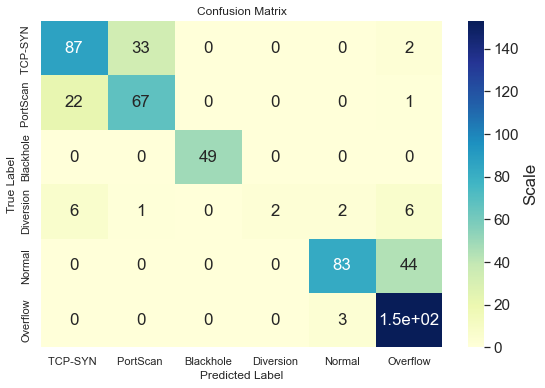

Epoch 1/500
21/21 [==============================] - 0s 7ms/step - loss: 1.7453 - accuracy: 0.4074 - val_loss: 1.6624 - val_accuracy: 0.5223
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.4939 - accuracy: 0.5239 - val_loss: 1.2376 - val_accuracy: 0.5472
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.0409 - accuracy: 0.5632 - val_loss: 0.8649 - val_accuracy: 0.6025
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8556 - accuracy: 0.5930 - val_loss: 0.7865 - val_accuracy: 0.6774
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7789 - accuracy: 0.6938 - val_loss: 0.7149 - val_accuracy: 0.7005
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7256 - accuracy: 0.7014 - val_loss: 0.6719 - val_accuracy: 0.7237
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7009 - accuracy: 0.7037 - val_loss: 0.6743 - val_accuracy: 0.6934
Epoch 8/500
2

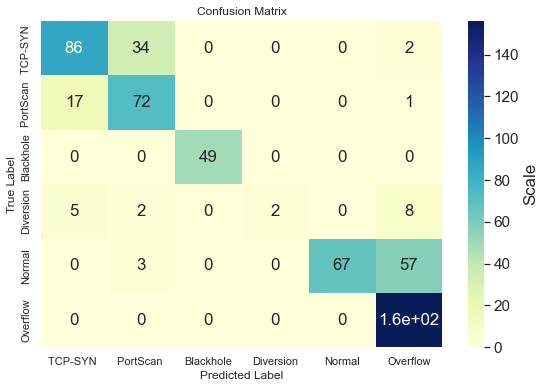

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.7153 - accuracy: 0.2776 - val_loss: 1.6076 - val_accuracy: 0.3191
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.4178 - accuracy: 0.3856 - val_loss: 1.1709 - val_accuracy: 0.4955
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.0270 - accuracy: 0.5632 - val_loss: 0.8607 - val_accuracy: 0.6506
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8385 - accuracy: 0.6102 - val_loss: 0.7689 - val_accuracy: 0.6150
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7667 - accuracy: 0.6457 - val_loss: 0.7129 - val_accuracy: 0.6952
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7245 - accuracy: 0.6785 - val_loss: 0.6739 - val_accuracy: 0.7077
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6915 - accuracy: 0.7041 - val_loss: 0.6625 - val_accuracy: 0.7237
Epoch 8/500
2

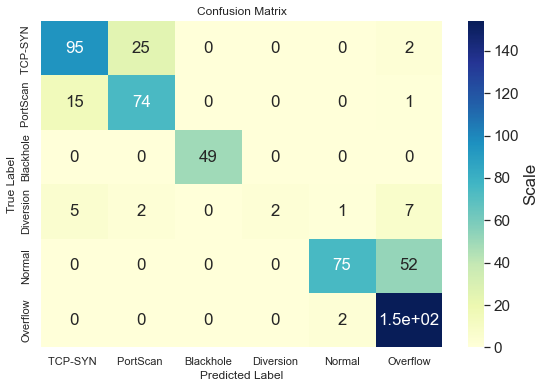

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7949599027633667
Min_training_accuracy:  0.7583047151565552
Avg_training_accuracy:  0.7805269122123718
----------------------------------------------
Max_testing_accuracy:  0.8039215803146362
Min_testing_accuracy:  0.7700534462928772
Avg_testing_accuracy:  0.7885918021202087
----------------------------------------------
Max_Valadation_accuracy:  0.8021390438079834
Min_Valadation_accuracy:  0.7664884328842163
Avg_Valadation_accuracy:  0.7853832483291626


In [ ]:
eightH_30n_train,eightH_30n_test,eightH_30n_val=model_eight_hidden(30)

In [ ]:
clac_min_max_average(eightH_30n_train,eightH_30n_test,eightH_30n_val)

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7949599027633667
Min_training_accuracy:  0.7583047151565552
Avg_training_accuracy:  0.7805269122123718
----------------------------------------------
Max_testing_accuracy:  0.8039215803146362
Min_testing_accuracy:  0.7700534462928772
Avg_testing_accuracy:  0.7885918021202087
----------------------------------------------
Max_Valadation_accuracy:  0.8021390438079834
Min_Valadation_accuracy:  0.7664884328842163
Avg_Valadation_accuracy:  0.7853832483291626


In [ ]:
avg_eightH_30n =  np.average(eightH_30n_test)

#### 8 Hidden Layer with 40 neurones

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.7303 - accuracy: 0.3204 - val_loss: 1.6572 - val_accuracy: 0.3565
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.5318 - accuracy: 0.4124 - val_loss: 1.4084 - val_accuracy: 0.3939
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.2114 - accuracy: 0.4716 - val_loss: 1.0839 - val_accuracy: 0.5401
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9594 - accuracy: 0.6308 - val_loss: 0.8288 - val_accuracy: 0.6578
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7867 - accuracy: 0.6854 - val_loss: 0.7144 - val_accuracy: 0.7094
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7148 - accuracy: 0.7018 - val_loss: 0.6287 - val_accuracy: 0.7433
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6624 - accuracy: 0.7270 - val_loss: 0.6068 - val_accuracy: 0.7504
Epoch 8/500
2

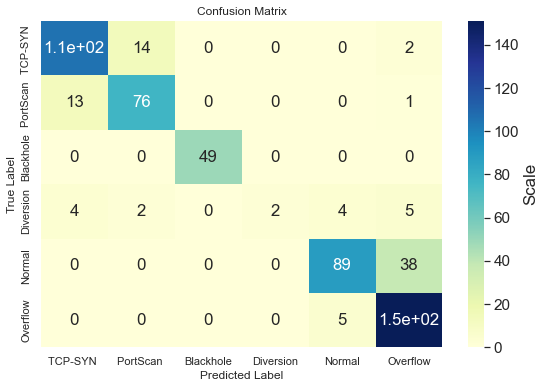

Epoch 1/500
21/21 [==============================] - 1s 6ms/step - loss: 1.7139 - accuracy: 0.2650 - val_loss: 1.5928 - val_accuracy: 0.2852
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.3892 - accuracy: 0.5071 - val_loss: 1.1261 - val_accuracy: 0.4973
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9719 - accuracy: 0.5521 - val_loss: 0.8222 - val_accuracy: 0.6542
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7797 - accuracy: 0.6697 - val_loss: 0.6945 - val_accuracy: 0.6916
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6864 - accuracy: 0.7167 - val_loss: 0.6313 - val_accuracy: 0.7344
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6501 - accuracy: 0.7243 - val_loss: 0.5988 - val_accuracy: 0.7522
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6382 - accuracy: 0.7342 - val_loss: 0.6070 - val_accuracy: 0.7398
Epoch 8/500
2

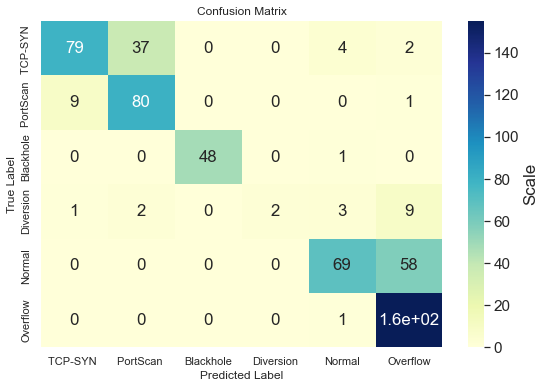

Epoch 1/500
21/21 [==============================] - 1s 6ms/step - loss: 1.7080 - accuracy: 0.2852 - val_loss: 1.5714 - val_accuracy: 0.3387
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.3683 - accuracy: 0.4780 - val_loss: 1.1202 - val_accuracy: 0.5758
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9647 - accuracy: 0.5876 - val_loss: 0.8219 - val_accuracy: 0.6560
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8150 - accuracy: 0.6273 - val_loss: 0.7628 - val_accuracy: 0.6649
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7604 - accuracy: 0.6667 - val_loss: 0.7026 - val_accuracy: 0.6934
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7123 - accuracy: 0.7029 - val_loss: 0.6561 - val_accuracy: 0.7255
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6718 - accuracy: 0.7186 - val_loss: 0.6415 - val_accuracy: 0.7201
Epoch 8/500
2

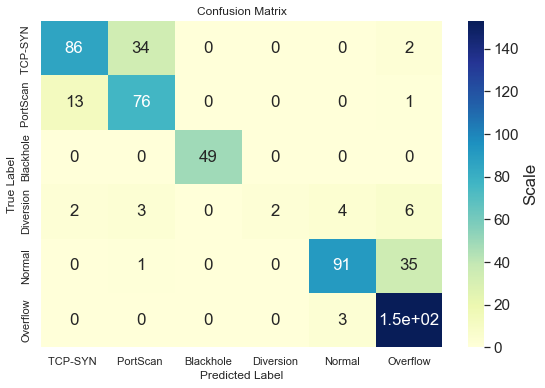

Epoch 1/500
21/21 [==============================] - 1s 6ms/step - loss: 1.7019 - accuracy: 0.3967 - val_loss: 1.5294 - val_accuracy: 0.4920
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.2500 - accuracy: 0.5391 - val_loss: 0.9425 - val_accuracy: 0.5722
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8598 - accuracy: 0.6464 - val_loss: 0.7329 - val_accuracy: 0.6684
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7278 - accuracy: 0.6911 - val_loss: 0.6579 - val_accuracy: 0.7166
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6724 - accuracy: 0.7071 - val_loss: 0.6221 - val_accuracy: 0.7451
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6472 - accuracy: 0.7258 - val_loss: 0.5960 - val_accuracy: 0.7594
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6264 - accuracy: 0.7426 - val_loss: 0.5824 - val_accuracy: 0.7629
Epoch 8/500
2

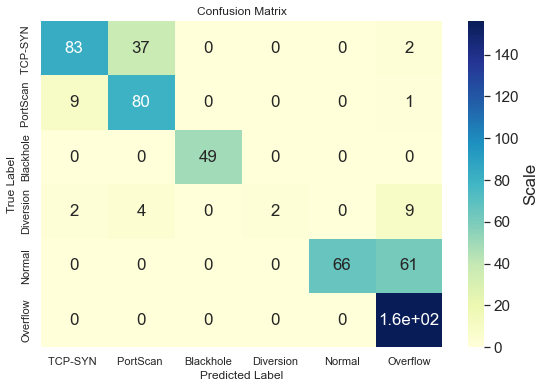

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.6737 - accuracy: 0.3280 - val_loss: 1.4776 - val_accuracy: 0.3351
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.2634 - accuracy: 0.4574 - val_loss: 1.0845 - val_accuracy: 0.5294
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9754 - accuracy: 0.5609 - val_loss: 0.8191 - val_accuracy: 0.6328
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7967 - accuracy: 0.6533 - val_loss: 0.6917 - val_accuracy: 0.7112
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7048 - accuracy: 0.7045 - val_loss: 0.6250 - val_accuracy: 0.7291
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6581 - accuracy: 0.7331 - val_loss: 0.5959 - val_accuracy: 0.7504
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6379 - accuracy: 0.7449 - val_loss: 0.6134 - val_accuracy: 0.7469
Epoch 8/500
2

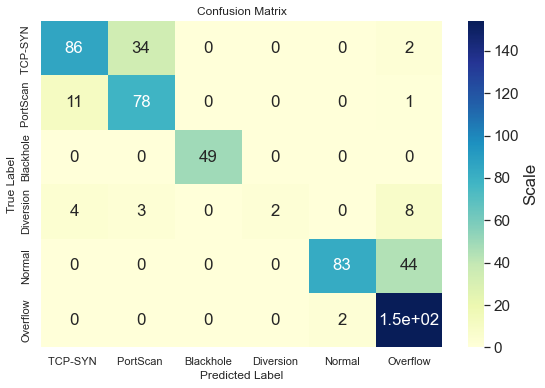

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.8094692826271057
Min_training_accuracy:  0.7655593752861023
Avg_training_accuracy:  0.7893089056015015
----------------------------------------------
Max_testing_accuracy:  0.843137264251709
Min_testing_accuracy:  0.77183598279953
Avg_testing_accuracy:  0.802495539188385
----------------------------------------------
Max_Valadation_accuracy:  0.8235294222831726
Min_Valadation_accuracy:  0.7754010558128357
Avg_Valadation_accuracy:  0.7996434926986694


In [ ]:
eightH_40n_train,eightH_40n_test,eightH_40n_val=model_eight_hidden(40)

In [ ]:
clac_min_max_average(eightH_40n_train,eightH_40n_test,eightH_40n_val)

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.8094692826271057
Min_training_accuracy:  0.7655593752861023
Avg_training_accuracy:  0.7893089056015015
----------------------------------------------
Max_testing_accuracy:  0.843137264251709
Min_testing_accuracy:  0.77183598279953
Avg_testing_accuracy:  0.802495539188385
----------------------------------------------
Max_Valadation_accuracy:  0.8235294222831726
Min_Valadation_accuracy:  0.7754010558128357
Avg_Valadation_accuracy:  0.7996434926986694


In [ ]:
avg_eightH_40n =  np.average(eightH_40n_test)
avg_eightH_40n

0.802495539188385

In [ ]:
eight_hiden_testavg=[avg_eightH_10n,avg_eightH_20n,avg_eightH_30n,avg_eightH_40n]
eight_hiden_testavg

[0.7336898446083069, 0.7682709455490112, 0.7910873413085937, 0.802495539188385]

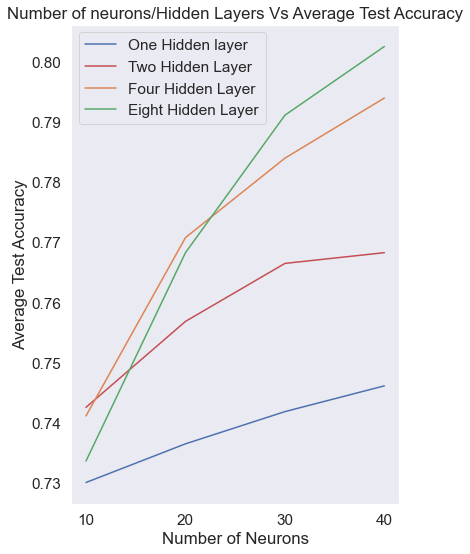

In [ ]:

f=plt.subplot(3,3,i+1)
f.figure.set_size_inches(20,30)
plt.plot([10,20,30,40],one_hiden_testavg)
plt.plot([10,20,30,40],two_hiden_testavg,'r')
plt.plot([10,20,30,40],four_hiden_testavg)
plt.plot([10,20,30,40],eight_hiden_testavg)
plt.legend(['One Hidden layer', 'Two Hidden Layer ','Four Hidden Layer ','Eight Hidden Layer']) 
plt.title("Number of neurons/Hidden Layers Vs Average Test Accuracy")
plt.xlabel("Number of Neurons")
plt.ylabel("Average Test Accuracy")
plt.xticks(ticks=[10,20,30,40])
plt.grid()

# Q3).3 Learning rate and different optimizers

In [ ]:
import tensorflow as tf
def model_best_hidden(optimizer):
    total_train_acc= []
    total_test_acc= []
    total_val_acc=[]
    confusion=[]
    number_of_runs=5
    for i in range(number_of_runs):
        model = keras.models.Sequential()    
        model.add(Dense(40, input_shape = (10,), activation = 'relu'))
        model.add(Dense(40, activation = 'relu'))
        model.add(Dense(40, activation = 'relu'))
        model.add(Dense(40, activation = 'relu'))
        model.add(Dense(40, activation = 'relu'))
        model.add(Dense(40, activation = 'relu'))
        model.add(Dense(40, activation = 'relu'))
        model.add(Dense(40, activation = 'relu'))
        model.add(Dense(6, activation = "softmax"))
        callback = tf.keras.callbacks.EarlyStopping(monitor='loss', patience=5)
        model.compile(optimizer=optimizer, loss="sparse_categorical_crossentropy", metrics = ["accuracy"])
        model.fit(x_train_scaled_anovaa, train_y, epochs=500, batch_size=128, validation_data=(x_val_scaled_anovaa,val_y),callbacks=[callback])
        total_train_acc.append(model.evaluate(x_train_scaled_anovaa, train_y, verbose=0)[1])
        total_test_acc.append(model.evaluate(x_test_scaled_anovaa, test_y, verbose=0)[1])
        total_val_acc.append(model.evaluate(x_val_scaled_anovaa,val_y, verbose=0)[1])

        y_pred = np.argmax(model.predict(x_test_scaled_anovaa), axis=-1)
        data= confusion_matrix(test_y, y_pred)
        confusion.append(data)
        labels =['TCP-SYN ','PortScan ','Blackhole','Diversion','Normal','Overflow']
        plot_confusion_matrix(data,labels)

    # Training acc 
    # Max
    max_training_accuracy = np.amax(total_train_acc)
    # Min 
    min_training_accuracy = np.amin(total_train_acc)
    #Avg
    avg_training_accuracy = np.average(total_train_acc)

    # Testing acc 
    # Max
    max_testing_accuracy =  np.amax(total_test_acc)
    # Min 
    min_testing_accuracy =  np.amin(total_test_acc)
    # Avg
    avg_testing_accuracy =  np.average(total_test_acc)

    # Valadation acc 
    # Max
    max_Valadation_accuracy =  np.amax(total_val_acc)
    # Min 
    min_Valadation_accuracy =  np.amin(total_val_acc)
    # Avg
    avg_Valadation_accuracy =  np.average(total_val_acc)

    print('Min, Max, Avg Accuracies', '\n')
    print('Max_training_accuracy:', max_training_accuracy )
    print('Min_training_accuracy: ', min_training_accuracy)
    print('Avg_training_accuracy: ', avg_training_accuracy)
    print('----------------------------------------------')
    print('Max_testing_accuracy: ', max_testing_accuracy)
    print('Min_testing_accuracy: ', min_testing_accuracy)
    print('Avg_testing_accuracy: ', avg_testing_accuracy)
    print('----------------------------------------------')
    print('Max_Valadation_accuracy: ', max_Valadation_accuracy)
    print('Min_Valadation_accuracy: ', min_Valadation_accuracy)
    print('Avg_Valadation_accuracy: ', avg_Valadation_accuracy)
    
    return total_train_acc,total_test_acc,total_val_acc

### At Learnig Rate 0.1

#### 1 ) - Adamw Optimzier

Epoch 1/500
21/21 [==============================] - 0s 7ms/step - loss: 2.4736 - accuracy: 0.2795 - val_loss: 1.3879 - val_accuracy: 0.3244
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.3690 - accuracy: 0.4360 - val_loss: 1.0466 - val_accuracy: 0.4528
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.1166 - accuracy: 0.4910 - val_loss: 1.0773 - val_accuracy: 0.4421
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9831 - accuracy: 0.4964 - val_loss: 0.8792 - val_accuracy: 0.5276
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8943 - accuracy: 0.5288 - val_loss: 1.0535 - val_accuracy: 0.5080
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9323 - accuracy: 0.5101 - val_loss: 0.8680 - val_accuracy: 0.5134
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8650 - accuracy: 0.5418 - val_loss: 1.0712 - val_accuracy: 0.5080
Epoch 8/500
2

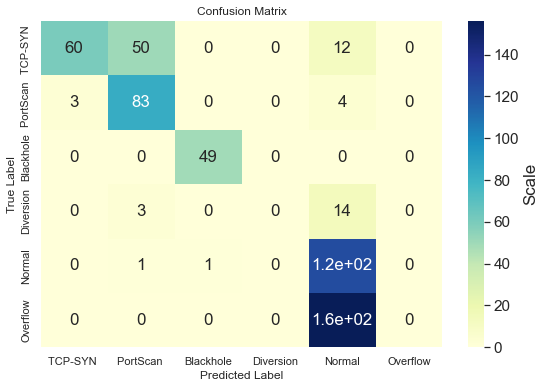

Epoch 1/500
21/21 [==============================] - 1s 7ms/step - loss: 16.4150 - accuracy: 0.1966 - val_loss: 1.8212 - val_accuracy: 0.2513
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6820 - accuracy: 0.2321 - val_loss: 1.6433 - val_accuracy: 0.2513
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6483 - accuracy: 0.2489 - val_loss: 1.6322 - val_accuracy: 0.2513
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6452 - accuracy: 0.2558 - val_loss: 1.6452 - val_accuracy: 0.2193
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6492 - accuracy: 0.2299 - val_loss: 1.6461 - val_accuracy: 0.2513
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6468 - accuracy: 0.2554 - val_loss: 1.6367 - val_accuracy: 0.2193
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6452 - accuracy: 0.2539 - val_loss: 1.6451 - val_accuracy: 0.2193
Epoch 8/500


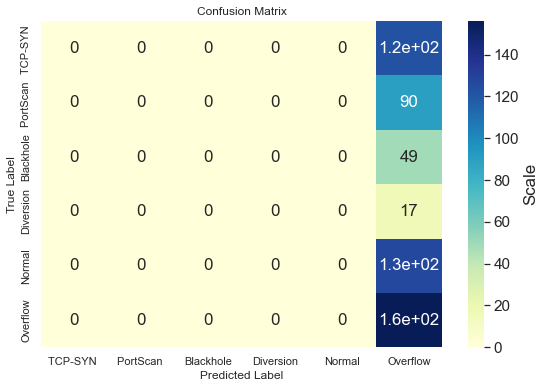

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 76.0935 - accuracy: 0.2108 - val_loss: 1.7826 - val_accuracy: 0.2513
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6834 - accuracy: 0.2574 - val_loss: 1.6534 - val_accuracy: 0.2513
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6517 - accuracy: 0.2344 - val_loss: 1.6348 - val_accuracy: 0.2513
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6456 - accuracy: 0.2486 - val_loss: 1.6338 - val_accuracy: 0.2513
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6485 - accuracy: 0.2554 - val_loss: 1.6404 - val_accuracy: 0.2193
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6461 - accuracy: 0.2489 - val_loss: 1.6413 - val_accuracy: 0.2193
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6457 - accuracy: 0.2535 - val_loss: 1.6369 - val_accuracy: 0.2513
Epoch 8/500


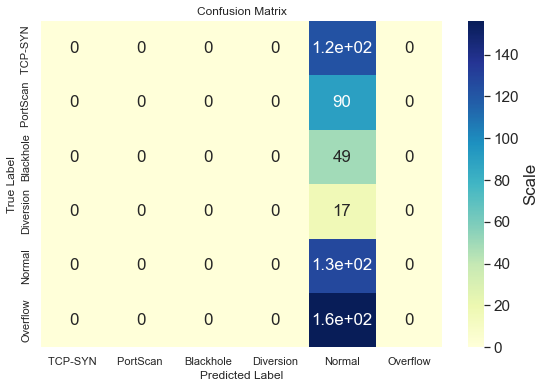

Epoch 1/500
21/21 [==============================] - 0s 7ms/step - loss: 255.9482 - accuracy: 0.2287 - val_loss: 1.7279 - val_accuracy: 0.2193
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 2.4897 - accuracy: 0.2310 - val_loss: 1.6905 - val_accuracy: 0.2513
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6575 - accuracy: 0.2444 - val_loss: 1.6342 - val_accuracy: 0.2513
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6506 - accuracy: 0.2467 - val_loss: 1.6357 - val_accuracy: 0.2193
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6469 - accuracy: 0.2512 - val_loss: 1.6412 - val_accuracy: 0.2193
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6447 - accuracy: 0.2631 - val_loss: 1.6334 - val_accuracy: 0.2513
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6445 - accuracy: 0.2616 - val_loss: 1.6507 - val_accuracy: 0.2193
Epoch 8/500

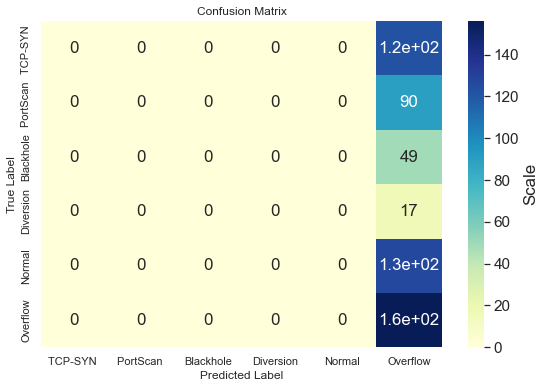

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 889.1063 - accuracy: 0.1959 - val_loss: 2.1646 - val_accuracy: 0.2193
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 16.6717 - accuracy: 0.2146 - val_loss: 1.7382 - val_accuracy: 0.2513
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7371 - accuracy: 0.2195 - val_loss: 1.6322 - val_accuracy: 0.2549
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7115 - accuracy: 0.2302 - val_loss: 1.6437 - val_accuracy: 0.2513
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6575 - accuracy: 0.2547 - val_loss: 1.7265 - val_accuracy: 0.2193
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6697 - accuracy: 0.2291 - val_loss: 1.6666 - val_accuracy: 0.2193
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6554 - accuracy: 0.2447 - val_loss: 1.6330 - val_accuracy: 0.2513
Epoch 8/50

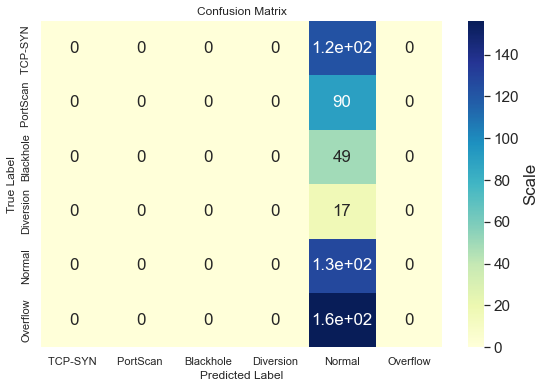

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.5841924548149109
Min_training_accuracy:  0.24856816232204437
Avg_training_accuracy:  0.31798396706581117
----------------------------------------------
Max_testing_accuracy:  0.565062403678894
Min_testing_accuracy:  0.22638146579265594
Avg_testing_accuracy:  0.3147950112819672
----------------------------------------------
Max_Valadation_accuracy:  0.6060606241226196
Min_Valadation_accuracy:  0.2192513346672058
Avg_Valadation_accuracy:  0.3094474196434021


In [ ]:
optimizer=tfaAdamw.optimizers.AdamW(learning_rate= 0.1, weight_decay= 0.001)
L01_Adam_train,L01_Adam_test,L01_Adam__val=model_best_hidden(optimizer)

In [ ]:
clac_min_max_average(L01_Adam_train,L01_Adam_test,L01_Adam__val)

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.5841924548149109
Min_training_accuracy:  0.24856816232204437
Avg_training_accuracy:  0.31798396706581117
----------------------------------------------
Max_testing_accuracy:  0.565062403678894
Min_testing_accuracy:  0.22638146579265594
Avg_testing_accuracy:  0.3147950112819672
----------------------------------------------
Max_Valadation_accuracy:  0.6060606241226196
Min_Valadation_accuracy:  0.2192513346672058
Avg_Valadation_accuracy:  0.3094474196434021


#### 2 ) - SGD (momentum =0.1)

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.6211 - accuracy: 0.3494 - val_loss: 1.4593 - val_accuracy: 0.3868
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.3062 - accuracy: 0.4681 - val_loss: 1.1740 - val_accuracy: 0.5027
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.0594 - accuracy: 0.5288 - val_loss: 1.7557 - val_accuracy: 0.2799
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9996 - accuracy: 0.5304 - val_loss: 0.8307 - val_accuracy: 0.5882
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8711 - accuracy: 0.5823 - val_loss: 0.8185 - val_accuracy: 0.6542
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8327 - accuracy: 0.6105 - val_loss: 0.9080 - val_accuracy: 0.6702
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7973 - accuracy: 0.6220 - val_loss: 0.7046 - val_accuracy: 0.6328
Epoch 8/500
2

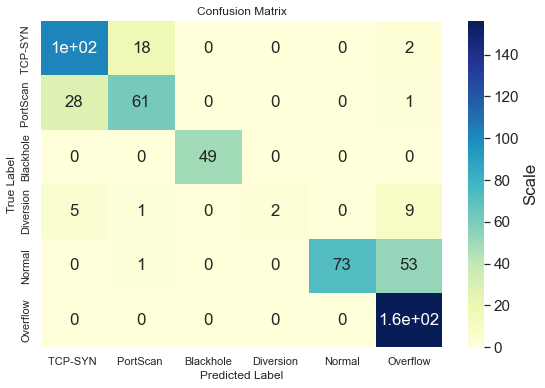

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.7347 - accuracy: 0.2489 - val_loss: 1.6723 - val_accuracy: 0.2496
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6234 - accuracy: 0.2688 - val_loss: 1.5566 - val_accuracy: 0.3458
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.4081 - accuracy: 0.4490 - val_loss: 1.2050 - val_accuracy: 0.5365
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.0513 - accuracy: 0.5494 - val_loss: 0.9660 - val_accuracy: 0.5134
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9026 - accuracy: 0.5758 - val_loss: 0.8848 - val_accuracy: 0.5258
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9031 - accuracy: 0.5842 - val_loss: 0.9255 - val_accuracy: 0.5348
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8406 - accuracy: 0.6044 - val_loss: 0.8017 - val_accuracy: 0.6399
Epoch 8/500
2

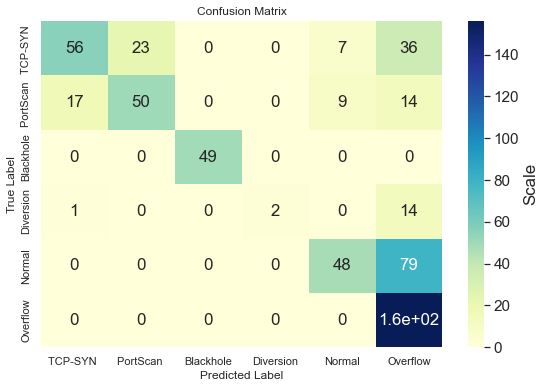

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.6945 - accuracy: 0.2833 - val_loss: 1.5986 - val_accuracy: 0.2977
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.4532 - accuracy: 0.3639 - val_loss: 1.3876 - val_accuracy: 0.3619
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.2672 - accuracy: 0.4192 - val_loss: 1.1872 - val_accuracy: 0.5205
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.0853 - accuracy: 0.5483 - val_loss: 0.9688 - val_accuracy: 0.6078
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9153 - accuracy: 0.5861 - val_loss: 0.9240 - val_accuracy: 0.5508
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8315 - accuracy: 0.6159 - val_loss: 0.7538 - val_accuracy: 0.6684
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8165 - accuracy: 0.6525 - val_loss: 0.7279 - val_accuracy: 0.7148
Epoch 8/500
2

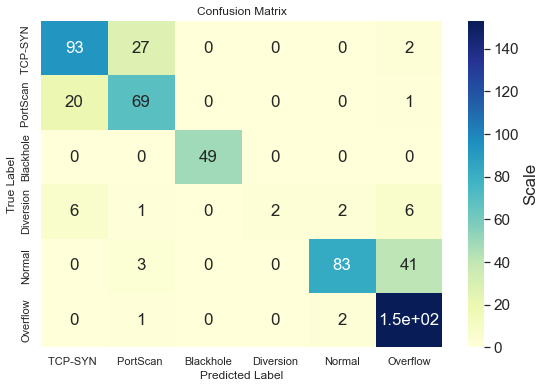

Epoch 1/500
21/21 [==============================] - 0s 7ms/step - loss: 1.7356 - accuracy: 0.3135 - val_loss: 1.6805 - val_accuracy: 0.2763
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6137 - accuracy: 0.3776 - val_loss: 1.5131 - val_accuracy: 0.5561
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.3243 - accuracy: 0.5437 - val_loss: 1.1289 - val_accuracy: 0.5597
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9813 - accuracy: 0.5895 - val_loss: 0.8294 - val_accuracy: 0.6310
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9457 - accuracy: 0.5628 - val_loss: 0.8893 - val_accuracy: 0.5651
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8539 - accuracy: 0.5983 - val_loss: 0.7518 - val_accuracy: 0.6524
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8135 - accuracy: 0.6476 - val_loss: 1.2197 - val_accuracy: 0.5009
Epoch 8/500
2

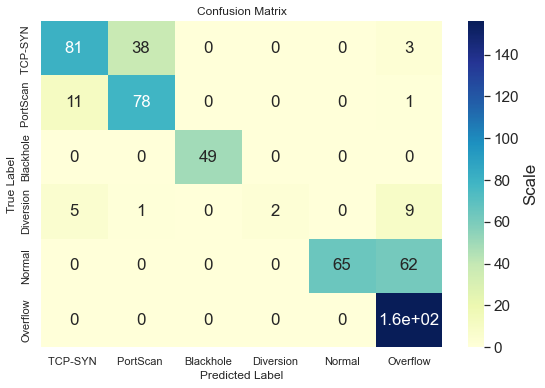

Epoch 1/500
21/21 [==============================] - 1s 7ms/step - loss: 1.6880 - accuracy: 0.3024 - val_loss: 1.5558 - val_accuracy: 0.3993
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3610 - accuracy: 0.4601 - val_loss: 1.1602 - val_accuracy: 0.5027
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.0283 - accuracy: 0.5166 - val_loss: 0.8851 - val_accuracy: 0.6185
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8978 - accuracy: 0.5827 - val_loss: 0.8678 - val_accuracy: 0.5455
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8571 - accuracy: 0.5983 - val_loss: 0.8785 - val_accuracy: 0.5847
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8388 - accuracy: 0.6182 - val_loss: 0.7783 - val_accuracy: 0.6239
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7995 - accuracy: 0.6476 - val_loss: 0.7292 - val_accuracy: 0.6809
Epoch 8/500
2

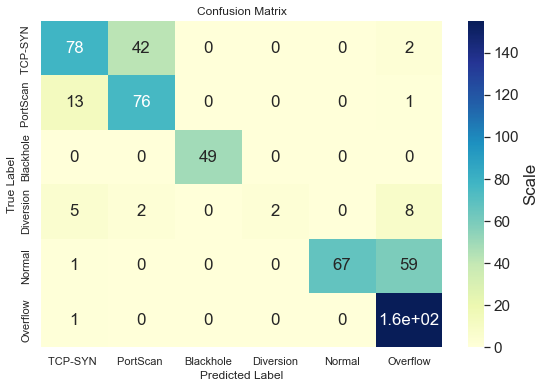

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7896143794059753
Min_training_accuracy:  0.6338297128677368
Avg_training_accuracy:  0.7380679726600647
----------------------------------------------
Max_testing_accuracy:  0.8003565073013306
Min_testing_accuracy:  0.6434937715530396
Avg_testing_accuracy:  0.7525846838951111
----------------------------------------------
Max_Valadation_accuracy:  0.7950088977813721
Min_Valadation_accuracy:  0.6417112350463867
Avg_Valadation_accuracy:  0.7447415351867676


In [ ]:
optimizer = tf.keras.optimizers.SGD(learning_rate=0.1, momentum=0.1)
L01_SGD01_train,L01_SGD01_test,L01_SGD01_val=model_best_hidden(optimizer)

In [ ]:
clac_min_max_average(L01_SGD01_train,L01_SGD01_test,L01_SGD01_val)

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7896143794059753
Min_training_accuracy:  0.6338297128677368
Avg_training_accuracy:  0.7380679726600647
----------------------------------------------
Max_testing_accuracy:  0.8003565073013306
Min_testing_accuracy:  0.6434937715530396
Avg_testing_accuracy:  0.7525846838951111
----------------------------------------------
Max_Valadation_accuracy:  0.7950088977813721
Min_Valadation_accuracy:  0.6417112350463867
Avg_Valadation_accuracy:  0.7447415351867676


#### 3 ) - SGD (momentum =0.5)

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.6994 - accuracy: 0.2871 - val_loss: 1.5911 - val_accuracy: 0.4332
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.4345 - accuracy: 0.4208 - val_loss: 1.3460 - val_accuracy: 0.3565
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.2660 - accuracy: 0.4807 - val_loss: 1.1437 - val_accuracy: 0.5900
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.0618 - accuracy: 0.5613 - val_loss: 0.8669 - val_accuracy: 0.5811
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8523 - accuracy: 0.6208 - val_loss: 0.7760 - val_accuracy: 0.6649
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7210 - accuracy: 0.6922 - val_loss: 0.8194 - val_accuracy: 0.5989
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7082 - accuracy: 0.6922 - val_loss: 0.7687 - val_accuracy: 0.6096
Epoch 8/500
2

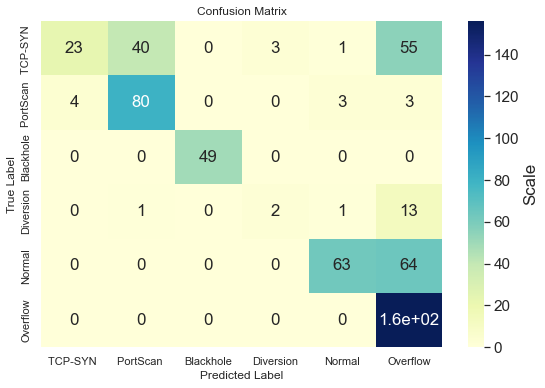

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.6812 - accuracy: 0.2482 - val_loss: 1.5924 - val_accuracy: 0.2210
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.3808 - accuracy: 0.3925 - val_loss: 1.0983 - val_accuracy: 0.4991
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9692 - accuracy: 0.5521 - val_loss: 0.9272 - val_accuracy: 0.6168
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8838 - accuracy: 0.5945 - val_loss: 0.7454 - val_accuracy: 0.6578
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8127 - accuracy: 0.6434 - val_loss: 0.6929 - val_accuracy: 0.7041
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8419 - accuracy: 0.6396 - val_loss: 0.8676 - val_accuracy: 0.5722
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7563 - accuracy: 0.6609 - val_loss: 0.6570 - val_accuracy: 0.7077
Epoch 8/500
2

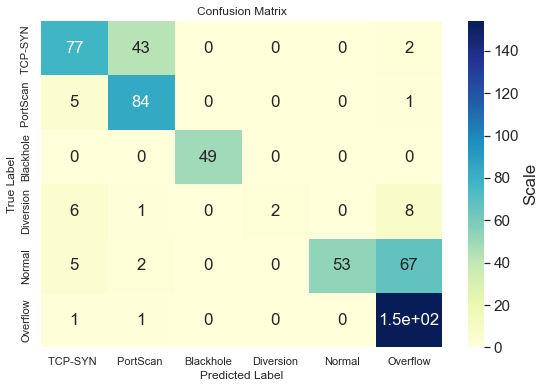

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.6913 - accuracy: 0.2551 - val_loss: 1.5761 - val_accuracy: 0.2513
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.3011 - accuracy: 0.4273 - val_loss: 0.9153 - val_accuracy: 0.5508
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9990 - accuracy: 0.5158 - val_loss: 0.8994 - val_accuracy: 0.4831
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8712 - accuracy: 0.5475 - val_loss: 0.8518 - val_accuracy: 0.6043
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8445 - accuracy: 0.5960 - val_loss: 0.8506 - val_accuracy: 0.6025
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7865 - accuracy: 0.6250 - val_loss: 0.7758 - val_accuracy: 0.6435
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6968 - accuracy: 0.6900 - val_loss: 0.6216 - val_accuracy: 0.7344
Epoch 8/500
2

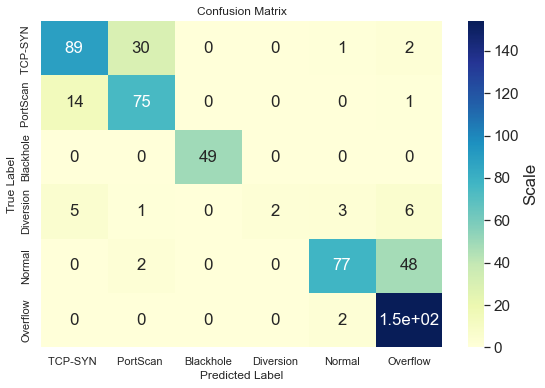

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.5701 - accuracy: 0.3730 - val_loss: 1.3745 - val_accuracy: 0.4528
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.1759 - accuracy: 0.5036 - val_loss: 0.9115 - val_accuracy: 0.5918
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8844 - accuracy: 0.5762 - val_loss: 0.8364 - val_accuracy: 0.5740
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9434 - accuracy: 0.5418 - val_loss: 0.8172 - val_accuracy: 0.6078
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7803 - accuracy: 0.6380 - val_loss: 0.7427 - val_accuracy: 0.6863
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7228 - accuracy: 0.6991 - val_loss: 0.6934 - val_accuracy: 0.7041
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7331 - accuracy: 0.6789 - val_loss: 0.6668 - val_accuracy: 0.7219
Epoch 8/500
2

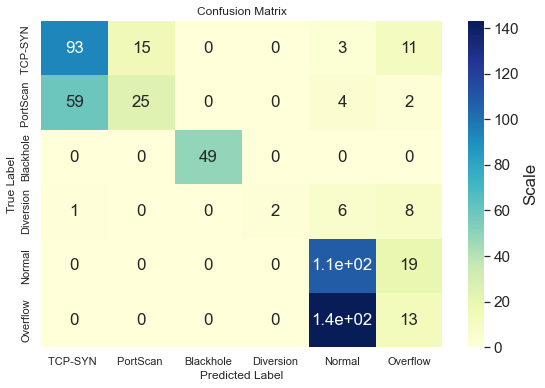

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.6667 - accuracy: 0.3234 - val_loss: 1.4797 - val_accuracy: 0.3761
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.3445 - accuracy: 0.4948 - val_loss: 1.2129 - val_accuracy: 0.5936
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9825 - accuracy: 0.6170 - val_loss: 0.7892 - val_accuracy: 0.6649
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8856 - accuracy: 0.5972 - val_loss: 0.9780 - val_accuracy: 0.5098
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8841 - accuracy: 0.5731 - val_loss: 0.8124 - val_accuracy: 0.5490
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7993 - accuracy: 0.6338 - val_loss: 0.7309 - val_accuracy: 0.5989
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7365 - accuracy: 0.6606 - val_loss: 0.7149 - val_accuracy: 0.6667
Epoch 8/500
2

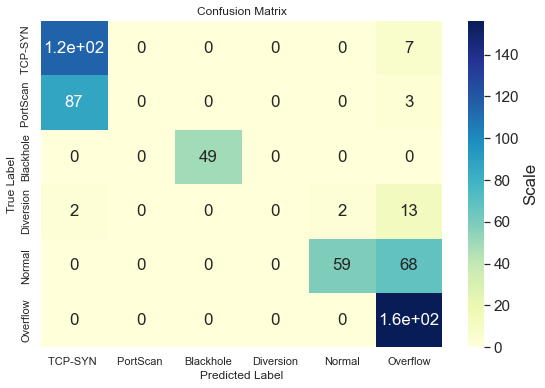

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7804505825042725
Min_training_accuracy:  0.5662466883659363
Avg_training_accuracy:  0.6743031859397888
----------------------------------------------
Max_testing_accuracy:  0.7950088977813721
Min_testing_accuracy:  0.5169340372085571
Avg_testing_accuracy:  0.6798573970794678
----------------------------------------------
Max_Valadation_accuracy:  0.7932263612747192
Min_Valadation_accuracy:  0.5739750266075134
Avg_Valadation_accuracy:  0.6816399216651916


In [ ]:
optimizer = tf.keras.optimizers.SGD(learning_rate=0.1, momentum=0.5)
L01_SGD05_train,L01_SGD05_test,L01_SGD05n_val=model_best_hidden(optimizer)

In [ ]:
clac_min_max_average(L01_SGD05_train,L01_SGD05_test,L01_SGD05n_val)

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7804505825042725
Min_training_accuracy:  0.5662466883659363
Avg_training_accuracy:  0.6743031859397888
----------------------------------------------
Max_testing_accuracy:  0.7950088977813721
Min_testing_accuracy:  0.5169340372085571
Avg_testing_accuracy:  0.6798573970794678
----------------------------------------------
Max_Valadation_accuracy:  0.7932263612747192
Min_Valadation_accuracy:  0.5739750266075134
Avg_Valadation_accuracy:  0.6816399216651916


#### 4 ) - SGD (momentum =0.9)

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.4715 - accuracy: 0.3662 - val_loss: 1.0619 - val_accuracy: 0.5722
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.2423 - accuracy: 0.4738 - val_loss: 0.9195 - val_accuracy: 0.5223
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8773 - accuracy: 0.5662 - val_loss: 0.8567 - val_accuracy: 0.5704
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8980 - accuracy: 0.5598 - val_loss: 0.8096 - val_accuracy: 0.6203
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8036 - accuracy: 0.6331 - val_loss: 0.7367 - val_accuracy: 0.5971
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7202 - accuracy: 0.6739 - val_loss: 0.6821 - val_accuracy: 0.6791
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6883 - accuracy: 0.6846 - val_loss: 0.6724 - val_accuracy: 0.6916
Epoch 8/500
2

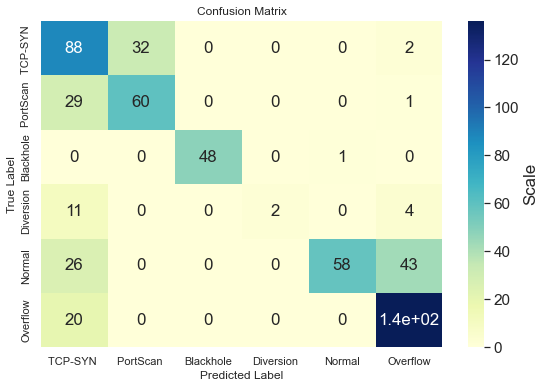

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.5225 - accuracy: 0.3204 - val_loss: 1.0438 - val_accuracy: 0.5490
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9686 - accuracy: 0.5506 - val_loss: 0.8897 - val_accuracy: 0.5740
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8969 - accuracy: 0.5666 - val_loss: 0.7585 - val_accuracy: 0.6649
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7684 - accuracy: 0.6411 - val_loss: 1.2692 - val_accuracy: 0.5080
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8378 - accuracy: 0.6365 - val_loss: 0.7662 - val_accuracy: 0.6649
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7557 - accuracy: 0.6445 - val_loss: 0.6700 - val_accuracy: 0.6863
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7046 - accuracy: 0.6770 - val_loss: 0.6398 - val_accuracy: 0.7219
Epoch 8/500
2

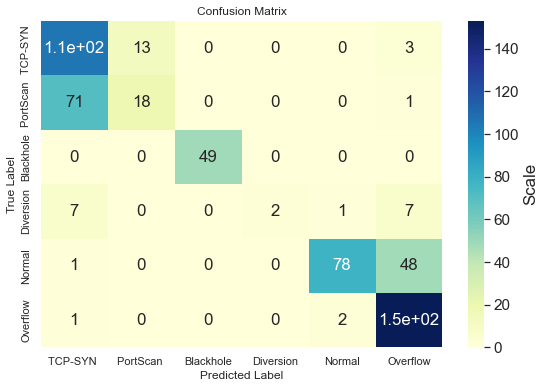

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.5789 - accuracy: 0.3116 - val_loss: 1.1672 - val_accuracy: 0.4260
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.0063 - accuracy: 0.5227 - val_loss: 0.8328 - val_accuracy: 0.5526
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8736 - accuracy: 0.5888 - val_loss: 0.8043 - val_accuracy: 0.6399
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7799 - accuracy: 0.6334 - val_loss: 0.7294 - val_accuracy: 0.5793
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7129 - accuracy: 0.6732 - val_loss: 0.6887 - val_accuracy: 0.6595
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7360 - accuracy: 0.7026 - val_loss: 0.6008 - val_accuracy: 0.7291
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7110 - accuracy: 0.6926 - val_loss: 0.8501 - val_accuracy: 0.5561
Epoch 8/500
2

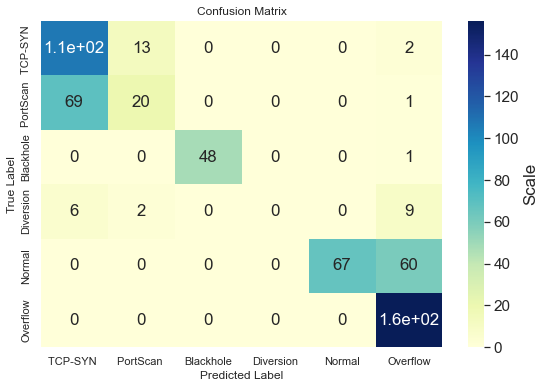

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.4729 - accuracy: 0.3501 - val_loss: 1.0922 - val_accuracy: 0.4848
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9403 - accuracy: 0.5682 - val_loss: 0.9426 - val_accuracy: 0.5615
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8569 - accuracy: 0.6018 - val_loss: 0.7520 - val_accuracy: 0.6542
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7160 - accuracy: 0.6892 - val_loss: 0.7359 - val_accuracy: 0.6774
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6924 - accuracy: 0.6907 - val_loss: 0.6297 - val_accuracy: 0.7237
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6224 - accuracy: 0.7404 - val_loss: 0.5565 - val_accuracy: 0.7504
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.5997 - accuracy: 0.7480 - val_loss: 0.5685 - val_accuracy: 0.7754
Epoch 8/500
2

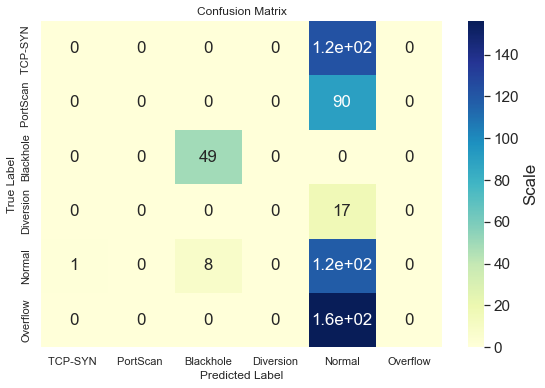

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.5702 - accuracy: 0.3039 - val_loss: 1.1516 - val_accuracy: 0.5009
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.0812 - accuracy: 0.4933 - val_loss: 1.1394 - val_accuracy: 0.5365
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.0426 - accuracy: 0.5269 - val_loss: 0.7963 - val_accuracy: 0.5597
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8244 - accuracy: 0.5934 - val_loss: 0.7802 - val_accuracy: 0.6845
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8710 - accuracy: 0.6518 - val_loss: 1.0262 - val_accuracy: 0.5954
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 1.0393 - accuracy: 0.5410 - val_loss: 1.0844 - val_accuracy: 0.5330
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8683 - accuracy: 0.6014 - val_loss: 0.8536 - val_accuracy: 0.6881
Epoch 8/500
2

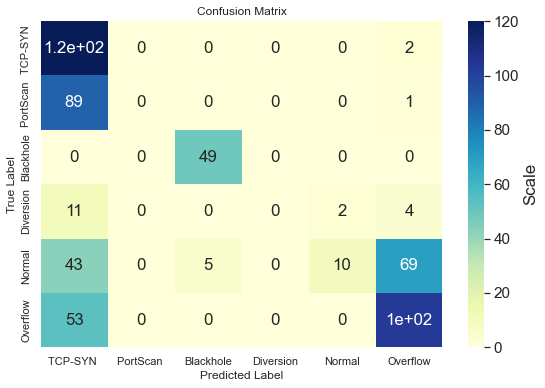

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7109583616256714
Min_training_accuracy:  0.34364262223243713
Avg_training_accuracy:  0.5893852591514588
----------------------------------------------
Max_testing_accuracy:  0.7237076759338379
Min_testing_accuracy:  0.2976827025413513
Avg_testing_accuracy:  0.5864527702331543
----------------------------------------------
Max_Valadation_accuracy:  0.7326202988624573
Min_Valadation_accuracy:  0.32976827025413513
Avg_Valadation_accuracy:  0.5982174694538116


In [ ]:
optimizer = tf.keras.optimizers.SGD(learning_rate=0.1, momentum=0.9)
L01_SGD09_train,L01_SGD09_test,L01_SGD09_val=model_best_hidden(optimizer)

In [ ]:
clac_min_max_average(L01_SGD09_train,L01_SGD09_test,L01_SGD09_val)

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7109583616256714
Min_training_accuracy:  0.34364262223243713
Avg_training_accuracy:  0.5893852591514588
----------------------------------------------
Max_testing_accuracy:  0.7237076759338379
Min_testing_accuracy:  0.2976827025413513
Avg_testing_accuracy:  0.5864527702331543
----------------------------------------------
Max_Valadation_accuracy:  0.7326202988624573
Min_Valadation_accuracy:  0.32976827025413513
Avg_Valadation_accuracy:  0.5982174694538116


#### 5 ) - Rprop

Epoch 1/500
21/21 [==============================] - 1s 6ms/step - loss: 4167.3154 - accuracy: 0.2081 - val_loss: 1.6368 - val_accuracy: 0.2549
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6564 - accuracy: 0.2425 - val_loss: 1.7139 - val_accuracy: 0.2193
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6553 - accuracy: 0.2577 - val_loss: 1.6501 - val_accuracy: 0.2549
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6525 - accuracy: 0.2512 - val_loss: 1.6380 - val_accuracy: 0.2549
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6605 - accuracy: 0.2341 - val_loss: 1.7427 - val_accuracy: 0.2193
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6561 - accuracy: 0.2444 - val_loss: 1.6569 - val_accuracy: 0.2549
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6561 - accuracy: 0.2447 - val_loss: 1.6390 - val_accuracy: 0.2549
Epoch 8/50

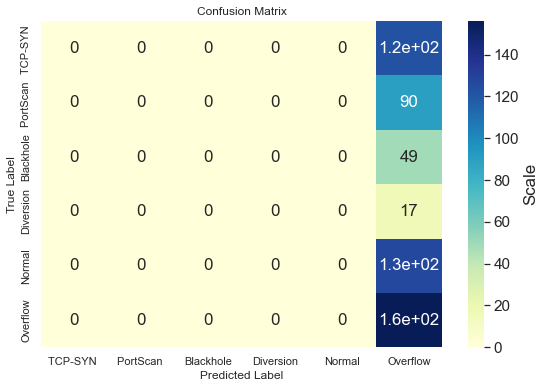

Epoch 1/500
21/21 [==============================] - 1s 6ms/step - loss: 957.5063 - accuracy: 0.2356 - val_loss: 1.6332 - val_accuracy: 0.2193
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6261 - accuracy: 0.2558 - val_loss: 1.6253 - val_accuracy: 0.2228
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6198 - accuracy: 0.2543 - val_loss: 1.6271 - val_accuracy: 0.2228
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6240 - accuracy: 0.2554 - val_loss: 1.6446 - val_accuracy: 0.2549
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6231 - accuracy: 0.2554 - val_loss: 1.6364 - val_accuracy: 0.2549
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6244 - accuracy: 0.2539 - val_loss: 1.6330 - val_accuracy: 0.2228
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6210 - accuracy: 0.2585 - val_loss: 1.6280 - val_accuracy: 0.2228
Epoch 8/500

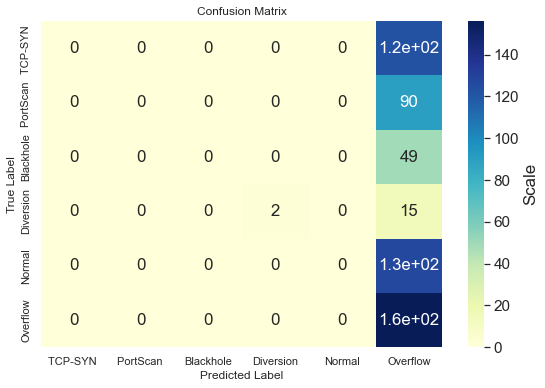

Epoch 1/500
21/21 [==============================] - 1s 6ms/step - loss: 789.8322 - accuracy: 0.2745 - val_loss: 1.3640 - val_accuracy: 0.3922
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.4111 - accuracy: 0.3918 - val_loss: 1.4176 - val_accuracy: 0.3654
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.3252 - accuracy: 0.4093 - val_loss: 1.5304 - val_accuracy: 0.3583
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6038 - accuracy: 0.4154 - val_loss: 1.3985 - val_accuracy: 0.3030
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7761 - accuracy: 0.3150 - val_loss: 1.3894 - val_accuracy: 0.3280
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 1.3765 - accuracy: 0.3375 - val_loss: 1.5979 - val_accuracy: 0.2816
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 1.3493 - accuracy: 0.3410 - val_loss: 1.8171 - val_accuracy: 0.2513
Epoch 8/500

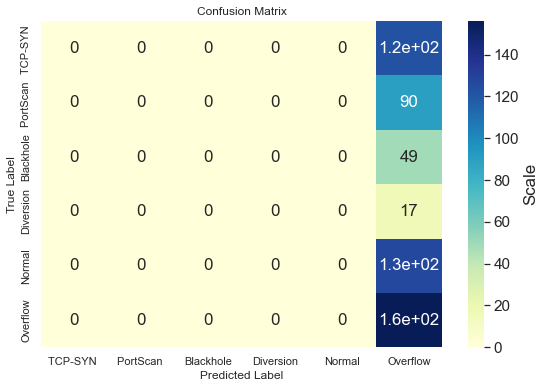

Epoch 1/500
21/21 [==============================] - 1s 6ms/step - loss: 847.0662 - accuracy: 0.2089 - val_loss: 1.6565 - val_accuracy: 0.2567
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6535 - accuracy: 0.2379 - val_loss: 1.6760 - val_accuracy: 0.2567
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6320 - accuracy: 0.2703 - val_loss: 1.5866 - val_accuracy: 0.2923
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6250 - accuracy: 0.2631 - val_loss: 1.6039 - val_accuracy: 0.2923
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6290 - accuracy: 0.2566 - val_loss: 1.6159 - val_accuracy: 0.2567
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 2.1690 - accuracy: 0.2459 - val_loss: 1.6380 - val_accuracy: 0.2513
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6497 - accuracy: 0.2467 - val_loss: 1.6447 - val_accuracy: 0.2513
Epoch 8/500

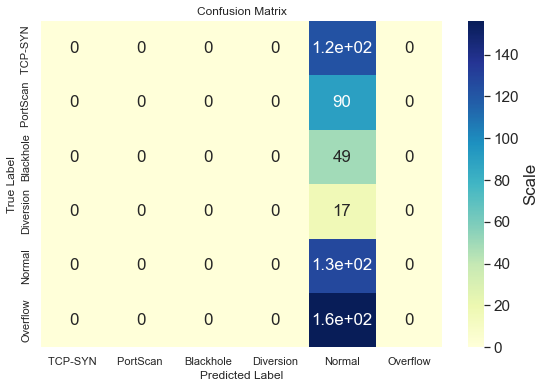

Epoch 1/500
21/21 [==============================] - 1s 6ms/step - loss: 631.5759 - accuracy: 0.2367 - val_loss: 2.0992 - val_accuracy: 0.2513
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.8587 - accuracy: 0.2932 - val_loss: 1.2902 - val_accuracy: 0.4207
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.4478 - accuracy: 0.3620 - val_loss: 1.2897 - val_accuracy: 0.4260
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.5772 - accuracy: 0.3547 - val_loss: 1.1733 - val_accuracy: 0.4581
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.3036 - accuracy: 0.4101 - val_loss: 1.1379 - val_accuracy: 0.4528
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 1.5569 - accuracy: 0.3868 - val_loss: 1.2004 - val_accuracy: 0.4581
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 2.0140 - accuracy: 0.3013 - val_loss: 1.6406 - val_accuracy: 0.2513
Epoch 8/500

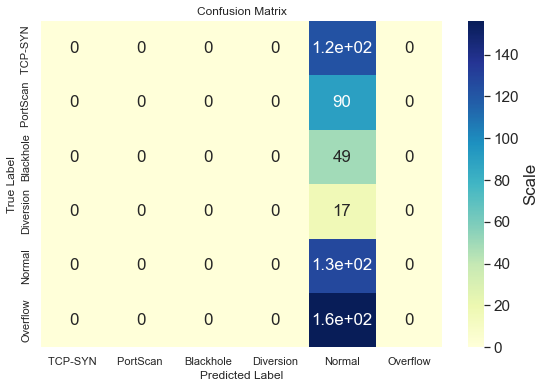

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.25544100999832153
Min_training_accuracy:  0.24856816232204437
Avg_training_accuracy:  0.2522336781024933
----------------------------------------------
Max_testing_accuracy:  0.2816399335861206
Min_testing_accuracy:  0.22638146579265594
Avg_testing_accuracy:  0.2581105172634125
----------------------------------------------
Max_Valadation_accuracy:  0.2513369023799896
Min_Valadation_accuracy:  0.2192513346672058
Avg_Valadation_accuracy:  0.23279857337474824


In [ ]:
optimizer = tf.keras.optimizers.RMSprop(learning_rate=0.1)
L01_Rprop_train,L01_Rprop_test,L01_Rprop_val=model_best_hidden(optimizer)

In [ ]:
clac_min_max_average(L01_Rprop_train,L01_Rprop_test,L01_Rprop_val)

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.25544100999832153
Min_training_accuracy:  0.24856816232204437
Avg_training_accuracy:  0.2522336781024933
----------------------------------------------
Max_testing_accuracy:  0.2816399335861206
Min_testing_accuracy:  0.22638146579265594
Avg_testing_accuracy:  0.2581105172634125
----------------------------------------------
Max_Valadation_accuracy:  0.2513369023799896
Min_Valadation_accuracy:  0.2192513346672058
Avg_Valadation_accuracy:  0.23279857337474824


In [ ]:
for i in range(number_of_runs):
    f=plt.subplot(3,3,i+1)
    f.figure.set_size_inches(20,30)
    plt.plot(L01_Adam_test[i])
    plt.plot(L01_SGD01_test[i],'r')
    plt.plot(L01_SGD05_test[i])
    plt.plot(L01_SGD09_test[i])
    plt.plot(L01_Rprop_test[i])
    plt.legend(['Adam with Learning Rate 0.1 ', 'SGD with Momentum 0.1 and LR=0.1','SGD with Momentum 0.5 and LR=0.1','SGD with Momentum 0.9 and LR=0.1','RMSprop With Learning Rate 0.1']) 
    plt.title("Run number %d"%(i+1))
    plt.xlabel("Number of epochs")
    plt.ylabel("Accuracy")
    plt.grid()

### At Learnig Rate 0.01

#### 1 ) - Adamw Optimzier

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.2237 - accuracy: 0.4937 - val_loss: 0.8075 - val_accuracy: 0.6560
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7413 - accuracy: 0.6842 - val_loss: 0.6900 - val_accuracy: 0.7041
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6799 - accuracy: 0.6945 - val_loss: 0.6460 - val_accuracy: 0.7433
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6433 - accuracy: 0.7320 - val_loss: 0.5540 - val_accuracy: 0.7754
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6089 - accuracy: 0.7369 - val_loss: 0.5725 - val_accuracy: 0.7504
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6123 - accuracy: 0.7205 - val_loss: 0.5573 - val_accuracy: 0.7558
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.5939 - accuracy: 0.7503 - val_loss: 0.5416 - val_accuracy: 0.7629
Epoch 8/500
2

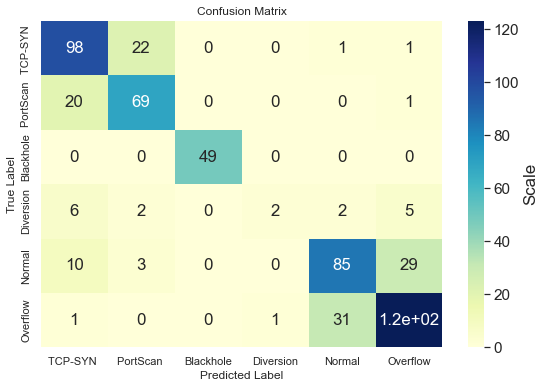

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.3476 - accuracy: 0.4475 - val_loss: 0.8898 - val_accuracy: 0.5668
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8364 - accuracy: 0.5834 - val_loss: 0.7274 - val_accuracy: 0.6649
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7581 - accuracy: 0.6315 - val_loss: 0.7162 - val_accuracy: 0.6471
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7102 - accuracy: 0.6655 - val_loss: 0.6357 - val_accuracy: 0.7023
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6541 - accuracy: 0.6938 - val_loss: 0.6566 - val_accuracy: 0.6916
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6400 - accuracy: 0.7132 - val_loss: 0.6948 - val_accuracy: 0.7273
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6392 - accuracy: 0.7285 - val_loss: 0.5695 - val_accuracy: 0.7647
Epoch 8/500
2

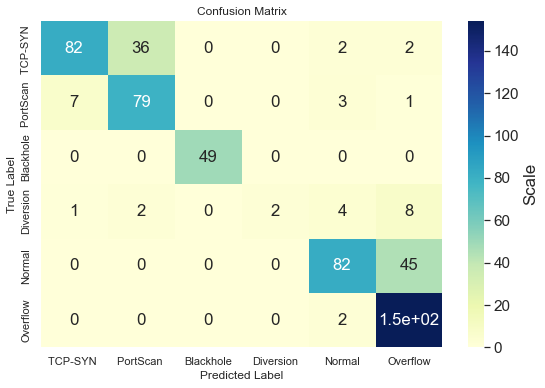

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.6108 - accuracy: 0.3066 - val_loss: 1.4291 - val_accuracy: 0.4955
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.0165 - accuracy: 0.5116 - val_loss: 0.8904 - val_accuracy: 0.5740
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8903 - accuracy: 0.5704 - val_loss: 0.7919 - val_accuracy: 0.5401
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7782 - accuracy: 0.6270 - val_loss: 0.6811 - val_accuracy: 0.6702
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6990 - accuracy: 0.6743 - val_loss: 0.6633 - val_accuracy: 0.6988
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6869 - accuracy: 0.6709 - val_loss: 0.6519 - val_accuracy: 0.6952
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6742 - accuracy: 0.6991 - val_loss: 0.6102 - val_accuracy: 0.7362
Epoch 8/500
2

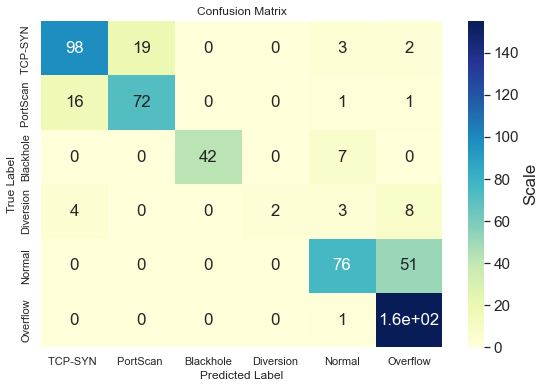

Epoch 1/500
21/21 [==============================] - 1s 7ms/step - loss: 1.2916 - accuracy: 0.4292 - val_loss: 1.4492 - val_accuracy: 0.5312
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9291 - accuracy: 0.5449 - val_loss: 0.8130 - val_accuracy: 0.5294
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8585 - accuracy: 0.5792 - val_loss: 0.7606 - val_accuracy: 0.6970
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7679 - accuracy: 0.6732 - val_loss: 1.0887 - val_accuracy: 0.4884
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8112 - accuracy: 0.6208 - val_loss: 0.7743 - val_accuracy: 0.6684
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7869 - accuracy: 0.6411 - val_loss: 0.6906 - val_accuracy: 0.6756
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7035 - accuracy: 0.6976 - val_loss: 0.6456 - val_accuracy: 0.6863
Epoch 8/500
2

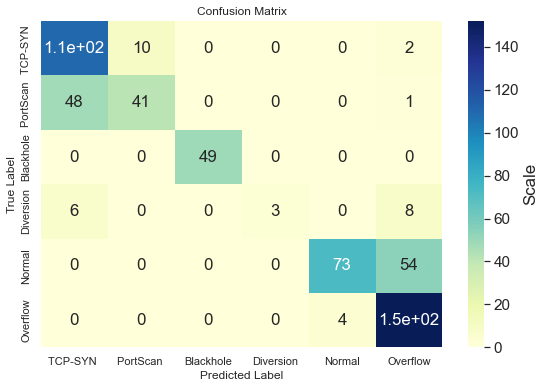

Epoch 1/500
21/21 [==============================] - 0s 7ms/step - loss: 1.4693 - accuracy: 0.3551 - val_loss: 1.0640 - val_accuracy: 0.5045
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9313 - accuracy: 0.5433 - val_loss: 0.7815 - val_accuracy: 0.6114
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7743 - accuracy: 0.6376 - val_loss: 0.6495 - val_accuracy: 0.7094
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6981 - accuracy: 0.7041 - val_loss: 0.6310 - val_accuracy: 0.7041
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6736 - accuracy: 0.7014 - val_loss: 0.6955 - val_accuracy: 0.6898
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6644 - accuracy: 0.7113 - val_loss: 0.6225 - val_accuracy: 0.7540
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6326 - accuracy: 0.7251 - val_loss: 0.6543 - val_accuracy: 0.7112
Epoch 8/500
2

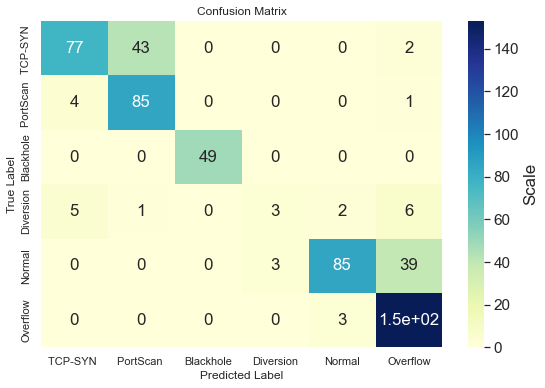

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7899962067604065
Min_training_accuracy:  0.7510499954223633
Avg_training_accuracy:  0.7760977506637573
----------------------------------------------
Max_testing_accuracy:  0.8057041168212891
Min_testing_accuracy:  0.759358286857605
Avg_testing_accuracy:  0.7839572191238403
----------------------------------------------
Max_Valadation_accuracy:  0.7985739707946777
Min_Valadation_accuracy:  0.7647058963775635
Avg_Valadation_accuracy:  0.7832442045211792


In [ ]:
optimizer=tfaAdamw.optimizers.AdamW(learning_rate= 0.01, weight_decay= 0.001)
L001_Adam_train,L001_Adam_test,L001_Adam__val=model_best_hidden(optimizer)

In [ ]:
clac_min_max_average(L001_Adam_train,L001_Adam_test,L001_Adam__val)

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7899962067604065
Min_training_accuracy:  0.7510499954223633
Avg_training_accuracy:  0.7760977506637573
----------------------------------------------
Max_testing_accuracy:  0.8057041168212891
Min_testing_accuracy:  0.759358286857605
Avg_testing_accuracy:  0.7839572191238403
----------------------------------------------
Max_Valadation_accuracy:  0.7985739707946777
Min_Valadation_accuracy:  0.7647058963775635
Avg_Valadation_accuracy:  0.7832442045211792


#### 2 ) - SGD (momentum =0.1)

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.7773 - accuracy: 0.2574 - val_loss: 1.7645 - val_accuracy: 0.2335
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7527 - accuracy: 0.2497 - val_loss: 1.7417 - val_accuracy: 0.2460
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7293 - accuracy: 0.2516 - val_loss: 1.7195 - val_accuracy: 0.2478
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7061 - accuracy: 0.2497 - val_loss: 1.6977 - val_accuracy: 0.2460
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6826 - accuracy: 0.2646 - val_loss: 1.6752 - val_accuracy: 0.2656
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6580 - accuracy: 0.2929 - val_loss: 1.6524 - val_accuracy: 0.2852
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6317 - accuracy: 0.3253 - val_loss: 1.6275 - val_accuracy: 0.3244
Epoch 8/500
2

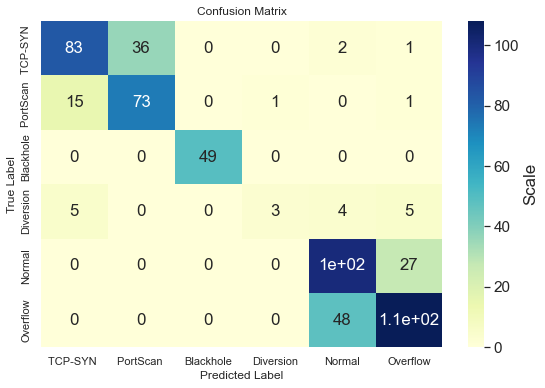

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.7832 - accuracy: 0.2612 - val_loss: 1.7659 - val_accuracy: 0.3547
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7601 - accuracy: 0.3387 - val_loss: 1.7450 - val_accuracy: 0.3743
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7406 - accuracy: 0.3841 - val_loss: 1.7268 - val_accuracy: 0.3761
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7231 - accuracy: 0.3799 - val_loss: 1.7097 - val_accuracy: 0.3565
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7065 - accuracy: 0.3685 - val_loss: 1.6938 - val_accuracy: 0.3601
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6908 - accuracy: 0.3746 - val_loss: 1.6781 - val_accuracy: 0.3797
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6752 - accuracy: 0.3730 - val_loss: 1.6627 - val_accuracy: 0.3422
Epoch 8/500
2

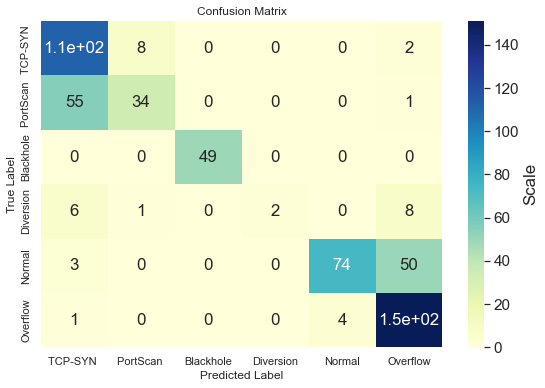

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.7775 - accuracy: 0.3246 - val_loss: 1.7565 - val_accuracy: 0.2799
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7402 - accuracy: 0.2883 - val_loss: 1.7235 - val_accuracy: 0.2674
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7072 - accuracy: 0.2806 - val_loss: 1.6945 - val_accuracy: 0.2549
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6778 - accuracy: 0.2757 - val_loss: 1.6685 - val_accuracy: 0.2585
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6505 - accuracy: 0.2764 - val_loss: 1.6436 - val_accuracy: 0.2656
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6231 - accuracy: 0.2890 - val_loss: 1.6180 - val_accuracy: 0.2727
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 1.5932 - accuracy: 0.2994 - val_loss: 1.5900 - val_accuracy: 0.2816
Epoch 8/500
2

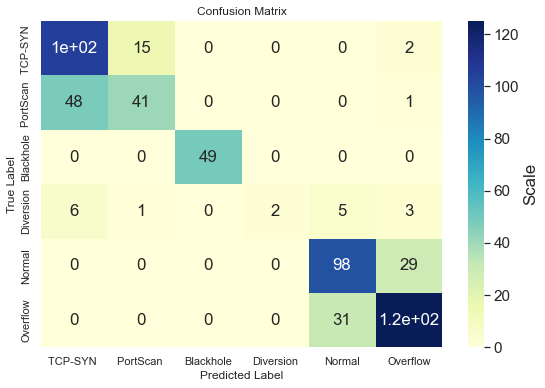

Epoch 1/500
21/21 [==============================] - 1s 6ms/step - loss: 1.7908 - accuracy: 0.1596 - val_loss: 1.7826 - val_accuracy: 0.2941
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7733 - accuracy: 0.2986 - val_loss: 1.7684 - val_accuracy: 0.2674
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7600 - accuracy: 0.2787 - val_loss: 1.7560 - val_accuracy: 0.2549
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7476 - accuracy: 0.2906 - val_loss: 1.7444 - val_accuracy: 0.2923
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7358 - accuracy: 0.3215 - val_loss: 1.7334 - val_accuracy: 0.2870
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7241 - accuracy: 0.3192 - val_loss: 1.7226 - val_accuracy: 0.2870
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7125 - accuracy: 0.3219 - val_loss: 1.7117 - val_accuracy: 0.2995
Epoch 8/500
2

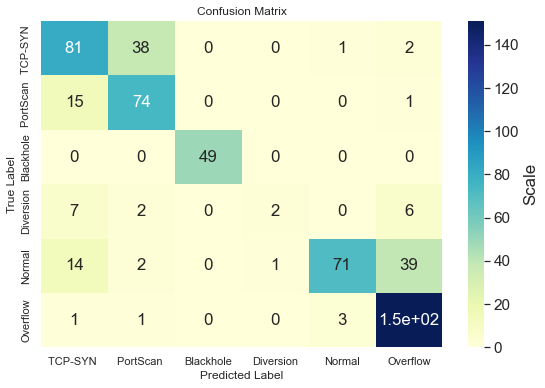

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.7747 - accuracy: 0.2486 - val_loss: 1.7615 - val_accuracy: 0.2193
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7481 - accuracy: 0.2486 - val_loss: 1.7387 - val_accuracy: 0.2193
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7257 - accuracy: 0.2486 - val_loss: 1.7185 - val_accuracy: 0.2193
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7053 - accuracy: 0.2486 - val_loss: 1.6994 - val_accuracy: 0.2193
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6859 - accuracy: 0.2486 - val_loss: 1.6814 - val_accuracy: 0.2193
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6672 - accuracy: 0.2486 - val_loss: 1.6635 - val_accuracy: 0.2193
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6482 - accuracy: 0.2486 - val_loss: 1.6449 - val_accuracy: 0.2193
Epoch 8/500
2

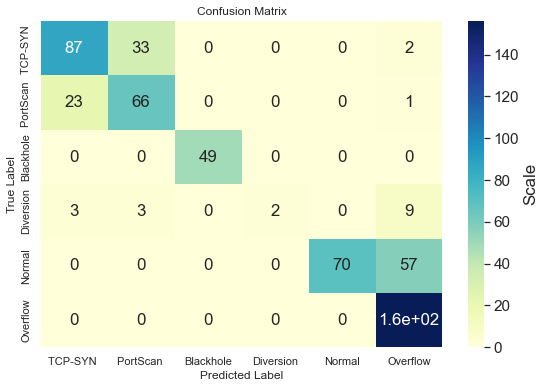

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7701413035392761
Min_training_accuracy:  0.7304314374923706
Avg_training_accuracy:  0.7549446225166321
----------------------------------------------
Max_testing_accuracy:  0.7664884328842163
Min_testing_accuracy:  0.7415329813957214
Avg_testing_accuracy:  0.7543672084808349
----------------------------------------------
Max_Valadation_accuracy:  0.77183598279953
Min_Valadation_accuracy:  0.7308377623558044
Avg_Valadation_accuracy:  0.7575757503509521


In [ ]:
optimizer = tf.keras.optimizers.SGD(learning_rate=0.01, momentum=0.1)
L001_SGD01_train,L001_SGD01_test,L001_SGD01_val=model_best_hidden(optimizer)

In [ ]:
clac_min_max_average(L001_SGD01_train,L001_SGD01_test,L001_SGD01_val)

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7701413035392761
Min_training_accuracy:  0.7304314374923706
Avg_training_accuracy:  0.7549446225166321
----------------------------------------------
Max_testing_accuracy:  0.7664884328842163
Min_testing_accuracy:  0.7415329813957214
Avg_testing_accuracy:  0.7543672084808349
----------------------------------------------
Max_Valadation_accuracy:  0.77183598279953
Min_Valadation_accuracy:  0.7308377623558044
Avg_Valadation_accuracy:  0.7575757503509521


#### 3 ) - SGD (momentum =0.5)

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.7883 - accuracy: 0.2050 - val_loss: 1.7719 - val_accuracy: 0.2086
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7603 - accuracy: 0.2119 - val_loss: 1.7481 - val_accuracy: 0.2193
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7383 - accuracy: 0.2302 - val_loss: 1.7278 - val_accuracy: 0.2282
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7185 - accuracy: 0.2363 - val_loss: 1.7085 - val_accuracy: 0.2406
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6984 - accuracy: 0.2467 - val_loss: 1.6881 - val_accuracy: 0.2442
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6771 - accuracy: 0.2482 - val_loss: 1.6667 - val_accuracy: 0.2496
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6541 - accuracy: 0.2535 - val_loss: 1.6430 - val_accuracy: 0.2513
Epoch 8/500
2

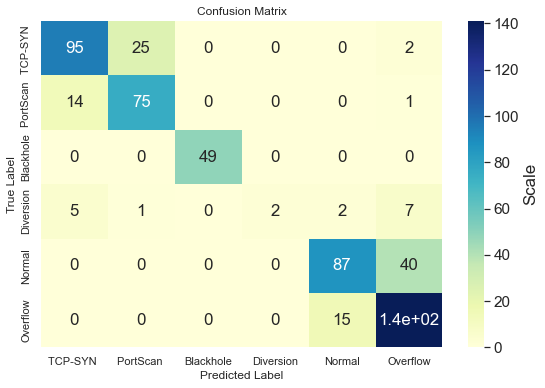

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.7631 - accuracy: 0.2822 - val_loss: 1.7410 - val_accuracy: 0.2549
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7220 - accuracy: 0.2829 - val_loss: 1.7077 - val_accuracy: 0.2620
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6913 - accuracy: 0.2997 - val_loss: 1.6806 - val_accuracy: 0.2620
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6658 - accuracy: 0.3135 - val_loss: 1.6573 - val_accuracy: 0.2656
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6426 - accuracy: 0.2910 - val_loss: 1.6350 - val_accuracy: 0.2692
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6202 - accuracy: 0.3184 - val_loss: 1.6124 - val_accuracy: 0.2638
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 1.5956 - accuracy: 0.2925 - val_loss: 1.5859 - val_accuracy: 0.2602
Epoch 8/500
2

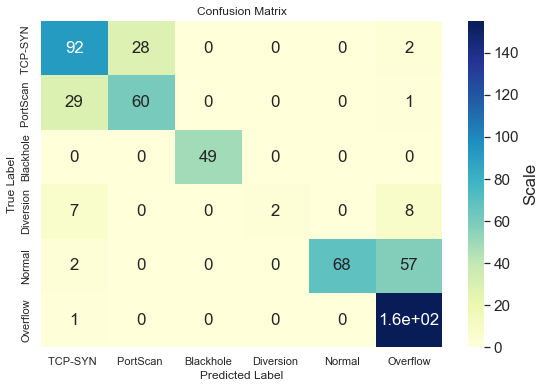

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.7632 - accuracy: 0.2688 - val_loss: 1.7407 - val_accuracy: 0.2264
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7191 - accuracy: 0.2734 - val_loss: 1.6995 - val_accuracy: 0.2531
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6740 - accuracy: 0.3162 - val_loss: 1.6542 - val_accuracy: 0.2977
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6199 - accuracy: 0.3349 - val_loss: 1.6016 - val_accuracy: 0.3226
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.5578 - accuracy: 0.3379 - val_loss: 1.5420 - val_accuracy: 0.3209
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 1.4906 - accuracy: 0.3494 - val_loss: 1.4775 - val_accuracy: 0.3369
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 1.4238 - accuracy: 0.3784 - val_loss: 1.4113 - val_accuracy: 0.3957
Epoch 8/500
2

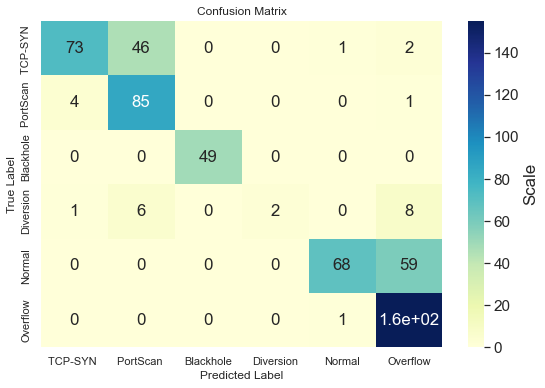

Epoch 1/500
21/21 [==============================] - 0s 5ms/step - loss: 1.7677 - accuracy: 0.1741 - val_loss: 1.7408 - val_accuracy: 0.2585
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7135 - accuracy: 0.2822 - val_loss: 1.6942 - val_accuracy: 0.3191
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6611 - accuracy: 0.3135 - val_loss: 1.6424 - val_accuracy: 0.3583
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6002 - accuracy: 0.3486 - val_loss: 1.5842 - val_accuracy: 0.4474
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.5383 - accuracy: 0.4410 - val_loss: 1.5311 - val_accuracy: 0.4599
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 1.4886 - accuracy: 0.3956 - val_loss: 1.4890 - val_accuracy: 0.3565
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 1.4506 - accuracy: 0.3540 - val_loss: 1.4551 - val_accuracy: 0.3351
Epoch 8/500
2

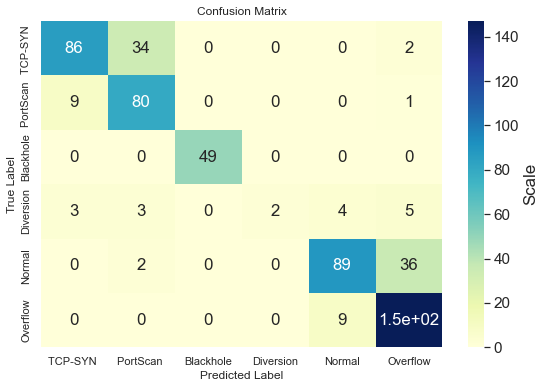

Epoch 1/500
21/21 [==============================] - 0s 7ms/step - loss: 1.7736 - accuracy: 0.2157 - val_loss: 1.7559 - val_accuracy: 0.2674
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.7394 - accuracy: 0.2428 - val_loss: 1.7233 - val_accuracy: 0.2995
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7055 - accuracy: 0.3398 - val_loss: 1.6912 - val_accuracy: 0.3583
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6693 - accuracy: 0.4139 - val_loss: 1.6551 - val_accuracy: 0.4046
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6247 - accuracy: 0.4173 - val_loss: 1.6093 - val_accuracy: 0.4153
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 1.5716 - accuracy: 0.4170 - val_loss: 1.5609 - val_accuracy: 0.3993
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 1.5216 - accuracy: 0.4120 - val_loss: 1.5171 - val_accuracy: 0.4100
Epoch 8/500
2

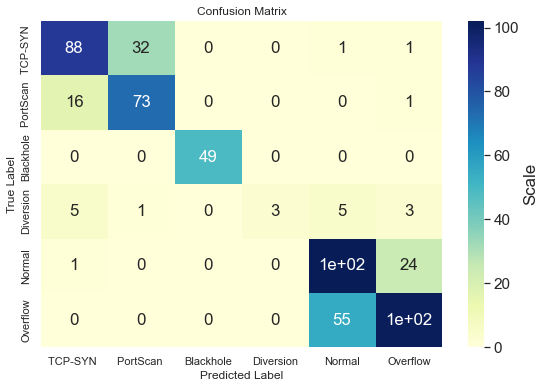

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.8182512521743774
Min_training_accuracy:  0.7567774057388306
Avg_training_accuracy:  0.7817487716674805
----------------------------------------------
Max_testing_accuracy:  0.8074866533279419
Min_testing_accuracy:  0.7415329813957214
Avg_testing_accuracy:  0.7757575750350952
----------------------------------------------
Max_Valadation_accuracy:  0.8235294222831726
Min_Valadation_accuracy:  0.7540106773376465
Avg_Valadation_accuracy:  0.7828876972198486


In [ ]:
optimizer = tf.keras.optimizers.SGD(learning_rate=0.01, momentum=0.5)
L001_SGD05_train,L001_SGD05_test,L001_SGD05n_val=model_best_hidden(optimizer)

In [ ]:
clac_min_max_average(L001_SGD05_train,L001_SGD05_test,L001_SGD05n_val)

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.8182512521743774
Min_training_accuracy:  0.7567774057388306
Avg_training_accuracy:  0.7817487716674805
----------------------------------------------
Max_testing_accuracy:  0.8074866533279419
Min_testing_accuracy:  0.7415329813957214
Avg_testing_accuracy:  0.7757575750350952
----------------------------------------------
Max_Valadation_accuracy:  0.8235294222831726
Min_Valadation_accuracy:  0.7540106773376465
Avg_Valadation_accuracy:  0.7828876972198486


#### 4 ) - SGD (momentum =0.9)

Epoch 1/500
21/21 [==============================] - 0s 7ms/step - loss: 1.7221 - accuracy: 0.3200 - val_loss: 1.6256 - val_accuracy: 0.3993
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.5418 - accuracy: 0.4051 - val_loss: 1.3698 - val_accuracy: 0.4528
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.2755 - accuracy: 0.4433 - val_loss: 1.0898 - val_accuracy: 0.5009
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9789 - accuracy: 0.5792 - val_loss: 0.8323 - val_accuracy: 0.6275
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8213 - accuracy: 0.6430 - val_loss: 0.7469 - val_accuracy: 0.6542
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7708 - accuracy: 0.6499 - val_loss: 0.7452 - val_accuracy: 0.6649
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7144 - accuracy: 0.6816 - val_loss: 0.6594 - val_accuracy: 0.7255
Epoch 8/500
2

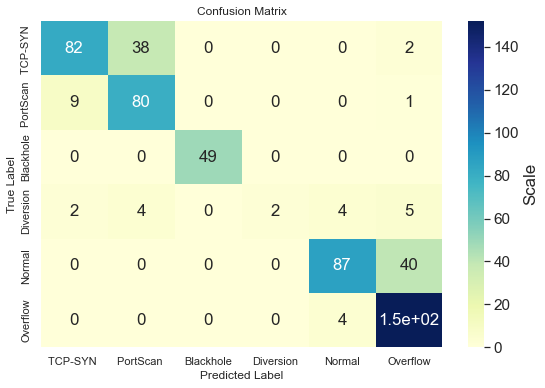

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.7468 - accuracy: 0.3009 - val_loss: 1.6759 - val_accuracy: 0.3298
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.5639 - accuracy: 0.3574 - val_loss: 1.4826 - val_accuracy: 0.3476
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.3787 - accuracy: 0.4246 - val_loss: 1.3138 - val_accuracy: 0.4439
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.2167 - accuracy: 0.5094 - val_loss: 1.1163 - val_accuracy: 0.5401
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.0476 - accuracy: 0.5533 - val_loss: 0.9448 - val_accuracy: 0.5722
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9186 - accuracy: 0.5788 - val_loss: 0.8396 - val_accuracy: 0.6061
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8295 - accuracy: 0.6258 - val_loss: 0.7799 - val_accuracy: 0.6506
Epoch 8/500
2

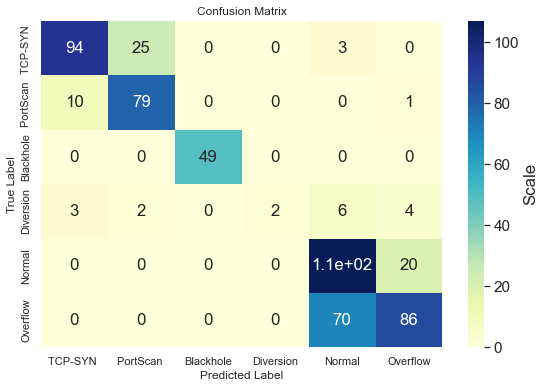

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.7492 - accuracy: 0.2627 - val_loss: 1.6819 - val_accuracy: 0.2513
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6357 - accuracy: 0.2543 - val_loss: 1.5828 - val_accuracy: 0.2513
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.4973 - accuracy: 0.2749 - val_loss: 1.3693 - val_accuracy: 0.3975
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.2048 - accuracy: 0.4964 - val_loss: 1.0391 - val_accuracy: 0.5383
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9585 - accuracy: 0.5594 - val_loss: 0.8465 - val_accuracy: 0.5882
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8354 - accuracy: 0.5960 - val_loss: 0.7774 - val_accuracy: 0.6346
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7883 - accuracy: 0.6270 - val_loss: 0.7300 - val_accuracy: 0.6756
Epoch 8/500
2

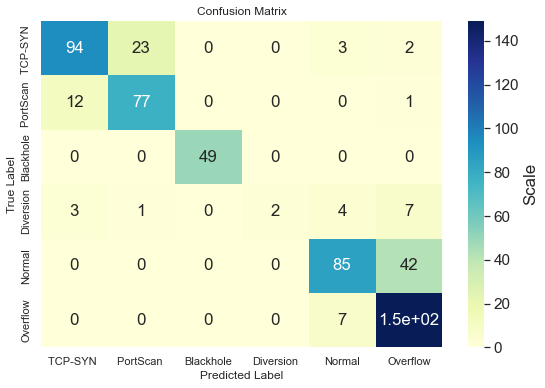

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.7675 - accuracy: 0.2532 - val_loss: 1.7229 - val_accuracy: 0.2210
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6786 - accuracy: 0.2459 - val_loss: 1.6396 - val_accuracy: 0.2442
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.5760 - accuracy: 0.2994 - val_loss: 1.5109 - val_accuracy: 0.3316
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.4026 - accuracy: 0.4330 - val_loss: 1.3423 - val_accuracy: 0.5009
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.2413 - accuracy: 0.5326 - val_loss: 1.1071 - val_accuracy: 0.6078
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9727 - accuracy: 0.6178 - val_loss: 0.8125 - val_accuracy: 0.6631
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8083 - accuracy: 0.6327 - val_loss: 0.7229 - val_accuracy: 0.6738
Epoch 8/500
2

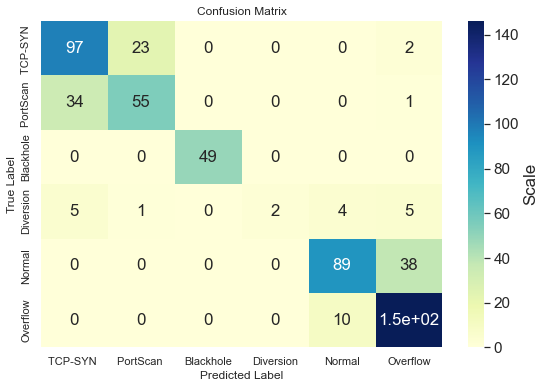

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.7594 - accuracy: 0.2528 - val_loss: 1.7027 - val_accuracy: 0.2121
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6591 - accuracy: 0.2478 - val_loss: 1.6111 - val_accuracy: 0.2299
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.5146 - accuracy: 0.3387 - val_loss: 1.4052 - val_accuracy: 0.3351
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.2750 - accuracy: 0.4506 - val_loss: 1.1761 - val_accuracy: 0.5116
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.0541 - accuracy: 0.5556 - val_loss: 0.9210 - val_accuracy: 0.5722
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8910 - accuracy: 0.5491 - val_loss: 0.8131 - val_accuracy: 0.5722
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8188 - accuracy: 0.6098 - val_loss: 0.7500 - val_accuracy: 0.6310
Epoch 8/500
2

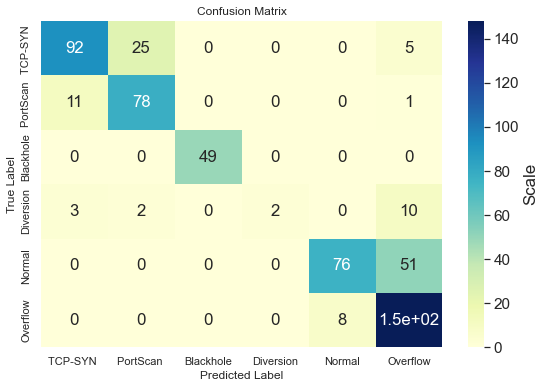

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.8003054857254028
Min_training_accuracy:  0.7777777910232544
Avg_training_accuracy:  0.789461636543274
----------------------------------------------
Max_testing_accuracy:  0.8128342032432556
Min_testing_accuracy:  0.7433155179023743
Avg_testing_accuracy:  0.7871657729148864
----------------------------------------------
Max_Valadation_accuracy:  0.8039215803146362
Min_Valadation_accuracy:  0.7700534462928772
Avg_Valadation_accuracy:  0.7889482975006104


In [ ]:
optimizer = tf.keras.optimizers.SGD(learning_rate=0.01, momentum=0.9)
L001_SGD09_train,L001_SGD09_test,L001_SGD09_val=model_best_hidden(optimizer)

In [ ]:
clac_min_max_average(L001_SGD09_train,L001_SGD09_test,L001_SGD09_val)

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.8003054857254028
Min_training_accuracy:  0.7777777910232544
Avg_training_accuracy:  0.789461636543274
----------------------------------------------
Max_testing_accuracy:  0.8128342032432556
Min_testing_accuracy:  0.7433155179023743
Avg_testing_accuracy:  0.7871657729148864
----------------------------------------------
Max_Valadation_accuracy:  0.8039215803146362
Min_Valadation_accuracy:  0.7700534462928772
Avg_Valadation_accuracy:  0.7889482975006104


#### 5 ) -Rprop

Epoch 1/500
21/21 [==============================] - 1s 6ms/step - loss: 1.3224 - accuracy: 0.4082 - val_loss: 0.8652 - val_accuracy: 0.5579
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9266 - accuracy: 0.5571 - val_loss: 0.7534 - val_accuracy: 0.5989
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8907 - accuracy: 0.5995 - val_loss: 0.8291 - val_accuracy: 0.6970
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7527 - accuracy: 0.6464 - val_loss: 0.6565 - val_accuracy: 0.6506
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8648 - accuracy: 0.6346 - val_loss: 0.6293 - val_accuracy: 0.7326
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7741 - accuracy: 0.6873 - val_loss: 0.6110 - val_accuracy: 0.7451
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7362 - accuracy: 0.6926 - val_loss: 0.7135 - val_accuracy: 0.7094
Epoch 8/500
2

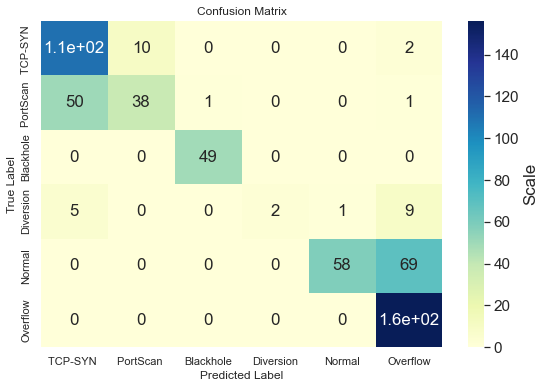

Epoch 1/500
21/21 [==============================] - 1s 6ms/step - loss: 1.3007 - accuracy: 0.3971 - val_loss: 0.9202 - val_accuracy: 0.5205
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9276 - accuracy: 0.5139 - val_loss: 0.8177 - val_accuracy: 0.5383
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9104 - accuracy: 0.5498 - val_loss: 0.8404 - val_accuracy: 0.5811
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8223 - accuracy: 0.6121 - val_loss: 0.9126 - val_accuracy: 0.5348
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8528 - accuracy: 0.6109 - val_loss: 0.7850 - val_accuracy: 0.5936
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7396 - accuracy: 0.6659 - val_loss: 0.7017 - val_accuracy: 0.6524
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7923 - accuracy: 0.6586 - val_loss: 0.6798 - val_accuracy: 0.7184
Epoch 8/500
2

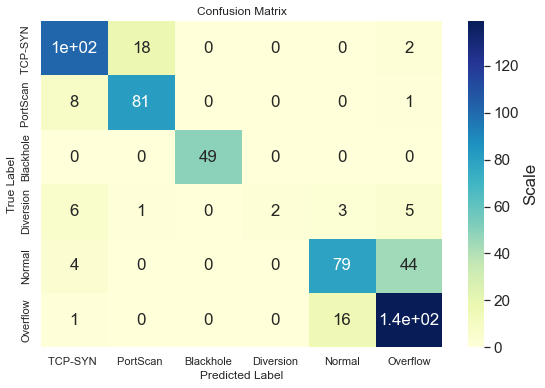

Epoch 1/500
21/21 [==============================] - 1s 6ms/step - loss: 1.2380 - accuracy: 0.4238 - val_loss: 0.9852 - val_accuracy: 0.4813
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.0035 - accuracy: 0.5113 - val_loss: 0.8203 - val_accuracy: 0.5241
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9060 - accuracy: 0.5430 - val_loss: 1.8776 - val_accuracy: 0.5793
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.0160 - accuracy: 0.5712 - val_loss: 0.8479 - val_accuracy: 0.6061
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7755 - accuracy: 0.6453 - val_loss: 0.6908 - val_accuracy: 0.6738
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8035 - accuracy: 0.6327 - val_loss: 0.6901 - val_accuracy: 0.6132
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7374 - accuracy: 0.6667 - val_loss: 0.6559 - val_accuracy: 0.6970
Epoch 8/500
2

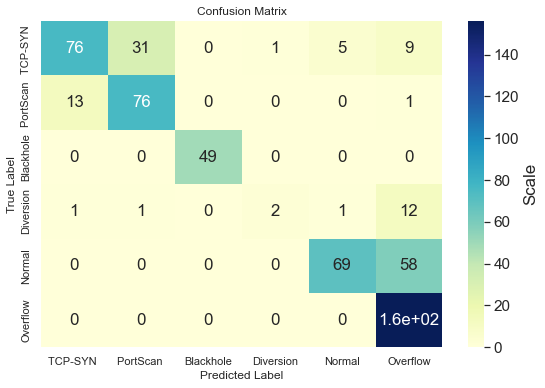

Epoch 1/500
21/21 [==============================] - 1s 14ms/step - loss: 1.4304 - accuracy: 0.3582 - val_loss: 0.9728 - val_accuracy: 0.5383
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9158 - accuracy: 0.5563 - val_loss: 0.7461 - val_accuracy: 0.6168
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8868 - accuracy: 0.5724 - val_loss: 0.7729 - val_accuracy: 0.6221
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7727 - accuracy: 0.6495 - val_loss: 0.8734 - val_accuracy: 0.5704
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7895 - accuracy: 0.6342 - val_loss: 0.7405 - val_accuracy: 0.6934
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7346 - accuracy: 0.6789 - val_loss: 0.6805 - val_accuracy: 0.6916
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8919 - accuracy: 0.6445 - val_loss: 0.6973 - val_accuracy: 0.7059
Epoch 8/500


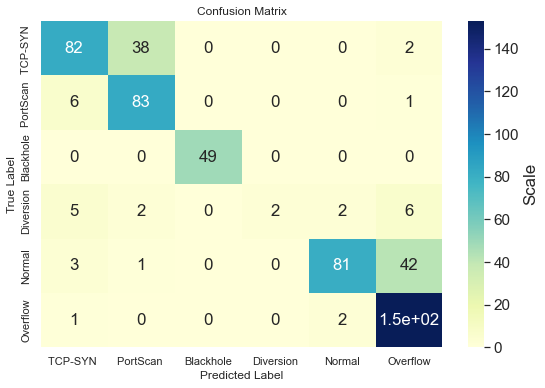

Epoch 1/500
21/21 [==============================] - 1s 6ms/step - loss: 1.3154 - accuracy: 0.4047 - val_loss: 1.3771 - val_accuracy: 0.4813
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.0383 - accuracy: 0.5338 - val_loss: 0.9150 - val_accuracy: 0.5633
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9164 - accuracy: 0.5796 - val_loss: 0.8022 - val_accuracy: 0.5722
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8957 - accuracy: 0.5796 - val_loss: 0.7637 - val_accuracy: 0.6203
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.0513 - accuracy: 0.6235 - val_loss: 0.7839 - val_accuracy: 0.6364
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8082 - accuracy: 0.6224 - val_loss: 0.7852 - val_accuracy: 0.6595
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6959 - accuracy: 0.6854 - val_loss: 1.4255 - val_accuracy: 0.5847
Epoch 8/500
2

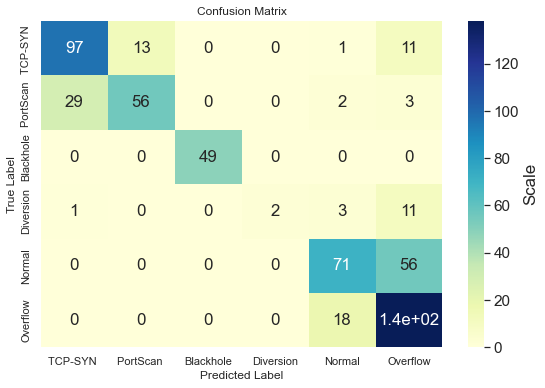

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7983963489532471
Min_training_accuracy:  0.7205039858818054
Avg_training_accuracy:  0.7543337106704712
----------------------------------------------
Max_testing_accuracy:  0.8057041168212891
Min_testing_accuracy:  0.7361853718757629
Avg_testing_accuracy:  0.7686274528503418
----------------------------------------------
Max_Valadation_accuracy:  0.8110516667366028
Min_Valadation_accuracy:  0.7254902124404907
Avg_Valadation_accuracy:  0.7657753944396972


In [ ]:
optimizer = tf.keras.optimizers.RMSprop(learning_rate=0.01)
L001_Rprop_train,L001_Rprop_test,L001_Rprop_val=model_best_hidden(optimizer)

In [ ]:
clac_min_max_average(L001_Rprop_train,L001_Rprop_test,L001_Rprop_val)

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7983963489532471
Min_training_accuracy:  0.7205039858818054
Avg_training_accuracy:  0.7543337106704712
----------------------------------------------
Max_testing_accuracy:  0.8057041168212891
Min_testing_accuracy:  0.7361853718757629
Avg_testing_accuracy:  0.7686274528503418
----------------------------------------------
Max_Valadation_accuracy:  0.8110516667366028
Min_Valadation_accuracy:  0.7254902124404907
Avg_Valadation_accuracy:  0.7657753944396972


### At Learnig Rate 0.001

#### 1 ) - Adamw Optimzier

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.6600 - accuracy: 0.2394 - val_loss: 1.5157 - val_accuracy: 0.3725
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.3007 - accuracy: 0.4891 - val_loss: 1.0394 - val_accuracy: 0.6061
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9305 - accuracy: 0.6472 - val_loss: 0.7927 - val_accuracy: 0.6934
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7733 - accuracy: 0.6670 - val_loss: 0.6770 - val_accuracy: 0.7237
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7063 - accuracy: 0.7029 - val_loss: 0.6324 - val_accuracy: 0.7201
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6638 - accuracy: 0.7167 - val_loss: 0.6265 - val_accuracy: 0.7344
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6379 - accuracy: 0.7342 - val_loss: 0.5945 - val_accuracy: 0.7611
Epoch 8/500
2

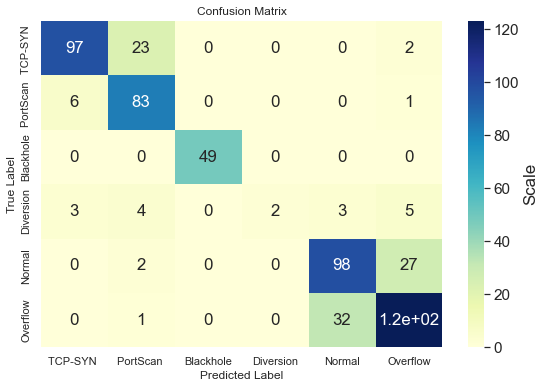

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.3420 - accuracy: 0.4605 - val_loss: 0.7426 - val_accuracy: 0.6471
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7615 - accuracy: 0.6598 - val_loss: 0.6310 - val_accuracy: 0.7201
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6552 - accuracy: 0.7174 - val_loss: 0.5761 - val_accuracy: 0.7540
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6194 - accuracy: 0.7430 - val_loss: 0.5780 - val_accuracy: 0.7701
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.5857 - accuracy: 0.7621 - val_loss: 0.5433 - val_accuracy: 0.7718
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.5835 - accuracy: 0.7587 - val_loss: 0.5549 - val_accuracy: 0.7754
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.5712 - accuracy: 0.7701 - val_loss: 0.5421 - val_accuracy: 0.7843
Epoch 8/500
2

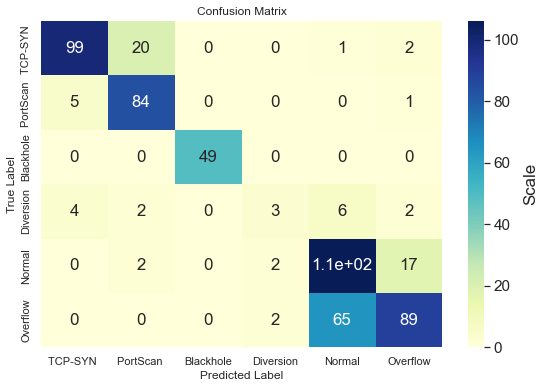

Epoch 1/500
21/21 [==============================] - 0s 7ms/step - loss: 1.2674 - accuracy: 0.4964 - val_loss: 0.7521 - val_accuracy: 0.6756
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7372 - accuracy: 0.6869 - val_loss: 0.6104 - val_accuracy: 0.7594
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6265 - accuracy: 0.7308 - val_loss: 0.5666 - val_accuracy: 0.7540
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6038 - accuracy: 0.7438 - val_loss: 0.6283 - val_accuracy: 0.7558
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.5717 - accuracy: 0.7625 - val_loss: 0.5275 - val_accuracy: 0.7701
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.5601 - accuracy: 0.7659 - val_loss: 0.5416 - val_accuracy: 0.7683
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.5565 - accuracy: 0.7690 - val_loss: 0.5420 - val_accuracy: 0.7487
Epoch 8/500
2

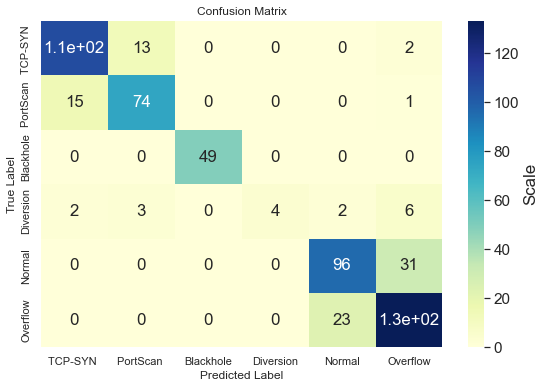

Epoch 1/500
21/21 [==============================] - 1s 6ms/step - loss: 1.2636 - accuracy: 0.4486 - val_loss: 0.8332 - val_accuracy: 0.5437
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7732 - accuracy: 0.6082 - val_loss: 0.6847 - val_accuracy: 0.6667
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7048 - accuracy: 0.6880 - val_loss: 0.6570 - val_accuracy: 0.6524
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6371 - accuracy: 0.7308 - val_loss: 0.5811 - val_accuracy: 0.7362
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6200 - accuracy: 0.7377 - val_loss: 0.5751 - val_accuracy: 0.7504
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.5756 - accuracy: 0.7610 - val_loss: 0.5134 - val_accuracy: 0.7968
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.5473 - accuracy: 0.7808 - val_loss: 0.5058 - val_accuracy: 0.8021
Epoch 8/500
2

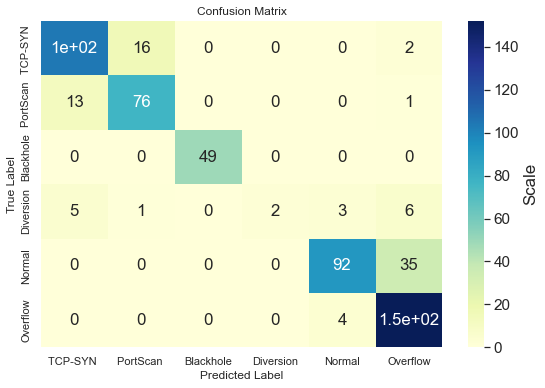

Epoch 1/500
21/21 [==============================] - 0s 7ms/step - loss: 1.2490 - accuracy: 0.4635 - val_loss: 0.7742 - val_accuracy: 0.6488
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7520 - accuracy: 0.6628 - val_loss: 0.6448 - val_accuracy: 0.6863
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6634 - accuracy: 0.7262 - val_loss: 0.5729 - val_accuracy: 0.7594
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6181 - accuracy: 0.7423 - val_loss: 0.6136 - val_accuracy: 0.7701
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6138 - accuracy: 0.7400 - val_loss: 0.5506 - val_accuracy: 0.7611
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.5772 - accuracy: 0.7659 - val_loss: 0.5191 - val_accuracy: 0.7754
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.5540 - accuracy: 0.7793 - val_loss: 0.5066 - val_accuracy: 0.8093
Epoch 8/500
2

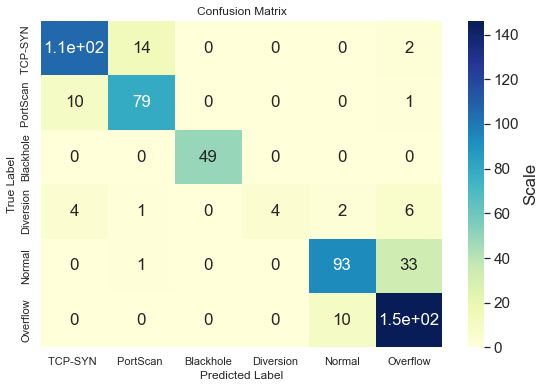

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.8434516787528992
Min_training_accuracy:  0.8140511512756348
Avg_training_accuracy:  0.8273386836051941
----------------------------------------------
Max_testing_accuracy:  0.8502673506736755
Min_testing_accuracy:  0.7664884328842163
Avg_testing_accuracy:  0.8188948392868042
----------------------------------------------
Max_Valadation_accuracy:  0.8306595087051392
Min_Valadation_accuracy:  0.8021390438079834
Avg_Valadation_accuracy:  0.8149732708930969


In [ ]:
optimizer=tfaAdamw.optimizers.AdamW(learning_rate= 0.001, weight_decay= 0.0001)
L0001_Adam_train,L0001_Adam_test,L0001_Adam__val=model_best_hidden(optimizer)

In [ ]:
clac_min_max_average(L0001_Adam_train,L0001_Adam_test,L0001_Adam__val)

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.8434516787528992
Min_training_accuracy:  0.8140511512756348
Avg_training_accuracy:  0.8273386836051941
----------------------------------------------
Max_testing_accuracy:  0.8502673506736755
Min_testing_accuracy:  0.7664884328842163
Avg_testing_accuracy:  0.8188948392868042
----------------------------------------------
Max_Valadation_accuracy:  0.8306595087051392
Min_Valadation_accuracy:  0.8021390438079834
Avg_Valadation_accuracy:  0.8149732708930969


#### 2 ) - SGD (momentum =0.1)

Epoch 1/500
21/21 [==============================] - 0s 9ms/step - loss: 1.8100 - accuracy: 0.2161 - val_loss: 1.8014 - val_accuracy: 0.2121
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.8063 - accuracy: 0.2341 - val_loss: 1.7980 - val_accuracy: 0.2175
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.8028 - accuracy: 0.2371 - val_loss: 1.7946 - val_accuracy: 0.2175
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7995 - accuracy: 0.2386 - val_loss: 1.7915 - val_accuracy: 0.2228
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7963 - accuracy: 0.2402 - val_loss: 1.7884 - val_accuracy: 0.2299
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7932 - accuracy: 0.2459 - val_loss: 1.7855 - val_accuracy: 0.2460
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7903 - accuracy: 0.2505 - val_loss: 1.7826 - val_accuracy: 0.2496
Epoch 8/500
2

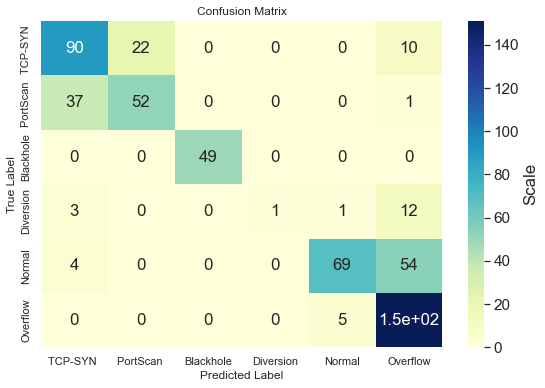

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.7914 - accuracy: 0.2409 - val_loss: 1.7912 - val_accuracy: 0.2406
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7890 - accuracy: 0.2428 - val_loss: 1.7886 - val_accuracy: 0.2442
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7864 - accuracy: 0.2455 - val_loss: 1.7859 - val_accuracy: 0.2442
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7837 - accuracy: 0.2478 - val_loss: 1.7831 - val_accuracy: 0.2478
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7811 - accuracy: 0.2501 - val_loss: 1.7803 - val_accuracy: 0.2478
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7784 - accuracy: 0.2532 - val_loss: 1.7776 - val_accuracy: 0.2496
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7759 - accuracy: 0.2535 - val_loss: 1.7750 - val_accuracy: 0.2513
Epoch 8/500
2

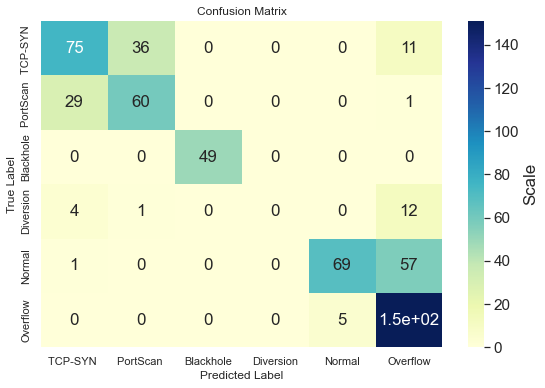

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.7873 - accuracy: 0.1856 - val_loss: 1.7861 - val_accuracy: 0.2103
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7850 - accuracy: 0.1940 - val_loss: 1.7838 - val_accuracy: 0.2353
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7828 - accuracy: 0.2027 - val_loss: 1.7816 - val_accuracy: 0.2496
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7806 - accuracy: 0.2100 - val_loss: 1.7795 - val_accuracy: 0.2424
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7785 - accuracy: 0.2150 - val_loss: 1.7773 - val_accuracy: 0.2549
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7764 - accuracy: 0.2176 - val_loss: 1.7753 - val_accuracy: 0.2549
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7744 - accuracy: 0.2310 - val_loss: 1.7732 - val_accuracy: 0.2620
Epoch 8/500
2

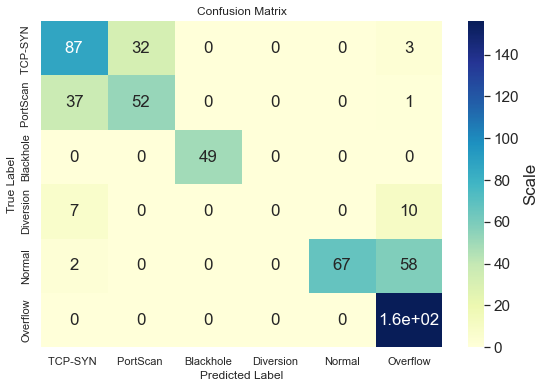

Epoch 1/500
21/21 [==============================] - 1s 6ms/step - loss: 1.7921 - accuracy: 0.2539 - val_loss: 1.7910 - val_accuracy: 0.2228
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7896 - accuracy: 0.2562 - val_loss: 1.7884 - val_accuracy: 0.2228
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7871 - accuracy: 0.2570 - val_loss: 1.7858 - val_accuracy: 0.2228
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7848 - accuracy: 0.2566 - val_loss: 1.7834 - val_accuracy: 0.2317
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7826 - accuracy: 0.2486 - val_loss: 1.7811 - val_accuracy: 0.2317
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7804 - accuracy: 0.2551 - val_loss: 1.7789 - val_accuracy: 0.2353
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7784 - accuracy: 0.2581 - val_loss: 1.7768 - val_accuracy: 0.2371
Epoch 8/500
2

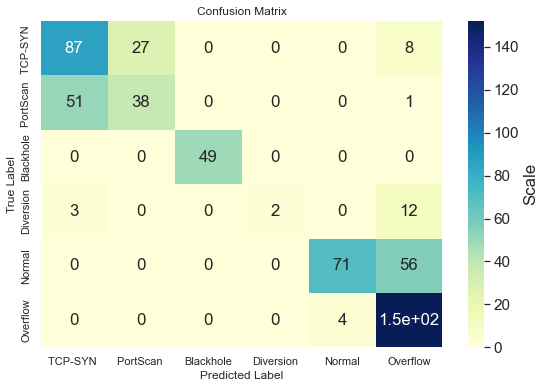

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.7934 - accuracy: 0.2104 - val_loss: 1.7909 - val_accuracy: 0.2157
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7913 - accuracy: 0.2264 - val_loss: 1.7889 - val_accuracy: 0.2353
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7892 - accuracy: 0.2562 - val_loss: 1.7869 - val_accuracy: 0.2727
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7871 - accuracy: 0.2913 - val_loss: 1.7848 - val_accuracy: 0.2977
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7851 - accuracy: 0.3051 - val_loss: 1.7829 - val_accuracy: 0.2781
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7830 - accuracy: 0.3024 - val_loss: 1.7809 - val_accuracy: 0.2656
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7810 - accuracy: 0.2944 - val_loss: 1.7790 - val_accuracy: 0.2674
Epoch 8/500
2

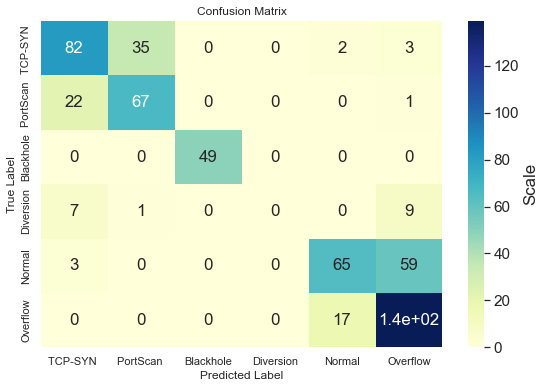

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7224131226539612
Min_training_accuracy:  0.6956853866577148
Avg_training_accuracy:  0.7066819429397583
----------------------------------------------
Max_testing_accuracy:  0.7344028353691101
Min_testing_accuracy:  0.7112299203872681
Avg_testing_accuracy:  0.7229946374893188
----------------------------------------------
Max_Valadation_accuracy:  0.7254902124404907
Min_Valadation_accuracy:  0.7023172974586487
Avg_Valadation_accuracy:  0.7126559853553772


In [ ]:
optimizer = tf.keras.optimizers.SGD(learning_rate=0.001, momentum=0.1)
L0001_SGD1_train,L0001_SGD1_test,L0001_SGD1_val=model_best_hidden(optimizer)

In [ ]:
clac_min_max_average(L0001_SGD1_train,L0001_SGD1_test,L0001_SGD1_val)

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7224131226539612
Min_training_accuracy:  0.6956853866577148
Avg_training_accuracy:  0.7066819429397583
----------------------------------------------
Max_testing_accuracy:  0.7344028353691101
Min_testing_accuracy:  0.7112299203872681
Avg_testing_accuracy:  0.7229946374893188
----------------------------------------------
Max_Valadation_accuracy:  0.7254902124404907
Min_Valadation_accuracy:  0.7023172974586487
Avg_Valadation_accuracy:  0.7126559853553772


#### 3 ) - SGD (momentum =0.5)

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.7943 - accuracy: 0.1791 - val_loss: 1.7896 - val_accuracy: 0.2335
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7869 - accuracy: 0.1974 - val_loss: 1.7829 - val_accuracy: 0.2246
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7799 - accuracy: 0.1649 - val_loss: 1.7765 - val_accuracy: 0.1800
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7731 - accuracy: 0.1516 - val_loss: 1.7703 - val_accuracy: 0.1390
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7665 - accuracy: 0.1516 - val_loss: 1.7643 - val_accuracy: 0.1515
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7601 - accuracy: 0.1741 - val_loss: 1.7583 - val_accuracy: 0.2014
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7539 - accuracy: 0.2245 - val_loss: 1.7526 - val_accuracy: 0.2424
Epoch 8/500
2

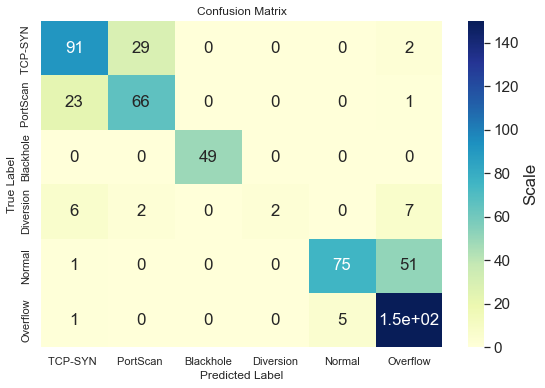

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.7771 - accuracy: 0.3165 - val_loss: 1.7779 - val_accuracy: 0.3209
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7723 - accuracy: 0.3391 - val_loss: 1.7733 - val_accuracy: 0.3209
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7680 - accuracy: 0.3280 - val_loss: 1.7693 - val_accuracy: 0.3048
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7642 - accuracy: 0.3169 - val_loss: 1.7657 - val_accuracy: 0.3048
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7606 - accuracy: 0.3108 - val_loss: 1.7622 - val_accuracy: 0.2977
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7571 - accuracy: 0.3032 - val_loss: 1.7590 - val_accuracy: 0.2906
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7537 - accuracy: 0.2978 - val_loss: 1.7557 - val_accuracy: 0.2852
Epoch 8/500
2

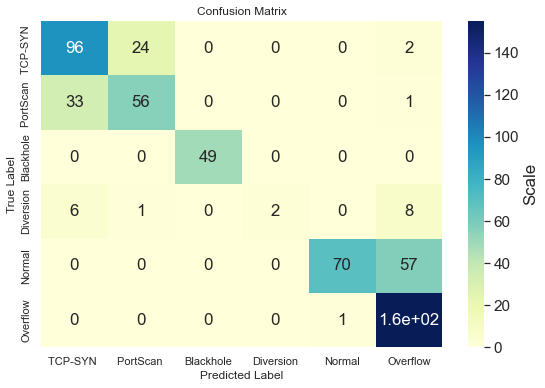

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.7808 - accuracy: 0.2142 - val_loss: 1.7742 - val_accuracy: 0.2549
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7756 - accuracy: 0.2142 - val_loss: 1.7689 - val_accuracy: 0.2549
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7705 - accuracy: 0.2142 - val_loss: 1.7638 - val_accuracy: 0.2549
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7655 - accuracy: 0.2142 - val_loss: 1.7588 - val_accuracy: 0.2549
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7607 - accuracy: 0.2146 - val_loss: 1.7540 - val_accuracy: 0.2549
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7560 - accuracy: 0.2146 - val_loss: 1.7493 - val_accuracy: 0.2549
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7516 - accuracy: 0.2176 - val_loss: 1.7448 - val_accuracy: 0.2567
Epoch 8/500
2

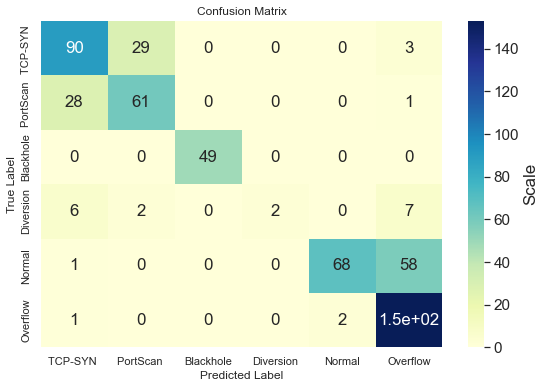

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.7912 - accuracy: 0.1100 - val_loss: 1.7936 - val_accuracy: 0.1925
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7874 - accuracy: 0.2719 - val_loss: 1.7898 - val_accuracy: 0.2763
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7839 - accuracy: 0.3242 - val_loss: 1.7865 - val_accuracy: 0.2799
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7807 - accuracy: 0.3295 - val_loss: 1.7834 - val_accuracy: 0.2816
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7778 - accuracy: 0.3303 - val_loss: 1.7805 - val_accuracy: 0.2745
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7749 - accuracy: 0.3291 - val_loss: 1.7776 - val_accuracy: 0.2727
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7721 - accuracy: 0.3253 - val_loss: 1.7749 - val_accuracy: 0.2745
Epoch 8/500
2

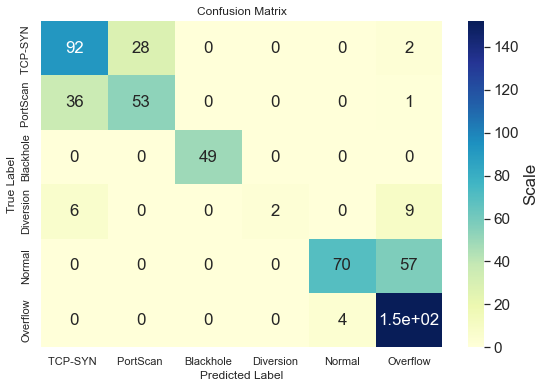

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.8051 - accuracy: 0.1775 - val_loss: 1.8012 - val_accuracy: 0.2406
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7978 - accuracy: 0.2100 - val_loss: 1.7950 - val_accuracy: 0.2549
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7915 - accuracy: 0.2138 - val_loss: 1.7896 - val_accuracy: 0.2531
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7860 - accuracy: 0.2134 - val_loss: 1.7848 - val_accuracy: 0.2531
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7810 - accuracy: 0.2127 - val_loss: 1.7803 - val_accuracy: 0.2531
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7763 - accuracy: 0.2062 - val_loss: 1.7760 - val_accuracy: 0.2424
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7718 - accuracy: 0.1947 - val_loss: 1.7719 - val_accuracy: 0.2282
Epoch 8/500
2

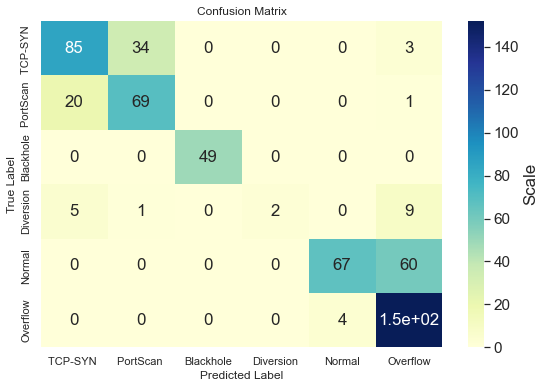

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7678503394126892
Min_training_accuracy:  0.7403588891029358
Avg_training_accuracy:  0.7554028272628784
----------------------------------------------
Max_testing_accuracy:  0.77183598279953
Min_testing_accuracy:  0.7450980544090271
Avg_testing_accuracy:  0.7579322576522827
----------------------------------------------
Max_Valadation_accuracy:  0.7629233598709106
Min_Valadation_accuracy:  0.7344028353691101
Avg_Valadation_accuracy:  0.751871657371521


In [ ]:
optimizer = tf.keras.optimizers.SGD(learning_rate=0.001, momentum=0.5)
L0001_SGD05_train,L0001_SGD05_test,L0001_SGD05n_val=model_best_hidden(optimizer)

In [ ]:
clac_min_max_average(L0001_SGD05_train,L0001_SGD05_test,L0001_SGD05n_val)

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7678503394126892
Min_training_accuracy:  0.7403588891029358
Avg_training_accuracy:  0.7554028272628784
----------------------------------------------
Max_testing_accuracy:  0.77183598279953
Min_testing_accuracy:  0.7450980544090271
Avg_testing_accuracy:  0.7579322576522827
----------------------------------------------
Max_Valadation_accuracy:  0.7629233598709106
Min_Valadation_accuracy:  0.7344028353691101
Avg_Valadation_accuracy:  0.751871657371521


#### 4 ) - SGD (momentum =0.9)

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.7875 - accuracy: 0.2875 - val_loss: 1.7770 - val_accuracy: 0.3601
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7675 - accuracy: 0.3486 - val_loss: 1.7582 - val_accuracy: 0.3405
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7476 - accuracy: 0.3520 - val_loss: 1.7399 - val_accuracy: 0.3422
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7280 - accuracy: 0.3734 - val_loss: 1.7219 - val_accuracy: 0.3743
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7085 - accuracy: 0.4005 - val_loss: 1.7038 - val_accuracy: 0.3761
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6879 - accuracy: 0.4131 - val_loss: 1.6851 - val_accuracy: 0.4011
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6663 - accuracy: 0.4246 - val_loss: 1.6652 - val_accuracy: 0.4029
Epoch 8/500
2

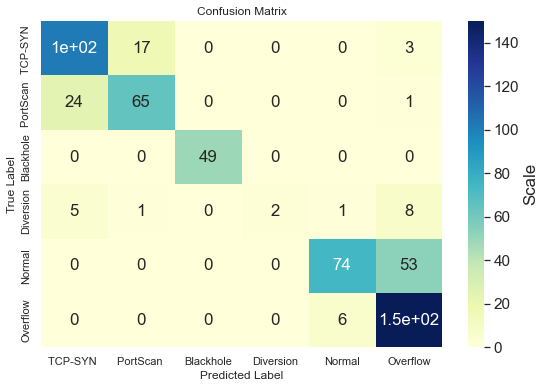

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.7934 - accuracy: 0.1993 - val_loss: 1.7862 - val_accuracy: 0.2620
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7819 - accuracy: 0.2325 - val_loss: 1.7736 - val_accuracy: 0.3030
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7695 - accuracy: 0.2787 - val_loss: 1.7612 - val_accuracy: 0.3244
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7571 - accuracy: 0.3299 - val_loss: 1.7493 - val_accuracy: 0.3369
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7456 - accuracy: 0.3318 - val_loss: 1.7384 - val_accuracy: 0.3244
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7352 - accuracy: 0.3379 - val_loss: 1.7283 - val_accuracy: 0.3280
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7253 - accuracy: 0.3372 - val_loss: 1.7189 - val_accuracy: 0.3048
Epoch 8/500
2

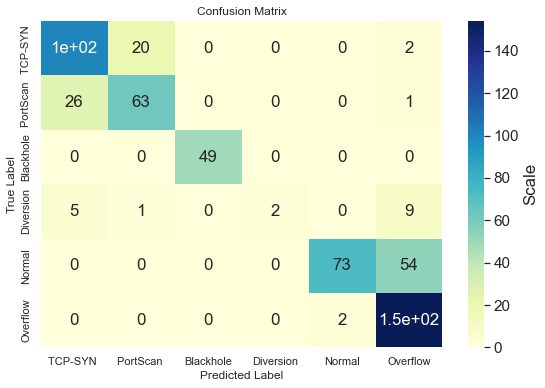

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.7907 - accuracy: 0.2486 - val_loss: 1.7856 - val_accuracy: 0.2193
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7755 - accuracy: 0.2486 - val_loss: 1.7700 - val_accuracy: 0.2193
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7606 - accuracy: 0.2486 - val_loss: 1.7566 - val_accuracy: 0.2193
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7475 - accuracy: 0.2486 - val_loss: 1.7447 - val_accuracy: 0.2193
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7352 - accuracy: 0.2486 - val_loss: 1.7331 - val_accuracy: 0.2193
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7230 - accuracy: 0.2486 - val_loss: 1.7218 - val_accuracy: 0.2193
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7109 - accuracy: 0.2486 - val_loss: 1.7105 - val_accuracy: 0.2193
Epoch 8/500
2

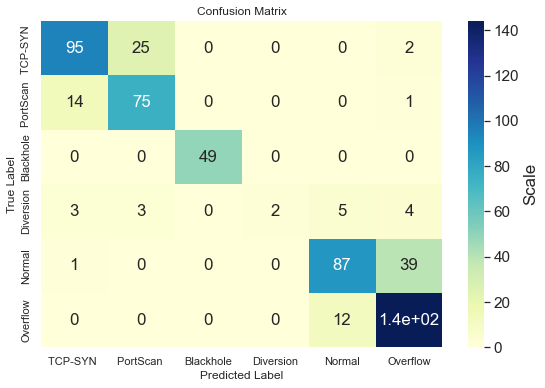

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.7841 - accuracy: 0.1497 - val_loss: 1.7727 - val_accuracy: 0.3476
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7603 - accuracy: 0.4089 - val_loss: 1.7552 - val_accuracy: 0.3619
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7432 - accuracy: 0.4036 - val_loss: 1.7392 - val_accuracy: 0.3725
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7266 - accuracy: 0.4131 - val_loss: 1.7225 - val_accuracy: 0.3904
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7093 - accuracy: 0.4200 - val_loss: 1.7054 - val_accuracy: 0.4029
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6915 - accuracy: 0.4254 - val_loss: 1.6881 - val_accuracy: 0.3993
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6731 - accuracy: 0.4429 - val_loss: 1.6701 - val_accuracy: 0.4082
Epoch 8/500
2

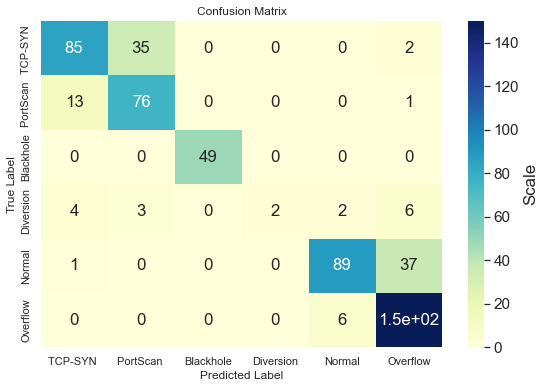

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.8102 - accuracy: 0.2119 - val_loss: 1.7935 - val_accuracy: 0.2513
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7852 - accuracy: 0.2543 - val_loss: 1.7711 - val_accuracy: 0.2513
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7613 - accuracy: 0.2543 - val_loss: 1.7503 - val_accuracy: 0.2513
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7401 - accuracy: 0.2543 - val_loss: 1.7327 - val_accuracy: 0.2513
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7219 - accuracy: 0.2543 - val_loss: 1.7164 - val_accuracy: 0.2513
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 1.7054 - accuracy: 0.2543 - val_loss: 1.7006 - val_accuracy: 0.2513
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6899 - accuracy: 0.2543 - val_loss: 1.6861 - val_accuracy: 0.2513
Epoch 8/500
2

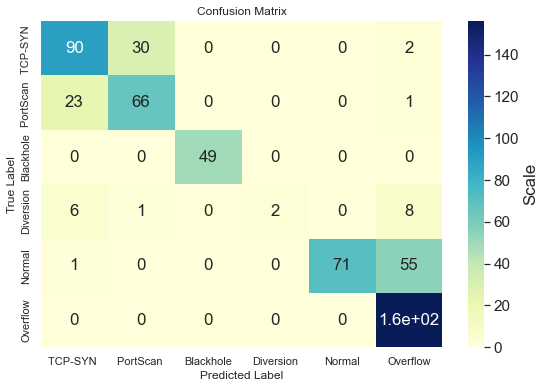

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7983963489532471
Min_training_accuracy:  0.7594501972198486
Avg_training_accuracy:  0.7817487716674805
----------------------------------------------
Max_testing_accuracy:  0.8057041168212891
Min_testing_accuracy:  0.7736185193061829
Avg_testing_accuracy:  0.7914438605308532
----------------------------------------------
Max_Valadation_accuracy:  0.8039215803146362
Min_Valadation_accuracy:  0.7664884328842163
Avg_Valadation_accuracy:  0.787522292137146


In [ ]:
optimizer = tf.keras.optimizers.SGD(learning_rate=0.001, momentum=0.9)
L0001_SGD09_train,L0001_SGD09_test,L0001_SGD09_val=model_best_hidden(optimizer)

In [ ]:
clac_min_max_average(L0001_SGD09_train,L0001_SGD09_test,L0001_SGD09_val)

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7983963489532471
Min_training_accuracy:  0.7594501972198486
Avg_training_accuracy:  0.7817487716674805
----------------------------------------------
Max_testing_accuracy:  0.8057041168212891
Min_testing_accuracy:  0.7736185193061829
Avg_testing_accuracy:  0.7914438605308532
----------------------------------------------
Max_Valadation_accuracy:  0.8039215803146362
Min_Valadation_accuracy:  0.7664884328842163
Avg_Valadation_accuracy:  0.787522292137146


#### 5 ) - Rprop

Epoch 1/500
21/21 [==============================] - 1s 6ms/step - loss: 1.6011 - accuracy: 0.4322 - val_loss: 1.1123 - val_accuracy: 0.5276
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9349 - accuracy: 0.5869 - val_loss: 0.7869 - val_accuracy: 0.6560
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7757 - accuracy: 0.6632 - val_loss: 0.7627 - val_accuracy: 0.6702
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7278 - accuracy: 0.6804 - val_loss: 0.7416 - val_accuracy: 0.7005
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7112 - accuracy: 0.6991 - val_loss: 0.6402 - val_accuracy: 0.7219
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6768 - accuracy: 0.7090 - val_loss: 0.6143 - val_accuracy: 0.7308
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6636 - accuracy: 0.7236 - val_loss: 0.6447 - val_accuracy: 0.6988
Epoch 8/500
2

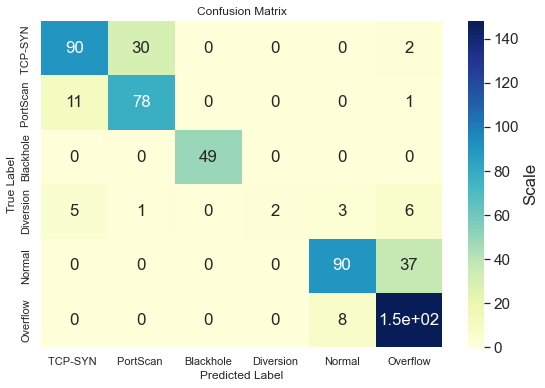

Epoch 1/500
21/21 [==============================] - 1s 7ms/step - loss: 1.5212 - accuracy: 0.4475 - val_loss: 1.1263 - val_accuracy: 0.5472
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9629 - accuracy: 0.5907 - val_loss: 0.8259 - val_accuracy: 0.6506
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7982 - accuracy: 0.6564 - val_loss: 0.7565 - val_accuracy: 0.6595
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7262 - accuracy: 0.6900 - val_loss: 0.6555 - val_accuracy: 0.7237
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6887 - accuracy: 0.7033 - val_loss: 0.6140 - val_accuracy: 0.7576
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6503 - accuracy: 0.7270 - val_loss: 0.6560 - val_accuracy: 0.7273
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6342 - accuracy: 0.7300 - val_loss: 0.5966 - val_accuracy: 0.7273
Epoch 8/500
2

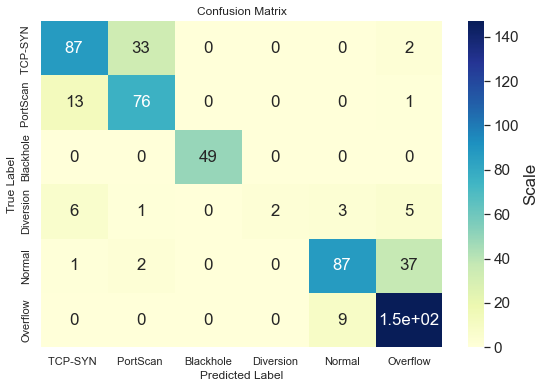

Epoch 1/500
21/21 [==============================] - 1s 6ms/step - loss: 1.6062 - accuracy: 0.3918 - val_loss: 1.3491 - val_accuracy: 0.5455
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.1031 - accuracy: 0.5773 - val_loss: 0.8984 - val_accuracy: 0.6417
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8328 - accuracy: 0.6571 - val_loss: 0.7795 - val_accuracy: 0.5865
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7508 - accuracy: 0.6827 - val_loss: 0.6936 - val_accuracy: 0.6934
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7158 - accuracy: 0.6945 - val_loss: 0.6747 - val_accuracy: 0.7148
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6902 - accuracy: 0.7090 - val_loss: 0.6328 - val_accuracy: 0.7273
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6687 - accuracy: 0.7243 - val_loss: 0.6312 - val_accuracy: 0.7398
Epoch 8/500
2

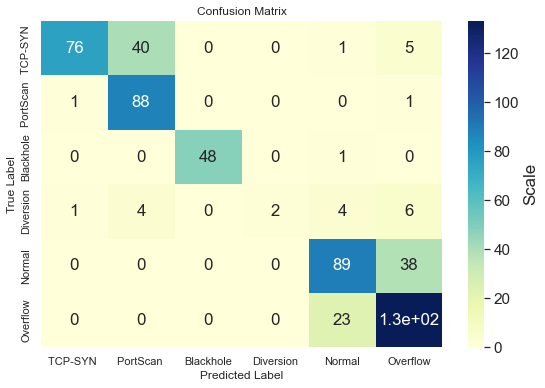

Epoch 1/500
21/21 [==============================] - 1s 14ms/step - loss: 1.4742 - accuracy: 0.4422 - val_loss: 1.2243 - val_accuracy: 0.4991
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.0506 - accuracy: 0.5895 - val_loss: 0.9293 - val_accuracy: 0.6381
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8435 - accuracy: 0.6403 - val_loss: 0.7489 - val_accuracy: 0.6952
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7684 - accuracy: 0.6739 - val_loss: 0.6915 - val_accuracy: 0.7201
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7217 - accuracy: 0.6865 - val_loss: 0.6586 - val_accuracy: 0.6328
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6966 - accuracy: 0.7087 - val_loss: 0.6446 - val_accuracy: 0.7308
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6764 - accuracy: 0.7213 - val_loss: 0.6813 - val_accuracy: 0.6738
Epoch 8/500


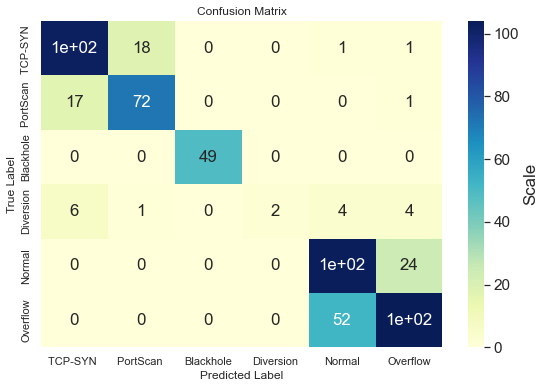

Epoch 1/500
21/21 [==============================] - 1s 6ms/step - loss: 1.5119 - accuracy: 0.4635 - val_loss: 1.0954 - val_accuracy: 0.5116
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9571 - accuracy: 0.5704 - val_loss: 0.8603 - val_accuracy: 0.5722
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8299 - accuracy: 0.6090 - val_loss: 0.8900 - val_accuracy: 0.5651
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7761 - accuracy: 0.6449 - val_loss: 0.7621 - val_accuracy: 0.5954
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7341 - accuracy: 0.6682 - val_loss: 0.7916 - val_accuracy: 0.6720
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7033 - accuracy: 0.6800 - val_loss: 0.6998 - val_accuracy: 0.6738
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6916 - accuracy: 0.7010 - val_loss: 0.6458 - val_accuracy: 0.6916
Epoch 8/500
2

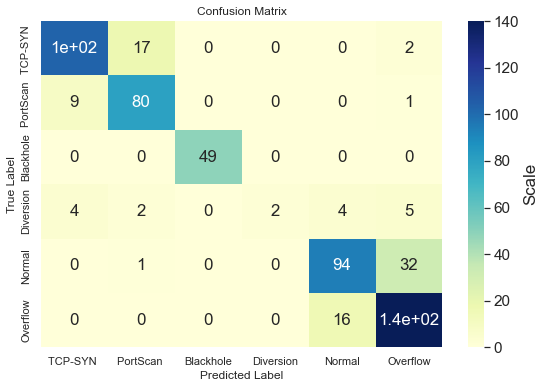

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.8319969177246094
Min_training_accuracy:  0.7762504816055298
Avg_training_accuracy:  0.8011454701423645
----------------------------------------------
Max_testing_accuracy:  0.8342245817184448
Min_testing_accuracy:  0.7700534462928772
Avg_testing_accuracy:  0.7989304661750793
----------------------------------------------
Max_Valadation_accuracy:  0.8270944952964783
Min_Valadation_accuracy:  0.7361853718757629
Avg_Valadation_accuracy:  0.7925133585929871


In [ ]:
optimizer = tf.keras.optimizers.RMSprop(learning_rate=0.001)
L0001_Rprop_train,L0001_Rprop_test,L0001_Rprop_val=model_best_hidden(optimizer)

In [ ]:
clac_min_max_average(L0001_Rprop_train,L0001_Rprop_test,L0001_Rprop_val)

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.8319969177246094
Min_training_accuracy:  0.7762504816055298
Avg_training_accuracy:  0.8011454701423645
----------------------------------------------
Max_testing_accuracy:  0.8342245817184448
Min_testing_accuracy:  0.7700534462928772
Avg_testing_accuracy:  0.7989304661750793
----------------------------------------------
Max_Valadation_accuracy:  0.8270944952964783
Min_Valadation_accuracy:  0.7361853718757629
Avg_Valadation_accuracy:  0.7925133585929871


# Q3.4) Activation functions	

In [ ]:
import tensorflow as tf
def model_best_activation(activation):
    total_train_acc= []
    total_test_acc= []
    total_val_acc=[]
    confusion=[]
    number_of_runs=5
    for i in range(number_of_runs):
        optimizer=tfaAdamw.optimizers.AdamW(learning_rate= 0.001, weight_decay= 0.0001)
        model = keras.models.Sequential()
        model.add(Dense(40, input_shape = (10,), activation = activation))
        model.add(Dense(40, activation = activation))
        model.add(Dense(40, activation = activation))
        model.add(Dense(40, activation = activation))
        model.add(Dense(40, activation = activation))
        model.add(Dense(40, activation = activation))
        model.add(Dense(40, activation = activation))
        model.add(Dense(40, activation = activation))
        model.add(Dense(6, activation = "softmax"))
        callback = tf.keras.callbacks.EarlyStopping(monitor='loss', patience=8)
        model.compile(optimizer=optimizer, loss="sparse_categorical_crossentropy", metrics = ["accuracy"])
        model.fit(x_train_scaled_anovaa, train_y, epochs=500, batch_size=128, validation_data=(x_val_scaled_anovaa,val_y),callbacks=[callback])
        total_train_acc.append(model.evaluate(x_train_scaled_anovaa, train_y, verbose=0)[1])
        total_test_acc.append(model.evaluate(x_test_scaled_anovaa, test_y, verbose=0)[1])
        total_val_acc.append(model.evaluate(x_val_scaled_anovaa,val_y, verbose=0)[1])

        y_pred = np.argmax(model.predict(x_test_scaled_anovaa), axis=-1)
        data= confusion_matrix(test_y, y_pred)
        confusion.append(data)
        labels =['TCP-SYN ','PortScan ','Blackhole','Diversion','Normal','Overflow']
        plot_confusion_matrix(data,labels)

    # Training acc 
    # Max
    max_training_accuracy = np.amax(total_train_acc)
    # Min 
    min_training_accuracy = np.amin(total_train_acc)
    #Avg
    avg_training_accuracy = np.average(total_train_acc)

    # Testing acc 
    # Max
    max_testing_accuracy =  np.amax(total_test_acc)
    # Min 
    min_testing_accuracy =  np.amin(total_test_acc)
    # Avg
    avg_testing_accuracy =  np.average(total_test_acc)

    # Valadation acc 
    # Max
    max_Valadation_accuracy =  np.amax(total_val_acc)
    # Min 
    min_Valadation_accuracy =  np.amin(total_val_acc)
    # Avg
    avg_Valadation_accuracy =  np.average(total_val_acc)

    print('Min, Max, Avg Accuracies', '\n')
    print('Max_training_accuracy:', max_training_accuracy )
    print('Min_training_accuracy: ', min_training_accuracy)
    print('Avg_training_accuracy: ', avg_training_accuracy)
    print('----------------------------------------------')
    print('Max_testing_accuracy: ', max_testing_accuracy)
    print('Min_testing_accuracy: ', min_testing_accuracy)
    print('Avg_testing_accuracy: ', avg_testing_accuracy)
    print('----------------------------------------------')
    print('Max_Valadation_accuracy: ', max_Valadation_accuracy)
    print('Min_Valadation_accuracy: ', min_Valadation_accuracy)
    print('Avg_Valadation_accuracy: ', avg_Valadation_accuracy)
    
    return total_train_acc,total_test_acc,total_val_acc

## Relu

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.6707 - accuracy: 0.3291 - val_loss: 1.5160 - val_accuracy: 0.3048
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.2998 - accuracy: 0.4238 - val_loss: 1.0091 - val_accuracy: 0.6471
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8734 - accuracy: 0.6407 - val_loss: 0.7599 - val_accuracy: 0.6791
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7425 - accuracy: 0.6957 - val_loss: 0.6898 - val_accuracy: 0.7094
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6893 - accuracy: 0.7205 - val_loss: 0.6324 - val_accuracy: 0.7344
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6532 - accuracy: 0.7266 - val_loss: 0.6005 - val_accuracy: 0.7469
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6248 - accuracy: 0.7434 - val_loss: 0.5922 - val_accuracy: 0.7451
Epoch 8/500
2

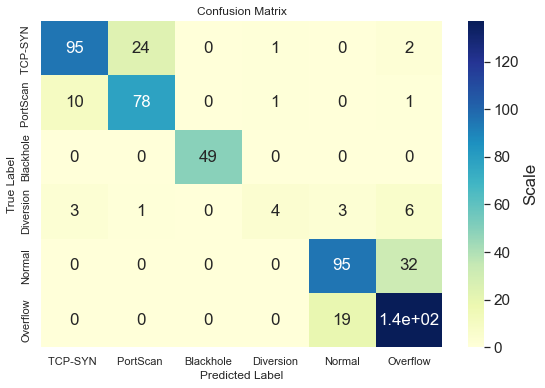

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.7164 - accuracy: 0.3043 - val_loss: 1.6122 - val_accuracy: 0.3280
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.3771 - accuracy: 0.4624 - val_loss: 1.0966 - val_accuracy: 0.5633
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9279 - accuracy: 0.6033 - val_loss: 0.7524 - val_accuracy: 0.6916
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7323 - accuracy: 0.6739 - val_loss: 0.6689 - val_accuracy: 0.6132
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6676 - accuracy: 0.7045 - val_loss: 0.6168 - val_accuracy: 0.7273
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6335 - accuracy: 0.7312 - val_loss: 0.5927 - val_accuracy: 0.7291
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6162 - accuracy: 0.7457 - val_loss: 0.5970 - val_accuracy: 0.7291
Epoch 8/500
2

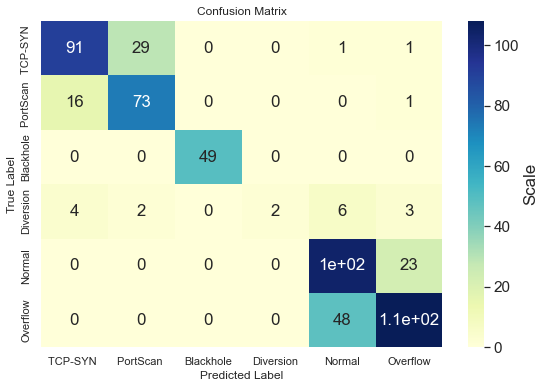

Epoch 1/500
21/21 [==============================] - 1s 7ms/step - loss: 1.7305 - accuracy: 0.2367 - val_loss: 1.5917 - val_accuracy: 0.4100
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.3638 - accuracy: 0.4834 - val_loss: 1.0124 - val_accuracy: 0.5561
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8806 - accuracy: 0.6228 - val_loss: 0.7336 - val_accuracy: 0.6150
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7302 - accuracy: 0.6854 - val_loss: 0.6799 - val_accuracy: 0.7219
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6739 - accuracy: 0.7224 - val_loss: 0.6085 - val_accuracy: 0.7504
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6338 - accuracy: 0.7400 - val_loss: 0.5895 - val_accuracy: 0.7451
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6242 - accuracy: 0.7404 - val_loss: 0.5850 - val_accuracy: 0.7487
Epoch 8/500
2

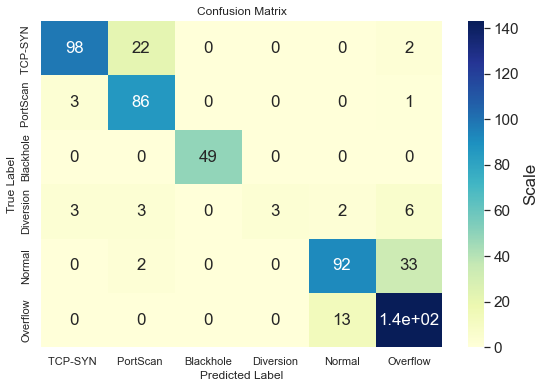

Epoch 1/500
21/21 [==============================] - 1s 6ms/step - loss: 1.7065 - accuracy: 0.2967 - val_loss: 1.5401 - val_accuracy: 0.4029
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.2271 - accuracy: 0.5097 - val_loss: 0.9376 - val_accuracy: 0.6185
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8387 - accuracy: 0.6216 - val_loss: 0.7512 - val_accuracy: 0.6043
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7280 - accuracy: 0.6842 - val_loss: 0.6836 - val_accuracy: 0.7041
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6770 - accuracy: 0.7064 - val_loss: 0.6511 - val_accuracy: 0.7201
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6665 - accuracy: 0.7171 - val_loss: 0.6214 - val_accuracy: 0.7540
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6310 - accuracy: 0.7362 - val_loss: 0.5834 - val_accuracy: 0.7683
Epoch 8/500
2

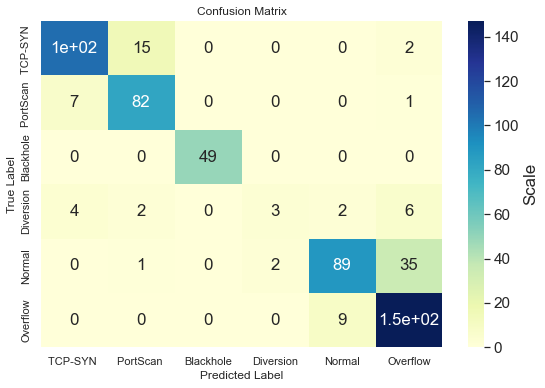

Epoch 1/500
21/21 [==============================] - 1s 6ms/step - loss: 1.7367 - accuracy: 0.3268 - val_loss: 1.6019 - val_accuracy: 0.4100
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.3948 - accuracy: 0.4173 - val_loss: 1.0891 - val_accuracy: 0.5312
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.0029 - accuracy: 0.6006 - val_loss: 0.8080 - val_accuracy: 0.6756
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7663 - accuracy: 0.6819 - val_loss: 0.6656 - val_accuracy: 0.7255
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6854 - accuracy: 0.7045 - val_loss: 0.6207 - val_accuracy: 0.7308
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6555 - accuracy: 0.7174 - val_loss: 0.6225 - val_accuracy: 0.7504
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6381 - accuracy: 0.7297 - val_loss: 0.5944 - val_accuracy: 0.7594
Epoch 8/500
2

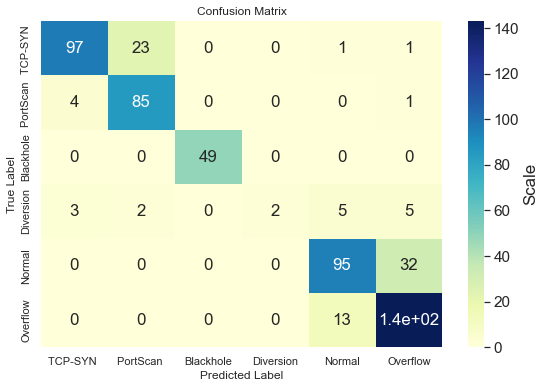

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.8476517796516418
Min_training_accuracy:  0.7827414870262146
Avg_training_accuracy:  0.8252004623413086
----------------------------------------------
Max_testing_accuracy:  0.8467023372650146
Min_testing_accuracy:  0.7611408233642578
Avg_testing_accuracy:  0.8206773638725281
----------------------------------------------
Max_Valadation_accuracy:  0.8377896547317505
Min_Valadation_accuracy:  0.7932263612747192
Avg_Valadation_accuracy:  0.8231728911399842


In [ ]:
relu_train,relu__test,relu__val=model_best_activation('relu')

In [ ]:
clac_min_max_average(relu_train,relu__test,relu__val)

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.8476517796516418
Min_training_accuracy:  0.7827414870262146
Avg_training_accuracy:  0.8252004623413086
----------------------------------------------
Max_testing_accuracy:  0.8467023372650146
Min_testing_accuracy:  0.7611408233642578
Avg_testing_accuracy:  0.8206773638725281
----------------------------------------------
Max_Valadation_accuracy:  0.8377896547317505
Min_Valadation_accuracy:  0.7932263612747192
Avg_Valadation_accuracy:  0.8231728911399842


## Leaky Relu

Epoch 1/500
21/21 [==============================] - 1s 6ms/step - loss: 1.5072 - accuracy: 0.4704 - val_loss: 1.0859 - val_accuracy: 0.5615
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 0.9347 - accuracy: 0.5704 - val_loss: 0.7965 - val_accuracy: 0.6275
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7846 - accuracy: 0.6430 - val_loss: 0.7185 - val_accuracy: 0.6863
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7139 - accuracy: 0.6892 - val_loss: 0.6702 - val_accuracy: 0.7112
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6754 - accuracy: 0.7186 - val_loss: 0.6277 - val_accuracy: 0.7148
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6496 - accuracy: 0.7289 - val_loss: 0.6090 - val_accuracy: 0.7451
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6347 - accuracy: 0.7365 - val_loss: 0.6114 - val_accuracy: 0.7398
Epoch 8/500
2

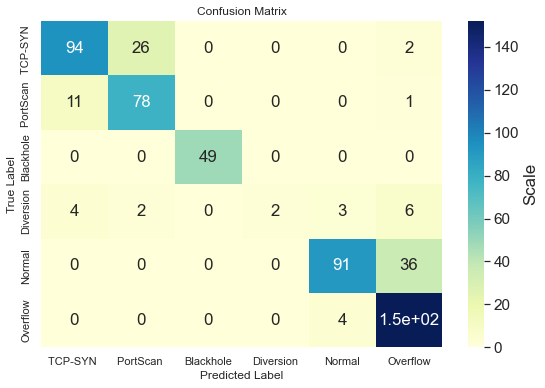

Epoch 1/500
21/21 [==============================] - 1s 6ms/step - loss: 1.6055 - accuracy: 0.4311 - val_loss: 1.3596 - val_accuracy: 0.4242
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.0775 - accuracy: 0.5338 - val_loss: 0.8423 - val_accuracy: 0.5971
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8243 - accuracy: 0.6289 - val_loss: 0.7474 - val_accuracy: 0.6560
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7295 - accuracy: 0.6858 - val_loss: 0.6500 - val_accuracy: 0.7273
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6714 - accuracy: 0.7285 - val_loss: 0.6227 - val_accuracy: 0.7344
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6532 - accuracy: 0.7247 - val_loss: 0.6253 - val_accuracy: 0.7059
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6303 - accuracy: 0.7488 - val_loss: 0.6028 - val_accuracy: 0.7380
Epoch 8/500
2

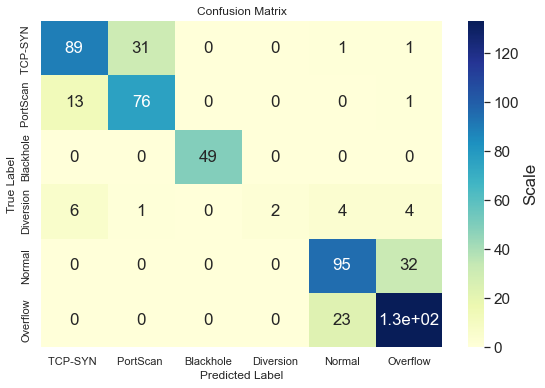

Epoch 1/500
21/21 [==============================] - 1s 7ms/step - loss: 1.5334 - accuracy: 0.4612 - val_loss: 1.2148 - val_accuracy: 0.4581
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.0142 - accuracy: 0.5262 - val_loss: 0.8149 - val_accuracy: 0.6417
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8088 - accuracy: 0.6342 - val_loss: 0.7166 - val_accuracy: 0.6774
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7269 - accuracy: 0.6896 - val_loss: 0.6593 - val_accuracy: 0.7077
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6809 - accuracy: 0.7075 - val_loss: 0.6437 - val_accuracy: 0.6791
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6473 - accuracy: 0.7155 - val_loss: 0.6213 - val_accuracy: 0.7362
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6308 - accuracy: 0.7308 - val_loss: 0.6005 - val_accuracy: 0.7344
Epoch 8/500
2

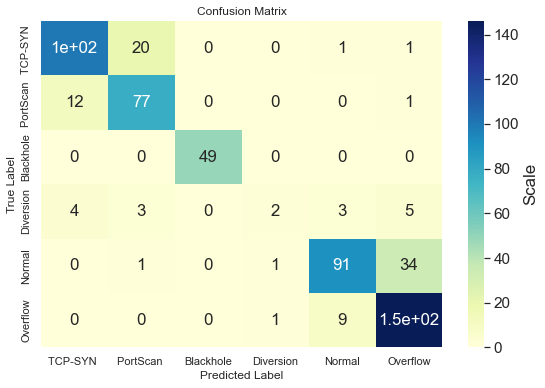

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.6052 - accuracy: 0.3853 - val_loss: 1.3100 - val_accuracy: 0.5080
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.0294 - accuracy: 0.5365 - val_loss: 0.8101 - val_accuracy: 0.6488
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7949 - accuracy: 0.6575 - val_loss: 0.7077 - val_accuracy: 0.7005
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7174 - accuracy: 0.6831 - val_loss: 0.6591 - val_accuracy: 0.7273
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6719 - accuracy: 0.7152 - val_loss: 0.6111 - val_accuracy: 0.7380
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6469 - accuracy: 0.7293 - val_loss: 0.5894 - val_accuracy: 0.7558
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6287 - accuracy: 0.7419 - val_loss: 0.5792 - val_accuracy: 0.7451
Epoch 8/500
2

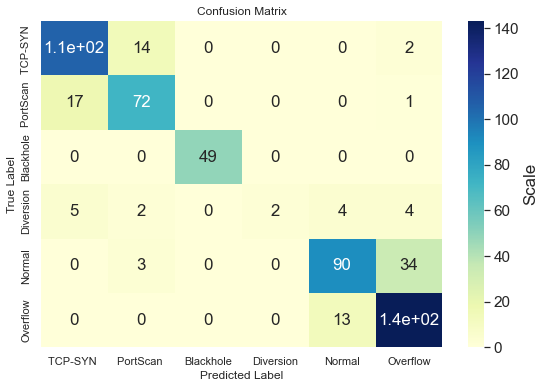

Epoch 1/500
21/21 [==============================] - 1s 6ms/step - loss: 1.5827 - accuracy: 0.4116 - val_loss: 1.3658 - val_accuracy: 0.4242
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.1504 - accuracy: 0.5128 - val_loss: 0.9657 - val_accuracy: 0.5775
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8148 - accuracy: 0.6544 - val_loss: 0.6789 - val_accuracy: 0.6970
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6855 - accuracy: 0.6903 - val_loss: 0.6401 - val_accuracy: 0.6988
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6526 - accuracy: 0.7155 - val_loss: 0.6110 - val_accuracy: 0.7148
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6352 - accuracy: 0.7308 - val_loss: 0.6000 - val_accuracy: 0.7469
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6261 - accuracy: 0.7404 - val_loss: 0.5904 - val_accuracy: 0.7380
Epoch 8/500
2

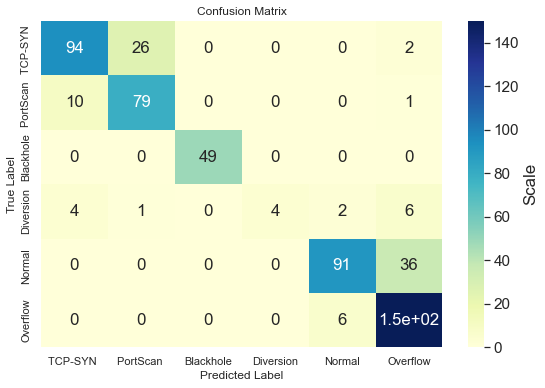

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.8369606733322144
Min_training_accuracy:  0.7995418310165405
Avg_training_accuracy:  0.8206185698509216
----------------------------------------------
Max_testing_accuracy:  0.832442045211792
Min_testing_accuracy:  0.7914438247680664
Avg_testing_accuracy:  0.8213903665542602
----------------------------------------------
Max_Valadation_accuracy:  0.8217468857765198
Min_Valadation_accuracy:  0.8021390438079834
Avg_Valadation_accuracy:  0.8131907343864441


In [ ]:
Leakyrelu_train,Leakyrelu_test,Leakyrelu_val=model_best_activation('LeakyReLU')

In [ ]:
clac_min_max_average(Leakyrelu_train,Leakyrelu_test,Leakyrelu_val)

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.8369606733322144
Min_training_accuracy:  0.7995418310165405
Avg_training_accuracy:  0.8206185698509216
----------------------------------------------
Max_testing_accuracy:  0.832442045211792
Min_testing_accuracy:  0.7914438247680664
Avg_testing_accuracy:  0.8213903665542602
----------------------------------------------
Max_Valadation_accuracy:  0.8217468857765198
Min_Valadation_accuracy:  0.8021390438079834
Avg_Valadation_accuracy:  0.8131907343864441


## Sigmoid

Epoch 1/500
21/21 [==============================] - 1s 6ms/step - loss: 1.6938 - accuracy: 0.2570 - val_loss: 1.6520 - val_accuracy: 0.2193
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6501 - accuracy: 0.2505 - val_loss: 1.6348 - val_accuracy: 0.2513
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6440 - accuracy: 0.2413 - val_loss: 1.6356 - val_accuracy: 0.2513
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6434 - accuracy: 0.2444 - val_loss: 1.6360 - val_accuracy: 0.2513
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6437 - accuracy: 0.2528 - val_loss: 1.6374 - val_accuracy: 0.2193
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6439 - accuracy: 0.2478 - val_loss: 1.6356 - val_accuracy: 0.2513
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6432 - accuracy: 0.2547 - val_loss: 1.6378 - val_accuracy: 0.2193
Epoch 8/500
2

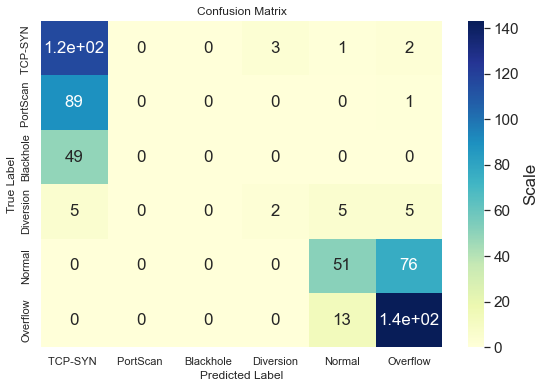

Epoch 1/500
21/21 [==============================] - 1s 6ms/step - loss: 1.8031 - accuracy: 0.2153 - val_loss: 1.6594 - val_accuracy: 0.2513
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6539 - accuracy: 0.2543 - val_loss: 1.6451 - val_accuracy: 0.2193
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6449 - accuracy: 0.2444 - val_loss: 1.6382 - val_accuracy: 0.2193
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6429 - accuracy: 0.2486 - val_loss: 1.6346 - val_accuracy: 0.2513
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6430 - accuracy: 0.2543 - val_loss: 1.6364 - val_accuracy: 0.2513
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6428 - accuracy: 0.2428 - val_loss: 1.6345 - val_accuracy: 0.2513
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6433 - accuracy: 0.2543 - val_loss: 1.6360 - val_accuracy: 0.2513
Epoch 8/500
2

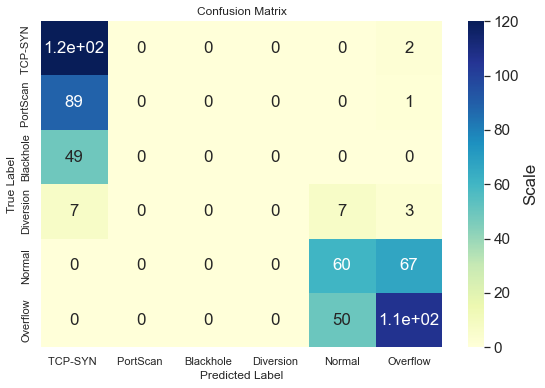

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.9047 - accuracy: 0.1569 - val_loss: 1.7601 - val_accuracy: 0.2513
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6791 - accuracy: 0.2543 - val_loss: 1.6478 - val_accuracy: 0.2513
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6463 - accuracy: 0.2474 - val_loss: 1.6350 - val_accuracy: 0.2193
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6436 - accuracy: 0.2474 - val_loss: 1.6376 - val_accuracy: 0.2193
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6427 - accuracy: 0.2528 - val_loss: 1.6351 - val_accuracy: 0.2513
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6433 - accuracy: 0.2543 - val_loss: 1.6371 - val_accuracy: 0.2513
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6432 - accuracy: 0.2470 - val_loss: 1.6356 - val_accuracy: 0.2513
Epoch 8/500
2

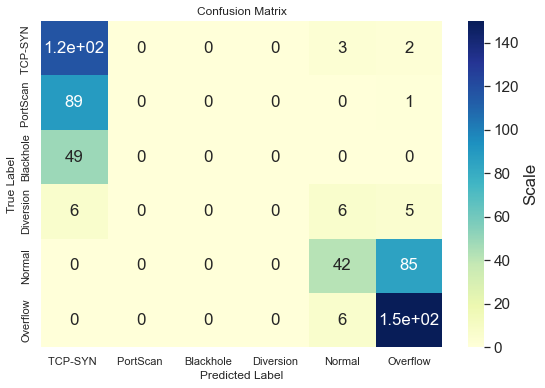

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.7010 - accuracy: 0.2459 - val_loss: 1.6485 - val_accuracy: 0.2513
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6507 - accuracy: 0.2436 - val_loss: 1.6362 - val_accuracy: 0.2193
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6432 - accuracy: 0.2509 - val_loss: 1.6346 - val_accuracy: 0.2513
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6441 - accuracy: 0.2436 - val_loss: 1.6380 - val_accuracy: 0.2193
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6433 - accuracy: 0.2520 - val_loss: 1.6354 - val_accuracy: 0.2513
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6436 - accuracy: 0.2447 - val_loss: 1.6361 - val_accuracy: 0.2513
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6438 - accuracy: 0.2509 - val_loss: 1.6363 - val_accuracy: 0.2513
Epoch 8/500
2

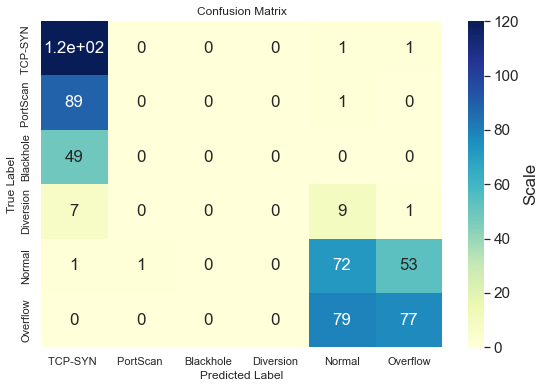

Epoch 1/500
21/21 [==============================] - 1s 6ms/step - loss: 1.7987 - accuracy: 0.2486 - val_loss: 1.6779 - val_accuracy: 0.2193
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6595 - accuracy: 0.2520 - val_loss: 1.6424 - val_accuracy: 0.2513
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6453 - accuracy: 0.2543 - val_loss: 1.6356 - val_accuracy: 0.2513
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6442 - accuracy: 0.2543 - val_loss: 1.6370 - val_accuracy: 0.2513
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6432 - accuracy: 0.2459 - val_loss: 1.6377 - val_accuracy: 0.2193
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6426 - accuracy: 0.2501 - val_loss: 1.6361 - val_accuracy: 0.2513
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 1.6435 - accuracy: 0.2467 - val_loss: 1.6371 - val_accuracy: 0.2513
Epoch 8/500
2

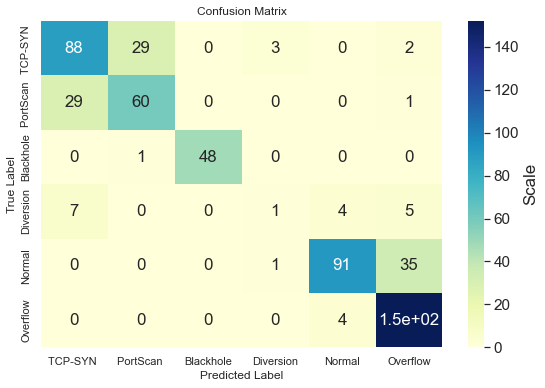

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7602137923240662
Min_training_accuracy:  0.47499045729637146
Avg_training_accuracy:  0.5481481492519379
----------------------------------------------
Max_testing_accuracy:  0.7843137383460999
Min_testing_accuracy:  0.4795008897781372
Avg_testing_accuracy:  0.5761140823364258
----------------------------------------------
Max_Valadation_accuracy:  0.7682709693908691
Min_Valadation_accuracy:  0.47593581676483154
Avg_Valadation_accuracy:  0.5540107011795044


In [ ]:
Sigmoid_train,Sigmoid_test,Sigmoid_val=model_best_activation('sigmoid')

In [ ]:
clac_min_max_average(Sigmoid_train,Sigmoid_test,Sigmoid_val)

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.7602137923240662
Min_training_accuracy:  0.47499045729637146
Avg_training_accuracy:  0.5481481492519379
----------------------------------------------
Max_testing_accuracy:  0.7843137383460999
Min_testing_accuracy:  0.4795008897781372
Avg_testing_accuracy:  0.5761140823364258
----------------------------------------------
Max_Valadation_accuracy:  0.7682709693908691
Min_Valadation_accuracy:  0.47593581676483154
Avg_Valadation_accuracy:  0.5540107011795044


## Tanh

Epoch 1/500
21/21 [==============================] - 0s 7ms/step - loss: 1.2925 - accuracy: 0.5388 - val_loss: 0.9348 - val_accuracy: 0.6774
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8631 - accuracy: 0.6766 - val_loss: 0.7702 - val_accuracy: 0.6809
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7553 - accuracy: 0.6972 - val_loss: 0.6944 - val_accuracy: 0.7077
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6980 - accuracy: 0.7300 - val_loss: 0.6636 - val_accuracy: 0.7237
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6683 - accuracy: 0.7289 - val_loss: 0.6567 - val_accuracy: 0.7291
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6481 - accuracy: 0.7404 - val_loss: 0.6235 - val_accuracy: 0.7415
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6287 - accuracy: 0.7423 - val_loss: 0.6279 - val_accuracy: 0.7362
Epoch 8/500
2

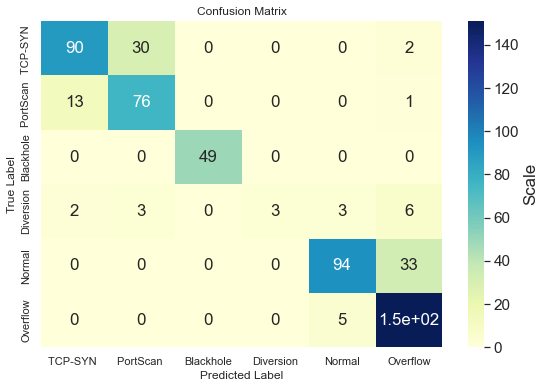

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.3308 - accuracy: 0.5002 - val_loss: 0.9751 - val_accuracy: 0.6560
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8916 - accuracy: 0.6625 - val_loss: 0.7811 - val_accuracy: 0.6738
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7728 - accuracy: 0.6812 - val_loss: 0.7109 - val_accuracy: 0.7255
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7106 - accuracy: 0.7098 - val_loss: 0.6584 - val_accuracy: 0.7077
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6753 - accuracy: 0.7281 - val_loss: 0.6388 - val_accuracy: 0.7433
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6510 - accuracy: 0.7362 - val_loss: 0.6161 - val_accuracy: 0.7415
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6344 - accuracy: 0.7384 - val_loss: 0.6148 - val_accuracy: 0.7273
Epoch 8/500
2

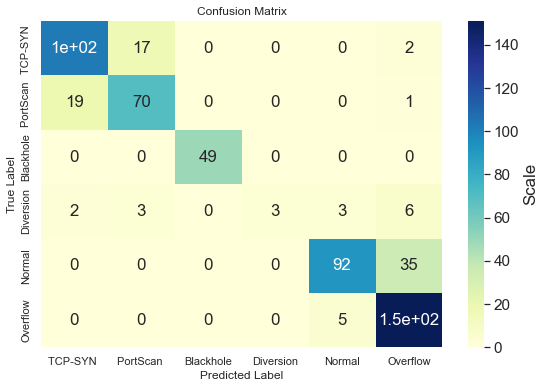

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.4223 - accuracy: 0.4815 - val_loss: 0.9780 - val_accuracy: 0.6488
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8886 - accuracy: 0.6396 - val_loss: 0.7422 - val_accuracy: 0.7201
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7486 - accuracy: 0.7071 - val_loss: 0.6806 - val_accuracy: 0.7398
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6943 - accuracy: 0.7213 - val_loss: 0.6463 - val_accuracy: 0.7540
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6689 - accuracy: 0.7239 - val_loss: 0.6436 - val_accuracy: 0.7255
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6559 - accuracy: 0.7285 - val_loss: 0.6381 - val_accuracy: 0.7219
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6341 - accuracy: 0.7426 - val_loss: 0.6098 - val_accuracy: 0.7344
Epoch 8/500
2

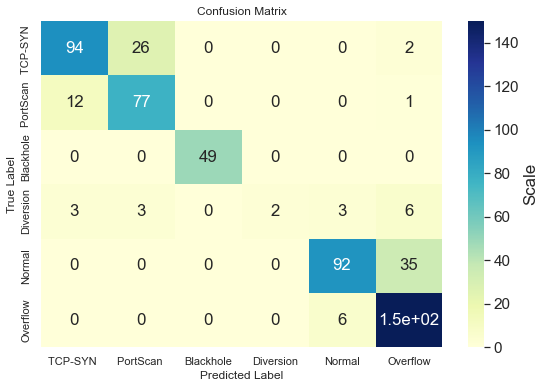

Epoch 1/500
21/21 [==============================] - 0s 6ms/step - loss: 1.3138 - accuracy: 0.4696 - val_loss: 0.9650 - val_accuracy: 0.6185
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8972 - accuracy: 0.6308 - val_loss: 0.7837 - val_accuracy: 0.6791
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7845 - accuracy: 0.6873 - val_loss: 0.7138 - val_accuracy: 0.7005
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7381 - accuracy: 0.6720 - val_loss: 0.6887 - val_accuracy: 0.7166
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7139 - accuracy: 0.6934 - val_loss: 0.6680 - val_accuracy: 0.6898
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6815 - accuracy: 0.7205 - val_loss: 0.6538 - val_accuracy: 0.7237
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6670 - accuracy: 0.7220 - val_loss: 0.6317 - val_accuracy: 0.7326
Epoch 8/500
2

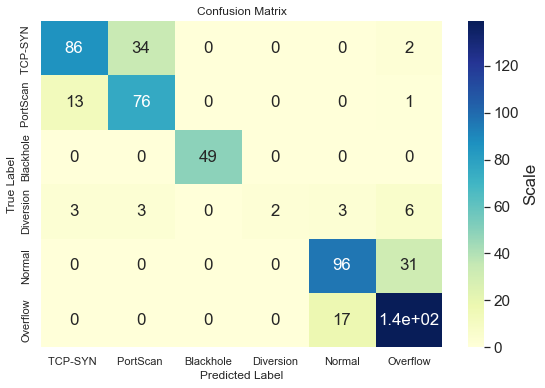

Epoch 1/500
21/21 [==============================] - 1s 6ms/step - loss: 1.1838 - accuracy: 0.5193 - val_loss: 0.8384 - val_accuracy: 0.6756
Epoch 2/500
21/21 [==============================] - 0s 2ms/step - loss: 0.8061 - accuracy: 0.6709 - val_loss: 0.7287 - val_accuracy: 0.6791
Epoch 3/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7361 - accuracy: 0.6896 - val_loss: 0.6962 - val_accuracy: 0.6649
Epoch 4/500
21/21 [==============================] - 0s 2ms/step - loss: 0.7017 - accuracy: 0.7083 - val_loss: 0.6731 - val_accuracy: 0.6399
Epoch 5/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6773 - accuracy: 0.7148 - val_loss: 0.6370 - val_accuracy: 0.7380
Epoch 6/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6642 - accuracy: 0.7209 - val_loss: 0.6399 - val_accuracy: 0.7415
Epoch 7/500
21/21 [==============================] - 0s 2ms/step - loss: 0.6615 - accuracy: 0.7300 - val_loss: 0.6189 - val_accuracy: 0.7362
Epoch 8/500
2

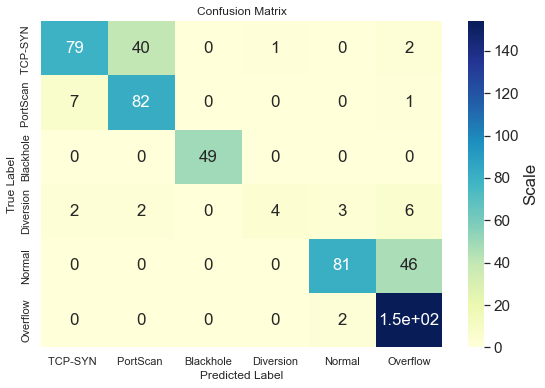

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.8205422163009644
Min_training_accuracy:  0.7980145215988159
Avg_training_accuracy:  0.8086292505264282
----------------------------------------------
Max_testing_accuracy:  0.8342245817184448
Min_testing_accuracy:  0.7985739707946777
Avg_testing_accuracy:  0.8171123027801513
----------------------------------------------
Max_Valadation_accuracy:  0.8181818127632141
Min_Valadation_accuracy:  0.7985739707946777
Avg_Valadation_accuracy:  0.809982168674469


In [ ]:
Tanh_train,Tanh_test,Tanh_val=model_best_activation('tanh')

In [ ]:
clac_min_max_average(Tanh_train,Tanh_test,Tanh_val)

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.8205422163009644
Min_training_accuracy:  0.7980145215988159
Avg_training_accuracy:  0.8086292505264282
----------------------------------------------
Max_testing_accuracy:  0.8342245817184448
Min_testing_accuracy:  0.7985739707946777
Avg_testing_accuracy:  0.8171123027801513
----------------------------------------------
Max_Valadation_accuracy:  0.8181818127632141
Min_Valadation_accuracy:  0.7985739707946777
Avg_Valadation_accuracy:  0.809982168674469


## Bonus Question

In [ ]:
import tensorflow as tf
def model_bonus(activation):
    total_train_acc= []
    total_test_acc= []
    total_val_acc=[]
    confusion=[]
    number_of_runs=5
    for i in range(number_of_runs):
        optimizer=tfaAdamw.optimizers.AdamW(learning_rate= 0.001, weight_decay= 0.00001)
        model = keras.models.Sequential()
        model.add(Dense(80, input_shape = (10,), activation = activation))
        model.add(Dense(80, activation = activation))
        model.add(Dense(80, activation = activation))
        model.add(Dense(80, activation = activation))
        model.add(Dense(80, activation = activation))
        model.add(Dense(80, activation = activation))
        model.add(Dense(80, activation = activation))
        model.add(Dense(80, activation = activation))
        model.add(Dense(80, activation = activation))
        model.add(Dense(80, activation = activation))
        model.add(Dense(80, activation = activation))
        model.add(Dense(80, activation = activation))
        model.add(Dense(6, activation = "softmax"))
        model.compile(optimizer=optimizer, loss="sparse_categorical_crossentropy", metrics = ["accuracy"])
        model.fit(x_train_scaled_anovaa, train_y, epochs=700, batch_size=128, validation_data=(x_test_scaled_anovaa, test_y))
        total_train_acc.append(model.history.history['accuracy'])
        total_test_acc.append(model.history.history['val_accuracy'])
        total_val_acc.append(model.evaluate(x_val_scaled_anovaa,val_y, verbose=0)[1])

        y_pred = np.argmax(model.predict(x_test_scaled_anovaa), axis=-1)
        data= confusion_matrix(test_y, y_pred)
        confusion.append(data)
        labels =['TCP-SYN ','PortScan ','Blackhole','Diversion','Normal','Overflow']
        plot_confusion_matrix(data,labels)

    # Training acc 
    # Max
    max_training_accuracy = np.amax(total_train_acc)
    # Min 
    min_training_accuracy = np.amin(total_train_acc)
    #Avg
    avg_training_accuracy = np.average(total_train_acc)

    # Testing acc 
    # Max
    max_testing_accuracy =  np.amax(total_test_acc)
    # Min 
    min_testing_accuracy =  np.amin(total_test_acc)
    # Avg
    avg_testing_accuracy =  np.average(total_test_acc)

    # Valadation acc 
    # Max
    max_Valadation_accuracy =  np.amax(total_val_acc)
    # Min 
    min_Valadation_accuracy =  np.amin(total_val_acc)
    # Avg
    avg_Valadation_accuracy =  np.average(total_val_acc)

    print('Min, Max, Avg Accuracies', '\n')
    print('Max_training_accuracy:', max_training_accuracy )
    print('Min_training_accuracy: ', min_training_accuracy)
    print('Avg_training_accuracy: ', avg_training_accuracy)
    print('----------------------------------------------')
    print('Max_testing_accuracy: ', max_testing_accuracy)
    print('Min_testing_accuracy: ', min_testing_accuracy)
    print('Avg_testing_accuracy: ', avg_testing_accuracy)
    print('----------------------------------------------')
    print('Max_Valadation_accuracy: ', max_Valadation_accuracy)
    print('Min_Valadation_accuracy: ', min_Valadation_accuracy)
    print('Avg_Valadation_accuracy: ', avg_Valadation_accuracy)
    
    return total_train_acc,total_test_acc,total_val_acc

Epoch 1/700
21/21 [==============================] - 1s 9ms/step - loss: 1.5384 - accuracy: 0.3574 - val_loss: 1.0175 - val_accuracy: 0.6185
Epoch 2/700
21/21 [==============================] - 0s 3ms/step - loss: 0.8663 - accuracy: 0.5998 - val_loss: 0.7731 - val_accuracy: 0.6560
Epoch 3/700
21/21 [==============================] - 0s 3ms/step - loss: 0.7346 - accuracy: 0.6743 - val_loss: 0.6633 - val_accuracy: 0.7023
Epoch 4/700
21/21 [==============================] - 0s 3ms/step - loss: 0.6819 - accuracy: 0.7029 - val_loss: 0.6265 - val_accuracy: 0.7023
Epoch 5/700
21/21 [==============================] - 0s 3ms/step - loss: 0.6444 - accuracy: 0.7216 - val_loss: 0.5832 - val_accuracy: 0.7540
Epoch 6/700
21/21 [==============================] - 0s 3ms/step - loss: 0.6265 - accuracy: 0.7312 - val_loss: 0.5586 - val_accuracy: 0.7790
Epoch 7/700
21/21 [==============================] - 0s 3ms/step - loss: 0.6036 - accuracy: 0.7472 - val_loss: 0.5691 - val_accuracy: 0.7897
Epoch 8/700
2

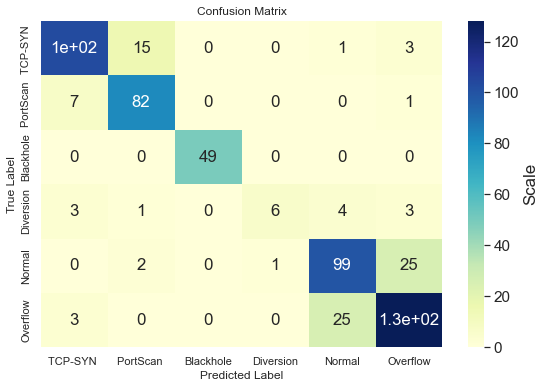

Epoch 1/700
21/21 [==============================] - 1s 8ms/step - loss: 1.5210 - accuracy: 0.3486 - val_loss: 1.1768 - val_accuracy: 0.4581
Epoch 2/700
21/21 [==============================] - 0s 3ms/step - loss: 1.0020 - accuracy: 0.5124 - val_loss: 0.9024 - val_accuracy: 0.4866
Epoch 3/700
21/21 [==============================] - 0s 3ms/step - loss: 0.7952 - accuracy: 0.5930 - val_loss: 0.6726 - val_accuracy: 0.7415
Epoch 4/700
21/21 [==============================] - 0s 3ms/step - loss: 0.6637 - accuracy: 0.7186 - val_loss: 0.7251 - val_accuracy: 0.7308
Epoch 5/700
21/21 [==============================] - 0s 3ms/step - loss: 0.6747 - accuracy: 0.7129 - val_loss: 0.6353 - val_accuracy: 0.7326
Epoch 6/700
21/21 [==============================] - 0s 3ms/step - loss: 0.6302 - accuracy: 0.7407 - val_loss: 0.5643 - val_accuracy: 0.7576
Epoch 7/700
21/21 [==============================] - 0s 3ms/step - loss: 0.5894 - accuracy: 0.7568 - val_loss: 0.5524 - val_accuracy: 0.7683
Epoch 8/700
2

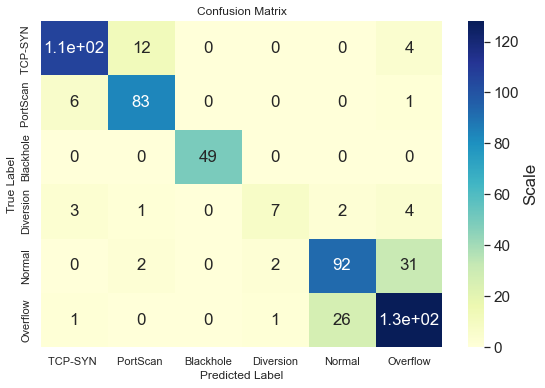

Epoch 1/700
21/21 [==============================] - 1s 8ms/step - loss: 1.5972 - accuracy: 0.4486 - val_loss: 1.1159 - val_accuracy: 0.4670
Epoch 2/700
21/21 [==============================] - 0s 2ms/step - loss: 0.8783 - accuracy: 0.5861 - val_loss: 0.6993 - val_accuracy: 0.6934
Epoch 3/700
21/21 [==============================] - 0s 2ms/step - loss: 0.7050 - accuracy: 0.6926 - val_loss: 0.6256 - val_accuracy: 0.6952
Epoch 4/700
21/21 [==============================] - 0s 2ms/step - loss: 0.6348 - accuracy: 0.7255 - val_loss: 0.6260 - val_accuracy: 0.7451
Epoch 5/700
21/21 [==============================] - 0s 2ms/step - loss: 0.6443 - accuracy: 0.7350 - val_loss: 0.6366 - val_accuracy: 0.7451
Epoch 6/700
21/21 [==============================] - 0s 2ms/step - loss: 0.6208 - accuracy: 0.7434 - val_loss: 0.5499 - val_accuracy: 0.7843
Epoch 7/700
21/21 [==============================] - 0s 3ms/step - loss: 0.5878 - accuracy: 0.7625 - val_loss: 0.5757 - val_accuracy: 0.7772
Epoch 8/700
2

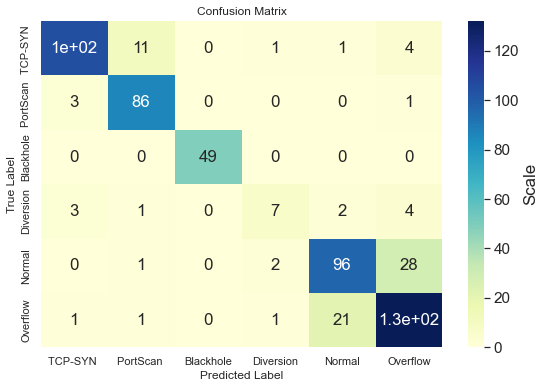

Epoch 1/700
21/21 [==============================] - 1s 8ms/step - loss: 1.6054 - accuracy: 0.2875 - val_loss: 1.0806 - val_accuracy: 0.5740
Epoch 2/700
21/21 [==============================] - 0s 2ms/step - loss: 0.8962 - accuracy: 0.5804 - val_loss: 0.7583 - val_accuracy: 0.6542
Epoch 3/700
21/21 [==============================] - 0s 2ms/step - loss: 0.7470 - accuracy: 0.6613 - val_loss: 0.6596 - val_accuracy: 0.7201
Epoch 4/700
21/21 [==============================] - 0s 2ms/step - loss: 0.6840 - accuracy: 0.7041 - val_loss: 0.6793 - val_accuracy: 0.6506
Epoch 5/700
21/21 [==============================] - 0s 2ms/step - loss: 0.6468 - accuracy: 0.7159 - val_loss: 0.5850 - val_accuracy: 0.7629
Epoch 6/700
21/21 [==============================] - 0s 2ms/step - loss: 0.6035 - accuracy: 0.7426 - val_loss: 0.5679 - val_accuracy: 0.7540
Epoch 7/700
21/21 [==============================] - 0s 2ms/step - loss: 0.5961 - accuracy: 0.7526 - val_loss: 0.5793 - val_accuracy: 0.7611
Epoch 8/700
2

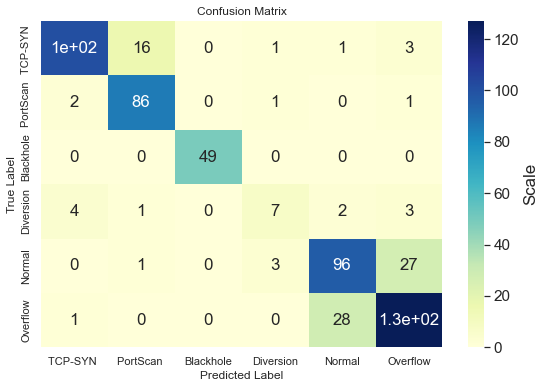

Epoch 1/700
21/21 [==============================] - 1s 8ms/step - loss: 1.6537 - accuracy: 0.3200 - val_loss: 1.3532 - val_accuracy: 0.3957
Epoch 2/700
21/21 [==============================] - 0s 3ms/step - loss: 1.0746 - accuracy: 0.5216 - val_loss: 0.8666 - val_accuracy: 0.5936
Epoch 3/700
21/21 [==============================] - 0s 3ms/step - loss: 0.8297 - accuracy: 0.6105 - val_loss: 0.7225 - val_accuracy: 0.6631
Epoch 4/700
21/21 [==============================] - 0s 3ms/step - loss: 0.7057 - accuracy: 0.6877 - val_loss: 0.6189 - val_accuracy: 0.7469
Epoch 5/700
21/21 [==============================] - 0s 3ms/step - loss: 0.6210 - accuracy: 0.7381 - val_loss: 0.5643 - val_accuracy: 0.7736
Epoch 6/700
21/21 [==============================] - 0s 3ms/step - loss: 0.5936 - accuracy: 0.7530 - val_loss: 0.5608 - val_accuracy: 0.7879
Epoch 7/700
21/21 [==============================] - 0s 3ms/step - loss: 0.6031 - accuracy: 0.7426 - val_loss: 0.6129 - val_accuracy: 0.7469
Epoch 8/700
2

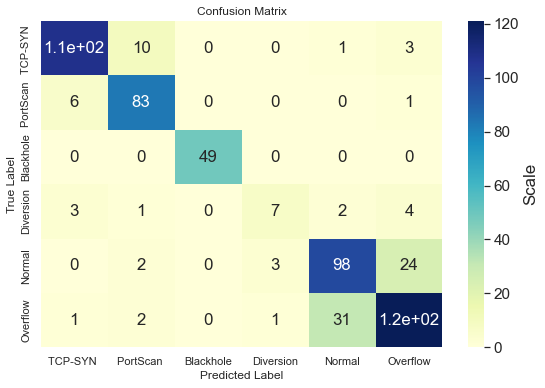

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.9293623566627502
Min_training_accuracy:  0.287514328956604
Avg_training_accuracy:  0.879827196589538
----------------------------------------------
Max_testing_accuracy:  0.8698752522468567
Min_testing_accuracy:  0.3957219123840332
Avg_testing_accuracy:  0.8302750184876578
----------------------------------------------
Max_Valadation_accuracy:  0.8253119587898254
Min_Valadation_accuracy:  0.8110516667366028
Avg_Valadation_accuracy:  0.8188948273658753


In [ ]:
relu_train2,relu__test2,relu__val2=model_bonus('relu')

In [ ]:
clac_min_max_average(relu_train2,relu__test2,relu__val2)

Min, Max, Avg Accuracies 

Max_training_accuracy: 0.9293623566627502
Min_training_accuracy:  0.287514328956604
Avg_training_accuracy:  0.879827196589538
----------------------------------------------
Max_testing_accuracy:  0.8698752522468567
Min_testing_accuracy:  0.3957219123840332
Avg_testing_accuracy:  0.8302750184876578
----------------------------------------------
Max_Valadation_accuracy:  0.8253119587898254
Min_Valadation_accuracy:  0.8110516667366028
Avg_Valadation_accuracy:  0.8188948273658753
